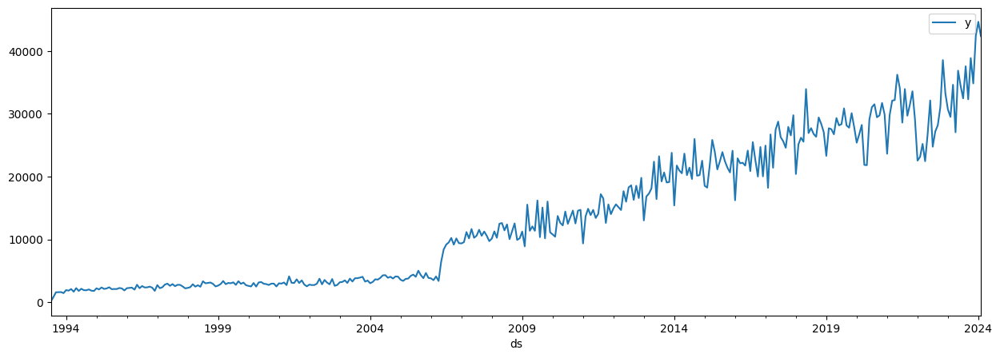

In [1]:
import pandas as pd

# Load the dataset from the Feather file using pandas
mdf = pd.read_feather("/mnt/c/Users/doughnut/OneDrive - The University of Melbourne/Phase 1 - Study 4 - Australian Genetic and Genomic Test Utilisation/Data Files/Processed_MBSGeneticsCount_20240325_175333.feather")

# Ensure that "Month" is in datetime format
mdf['Month'] = pd.to_datetime(mdf['Month'])

# Rename the "Month" and "Value" columns
df = mdf.rename(columns={"Month": "ds", "Value": "y"})

# Group data by 'Month' and calculate the sum of "Value"
df = df.groupby('ds')['y'].sum().reset_index()

# Plot the dataset, showing price (y column) over time (ds column)
plt = df.plot(x="ds", y="y", figsize=(15, 5))


Logistic Growth Metrics (R², MAE, MAPE, RMSE): (0.9516249143382968, 1669.7116395176304, 22.85312172317503, 2418.900888441645)
Gompertz Growth Metrics (R², MAE, MAPE, RMSE): (0.9502831266731631, 1784.0370899433424, 26.989836805739607, 2452.2181618134)
Bass Diffusion Metrics (R², MAE, MAPE, RMSE): (0.9497867603362888, 1783.9239730223812, 27.057393195794084, 2464.429061772541)


/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: overflow encountered in exp
  result = getattr(ufunc, method)(*inputs, **kwargs)


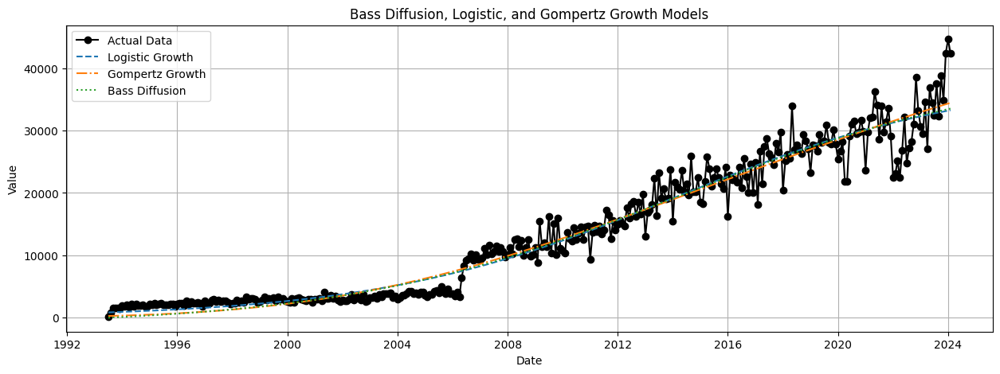

In [3]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.optimize import curve_fit
from sklearn.metrics import r2_score, mean_absolute_error, mean_squared_error

# Load the dataset from the Feather file using pandas
mdf = pd.read_feather("/mnt/c/Users/doughnut/OneDrive - The University of Melbourne/Phase 1 - Study 4 - Australian Genetic and Genomic Test Utilisation/Data Files/Processed_MBSGeneticsCount_20240325_175333.feather")

# Ensure that "Month" is in datetime format
mdf['Month'] = pd.to_datetime(mdf['Month'])

# Rename the "Month" and "Value" columns
df = mdf.rename(columns={"Month": "ds", "Value": "y"})

# Group data by 'Month' and calculate the sum of "Value"
df = df.groupby('ds')['y'].sum().reset_index()

# Convert the "ds" column to ordinal to use in growth models
df['ds_ordinal'] = df['ds'].apply(lambda x: x.toordinal())

# Define the logistic, Gompertz, and Bass diffusion models
def logistic_growth(t, K, P0, r):
    return K / (1 + ((K - P0) / P0) * np.exp(-r * t))

def gompertz_growth(t, a, b, c):
    return a * np.exp(-b * np.exp(-c * t))

def bass_diffusion(t, p, q, m):
    return m * (1 - np.exp(-(p + q) * t)) / (1 + (q / p) * np.exp(-(p + q) * t))

# Fit the models
t_data = df['ds_ordinal'] - df['ds_ordinal'].min()
y_data = df['y']

# Logistic model
logistic_params, _ = curve_fit(logistic_growth, t_data, y_data, p0=[max(y_data), min(y_data), 0.1])

# Gompertz model - update with improved initial guesses and bounds
gompertz_params, _ = curve_fit(
    gompertz_growth, t_data, y_data, 
    p0=[max(y_data), 0.1, 0.1], 
    bounds=([0, 0, 0], [np.inf, np.inf, np.inf])
)

# Bass diffusion model
bass_params, _ = curve_fit(bass_diffusion, t_data, y_data, p0=[0.03, 0.38, max(y_data)])

# Generate predictions
df['logistic_pred'] = logistic_growth(t_data, *logistic_params)
df['gompertz_pred'] = gompertz_growth(t_data, *gompertz_params)
df['bass_pred'] = bass_diffusion(t_data, *bass_params)

# Define evaluation metrics
def calculate_metrics(y_true, y_pred):
    r2 = r2_score(y_true, y_pred)
    mae = mean_absolute_error(y_true, y_pred)
    mape = np.mean(np.abs((y_true - y_pred) / y_true)) * 100
    rmse = np.sqrt(mean_squared_error(y_true, y_pred))
    return r2, mae, mape, rmse

# Calculate metrics for each model
logistic_metrics = calculate_metrics(df['y'], df['logistic_pred'])
gompertz_metrics = calculate_metrics(df['y'], df['gompertz_pred'])
bass_metrics = calculate_metrics(df['y'], df['bass_pred'])

# Print the metrics
print("Logistic Growth Metrics (R², MAE, MAPE, RMSE):", logistic_metrics)
print("Gompertz Growth Metrics (R², MAE, MAPE, RMSE):", gompertz_metrics)
print("Bass Diffusion Metrics (R², MAE, MAPE, RMSE):", bass_metrics)

# Plot the results
plt.figure(figsize=(15, 5))
plt.plot(df['ds'], df['y'], label='Actual Data', color='black', marker='o')
plt.plot(df['ds'], df['logistic_pred'], label='Logistic Growth', linestyle='--')
plt.plot(df['ds'], df['gompertz_pred'], label='Gompertz Growth', linestyle='-.')
plt.plot(df['ds'], df['bass_pred'], label='Bass Diffusion', linestyle=':')
plt.xlabel('Date')
plt.ylabel('Value')
plt.title('Bass Diffusion, Logistic, and Gompertz Growth Models')
plt.legend()
plt.grid(True)
plt.show()


Logistic Growth Metrics (R², MAE, MAPE, RMSE): (0.9516249143382968, 1669.7116395176304, 22.85312172317503, 2418.900888441645)
Gompertz Growth Metrics (R², MAE, MAPE, RMSE): (0.9502831266753036, 1784.0362396508515, 26.989798161260186, 2452.218161760611)
Bass Diffusion Metrics (R², MAE, MAPE, RMSE): (0.9497867603362888, 1783.9239730223812, 27.057393195794084, 2464.429061772541)


/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: overflow encountered in exp
  result = getattr(ufunc, method)(*inputs, **kwargs)


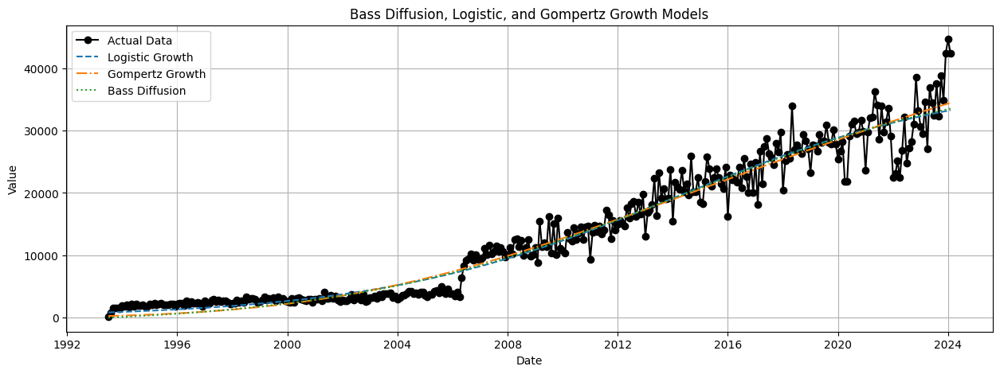

In [4]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.optimize import curve_fit
from sklearn.metrics import r2_score, mean_absolute_error, mean_squared_error

# Load the dataset from the Feather file using pandas
mdf = pd.read_feather("/mnt/c/Users/doughnut/OneDrive - The University of Melbourne/Phase 1 - Study 4 - Australian Genetic and Genomic Test Utilisation/Data Files/Processed_MBSGeneticsCount_20240325_175333.feather")

# Ensure that "Month" is in datetime format
mdf['Month'] = pd.to_datetime(mdf['Month'])

# Rename the "Month" and "Value" columns
df = mdf.rename(columns={"Month": "ds", "Value": "y"})

# Group data by 'Month' and calculate the sum of "Value"
df = df.groupby('ds')['y'].sum().reset_index()

# Convert the "ds" column to ordinal to use in growth models
df['ds_ordinal'] = df['ds'].apply(lambda x: x.toordinal())

# Define the logistic, Gompertz, and Bass diffusion models
def logistic_growth(t, K, P0, r):
    return K / (1 + ((K - P0) / P0) * np.exp(-r * t))

def gompertz_growth(t, a, b, c):
    return a * np.exp(-b * np.exp(-c * t))

def bass_diffusion(t, p, q, m):
    return m * (1 - np.exp(-(p + q) * t)) / (1 + (q / p) * np.exp(-(p + q) * t))

# Fit the models
t_data = df['ds_ordinal'] - df['ds_ordinal'].min()
y_data = df['y']

# Logistic model
logistic_params, _ = curve_fit(logistic_growth, t_data, y_data, p0=[max(y_data), min(y_data), 0.1])

# Optimized initial guess function for Gompertz model
def optimize_initial_guesses(func, t_data, y_data, param_ranges, num_trials=100):
    best_params = None
    best_r2 = -np.inf
    
    for _ in range(num_trials):
        # Randomly generate initial guesses within the provided ranges
        initial_guesses = [np.random.uniform(low, high) for low, high in param_ranges]
        
        try:
            # Fit the model
            params, _ = curve_fit(func, t_data, y_data, p0=initial_guesses, bounds=([0, 0, 0], [np.inf, np.inf, np.inf]))
            # Generate predictions
            y_pred = func(t_data, *params)
            # Calculate R²
            r2 = r2_score(y_data, y_pred)
            
            # Keep track of the best R² and corresponding parameters
            if r2 > best_r2:
                best_r2 = r2
                best_params = params
        except RuntimeError:
            # If curve fitting fails, skip to the next trial
            continue
    
    return best_params, best_r2

# Define ranges for the Gompertz parameters (a, b, c)
gompertz_param_ranges = [(0.8 * max(y_data), 1.2 * max(y_data)), (0.001, 2), (0.001, 2)]

# Optimize the Gompertz initial guesses based on R²
gompertz_params, gompertz_r2 = optimize_initial_guesses(gompertz_growth, t_data, y_data, gompertz_param_ranges)

# Bass diffusion model
bass_params, _ = curve_fit(bass_diffusion, t_data, y_data, p0=[0.03, 0.38, max(y_data)])

# Generate predictions
df['logistic_pred'] = logistic_growth(t_data, *logistic_params)
df['gompertz_pred'] = gompertz_growth(t_data, *gompertz_params)
df['bass_pred'] = bass_diffusion(t_data, *bass_params)

# Define evaluation metrics
def calculate_metrics(y_true, y_pred):
    r2 = r2_score(y_true, y_pred)
    mae = mean_absolute_error(y_true, y_pred)
    mape = np.mean(np.abs((y_true - y_pred) / y_true)) * 100
    rmse = np.sqrt(mean_squared_error(y_true, y_pred))
    return r2, mae, mape, rmse

# Calculate metrics for each model
logistic_metrics = calculate_metrics(df['y'], df['logistic_pred'])
gompertz_metrics = calculate_metrics(df['y'], df['gompertz_pred'])
bass_metrics = calculate_metrics(df['y'], df['bass_pred'])

# Print the metrics
print("Logistic Growth Metrics (R², MAE, MAPE, RMSE):", logistic_metrics)
print("Gompertz Growth Metrics (R², MAE, MAPE, RMSE):", gompertz_metrics)
print("Bass Diffusion Metrics (R², MAE, MAPE, RMSE):", bass_metrics)

# Plot the results
plt.figure(figsize=(15, 5))
plt.plot(df['ds'], df['y'], label='Actual Data', color='black', marker='o')
plt.plot(df['ds'], df['logistic_pred'], label='Logistic Growth', linestyle='--')
plt.plot(df['ds'], df['gompertz_pred'], label='Gompertz Growth', linestyle='-.')
plt.plot(df['ds'], df['bass_pred'], label='Bass Diffusion', linestyle=':')
plt.xlabel('Date')
plt.ylabel('Value')
plt.title('Bass Diffusion, Logistic, and Gompertz Growth Models')
plt.legend()
plt.grid(True)
plt.show()


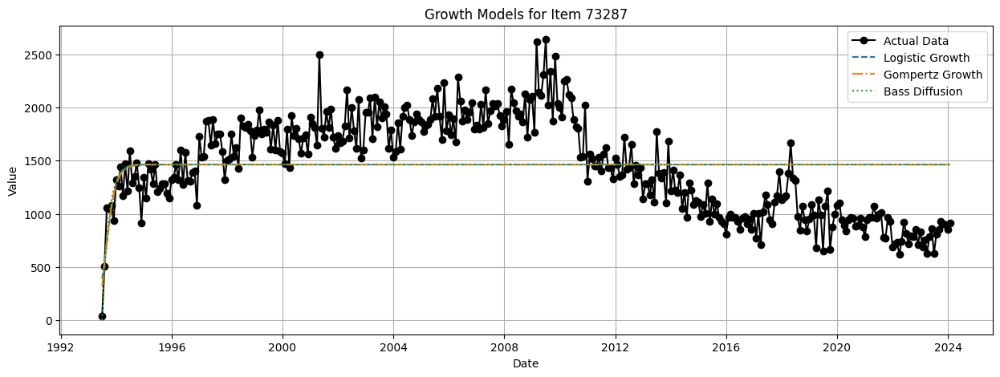

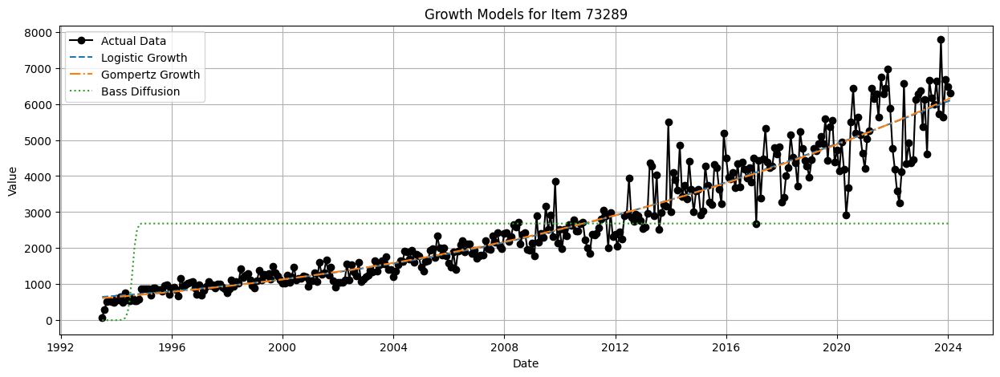

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


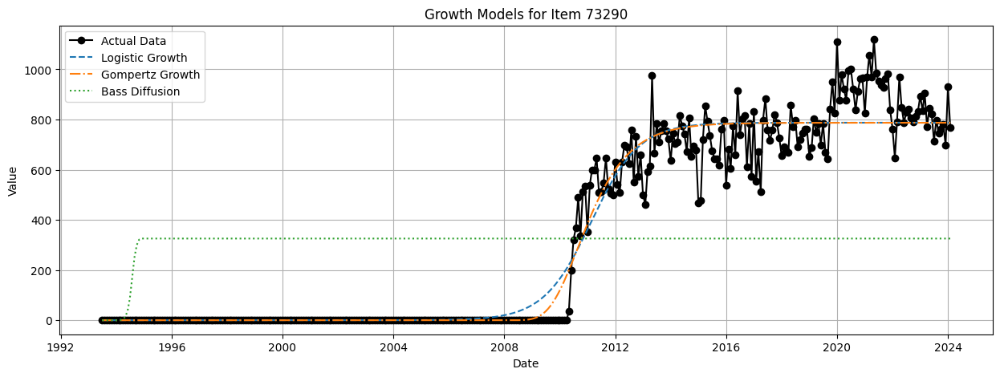

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


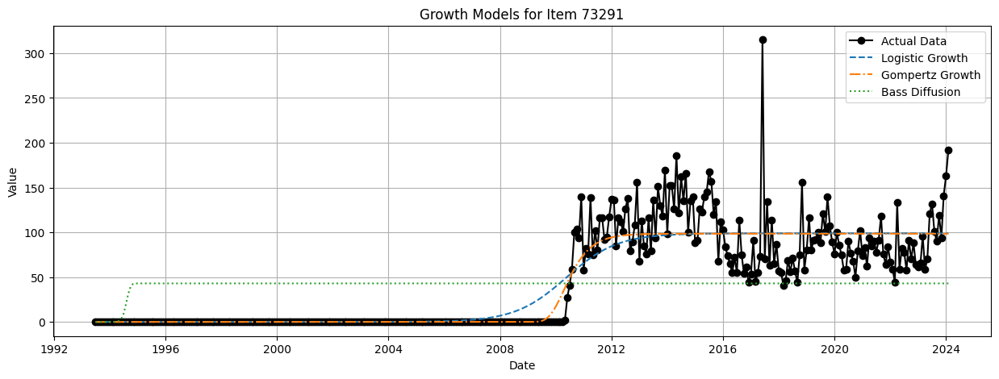

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


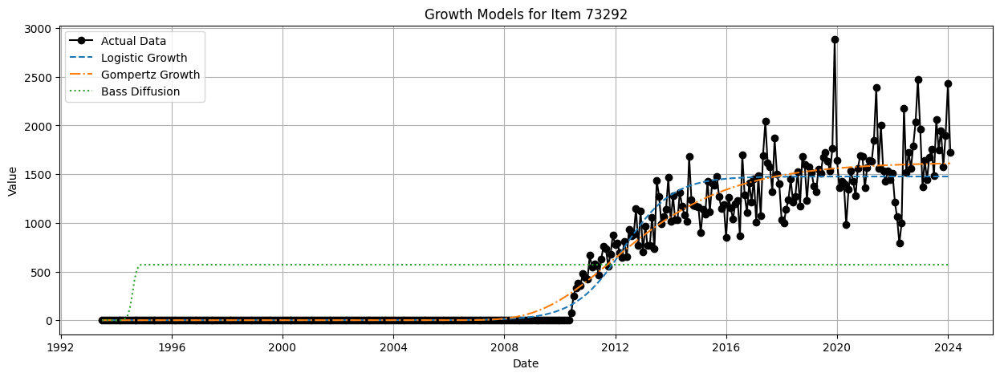

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


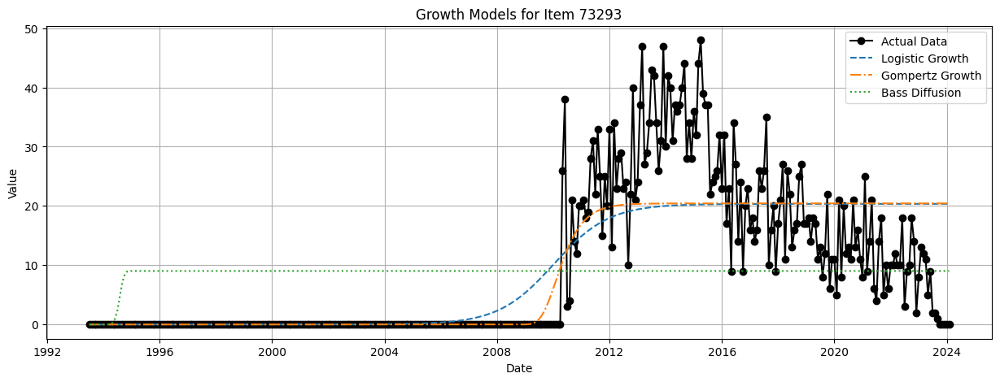

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


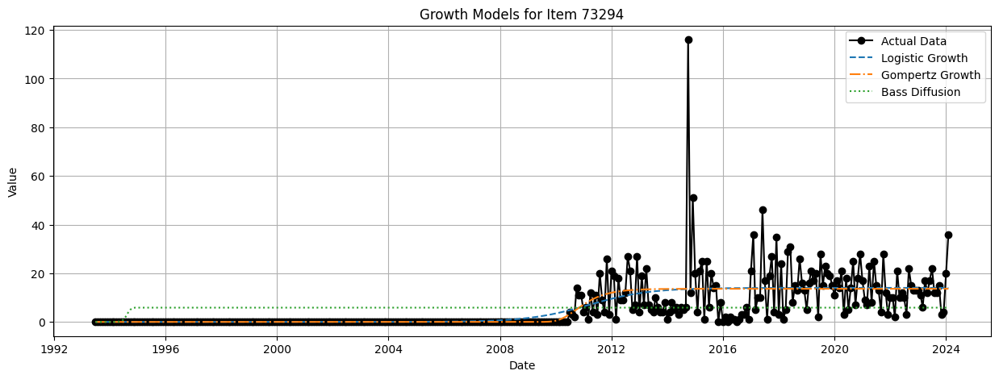

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


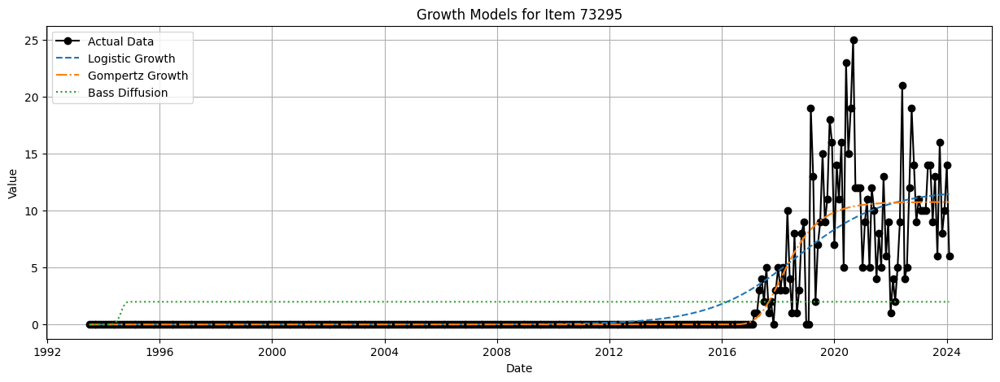

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


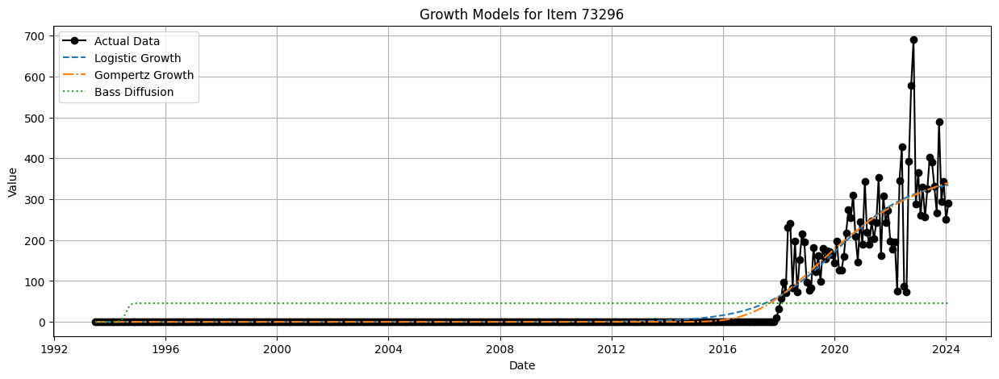

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


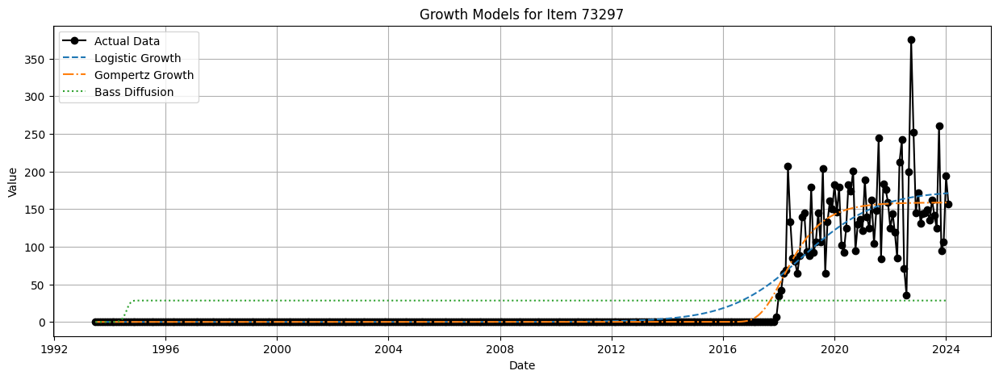

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


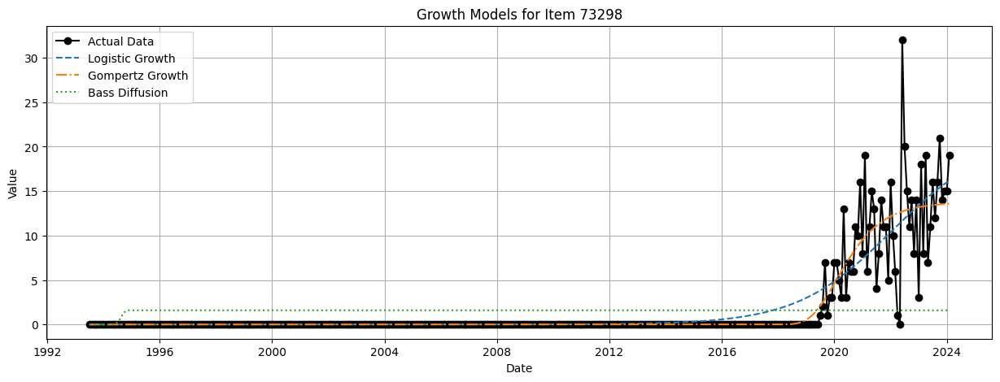

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


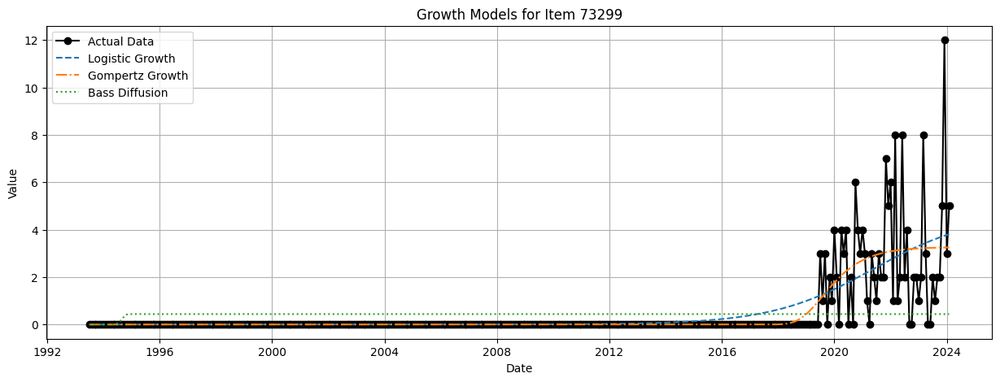

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


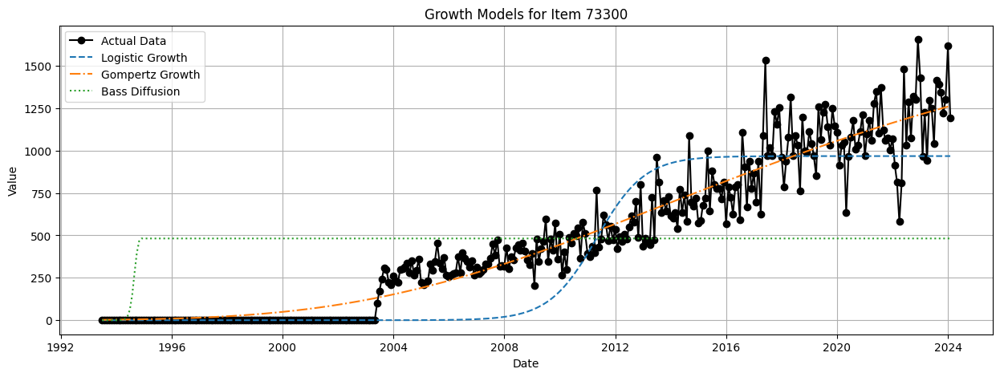

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


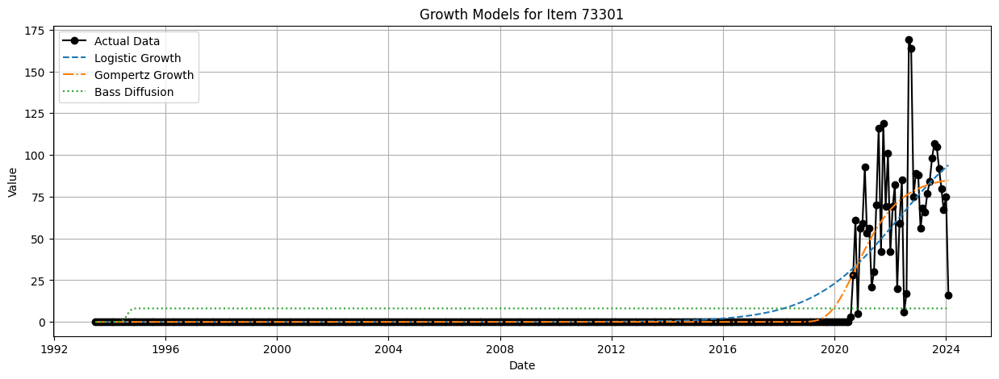

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


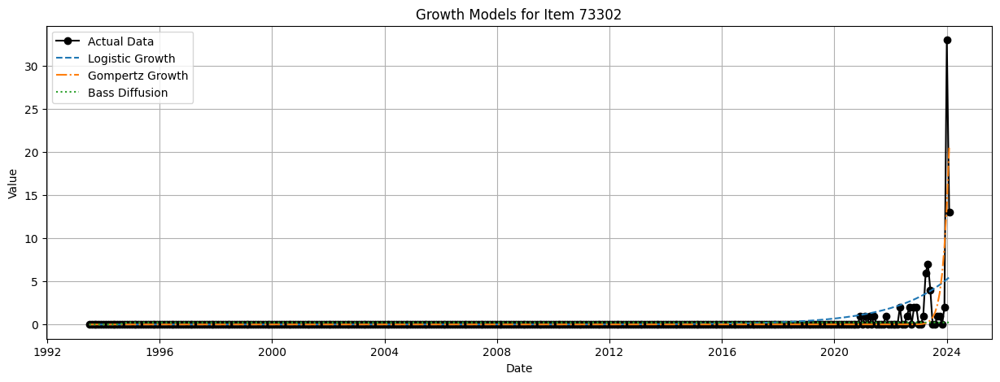

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


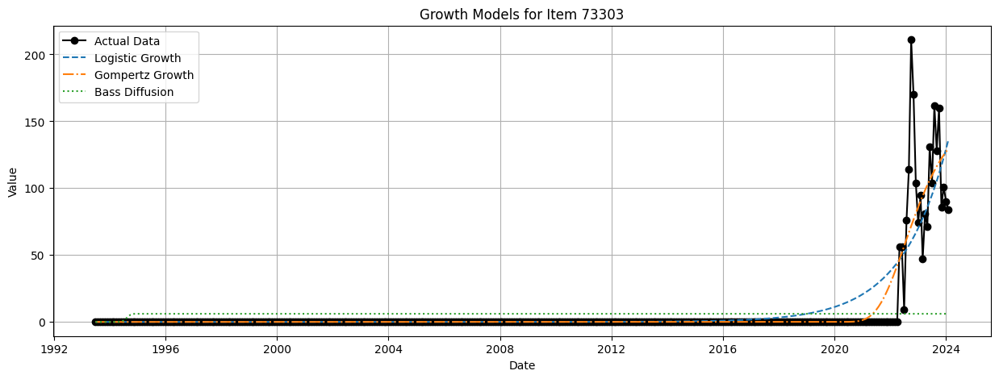

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


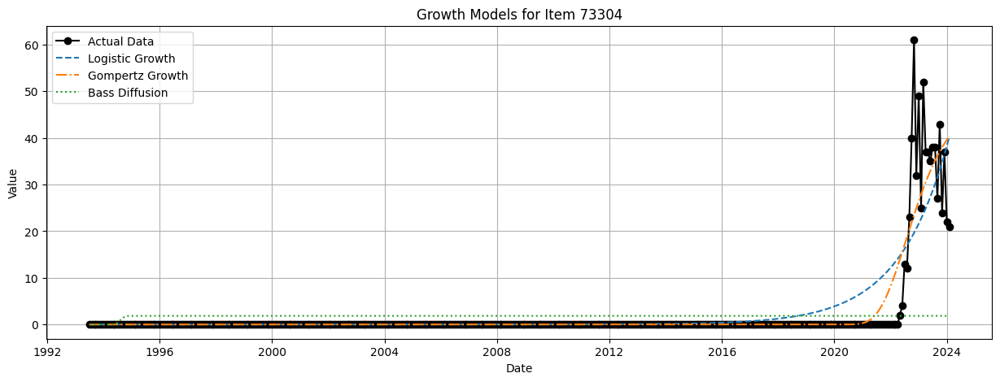

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


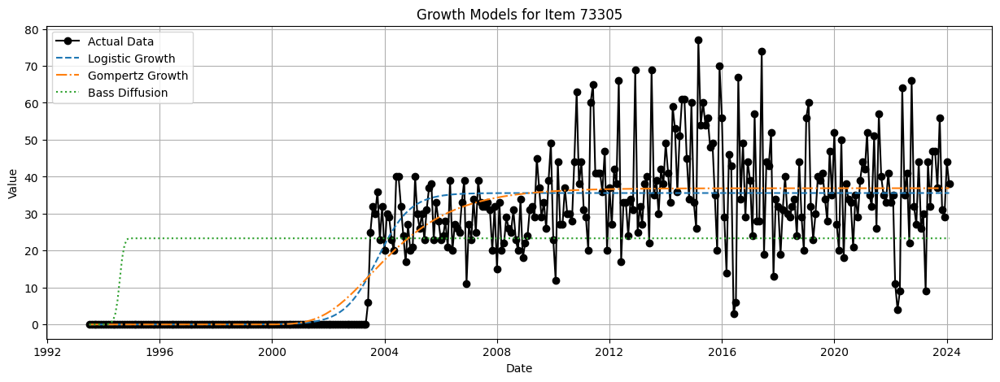

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


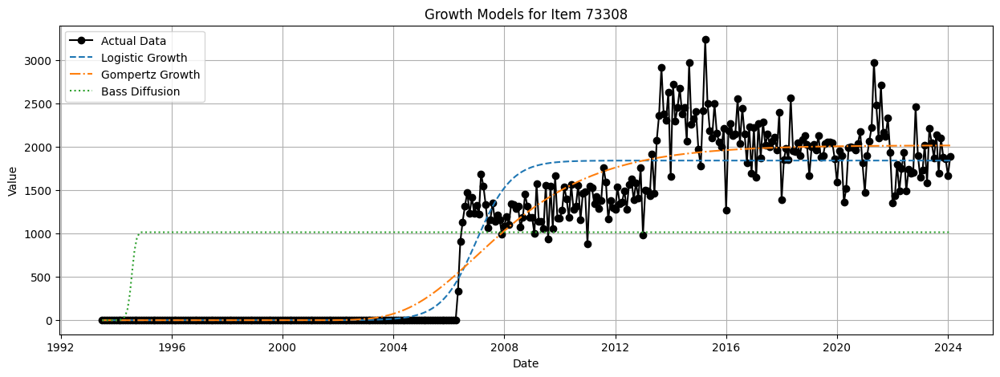

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


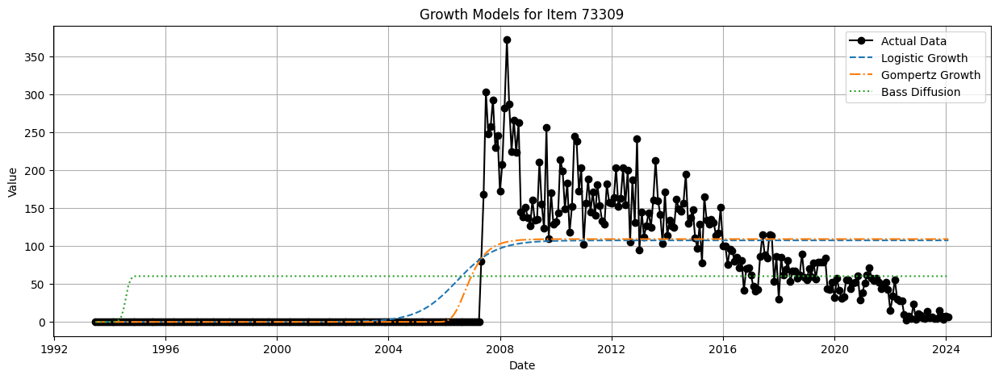

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


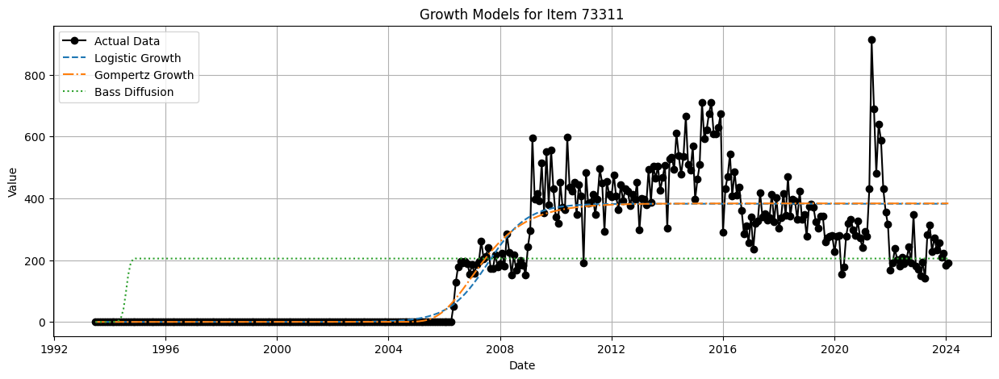

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


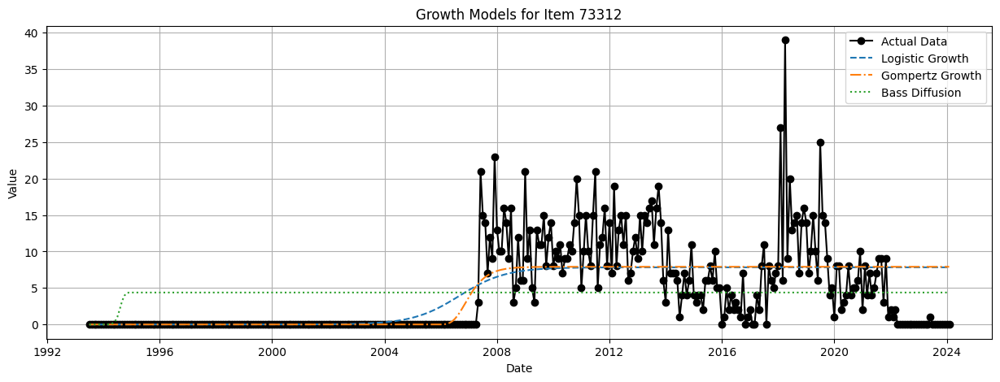

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


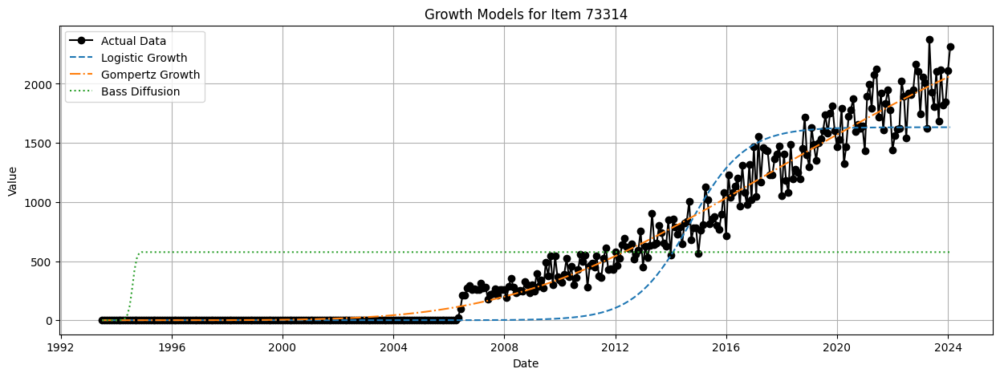

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


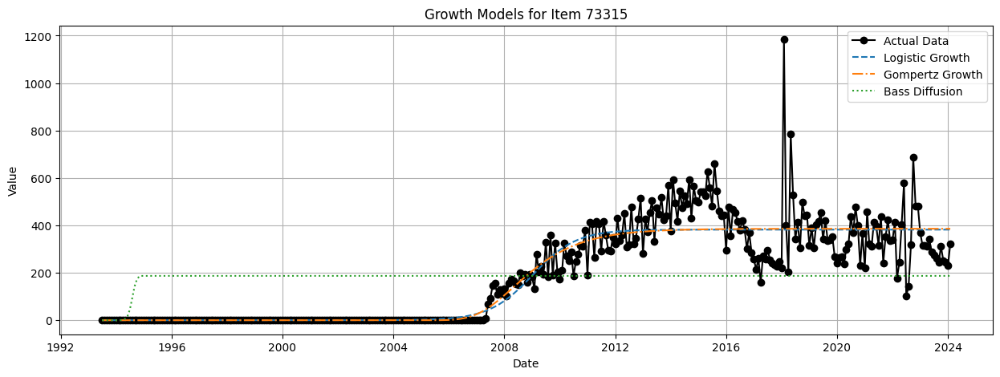

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


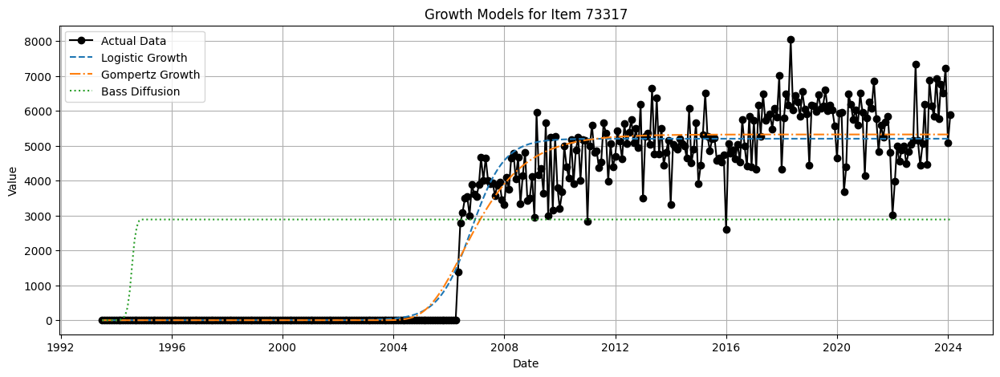

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


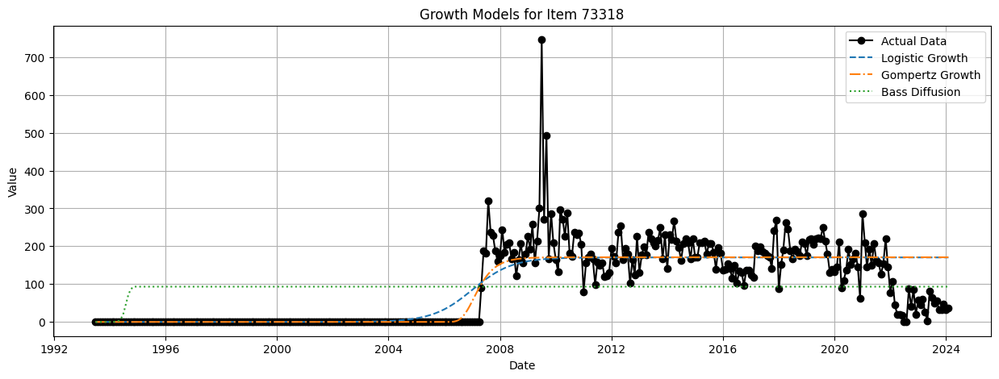

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


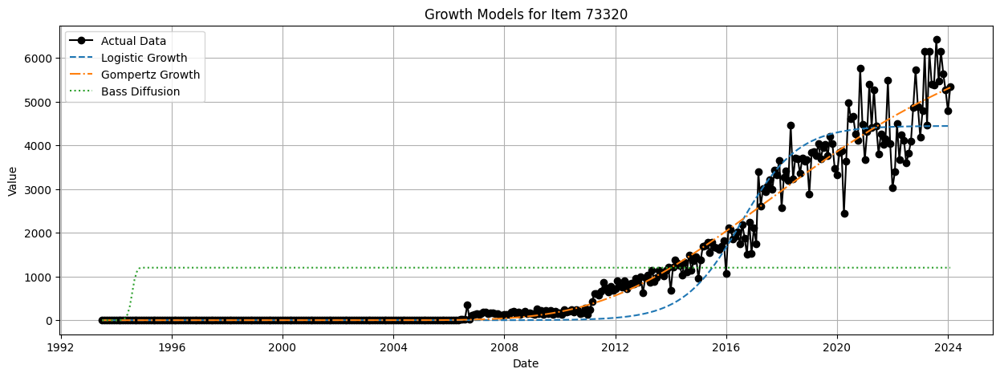

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


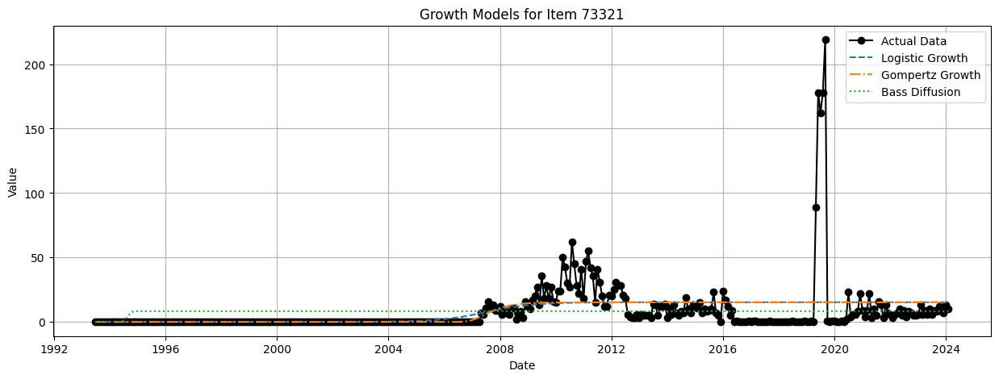

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


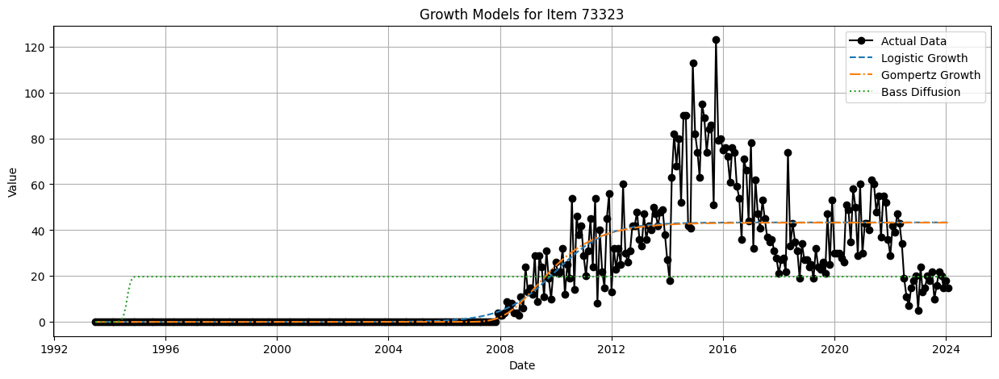

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


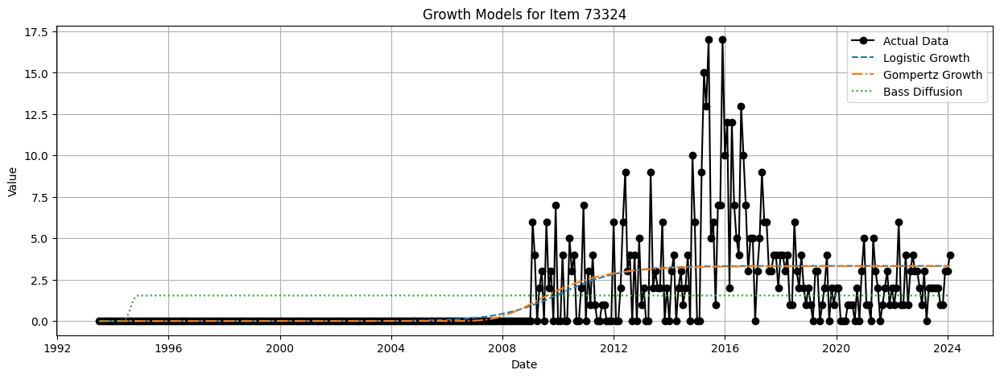

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


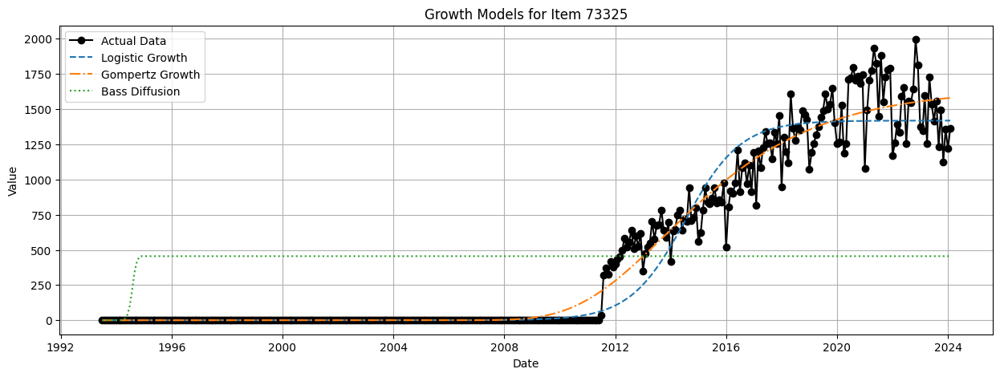

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


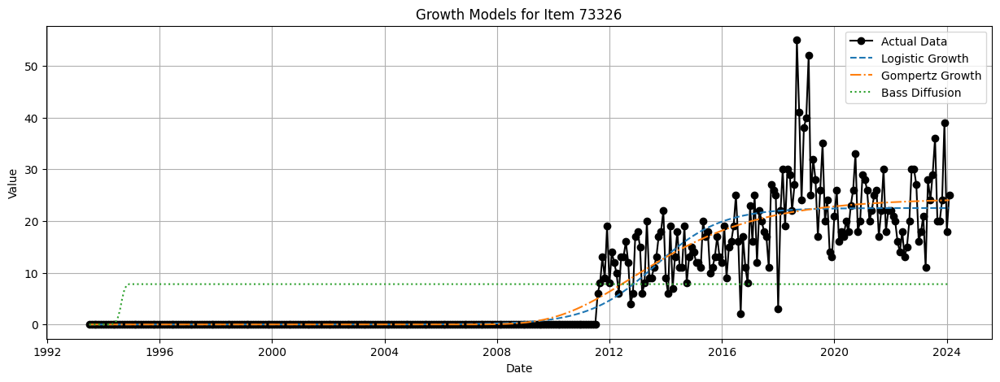

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


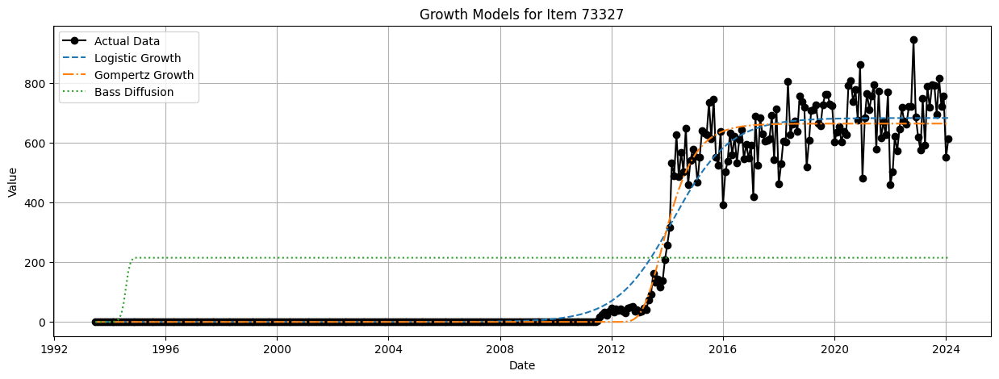

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


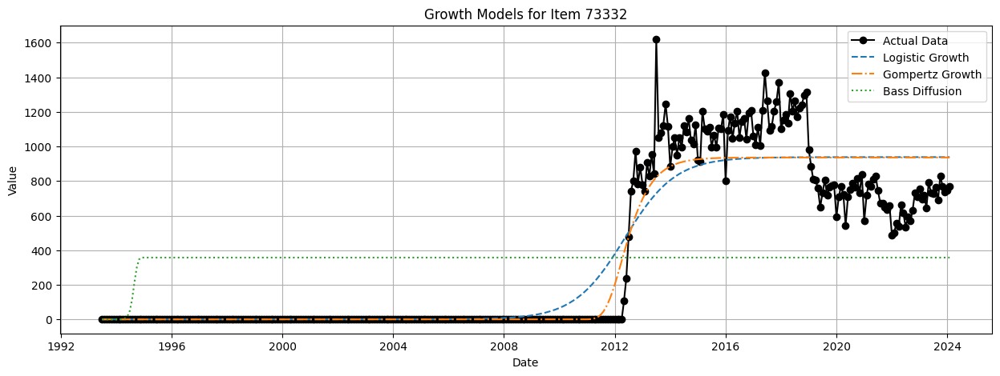

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


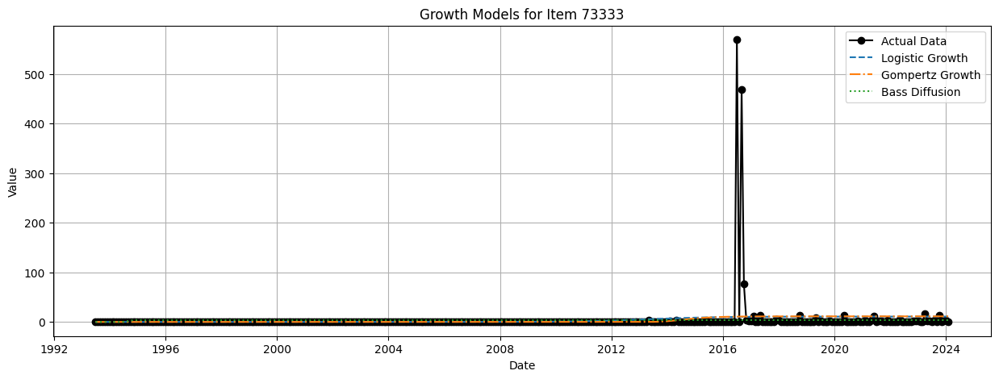

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


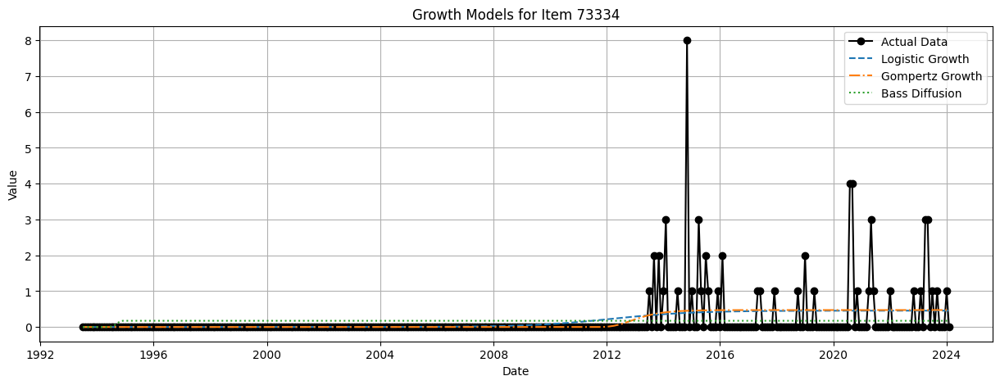

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


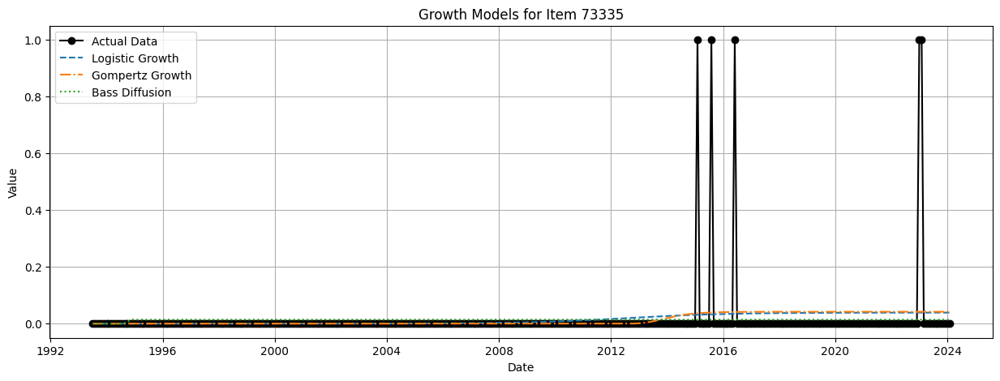

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


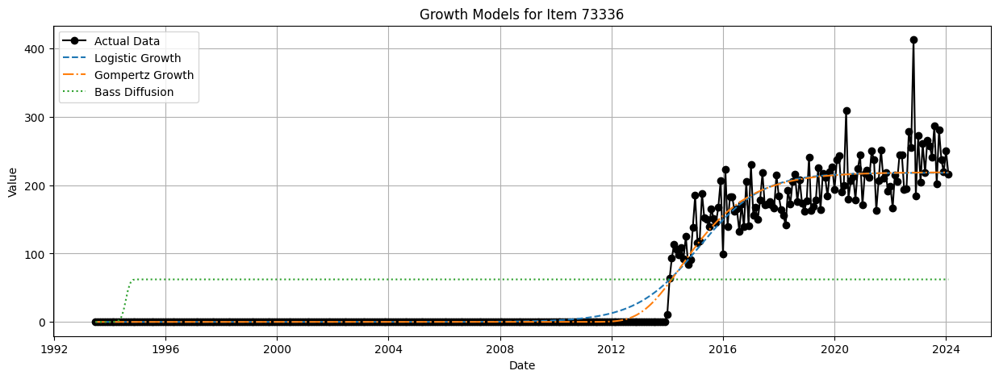

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


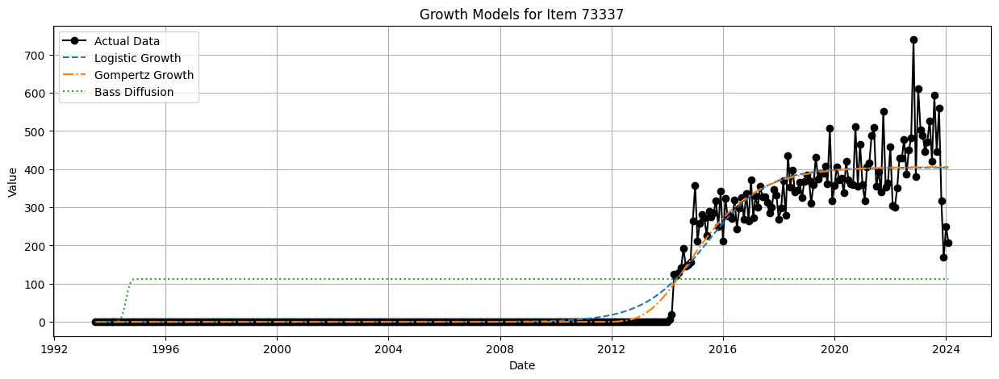

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


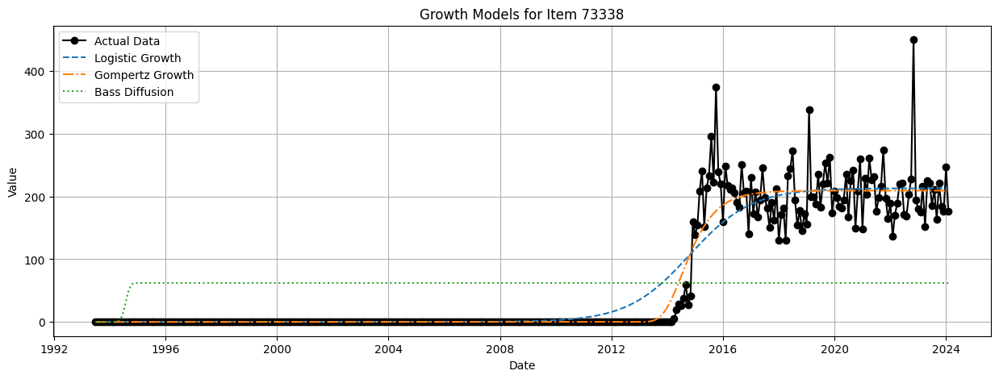

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


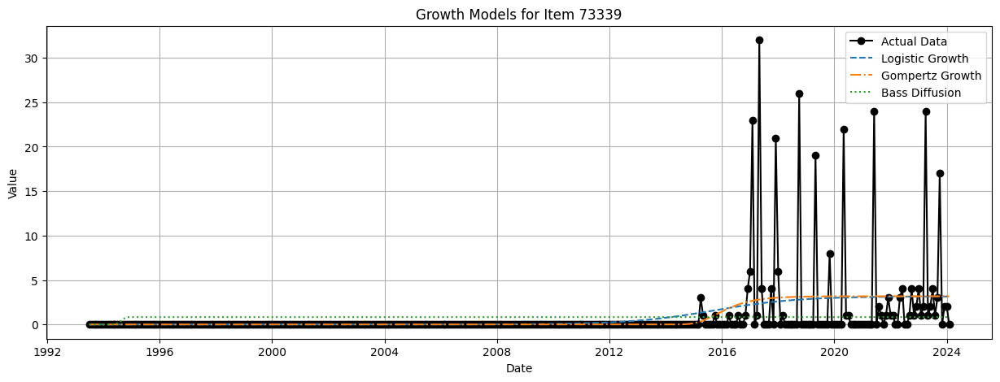

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


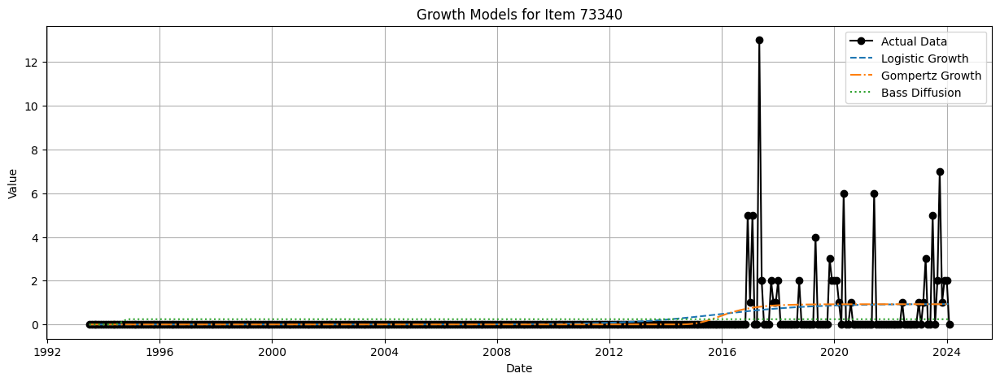

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


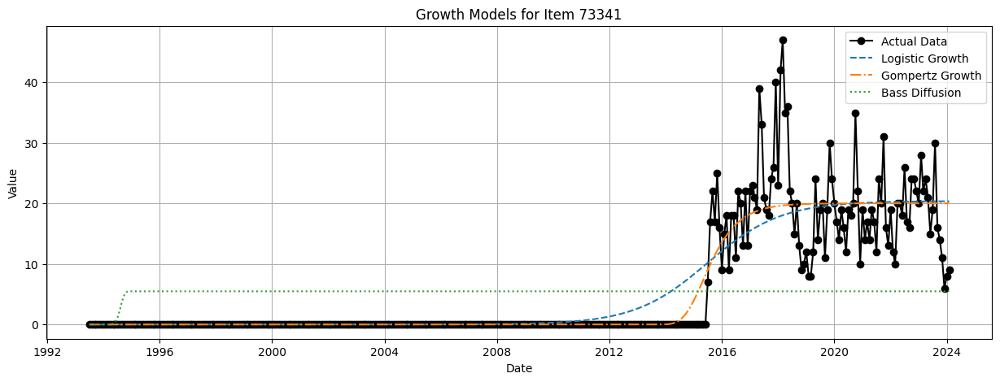

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


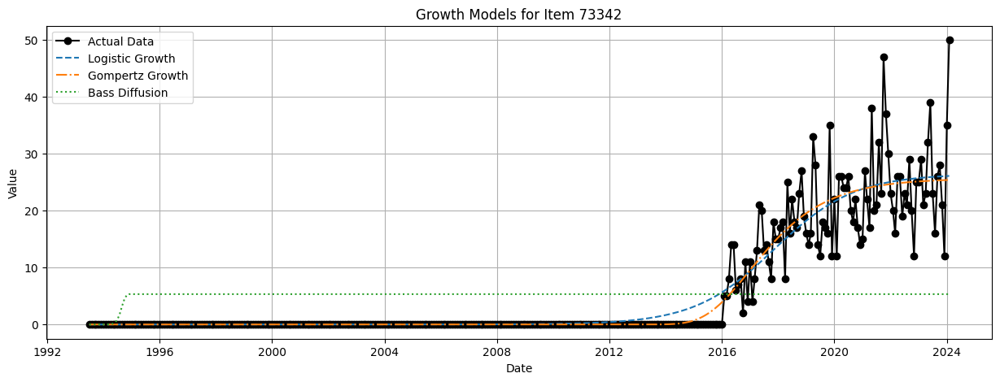

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


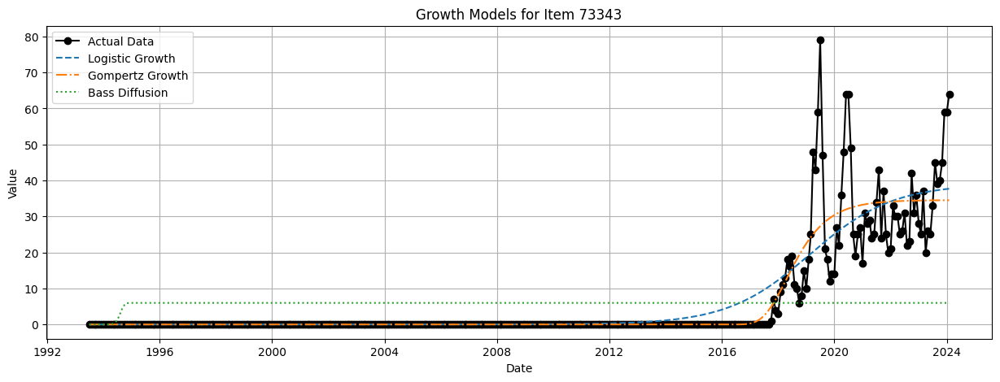

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


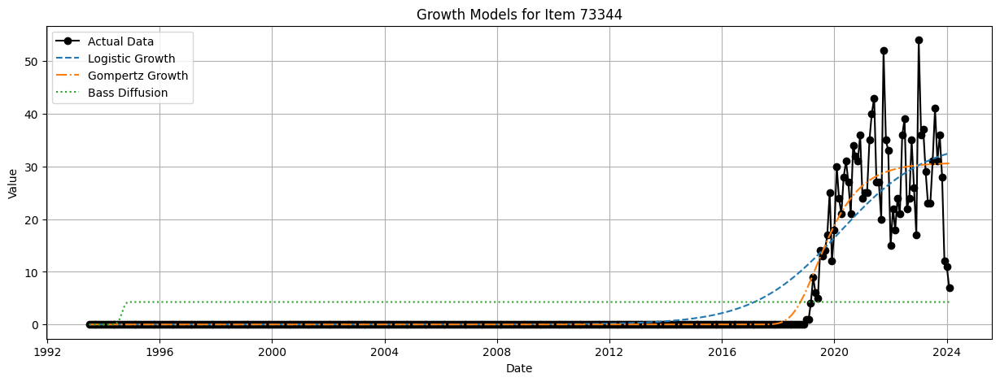

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


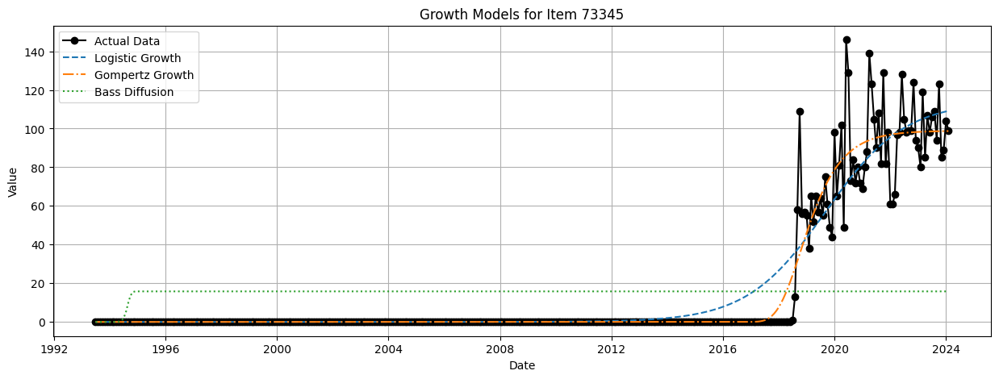

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


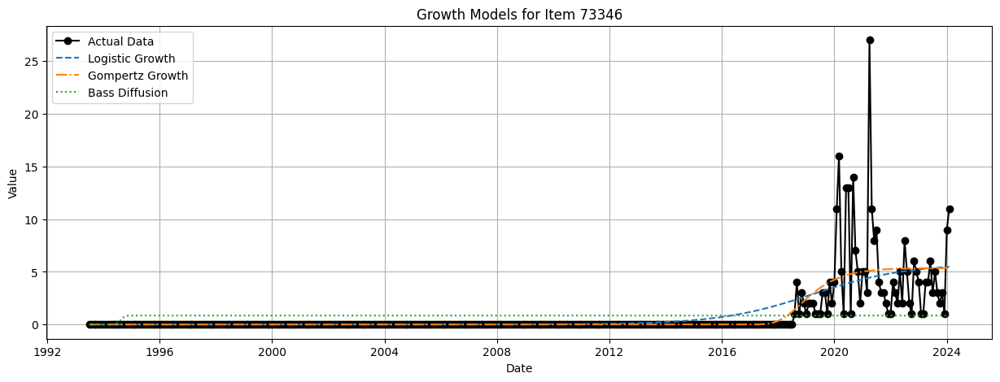

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


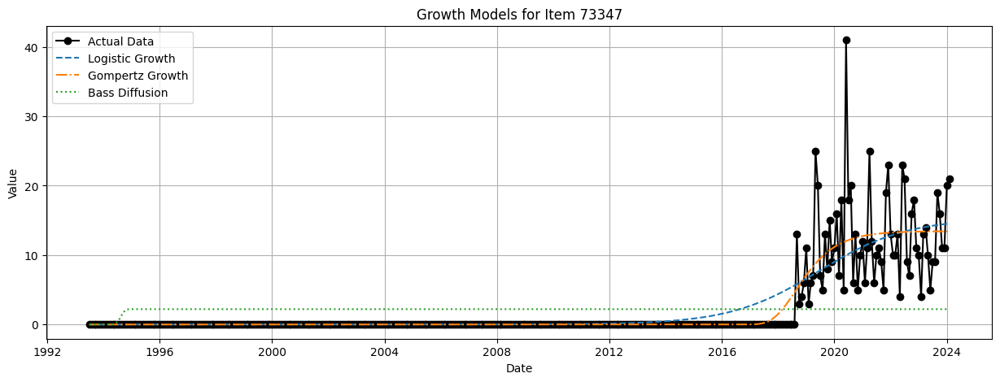

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


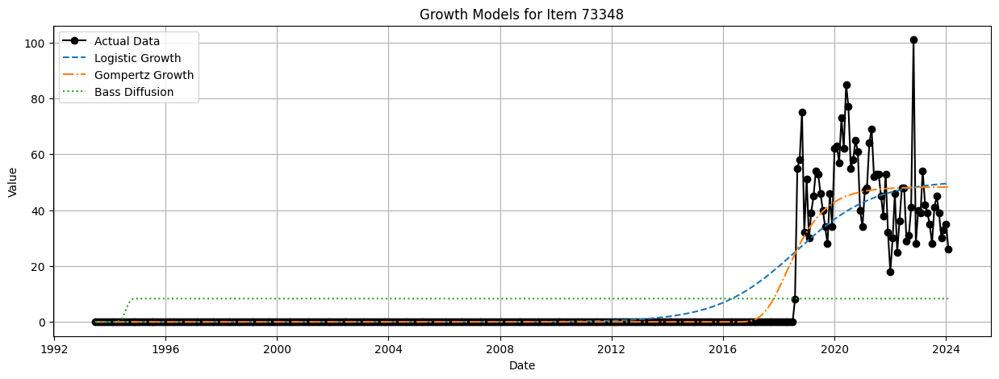

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


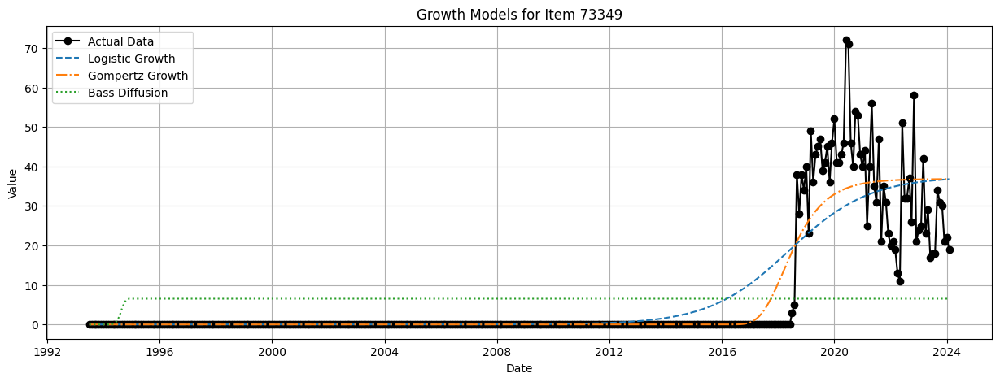

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


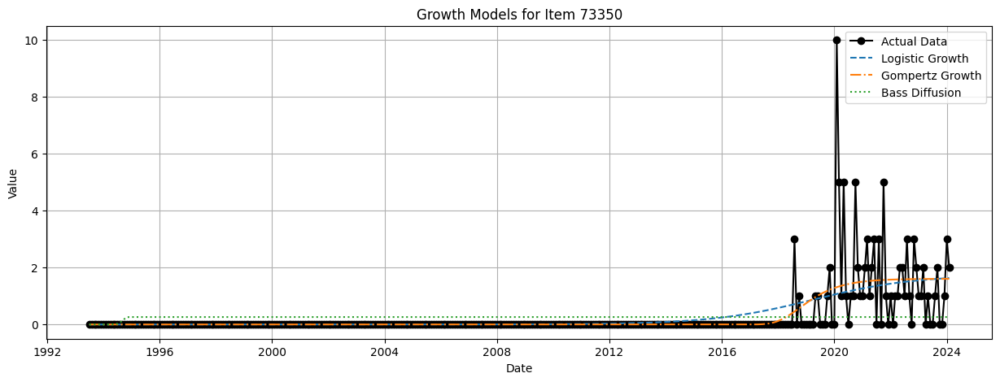

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


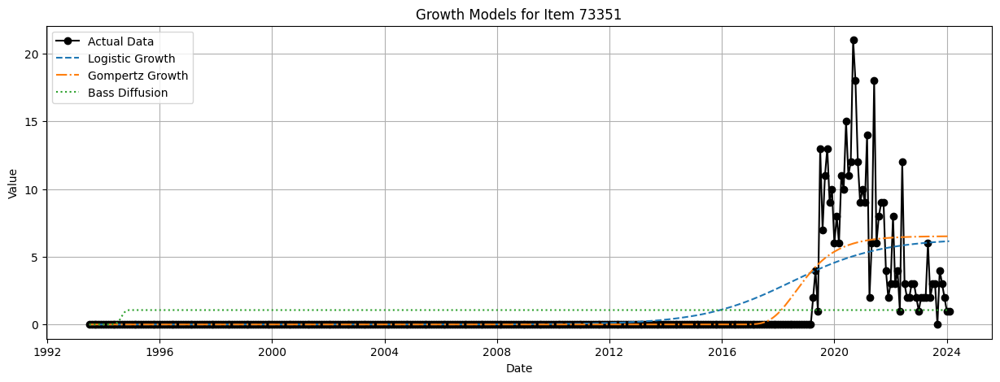

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


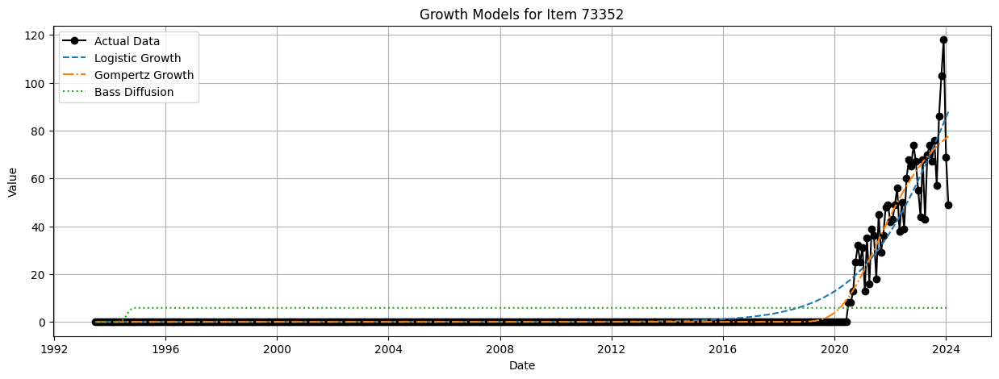

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


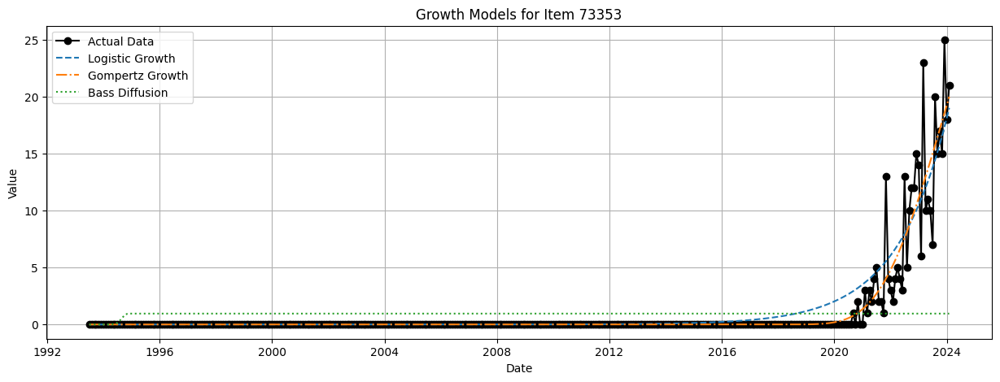

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


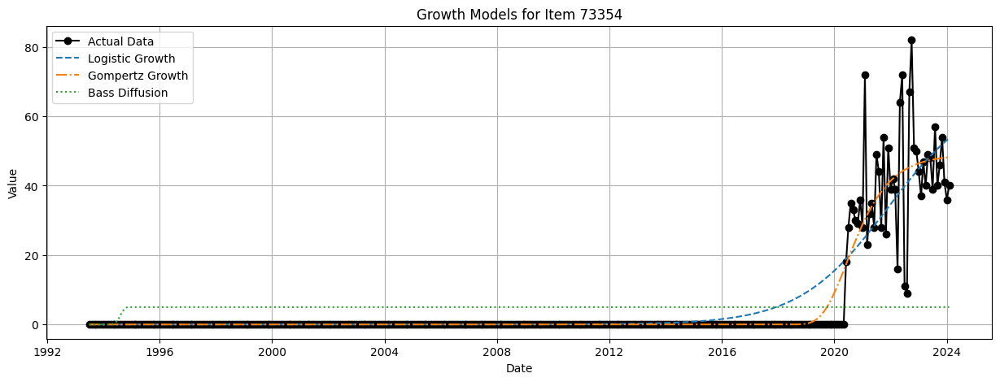

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


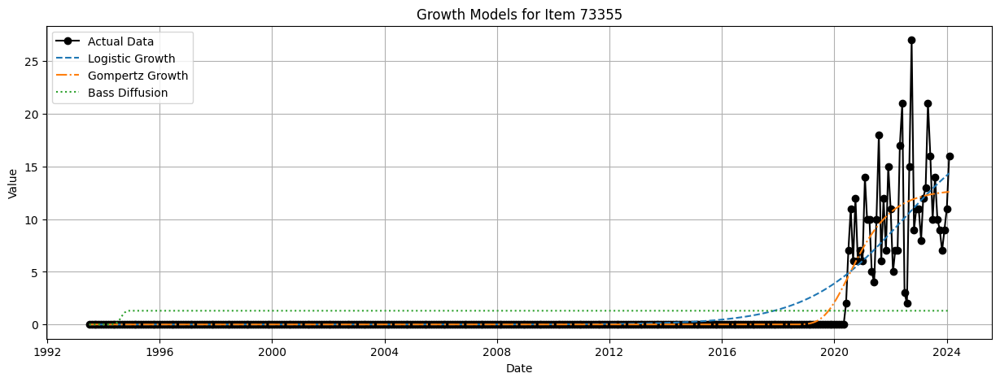

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


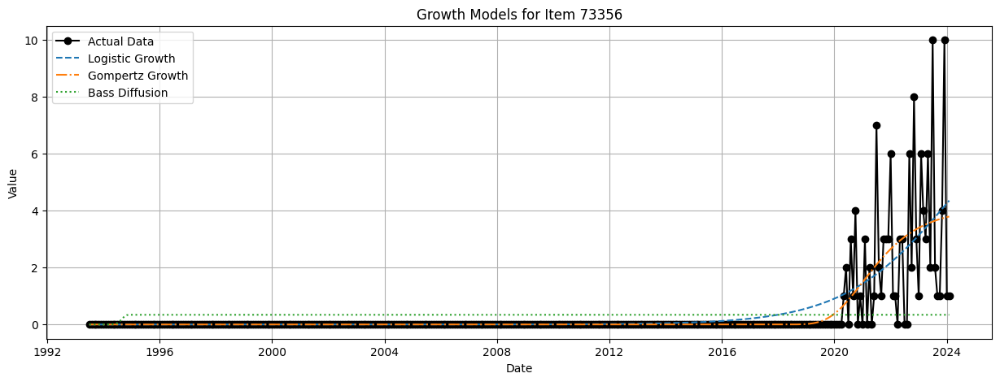

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


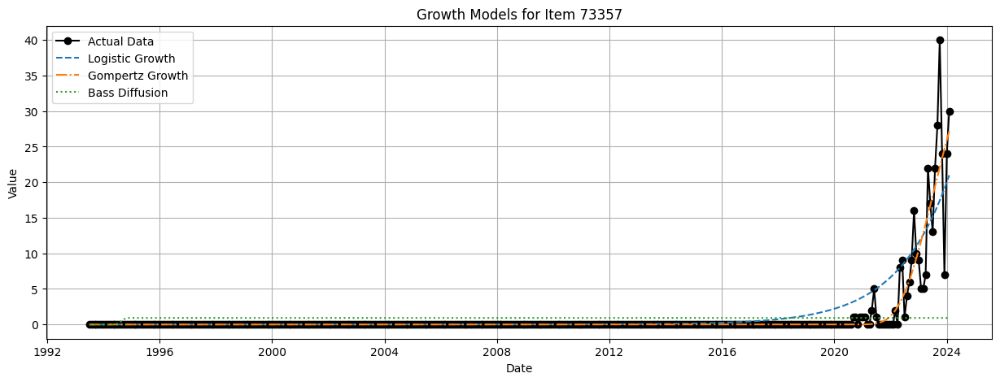

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


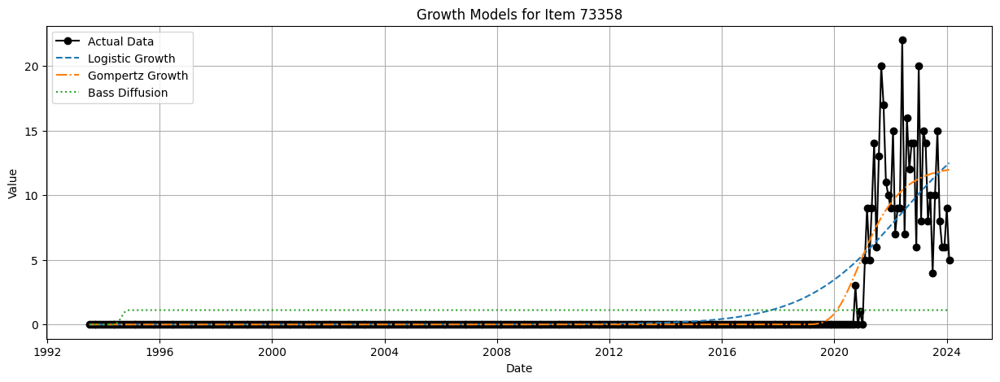

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


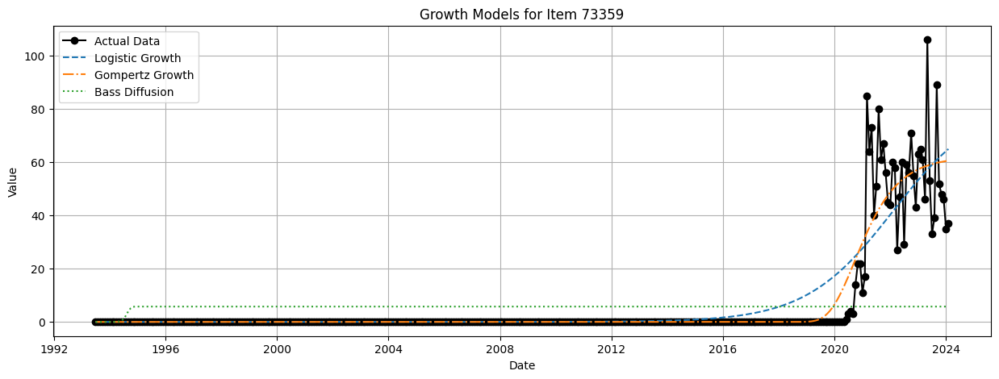

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


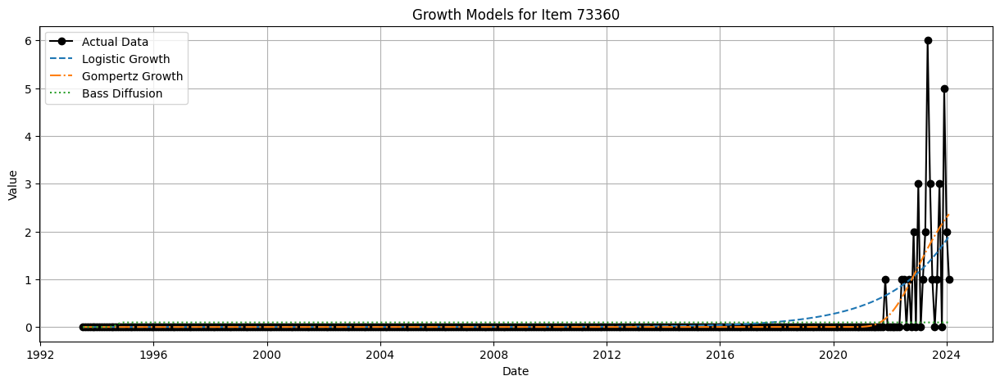

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


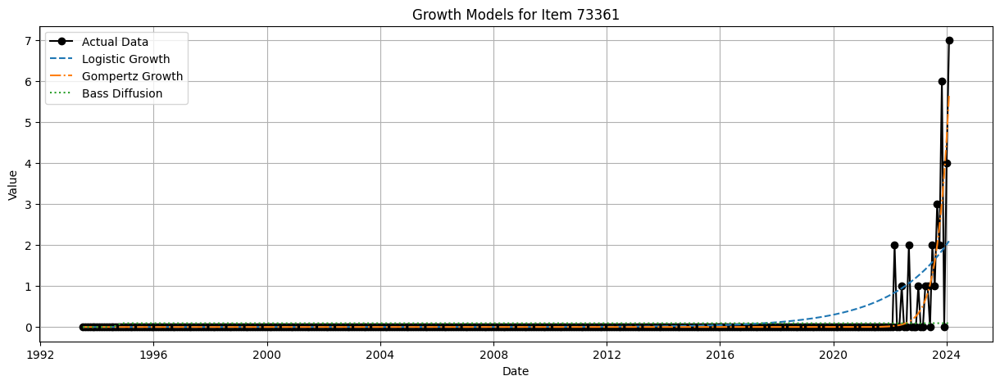

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


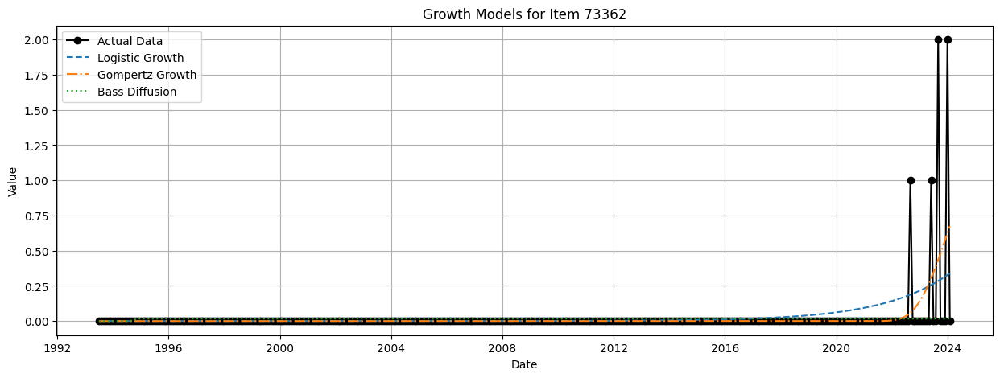

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


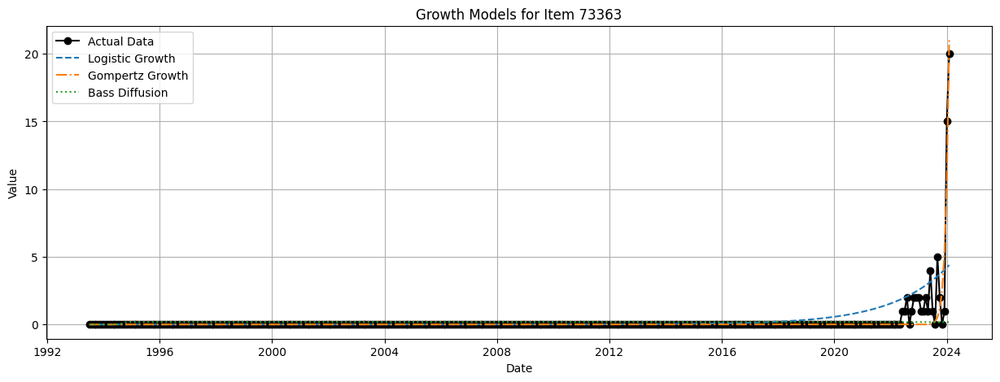

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


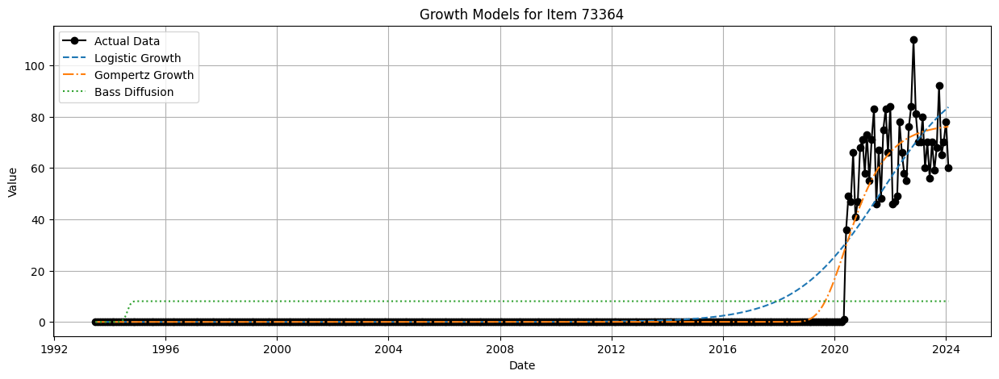

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


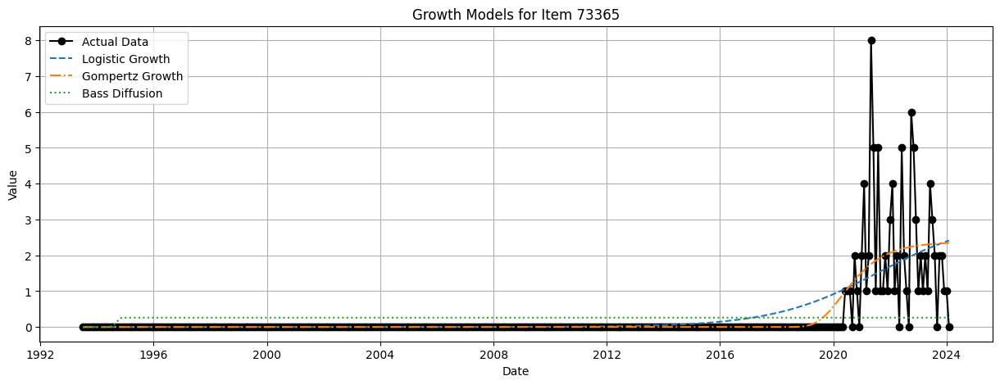

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


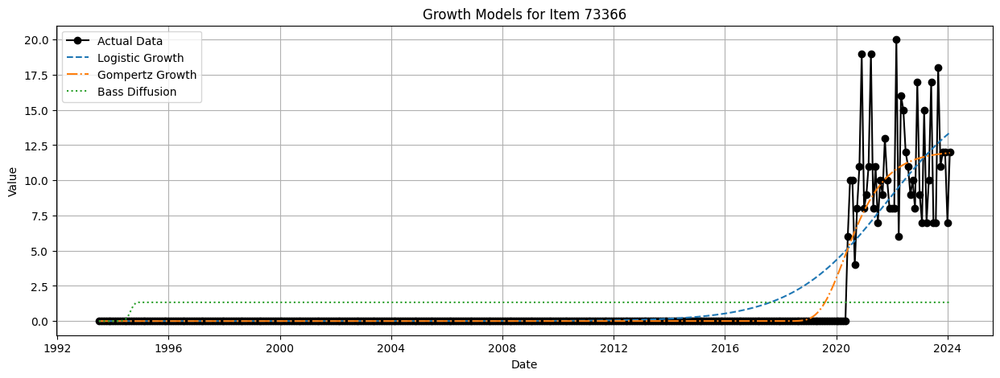

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


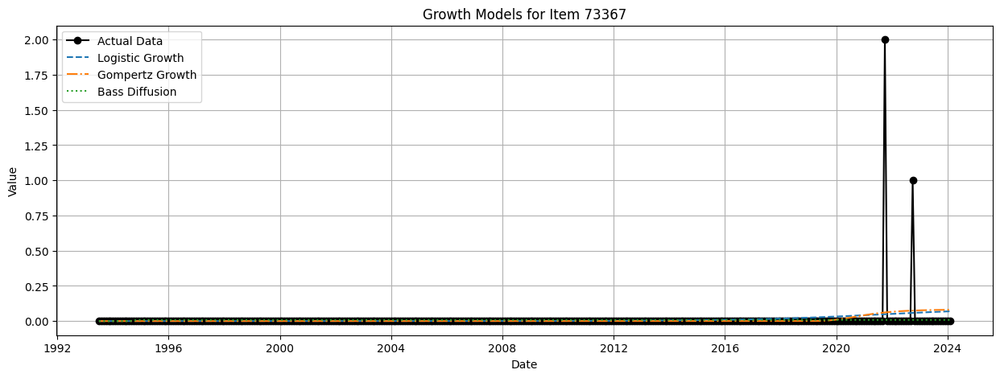

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


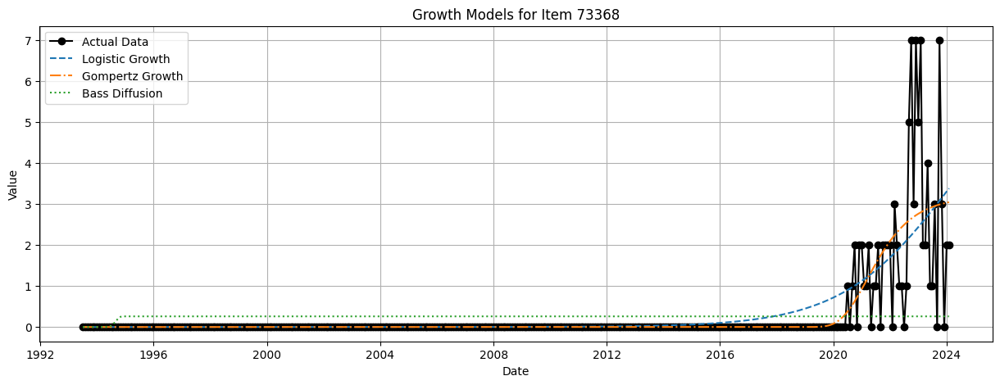

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


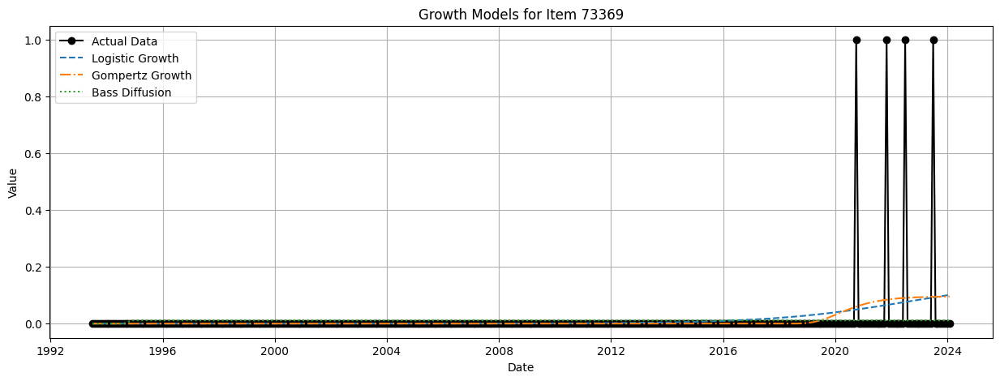

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


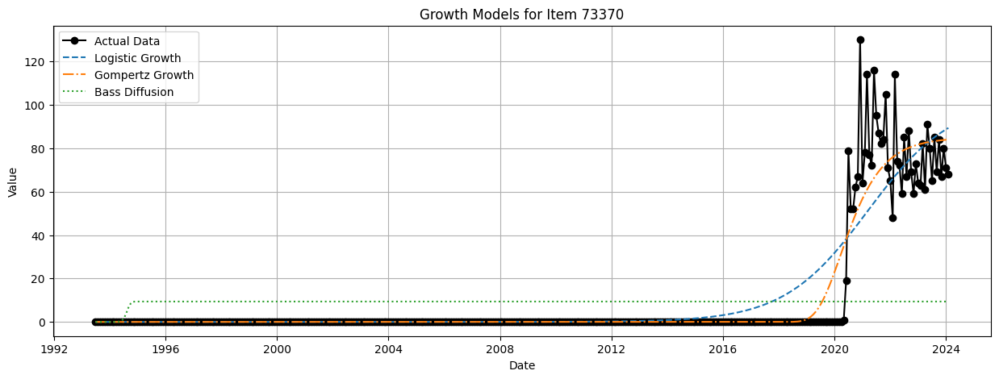

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


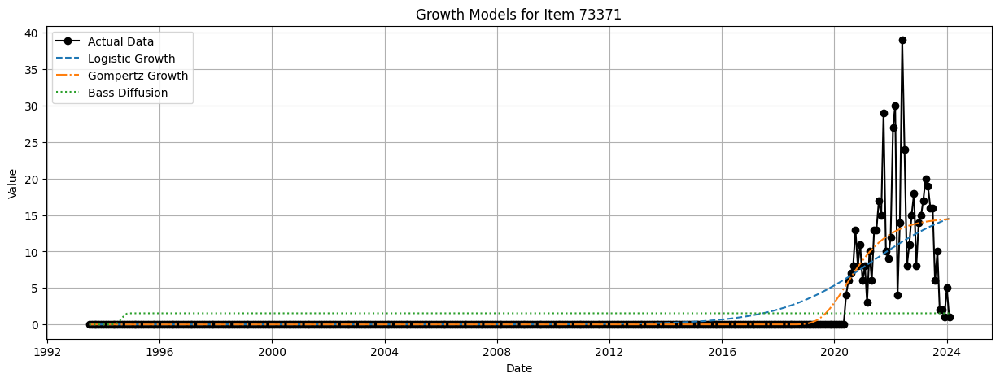

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


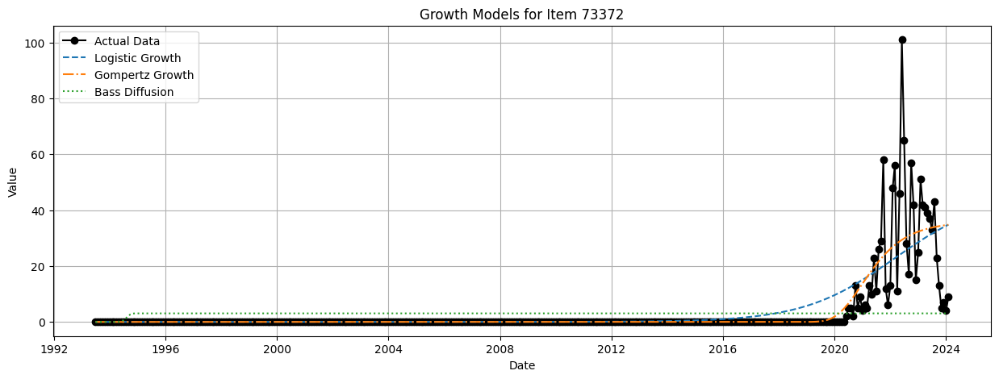

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


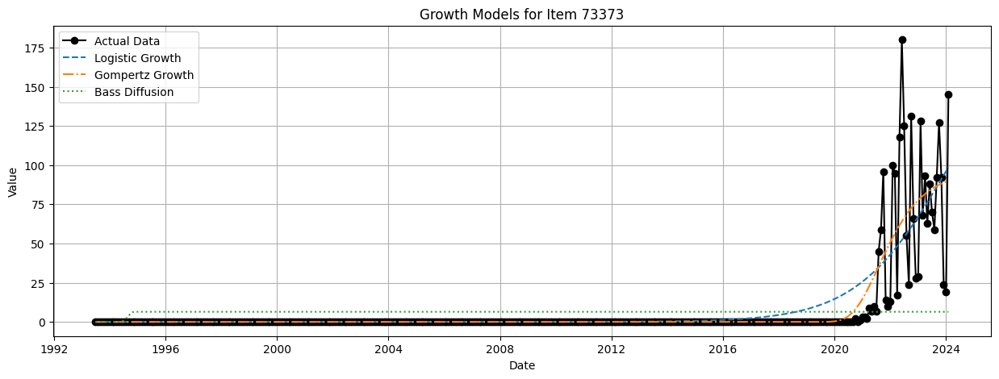

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


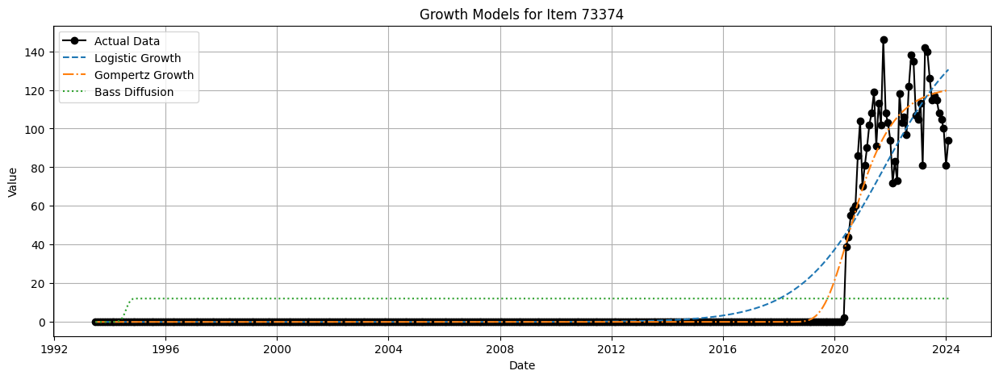

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


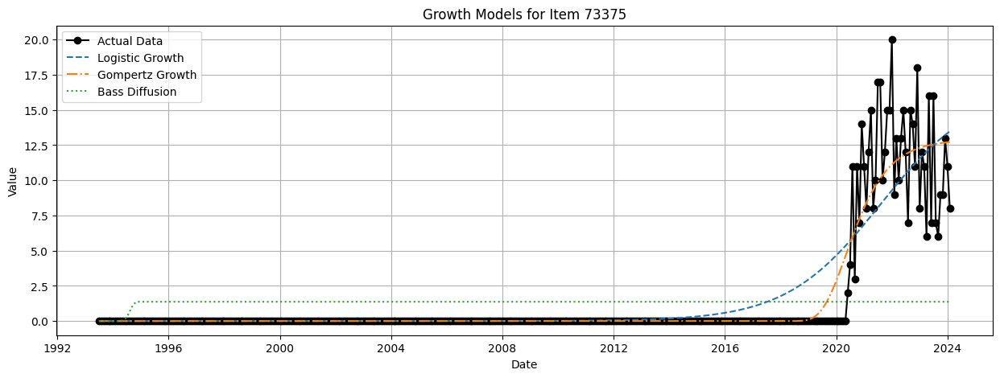

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


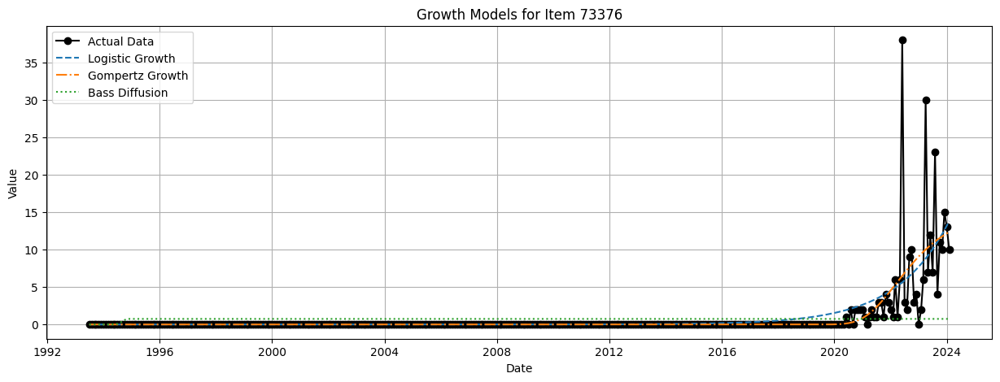

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


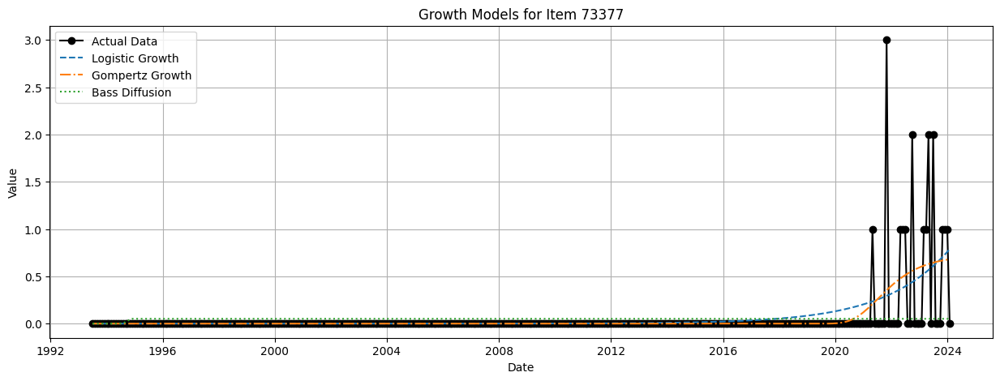

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


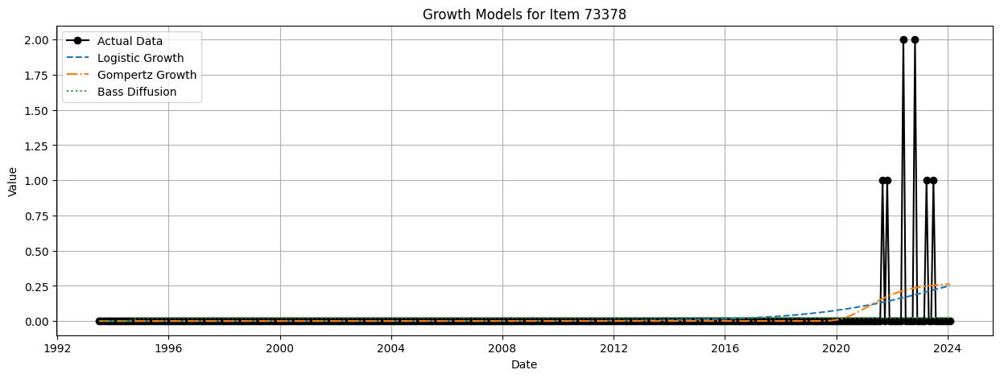

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


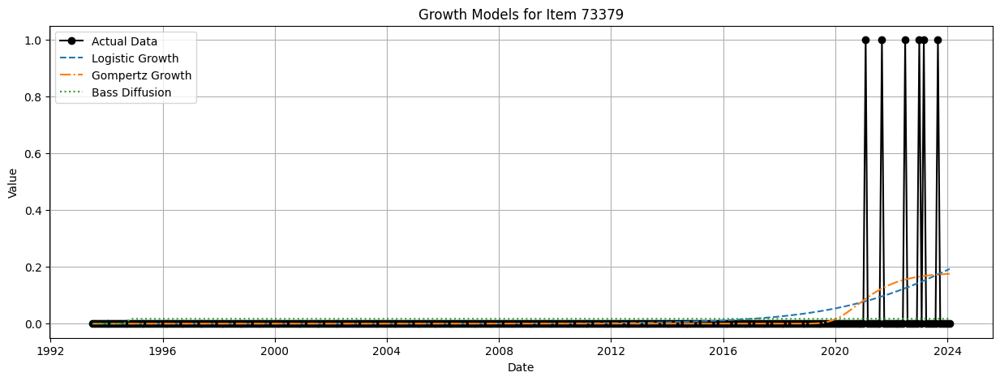

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


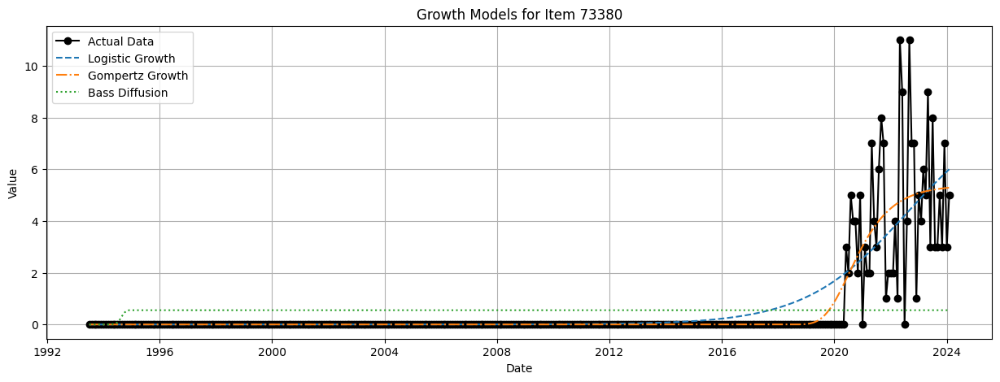

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


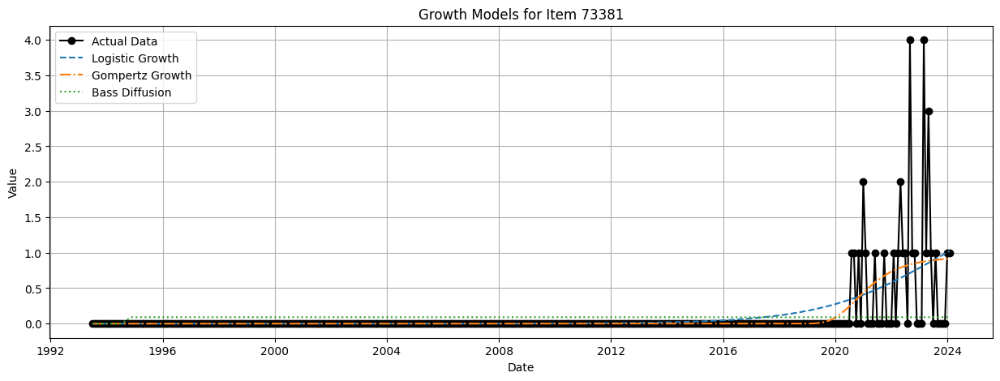

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


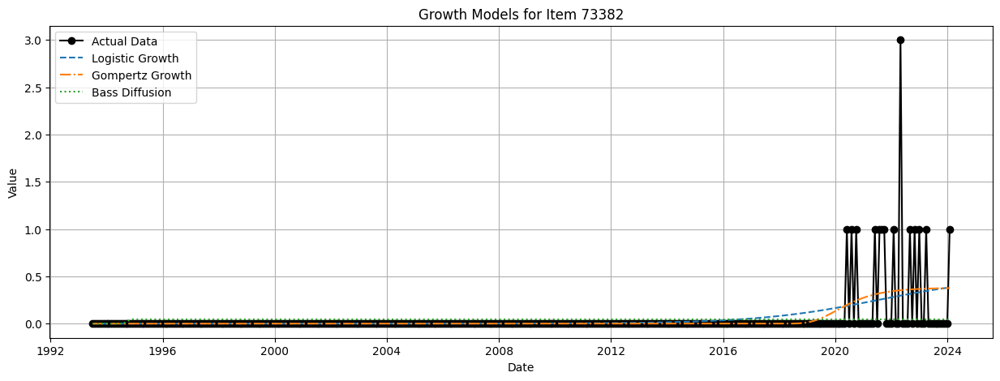

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


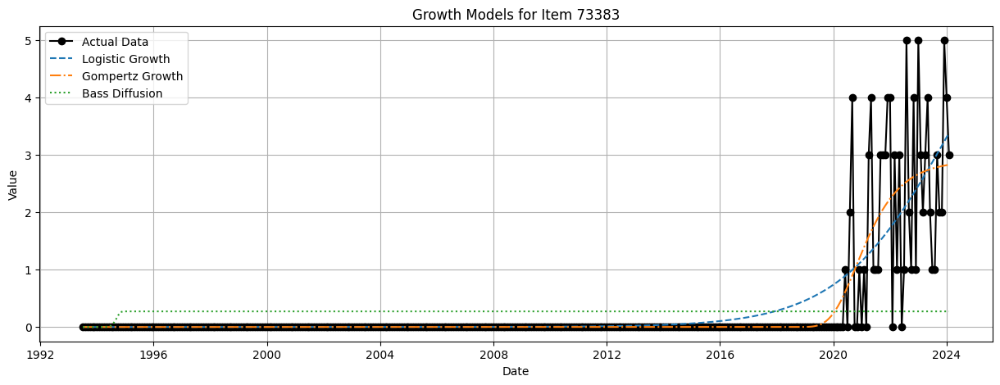

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


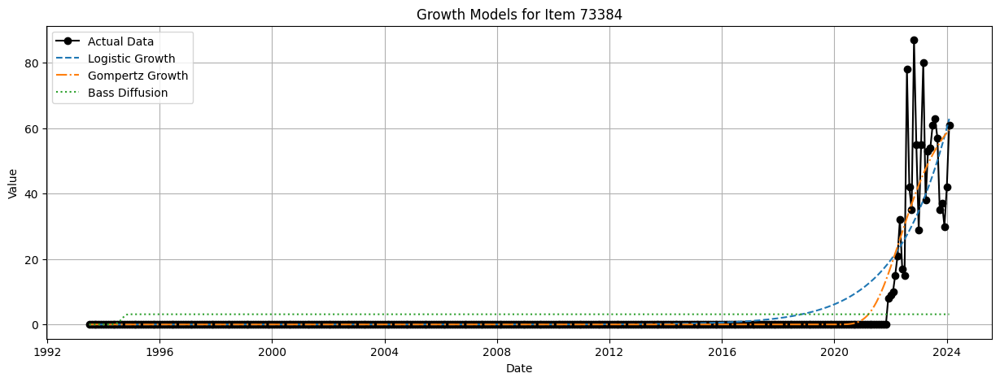

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


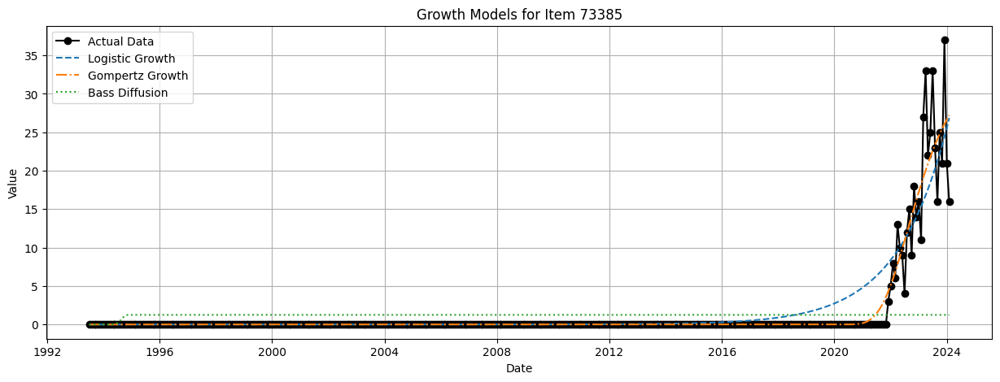

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


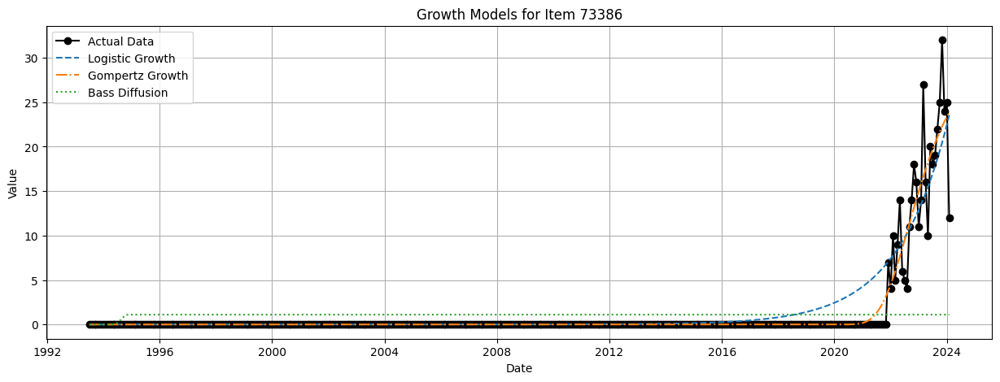

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


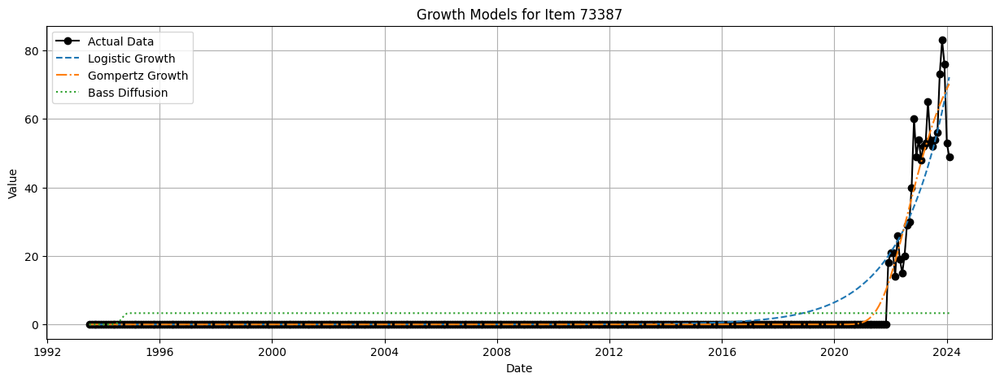

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


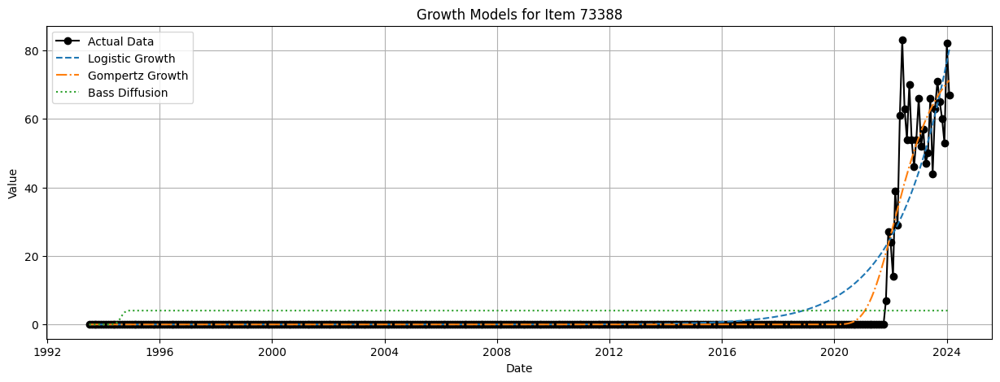

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


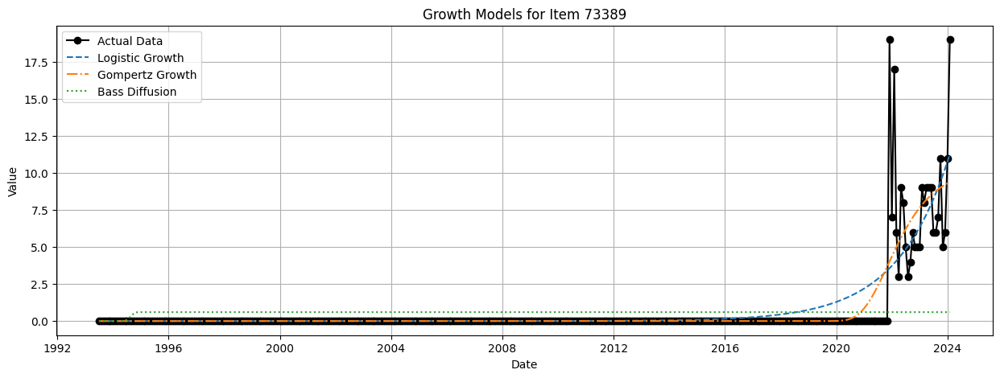

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


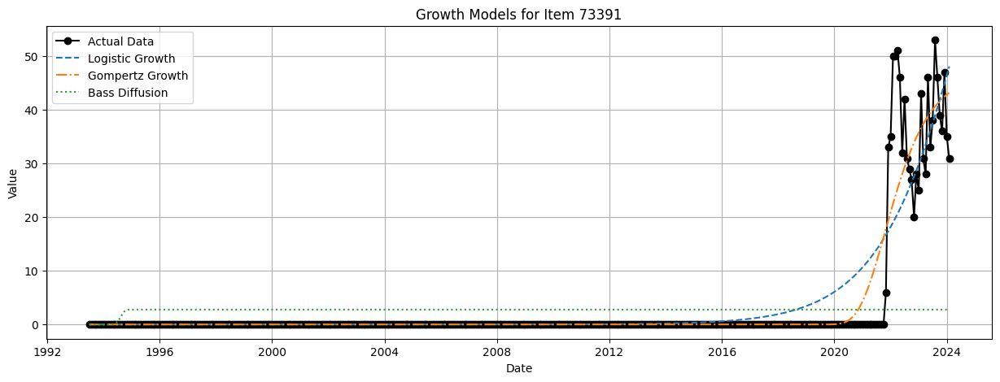

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


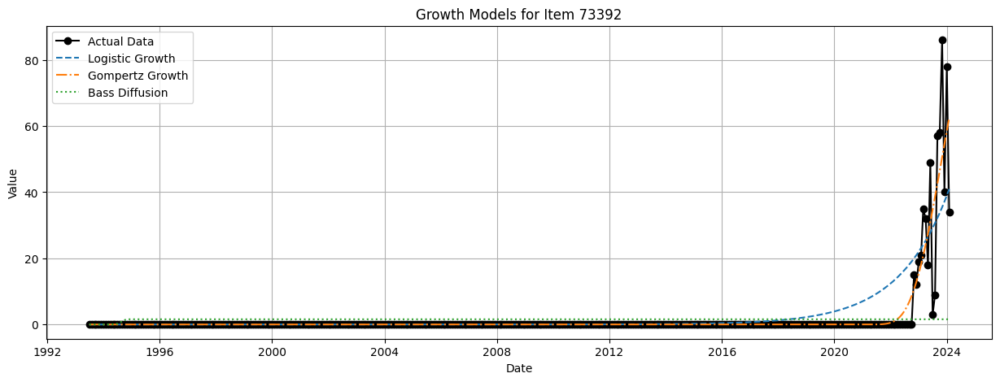

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


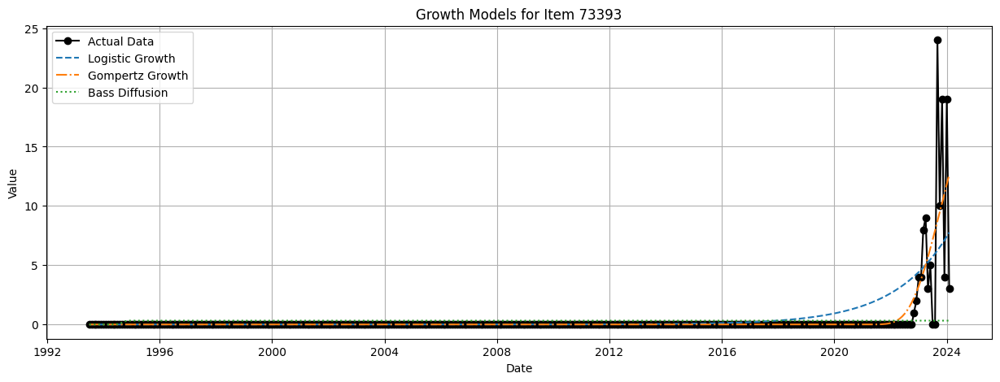

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


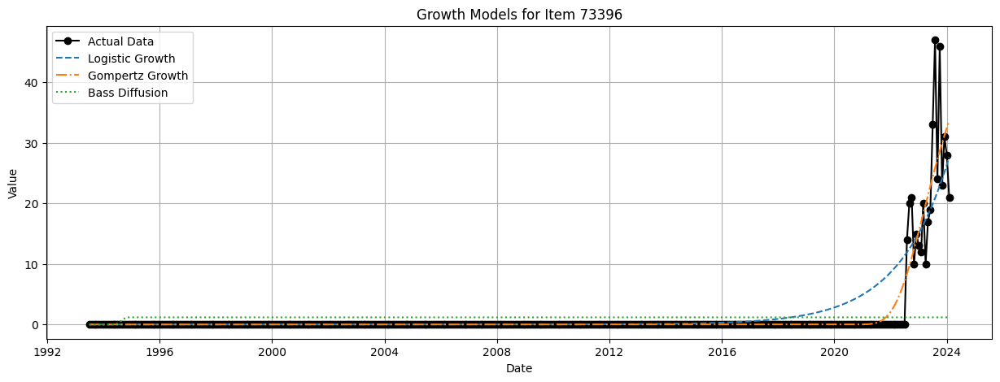

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


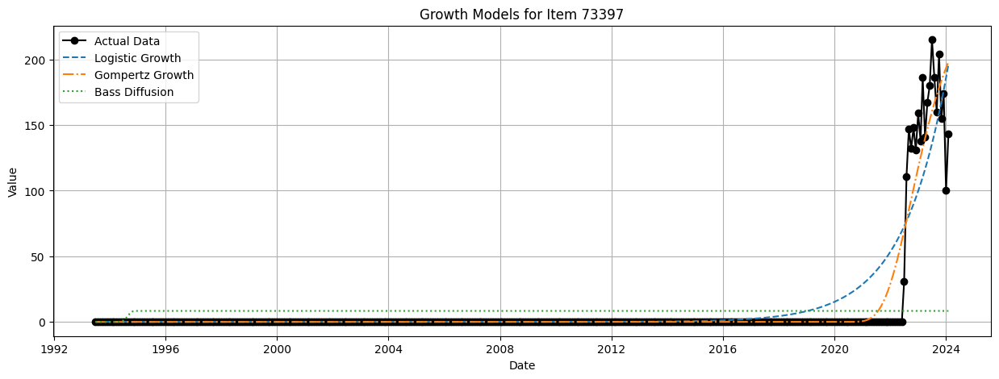

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


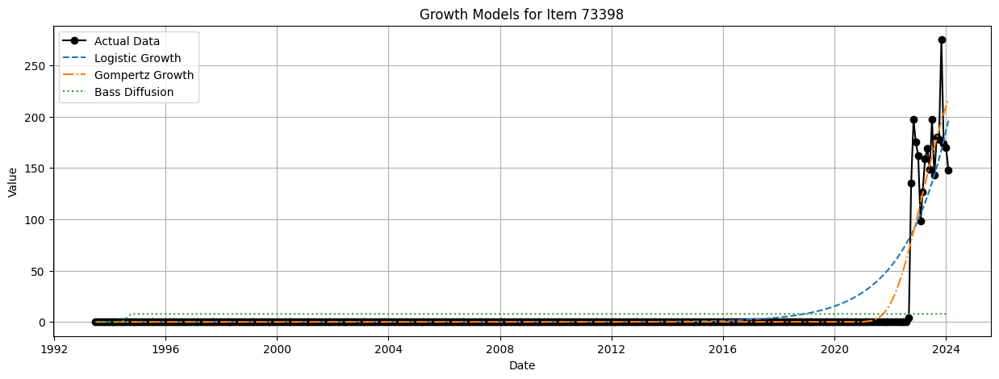

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


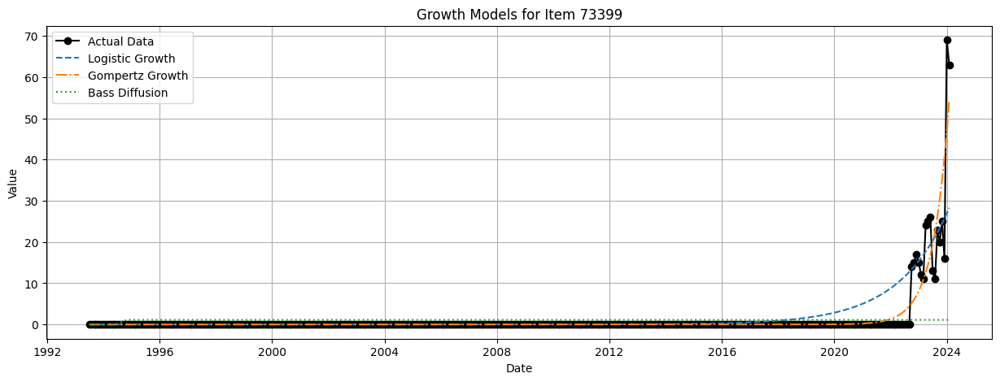

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


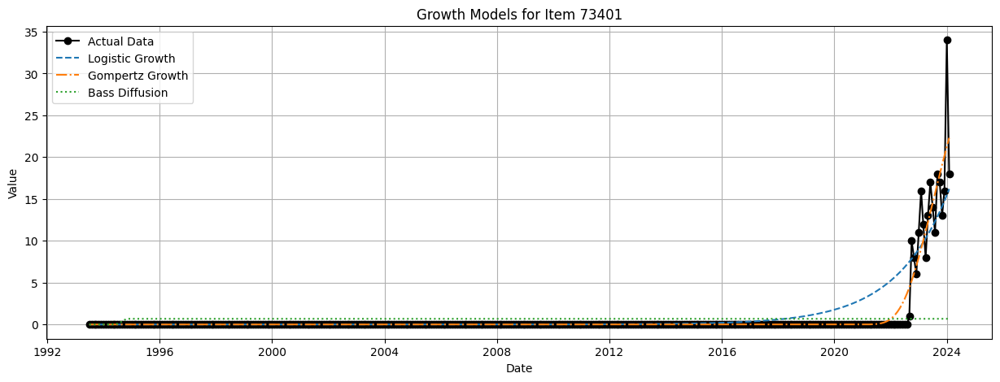

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


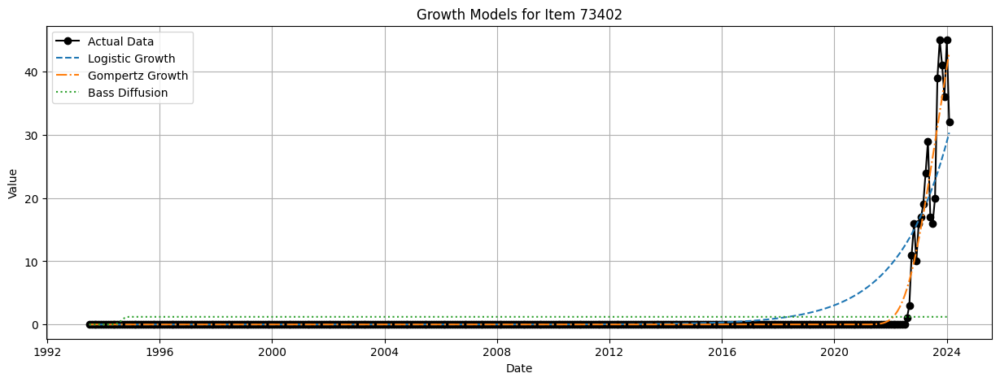

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


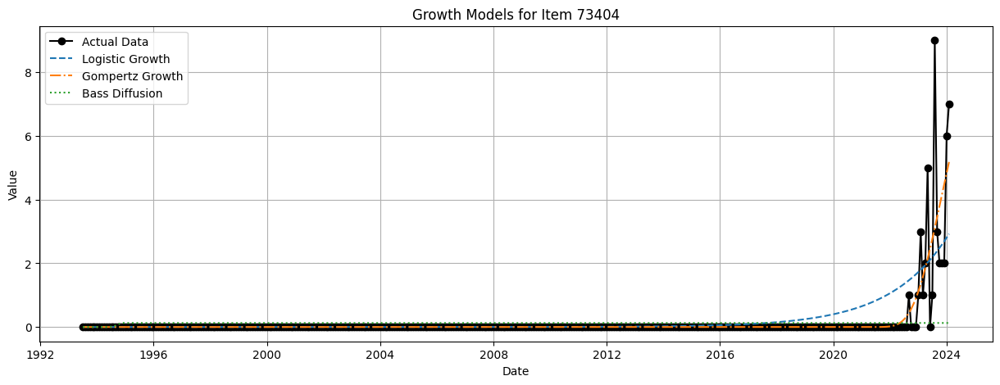

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


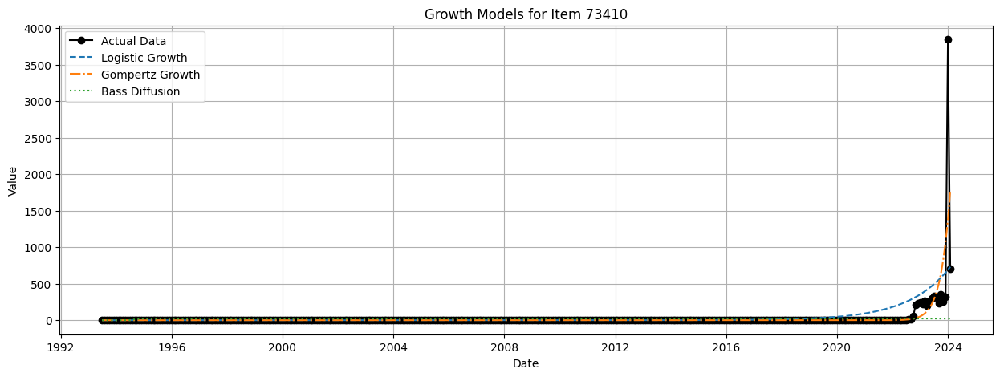

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


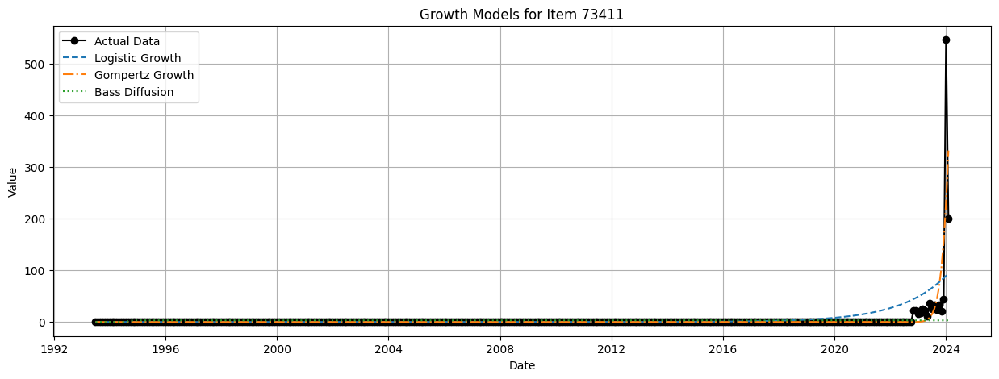

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


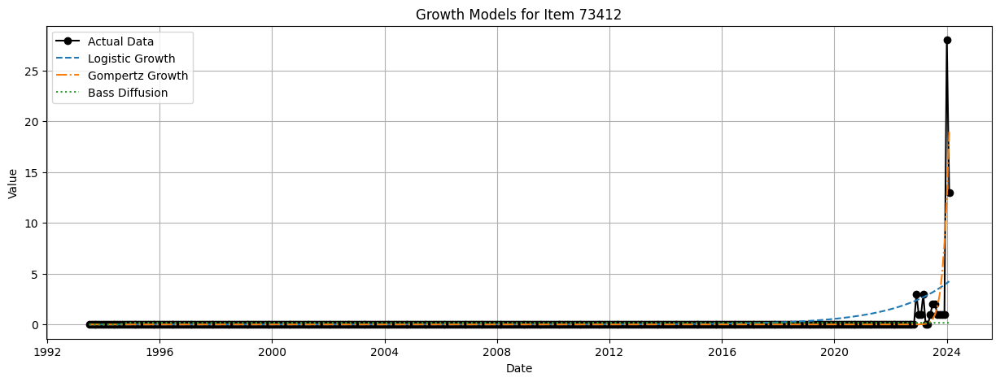

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


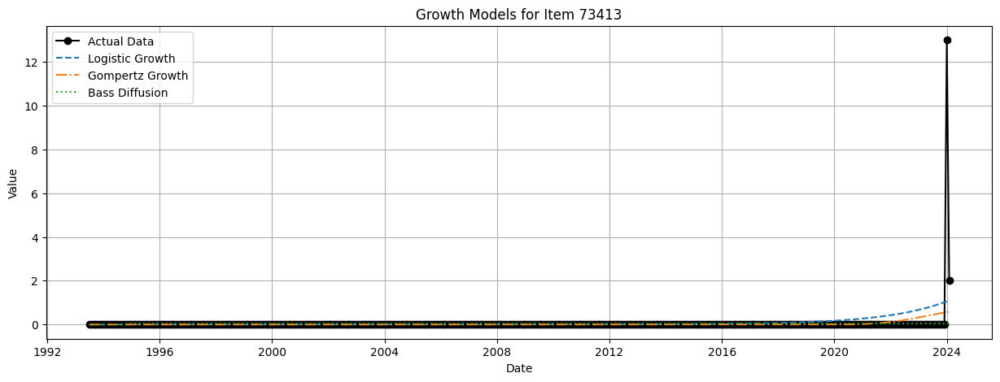

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


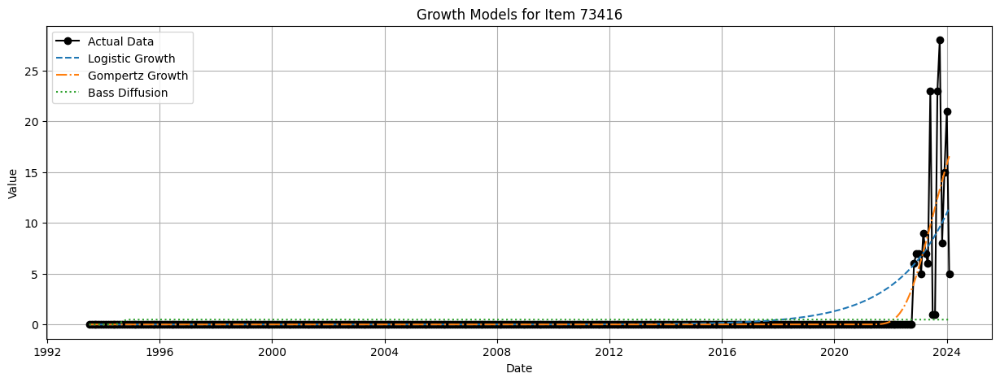

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


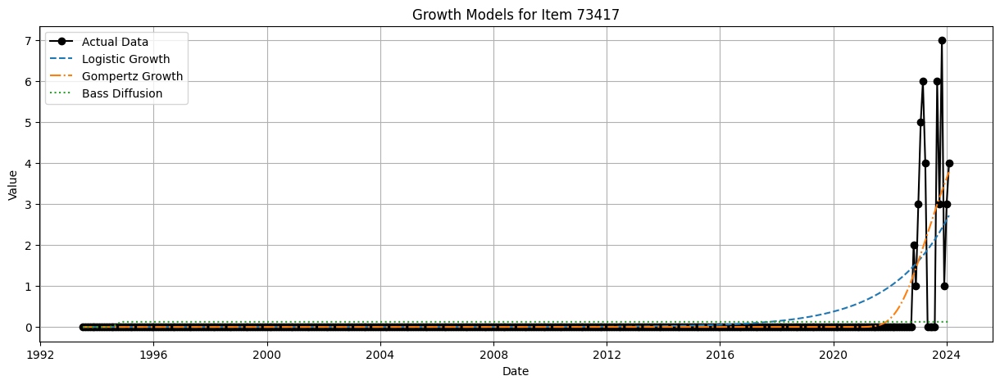

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


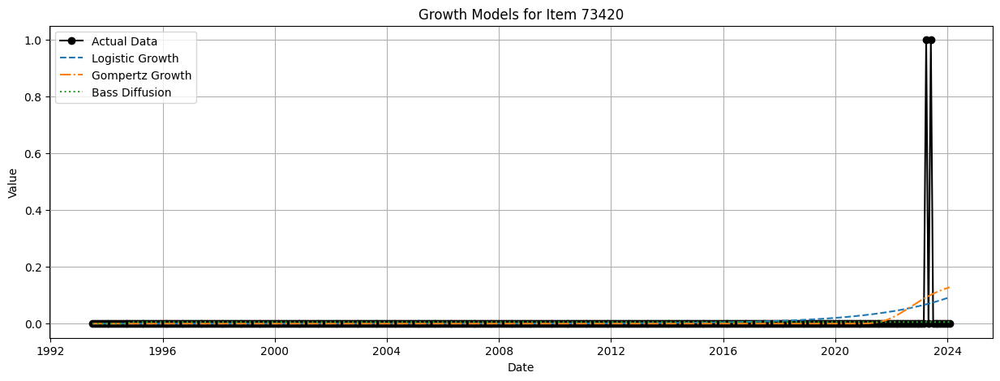

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


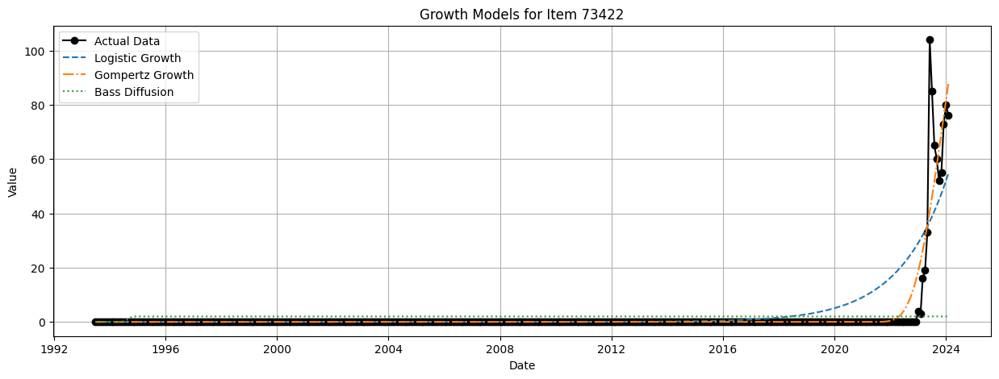

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


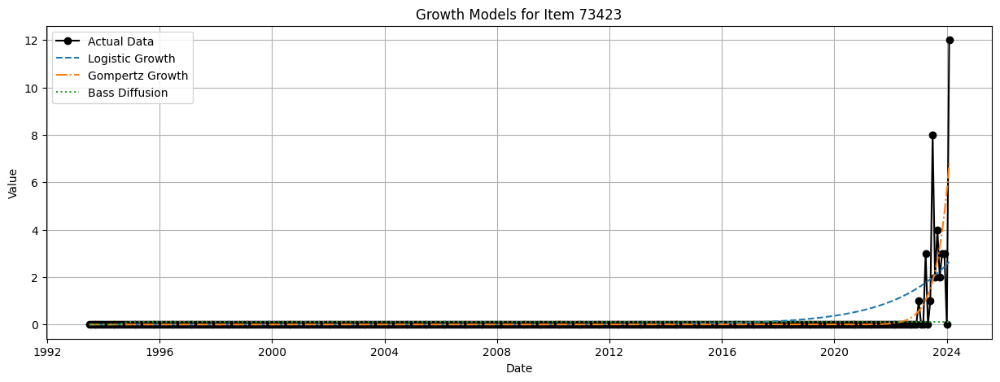

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


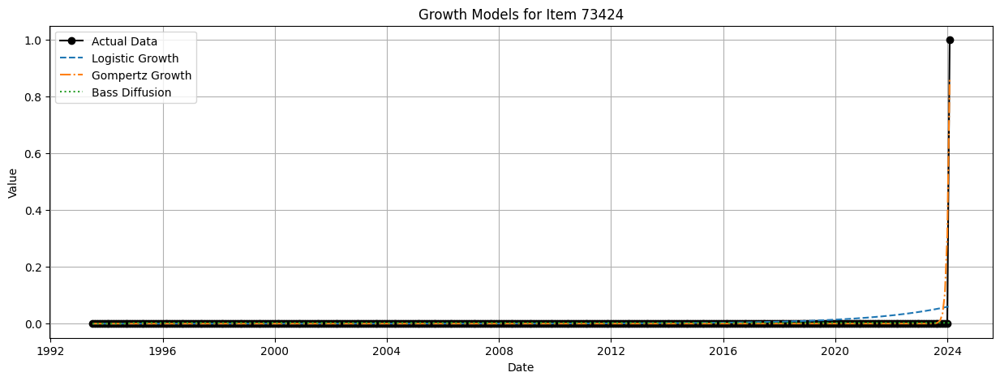

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


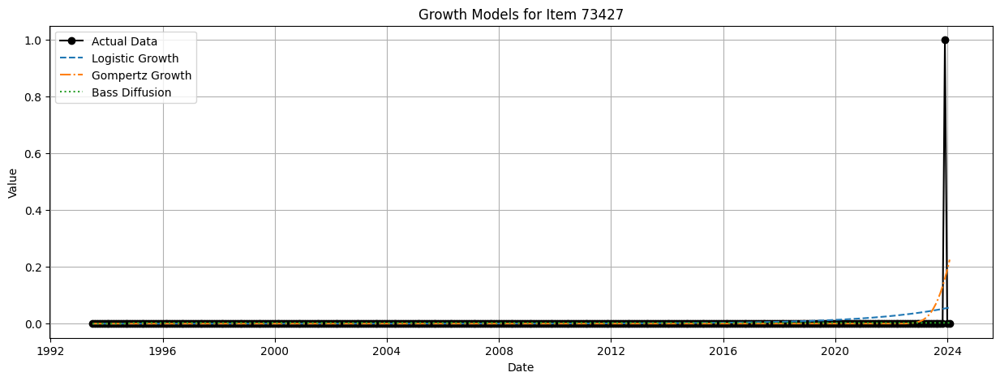

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


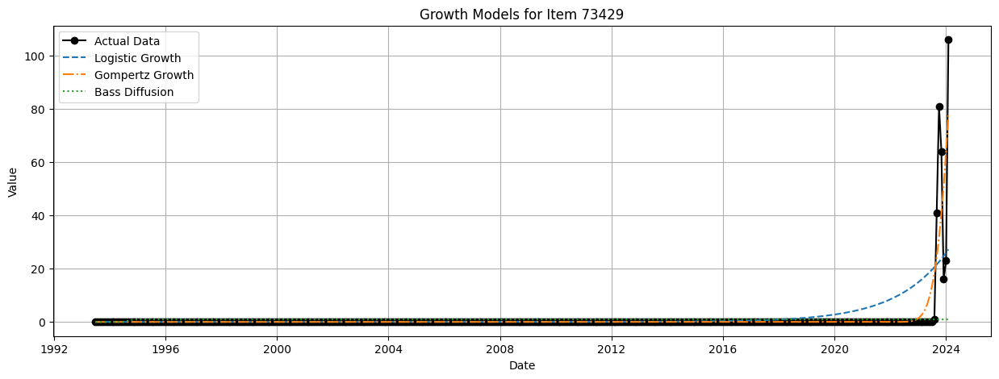

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


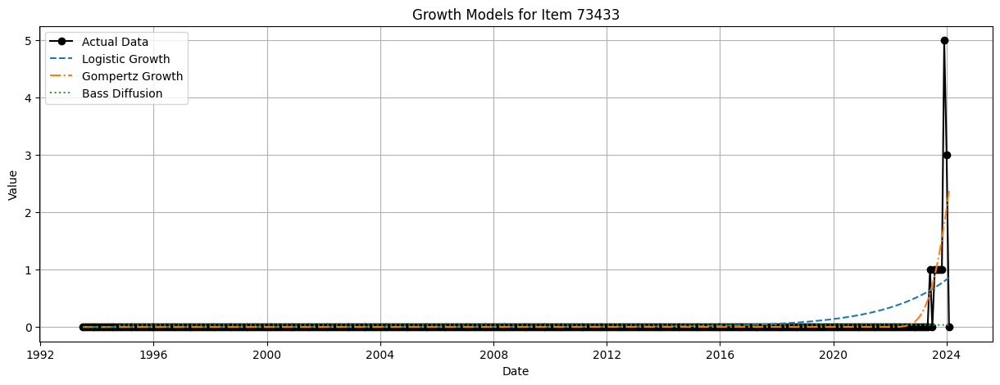

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


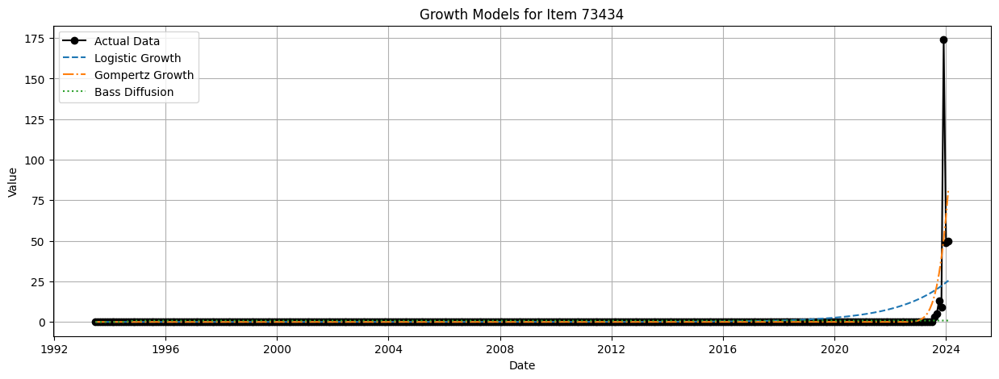

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


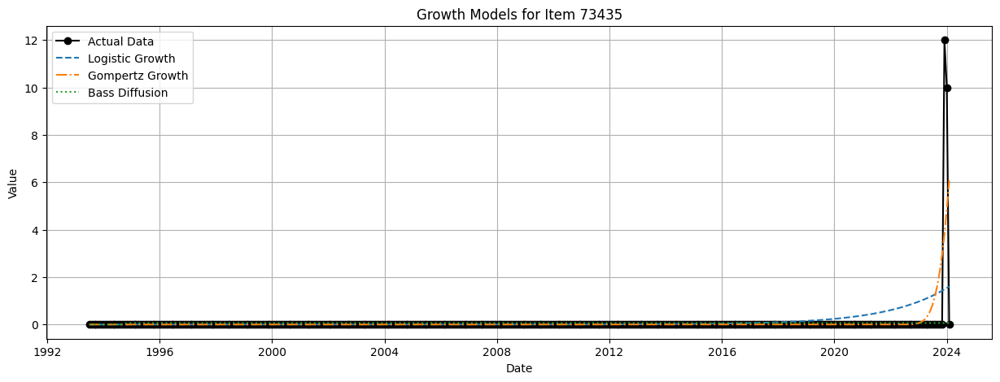

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


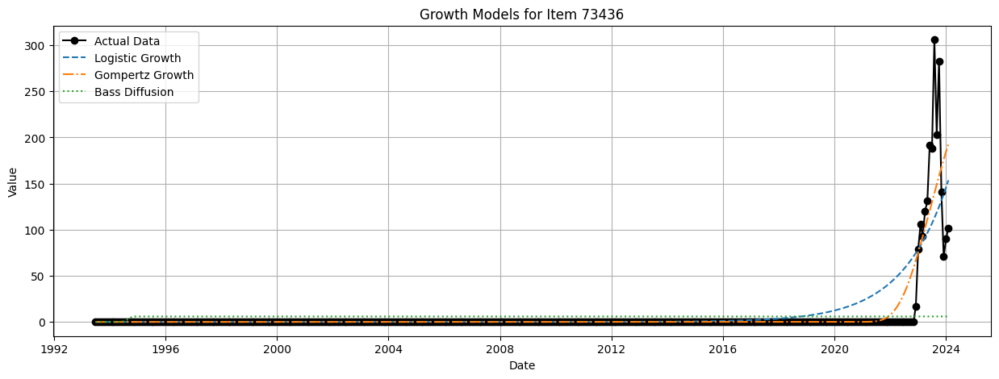

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


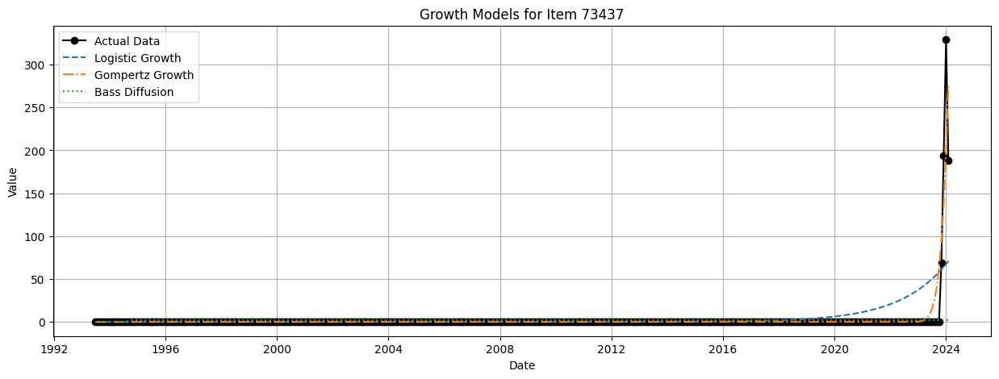

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


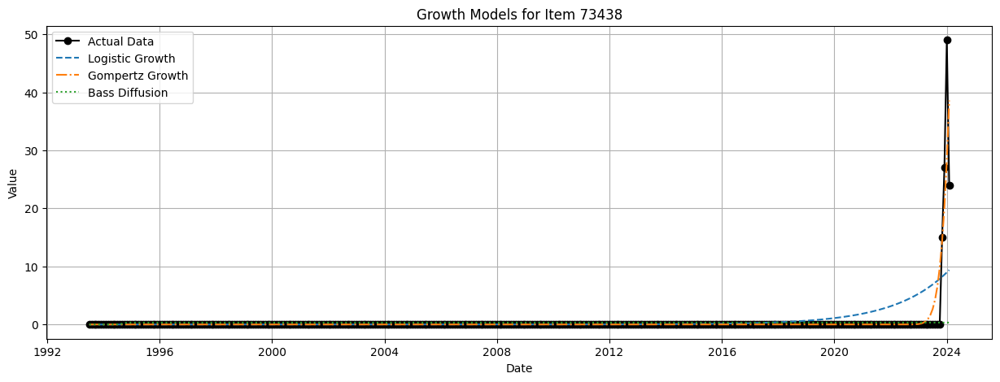

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


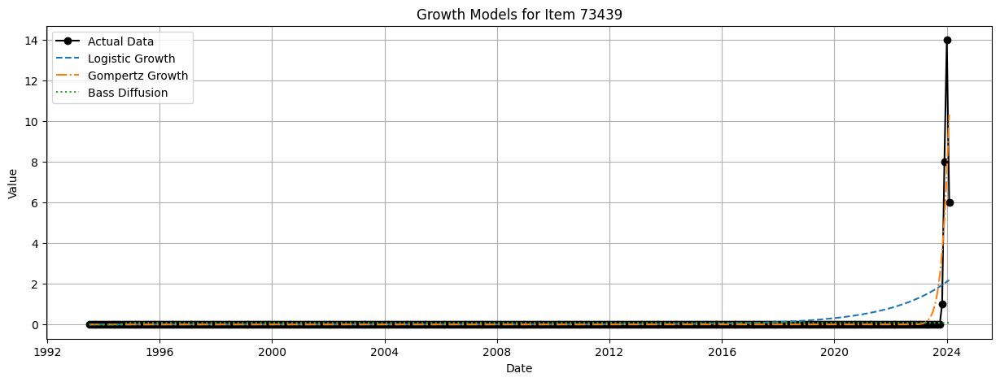

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


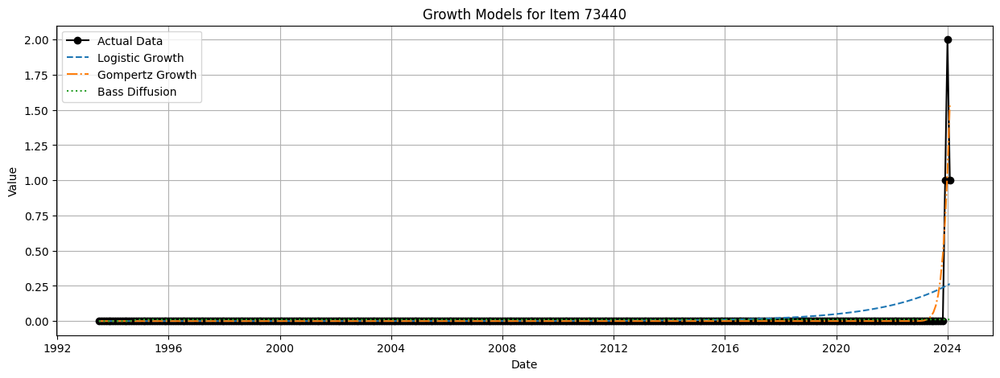

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


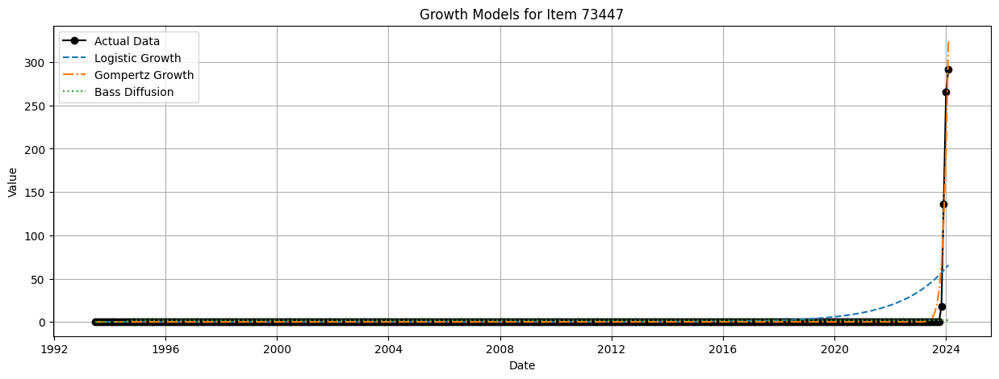

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


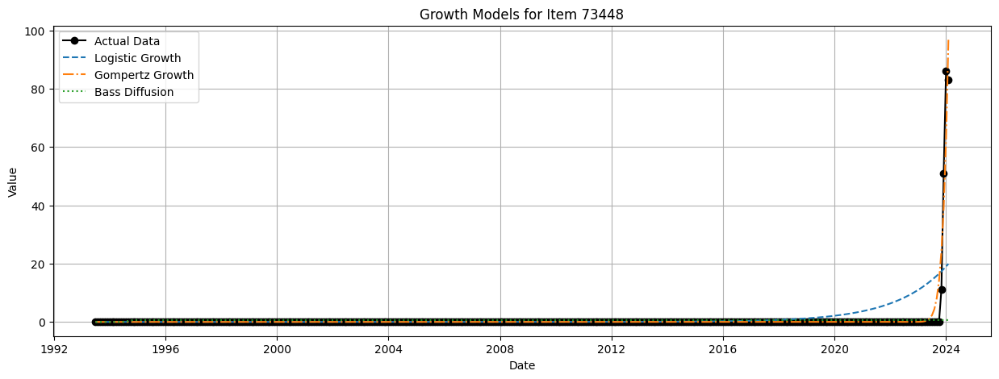

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


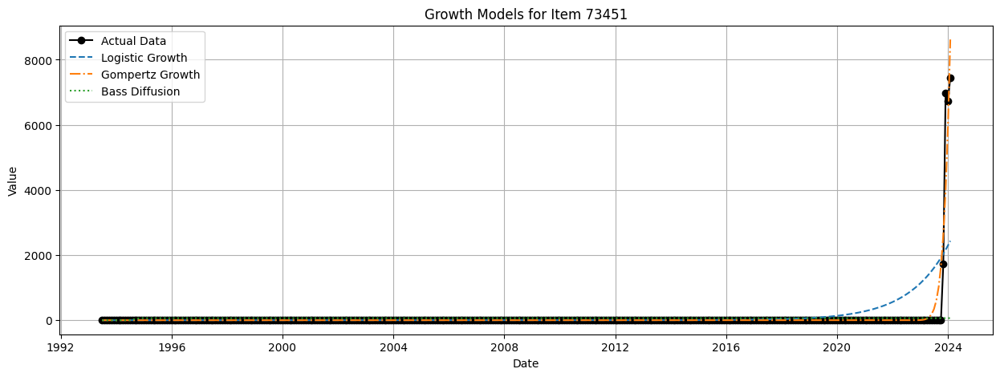

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


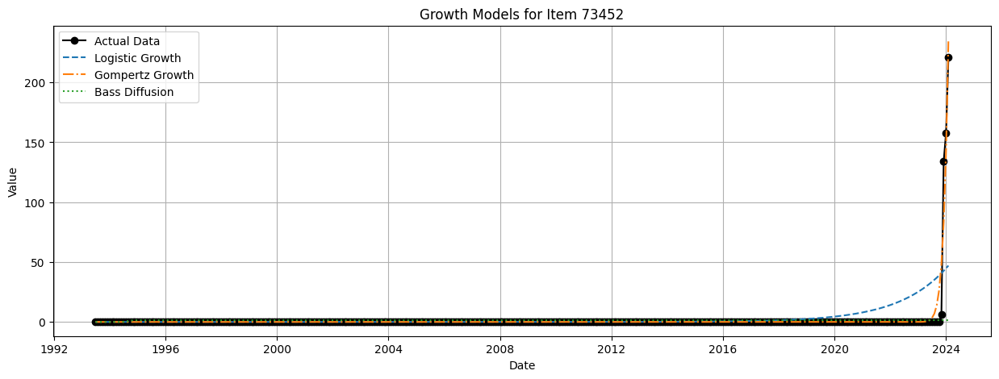

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


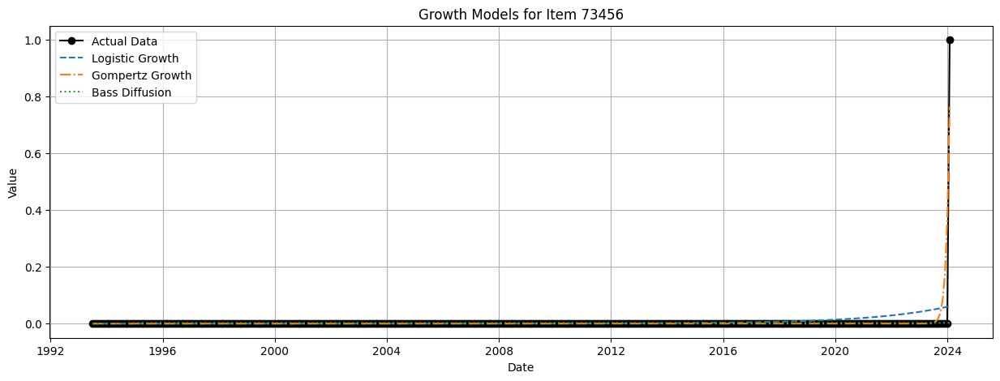

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


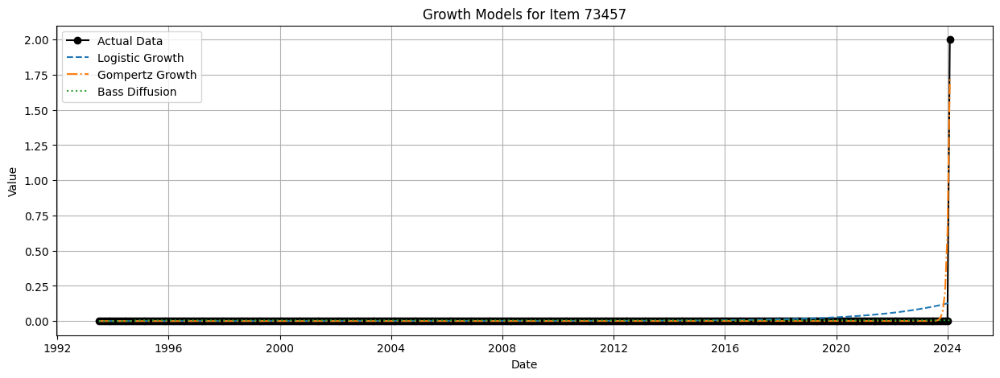

Results for Item 73287:
Logistic Growth Metrics (R², MAE, MAPE, RMSE): (0.04579073994048055, 377.7540813344855, 33.08699408863756, 440.014624031564)
Gompertz Growth Metrics (R², MAE, MAPE, RMSE): (0.046807608253293, 377.329625955105, 32.52231594462198, 439.78010723571117)
Bass Diffusion Metrics (R², MAE, MAPE, RMSE): (0.04767071912697152, 376.7297493426449, 30.751310855345608, 439.5809528144694)


Results for Item 73289:
Logistic Growth Metrics (R², MAE, MAPE, RMSE): (0.9080839007400645, 340.21400842822584, 15.604091200670148, 510.18642056222546)
Gompertz Growth Metrics (R², MAE, MAPE, RMSE): (0.9079723393170726, 340.79009177021953, 15.42680147639043, 510.49594122008835)
Bass Diffusion Metrics (R², MAE, MAPE, RMSE): (0.06310165314253124, 1350.5861619137593, 73.08989219179377, 1628.843422966905)


Results for Item 73290:
Logistic Growth Metrics (R², MAE, MAPE, RMSE): (0.948576787522192, 49.4074156208773, inf, 86.08085072736156)
Gompertz Growth Metrics (R², MAE, MAPE, RMSE): (0.953102314

In [9]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.optimize import curve_fit, least_squares
from sklearn.metrics import r2_score, mean_absolute_error, mean_squared_error

# Load the dataset from the Feather file using pandas
mdf = pd.read_feather("/mnt/c/Users/doughnut/OneDrive - The University of Melbourne/Phase 1 - Study 4 - Australian Genetic and Genomic Test Utilisation/Data Files/Processed_MBSGeneticsCount_20240325_175333.feather")

# Ensure that "Month" is in datetime format
mdf['Month'] = pd.to_datetime(mdf['Month'])

# Group data by 'Month' and 'Item' and calculate the sum of 'Value' with observed=False to prevent warnings
df = mdf.groupby(['Month', 'Item'], observed=False)['Value'].sum().reset_index()

# Make all values positive
df['Value'] = df['Value'].abs()

# Rename the "Month" and "Value" columns
df = df.rename(columns={"Month": "ds", "Value": "y"})

# Convert the "ds" column to ordinal to use in growth models
df['ds_ordinal'] = df['ds'].apply(lambda x: x.toordinal())

# Define the logistic, Gompertz, and Bass diffusion models
def logistic_growth(t, K, P0, r):
    P0 = max(P0, 1e-6)  # Add a small constant to avoid division by zero
    return K / (1 + ((K - P0) / P0) * np.exp(-r * t))

def gompertz_growth(t, a, b, c):
    return a * np.exp(-b * np.exp(-c * t))

def bass_diffusion(t, p, q, m):
    # Prevent overflow by limiting the input to exp()
    t = np.clip(t, -500, 500)
    return m * (1 - np.exp(-(p + q) * t)) / (1 + (q / p) * np.exp(-(p + q) * t))

# Optimized initial guess function for Gompertz model
def optimize_initial_guesses(func, t_data, y_data, param_ranges, num_trials=100):
    best_params = None
    best_r2 = -np.inf
    
    for _ in range(num_trials):
        initial_guesses = [np.random.uniform(low, high) for low, high in param_ranges]
        
        try:
            params, _ = curve_fit(func, t_data, y_data, p0=initial_guesses, bounds=([0, 0, 0], [np.inf, np.inf, np.inf]), maxfev=5000)
            y_pred = func(t_data, *params)
            r2 = r2_score(y_data, y_pred)
            if r2 > best_r2:
                best_r2 = r2
                best_params = params
        except RuntimeError:
            continue
    
    return best_params, best_r2

# Define ranges for the Gompertz parameters (a, b, c)
gompertz_param_ranges = [(0.8 * max(df['y']), 1.2 * max(df['y'])), (0.001, 2), (0.001, 2)]

# Bass diffusion fitting using least_squares
def fit_bass_diffusion(t_data, y_data, initial_params):
    def residuals(params, t_data, y_data):
        p, q, m = params
        model_values = bass_diffusion(t_data, p, q, m)
        return model_values - y_data
    
    result = least_squares(residuals, initial_params, args=(t_data, y_data), bounds=([0, 0, 0], [np.inf, np.inf, np.inf]), max_nfev=10000)
    return result.x

# Loop over each unique Item and apply the models
items = df['Item'].unique()
results = []

for item in items:
    df_item = df[df['Item'] == item].copy()
    t_data = df_item['ds_ordinal'] - df_item['ds_ordinal'].min()
    y_data = df_item['y']

    # Fit the logistic model
    logistic_params, _ = curve_fit(logistic_growth, t_data, y_data, p0=[max(y_data), min(y_data), 0.1], maxfev=5000)

    # Fit the Gompertz model with optimized initial guesses
    gompertz_params, gompertz_r2 = optimize_initial_guesses(gompertz_growth, t_data, y_data, gompertz_param_ranges)

    # Fit the Bass diffusion model using least_squares
    bass_params = fit_bass_diffusion(t_data, y_data, initial_params=[0.03, 0.38, max(y_data)])

    # Generate predictions
    df_item['logistic_pred'] = logistic_growth(t_data, *logistic_params)
    df_item['gompertz_pred'] = gompertz_growth(t_data, *gompertz_params)
    df_item['bass_pred'] = bass_diffusion(t_data, *bass_params)

    # Ensure predictions contain no invalid values
    df_item.replace([np.inf, -np.inf, np.nan], 0, inplace=True)

    # Define evaluation metrics
    def calculate_metrics(y_true, y_pred):
        r2 = r2_score(y_true, y_pred)
        mae = mean_absolute_error(y_true, y_pred)
        mape = np.mean(np.abs((y_true - y_pred) / y_true)) * 100
        rmse = np.sqrt(mean_squared_error(y_true, y_pred))
        return r2, mae, mape, rmse

    # Calculate metrics for each model
    logistic_metrics = calculate_metrics(df_item['y'], df_item['logistic_pred'])
    gompertz_metrics = calculate_metrics(df_item['y'], df_item['gompertz_pred'])
    bass_metrics = calculate_metrics(df_item['y'], df_item['bass_pred'])

    results.append({
        "Item": item,
        "Logistic_Metrics": logistic_metrics,
        "Gompertz_Metrics": gompertz_metrics,
        "Bass_Metrics": bass_metrics
    })

    # Plot the results for this item
    plt.figure(figsize=(15, 5))
    plt.plot(df_item['ds'], df_item['y'], label='Actual Data', color='black', marker='o')
    plt.plot(df_item['ds'], df_item['logistic_pred'], label='Logistic Growth', linestyle='--')
    plt.plot(df_item['ds'], df_item['gompertz_pred'], label='Gompertz Growth', linestyle='-.')
    plt.plot(df_item['ds'], df_item['bass_pred'], label='Bass Diffusion', linestyle=':')
    plt.xlabel('Date')
    plt.ylabel('Value')
    plt.title(f'Growth Models for Item {item}')
    plt.legend()
    plt.grid(True)
    plt.show()

# Display final results
for result in results:
    print(f"Results for Item {result['Item']}:")
    print("Logistic Growth Metrics (R², MAE, MAPE, RMSE):", result['Logistic_Metrics'])
    print("Gompertz Growth Metrics (R², MAE, MAPE, RMSE):", result['Gompertz_Metrics'])
    print("Bass Diffusion Metrics (R², MAE, MAPE, RMSE):", result['Bass_Metrics'])
    print("\n")


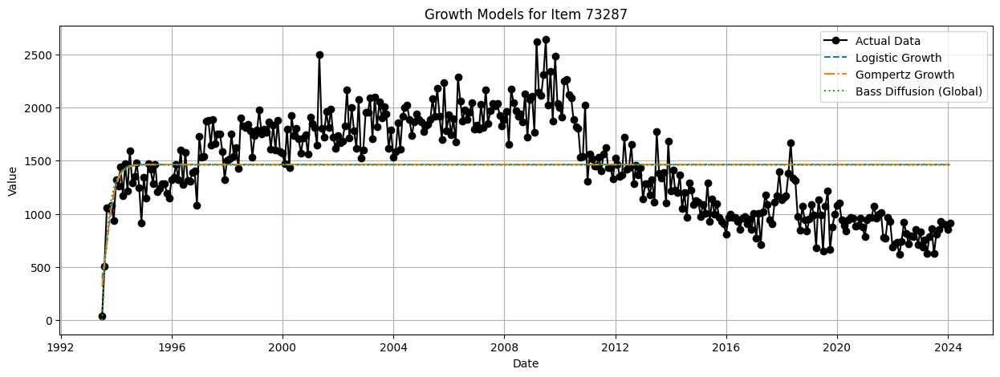

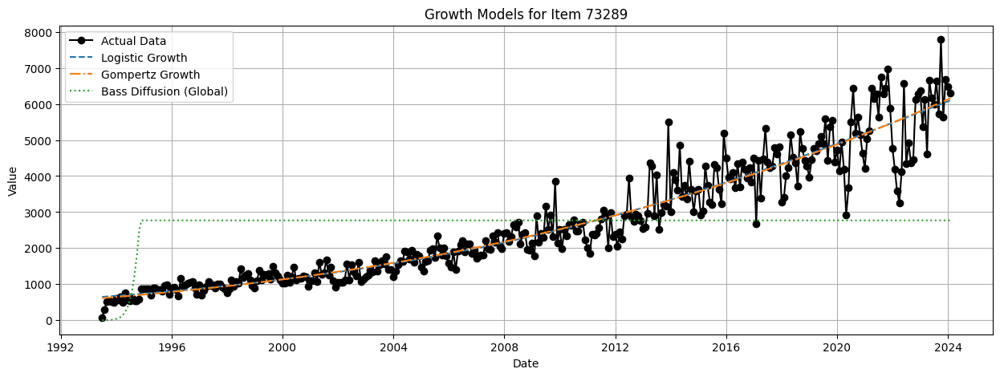

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


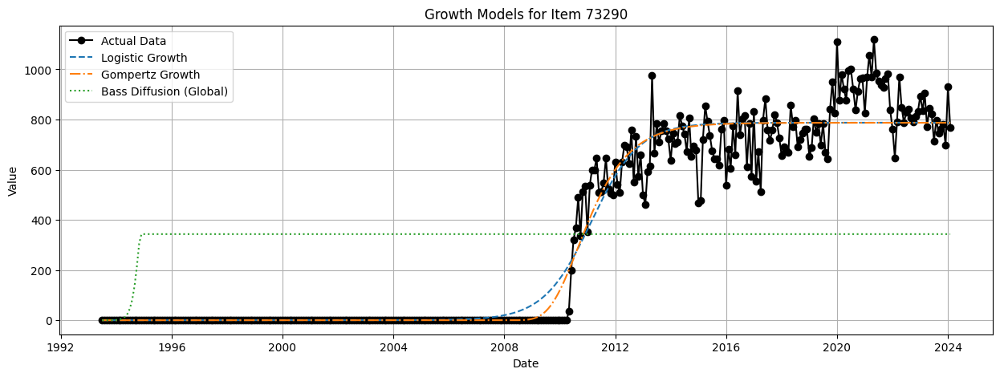

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


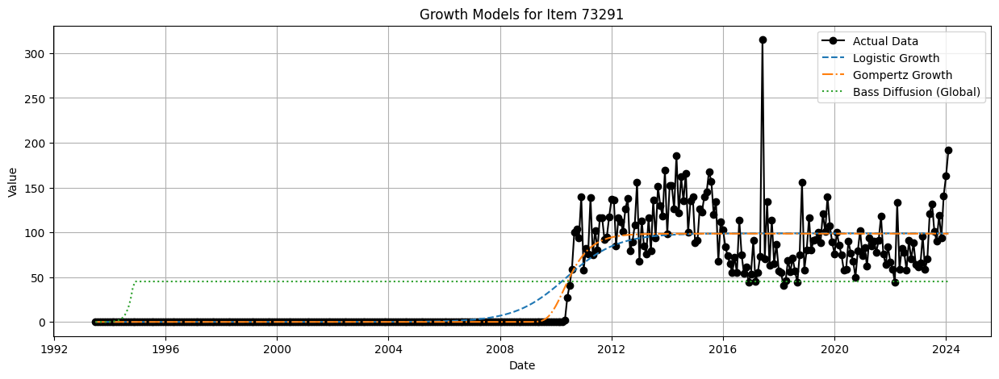

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


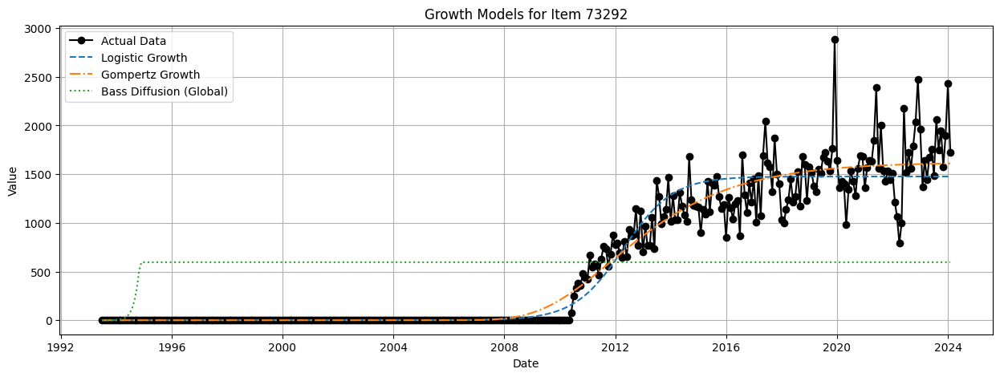

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


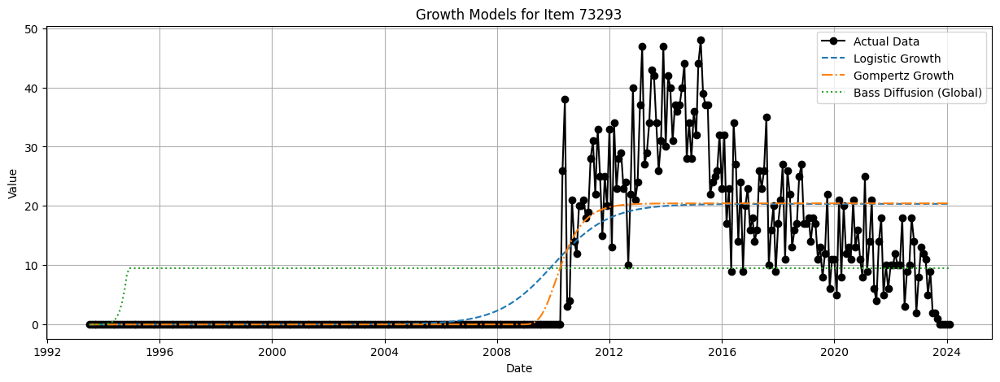

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


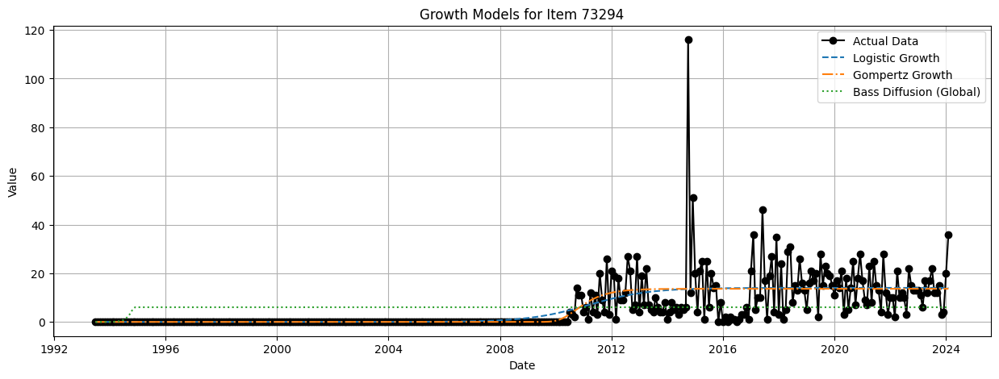

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


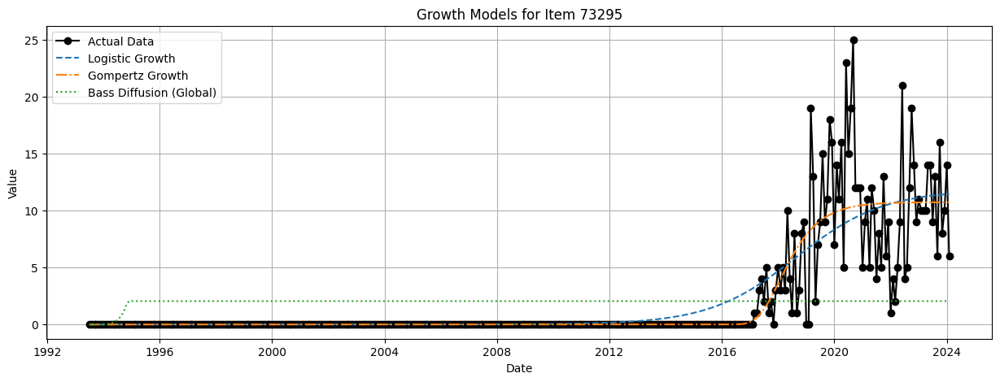

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


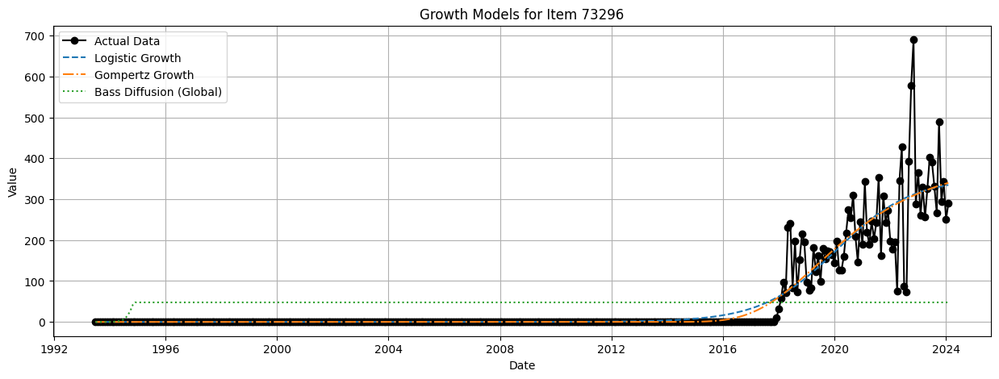

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


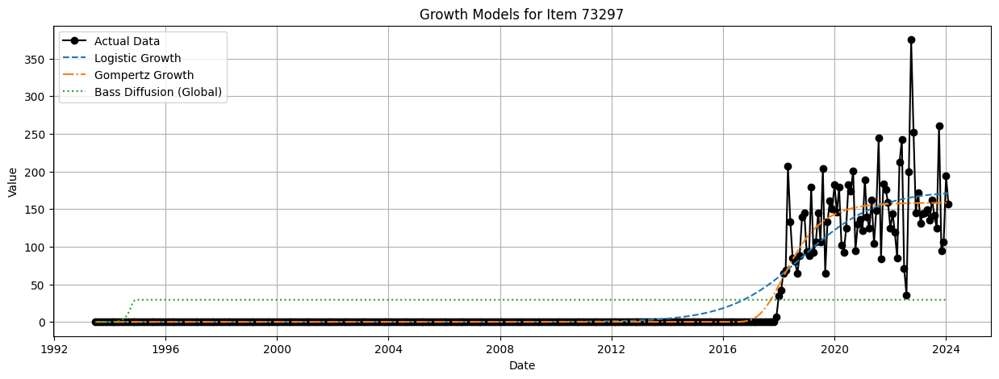

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


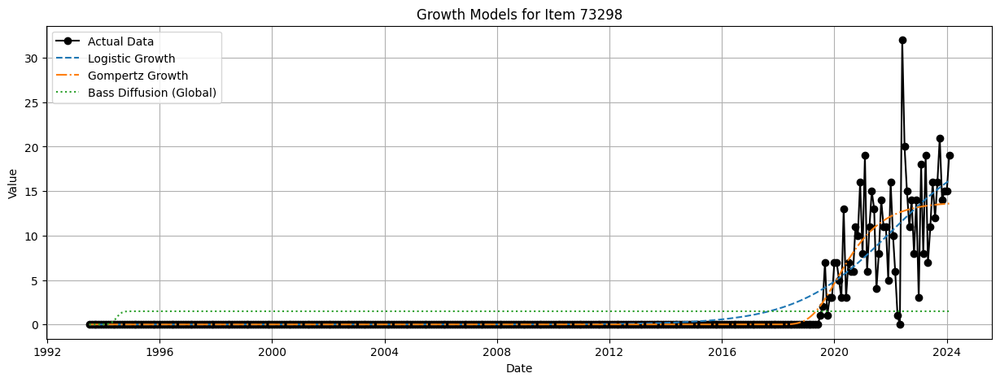

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


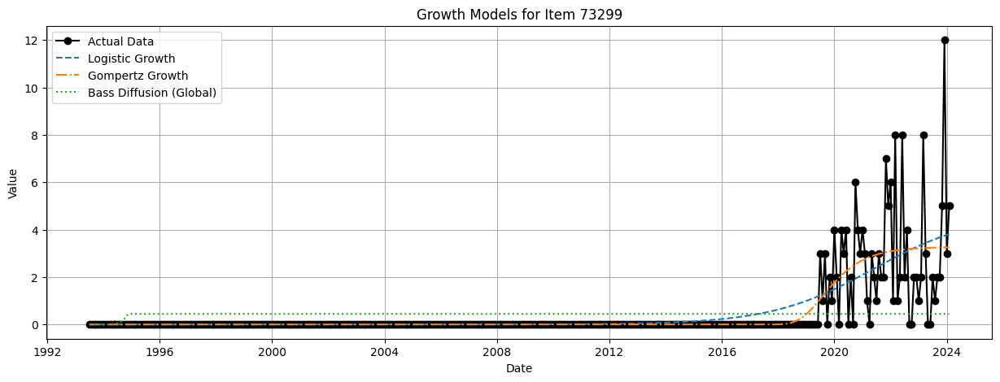

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


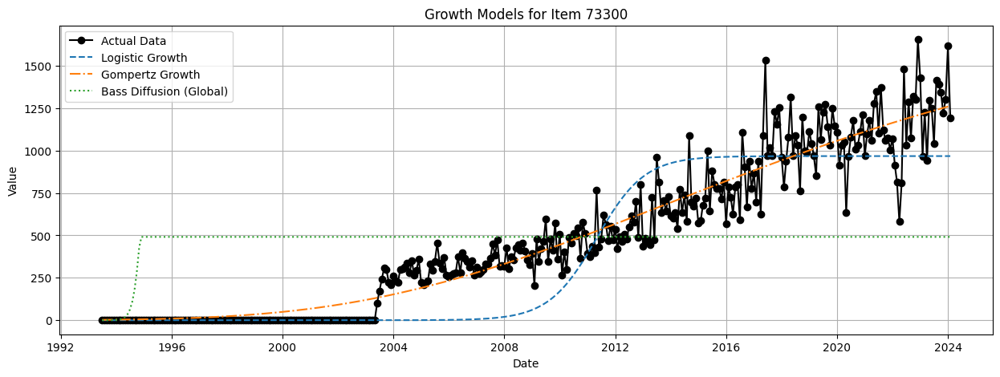

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


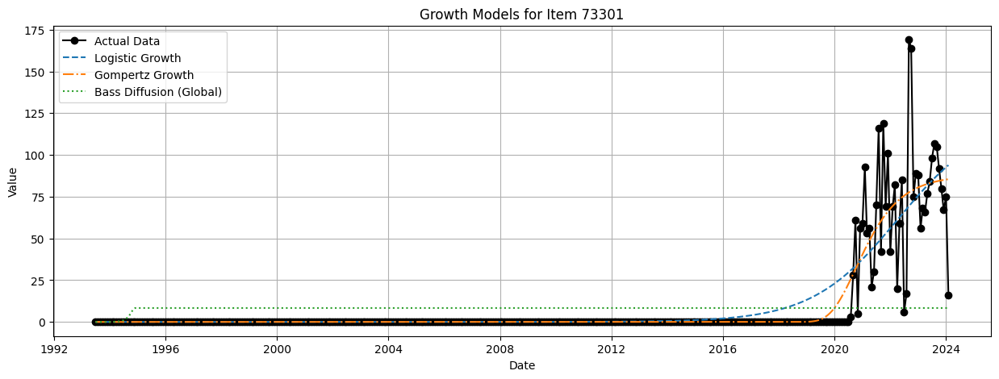

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


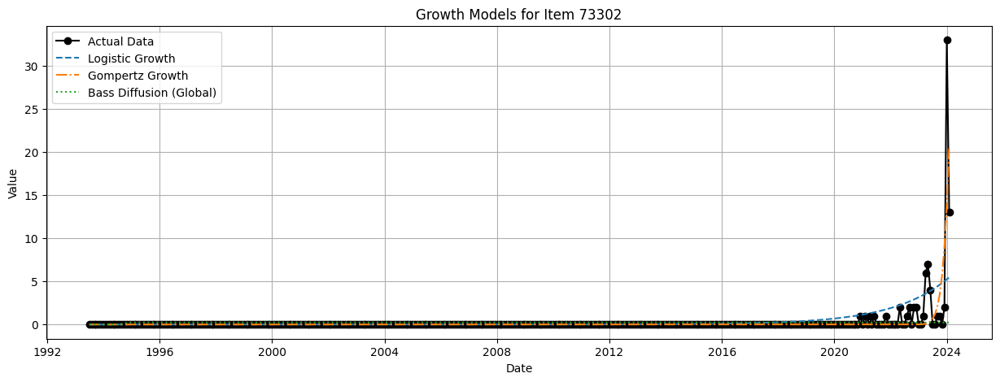

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


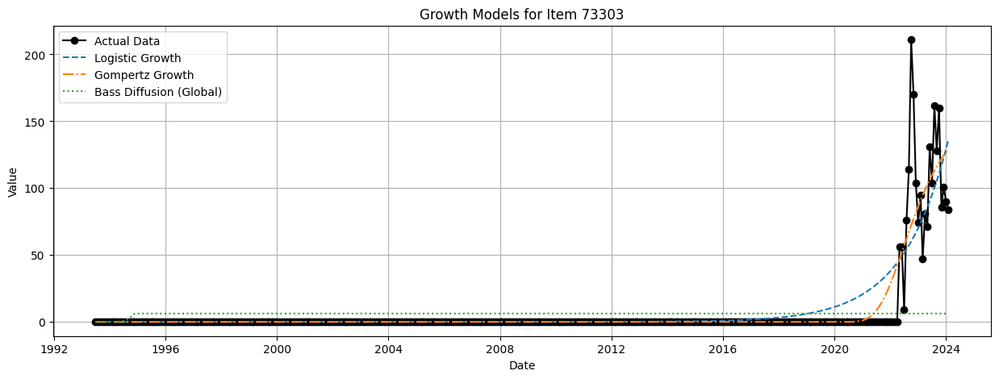

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


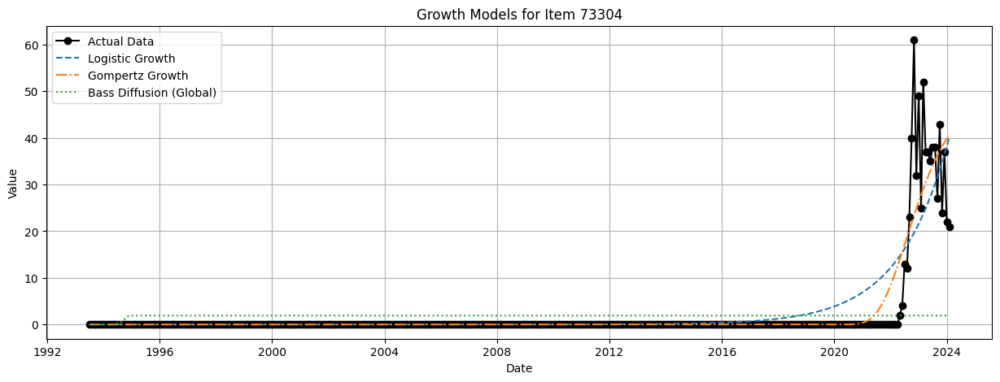

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


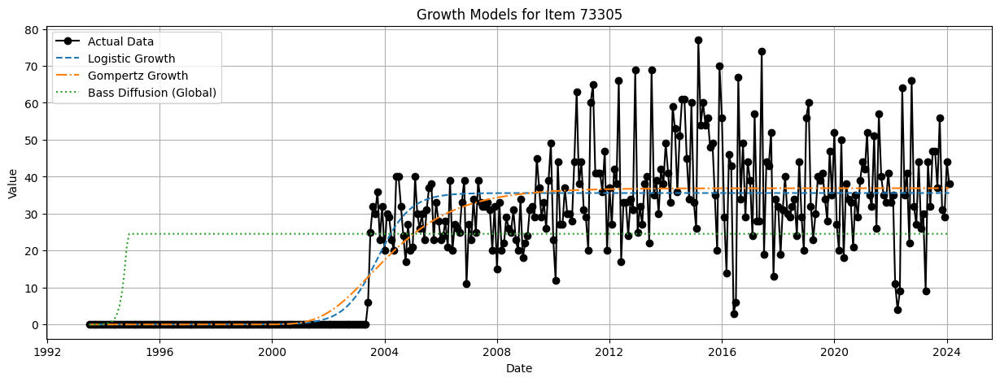

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


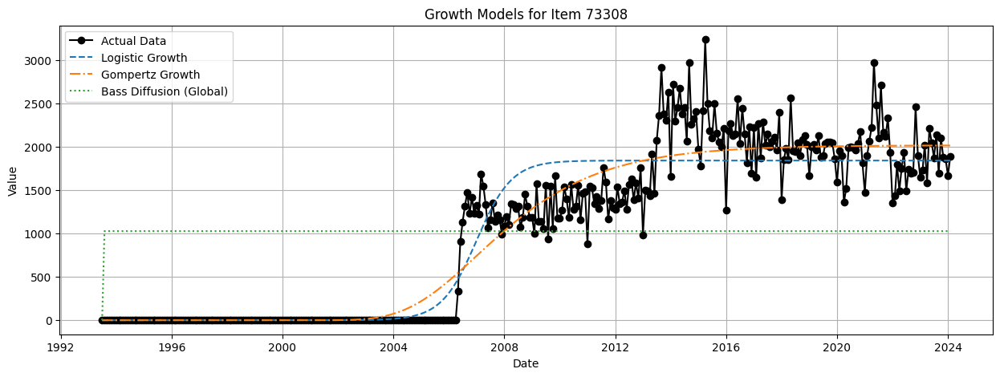

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


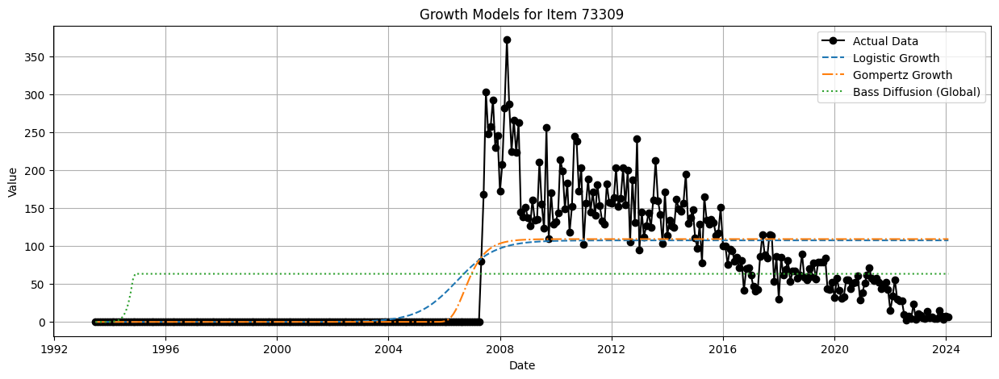

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


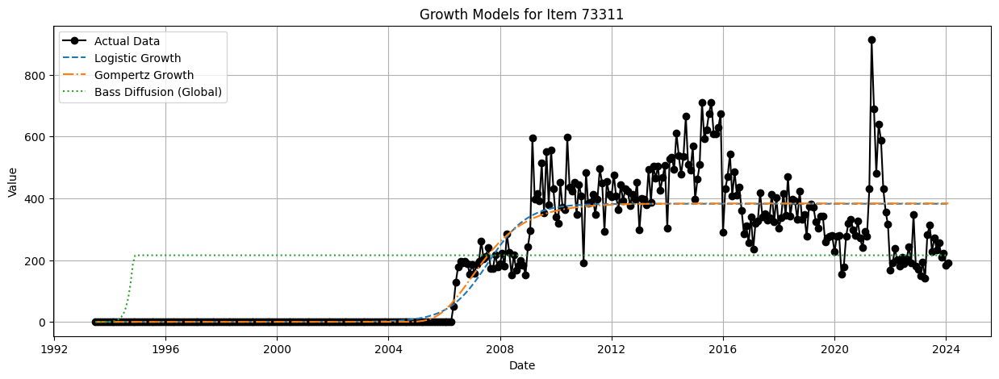

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


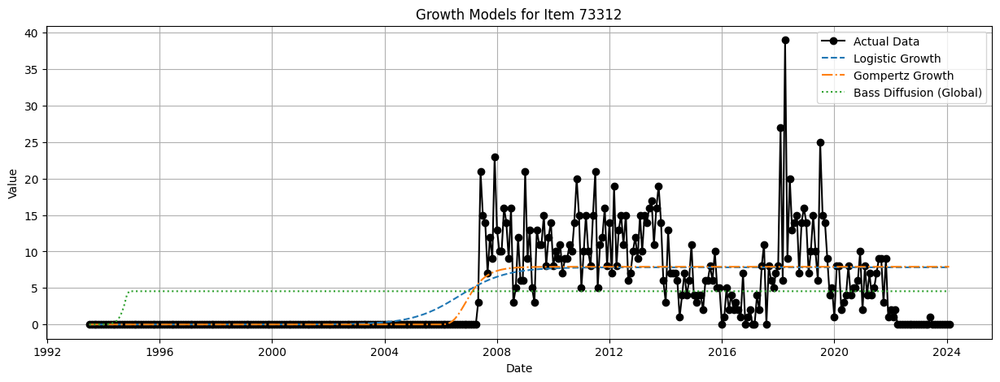

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


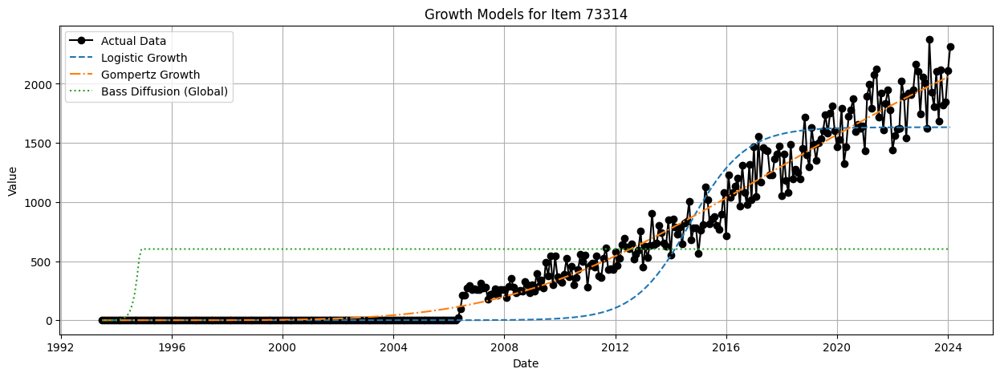

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


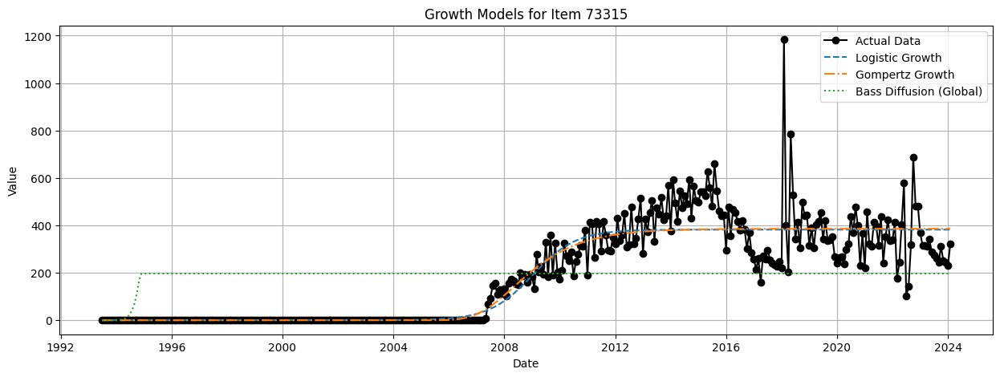

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


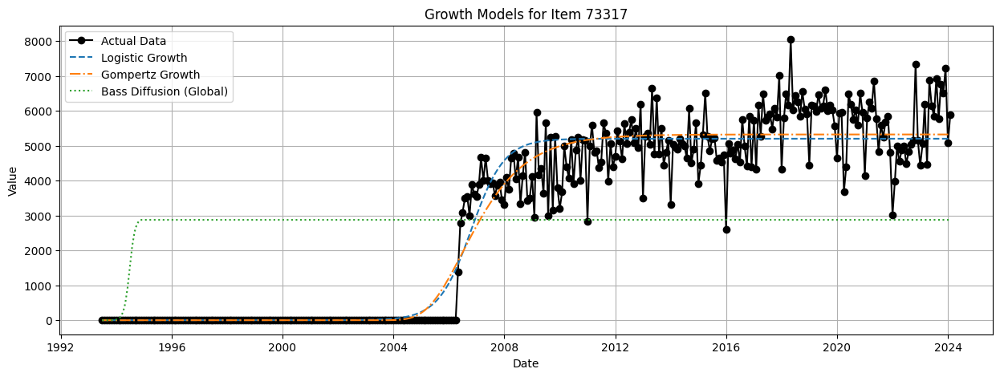

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


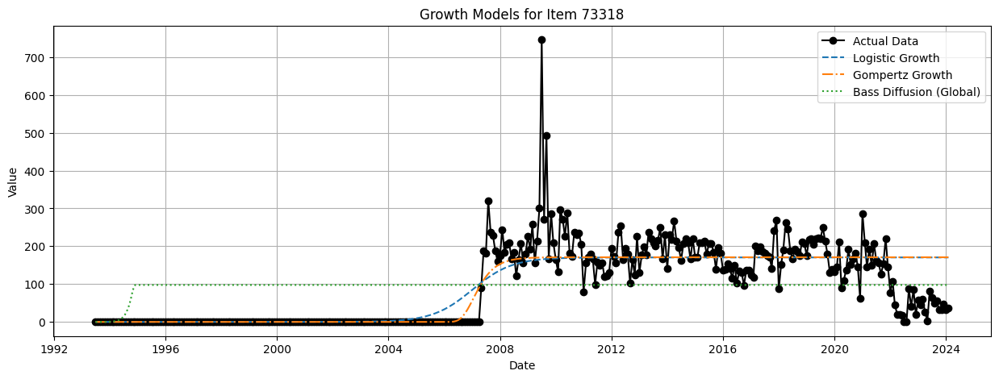

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


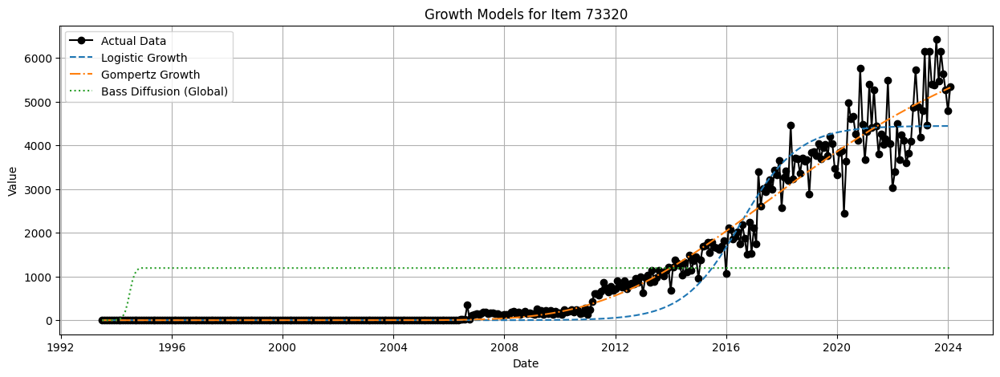

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


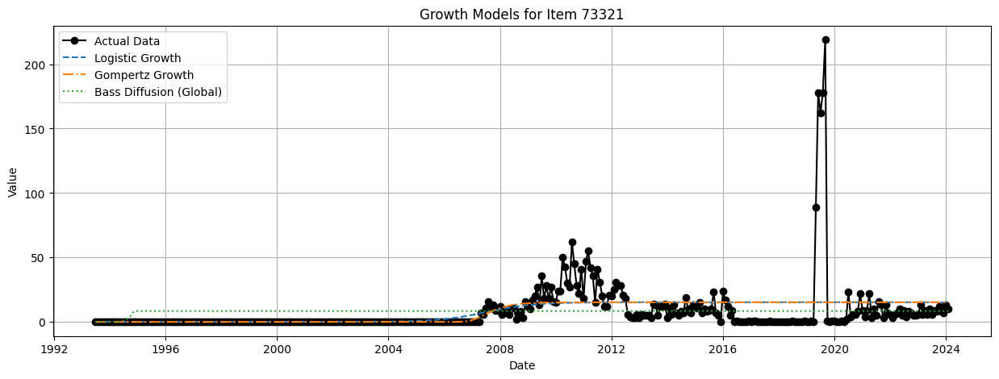

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


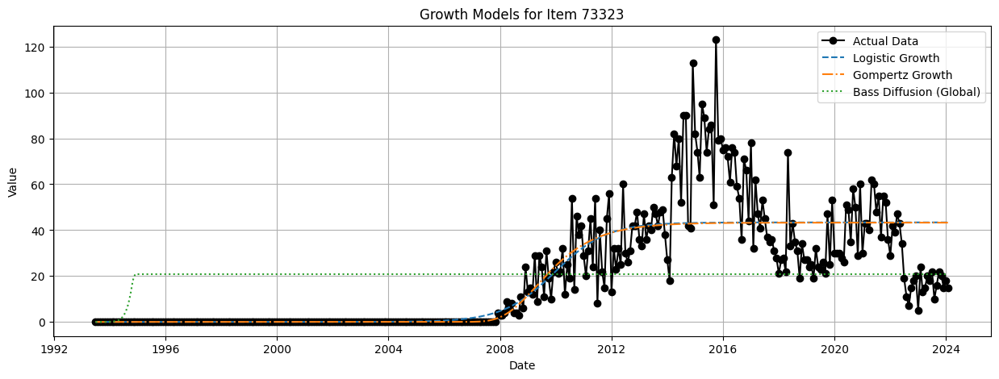

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


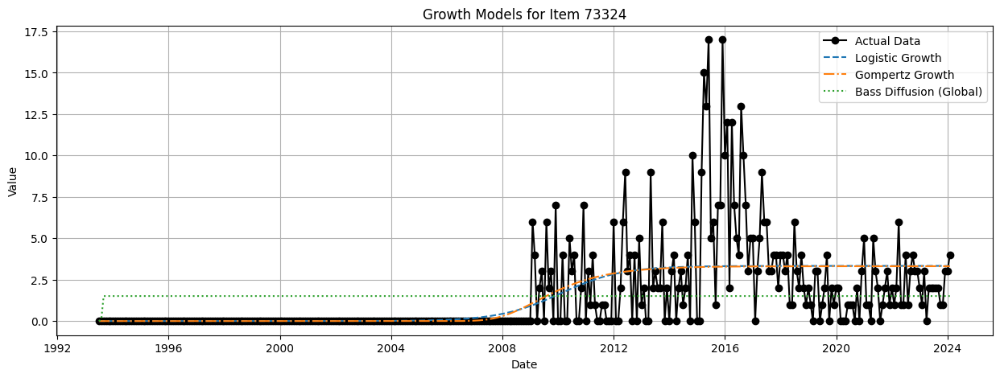

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


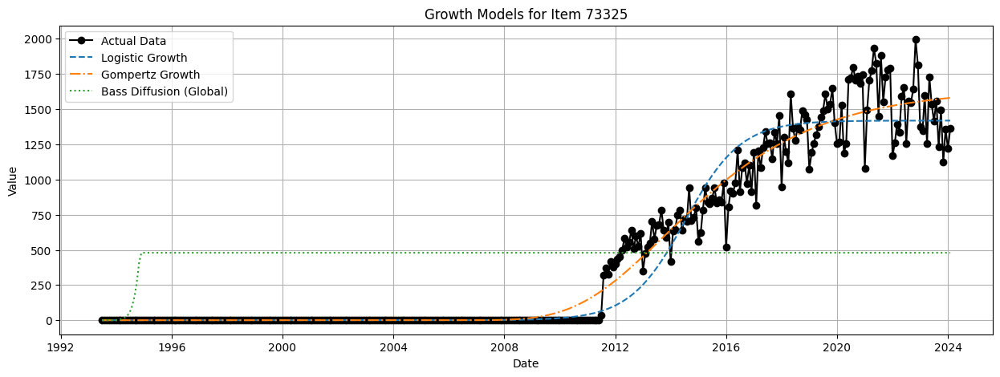

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


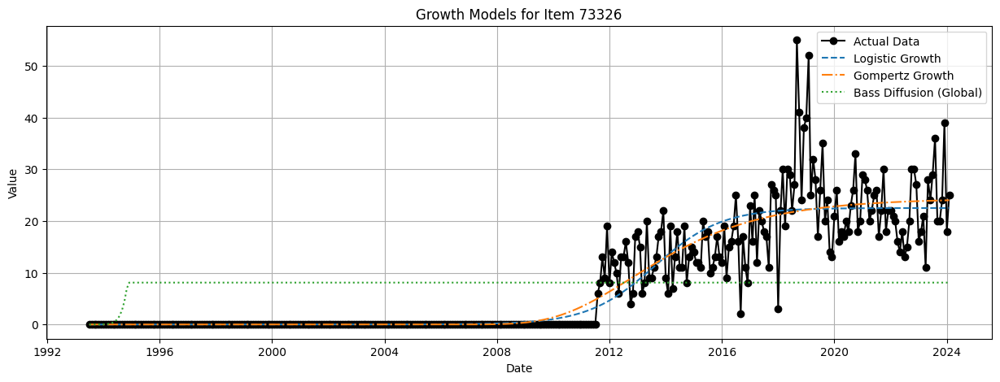

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


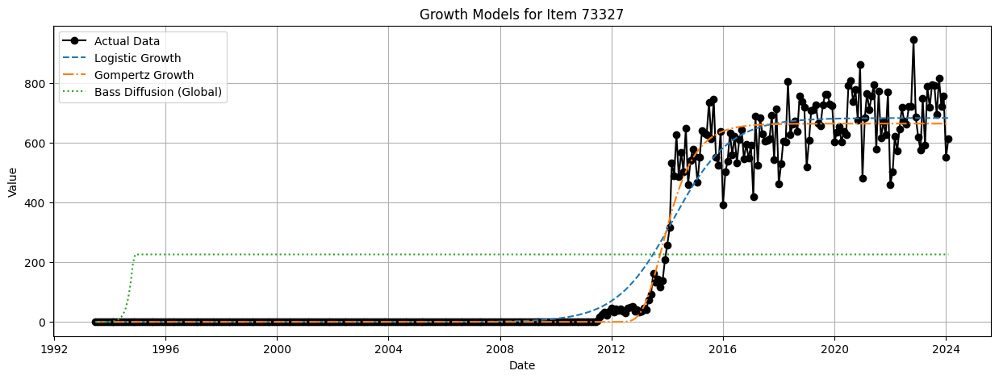

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


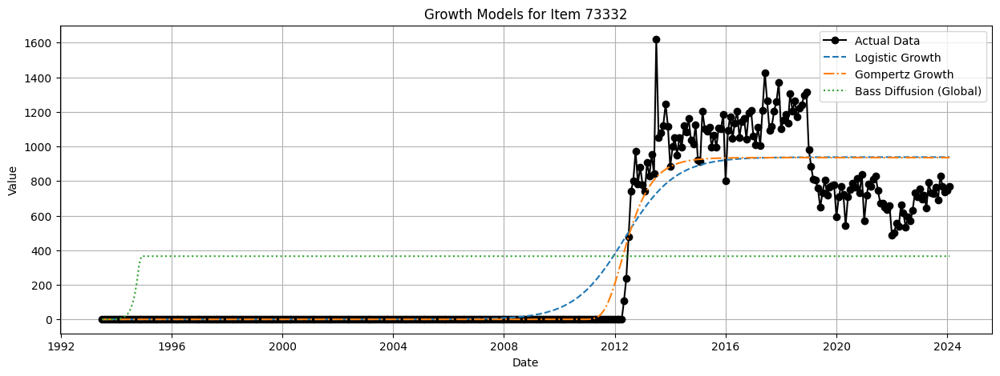

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


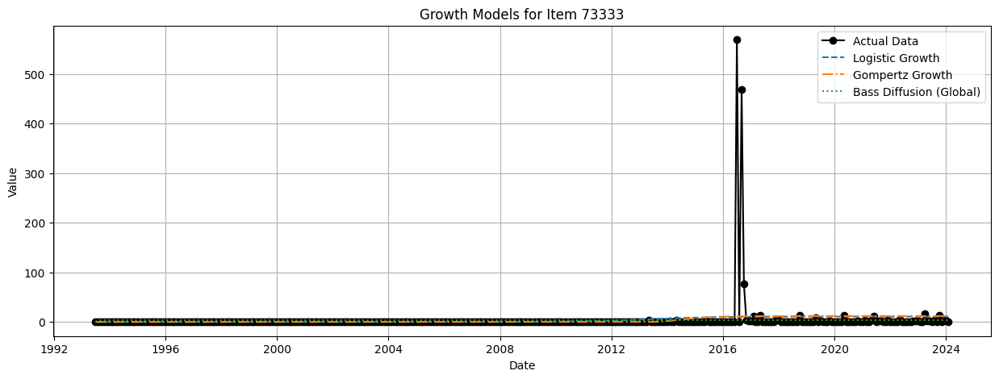

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


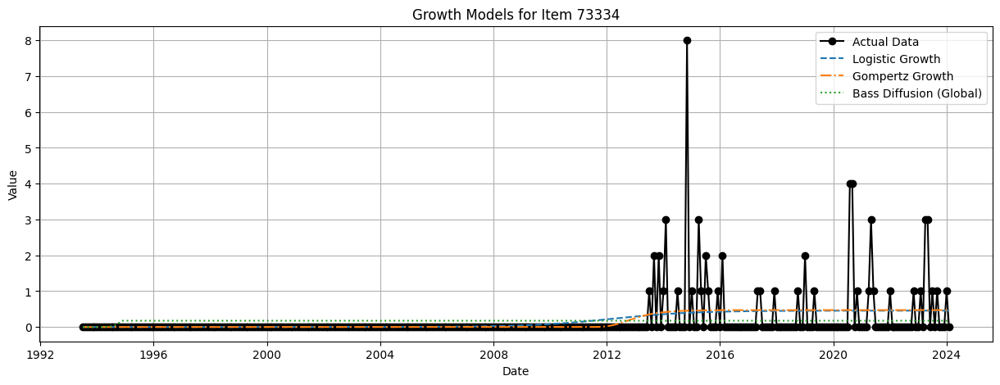

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


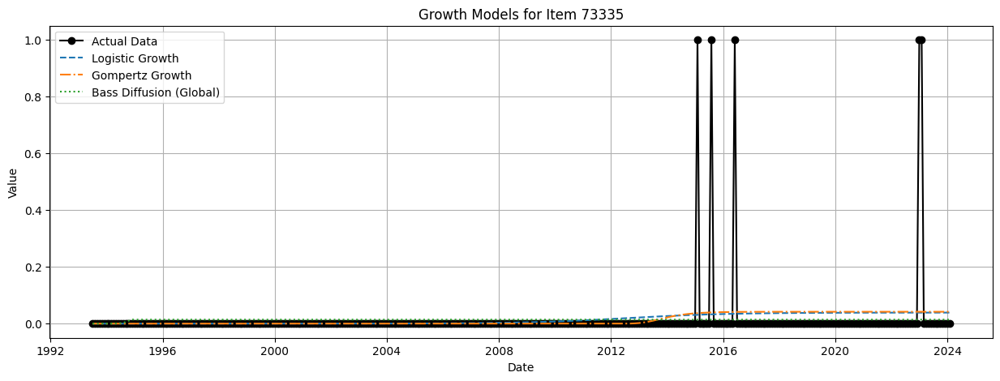

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


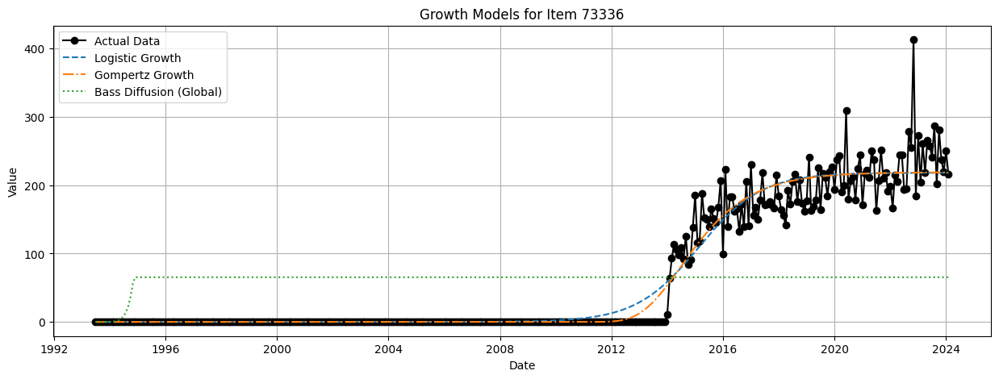

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


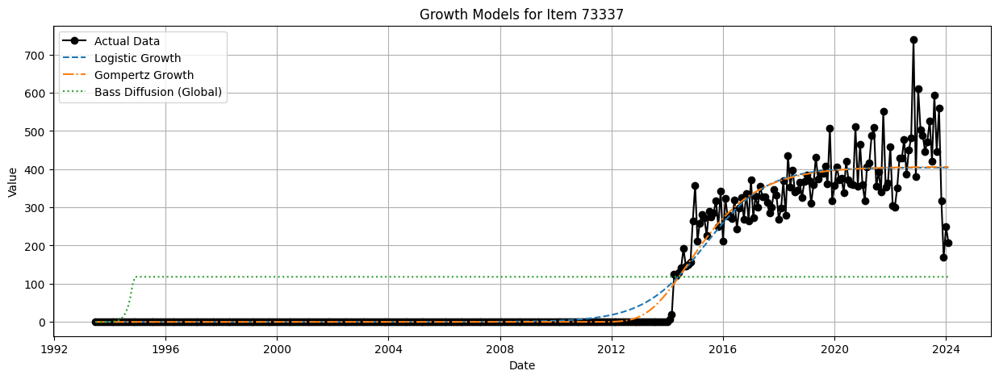

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


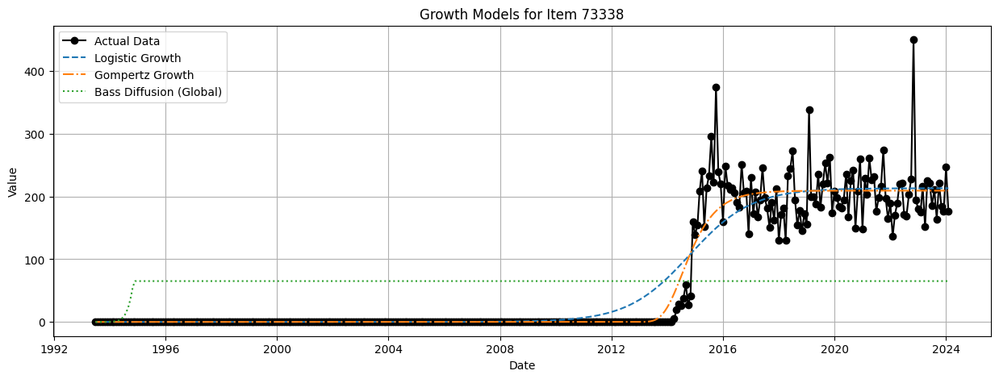

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


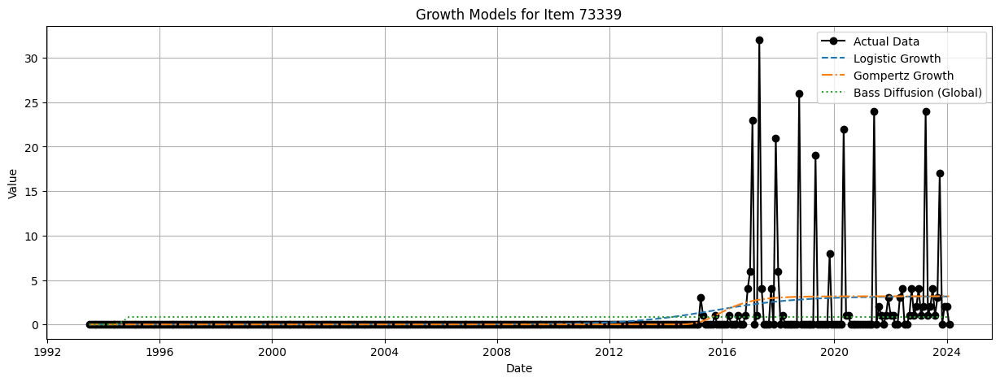

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


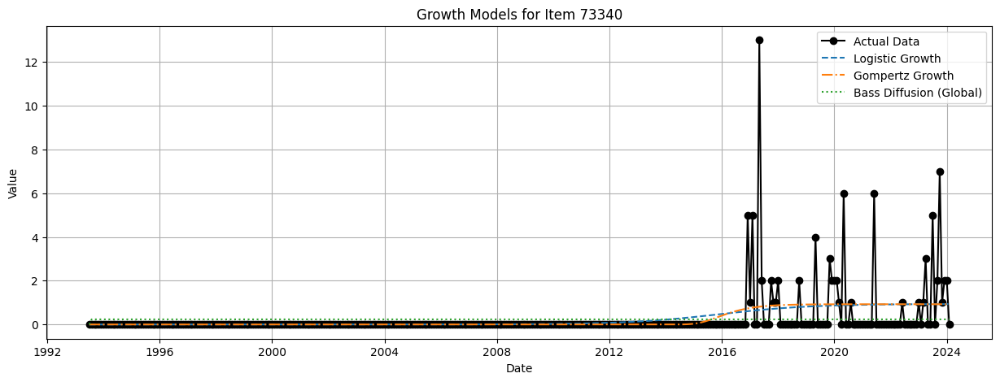

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


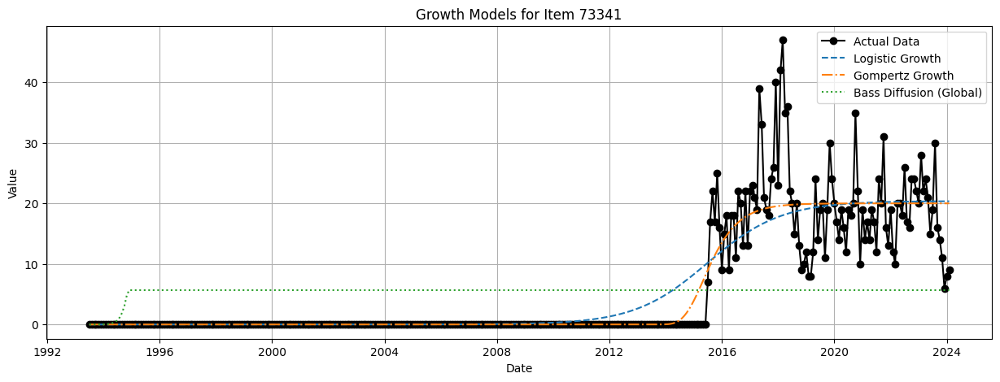

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


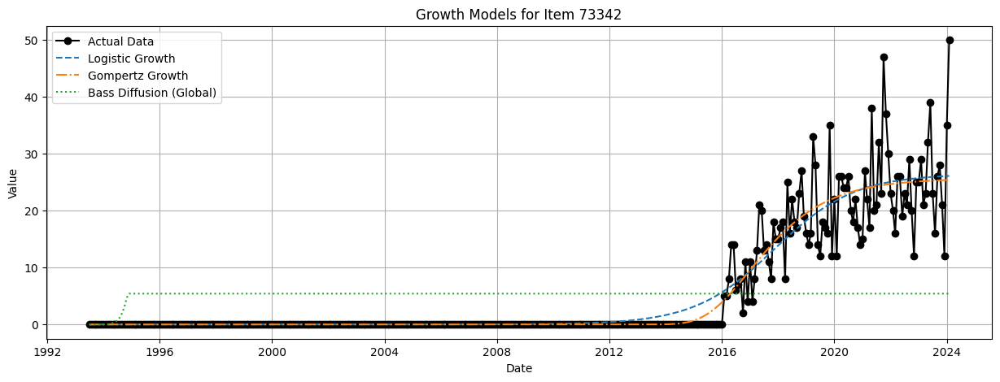

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


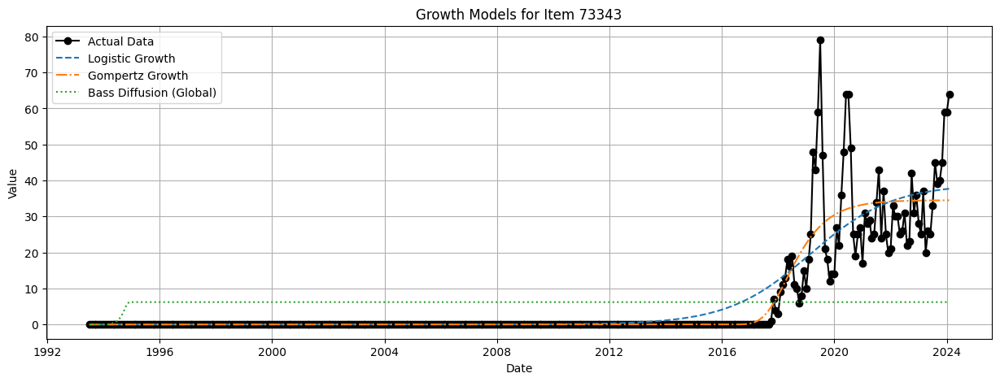

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


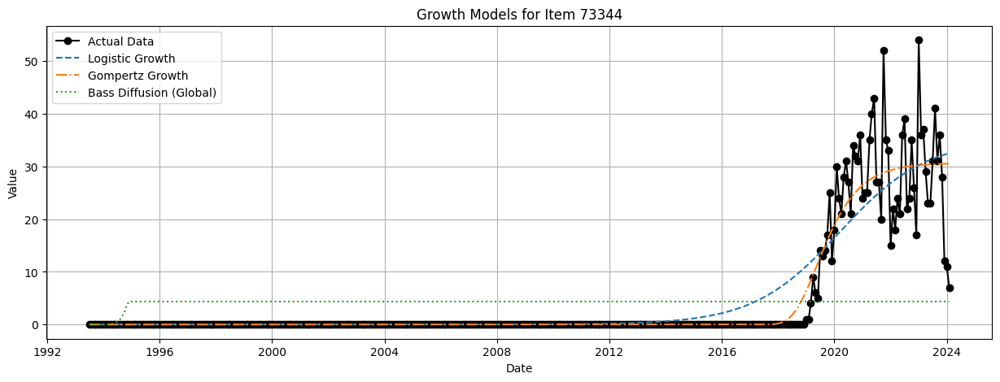

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


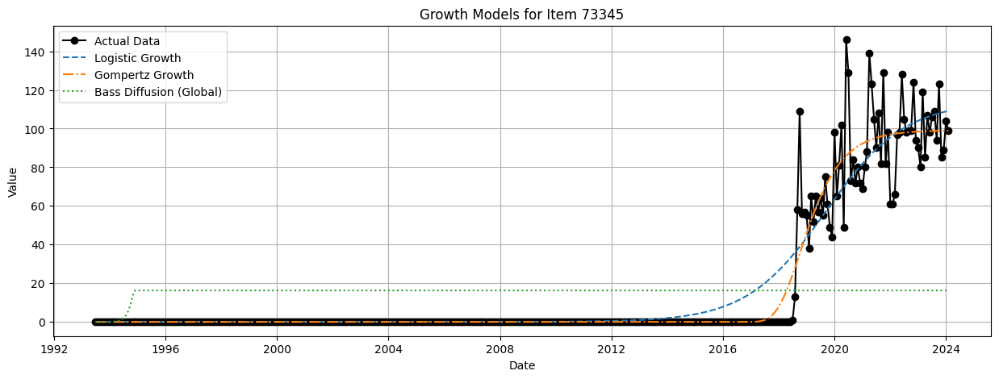

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


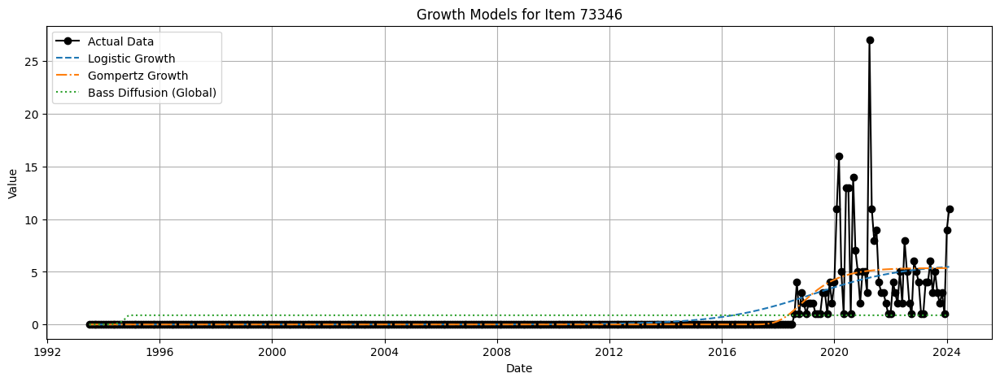

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


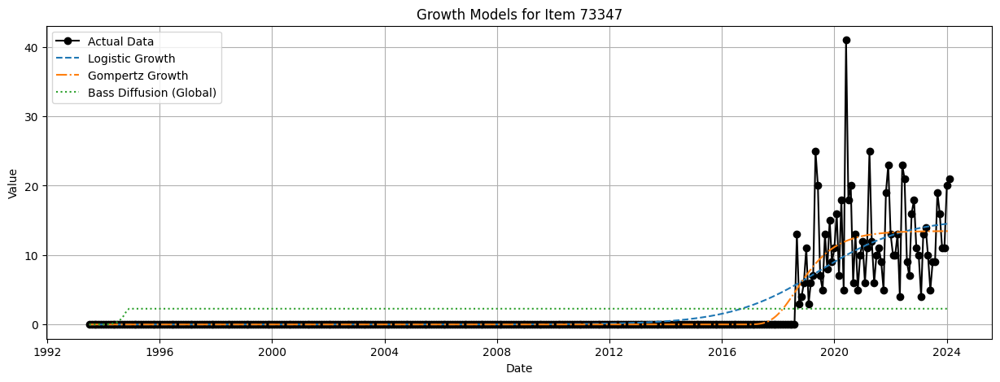

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


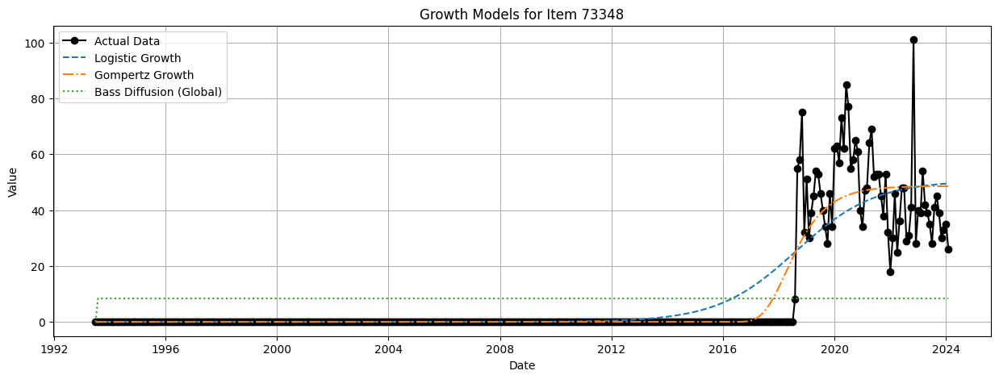

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


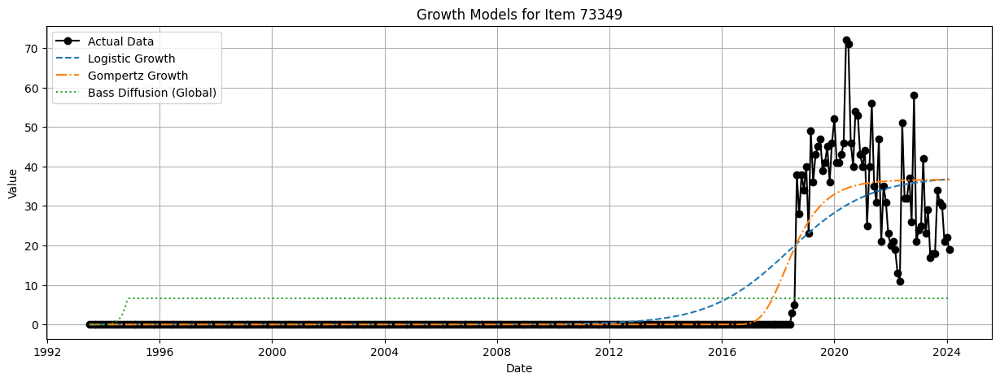

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


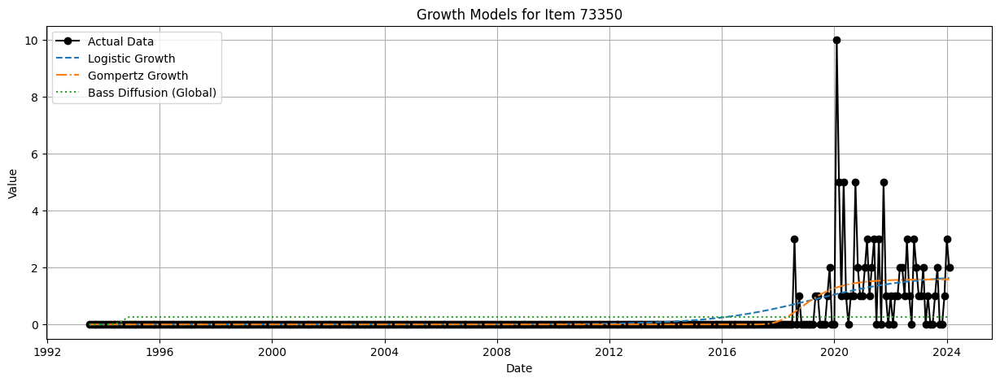

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


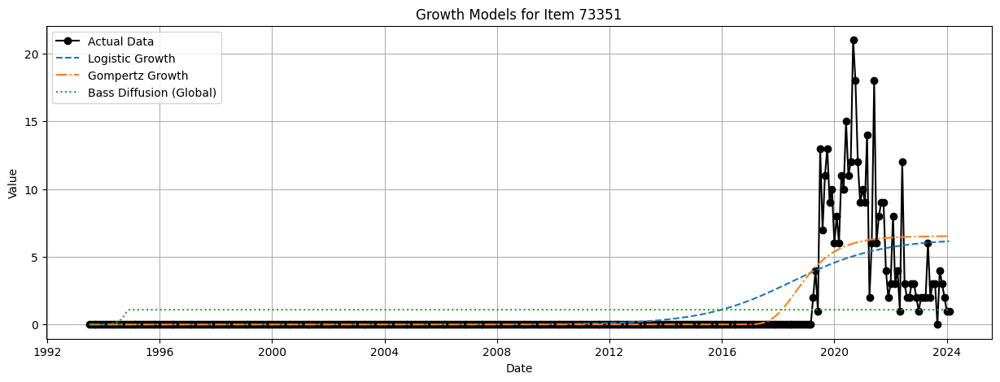

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


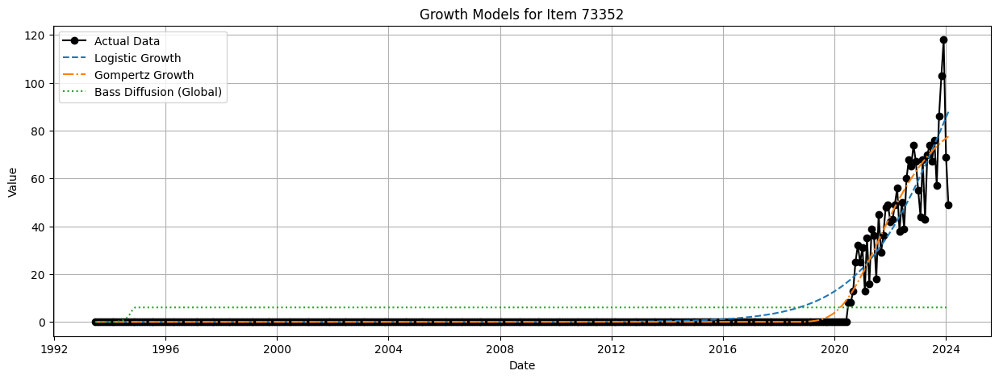

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


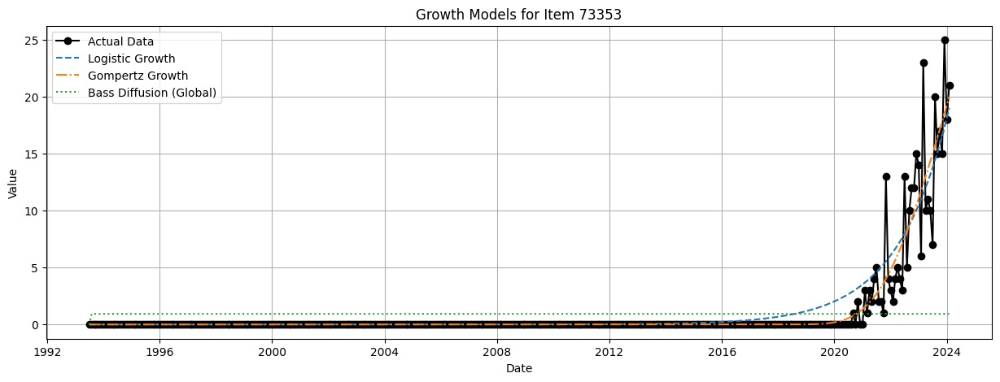

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


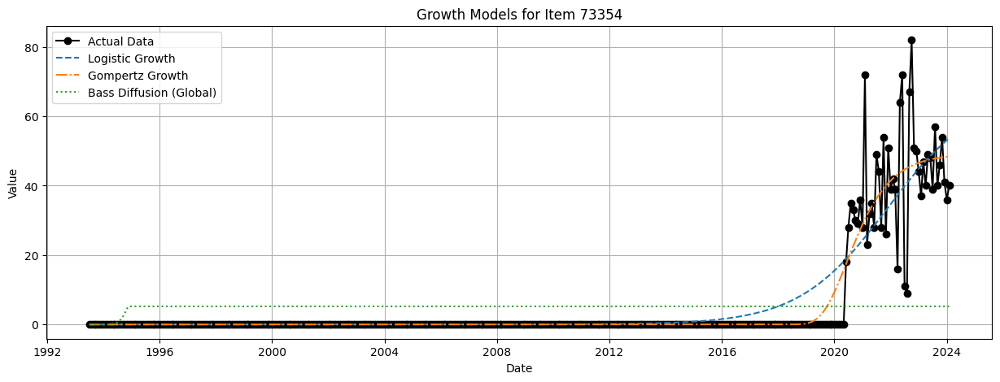

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


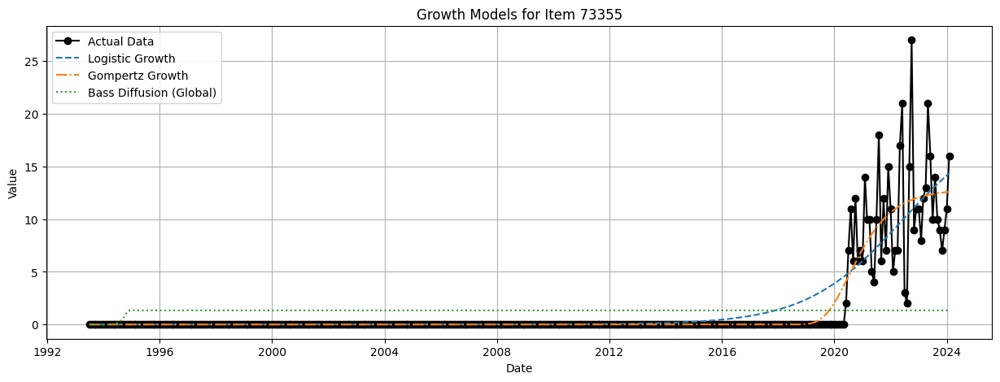

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


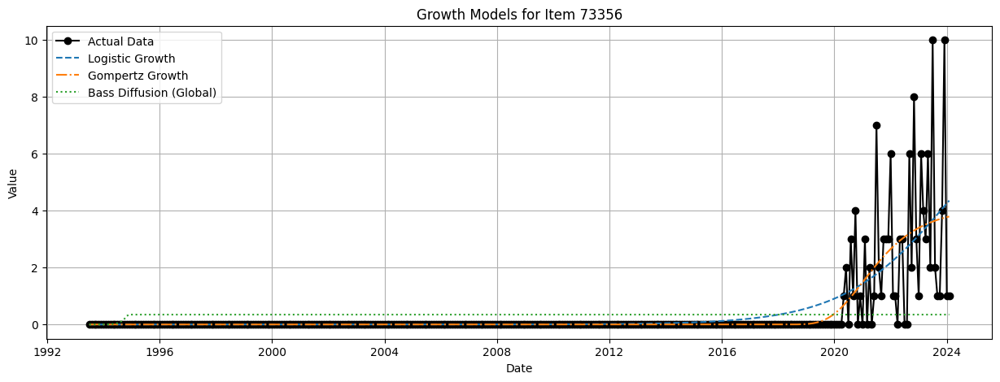

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


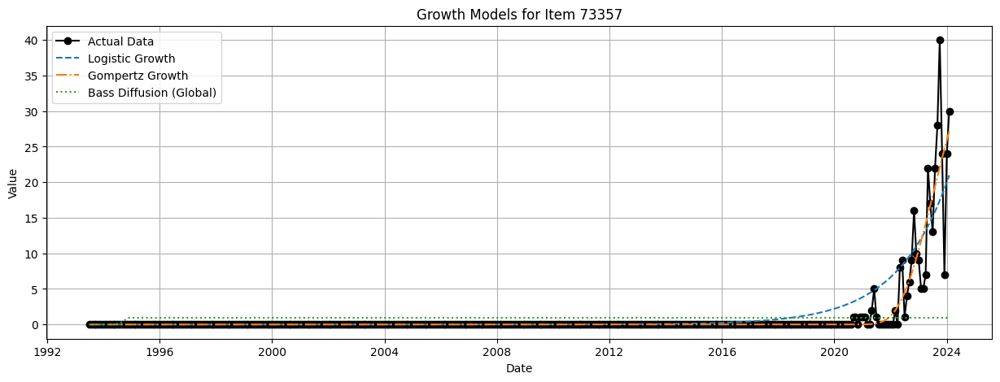

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


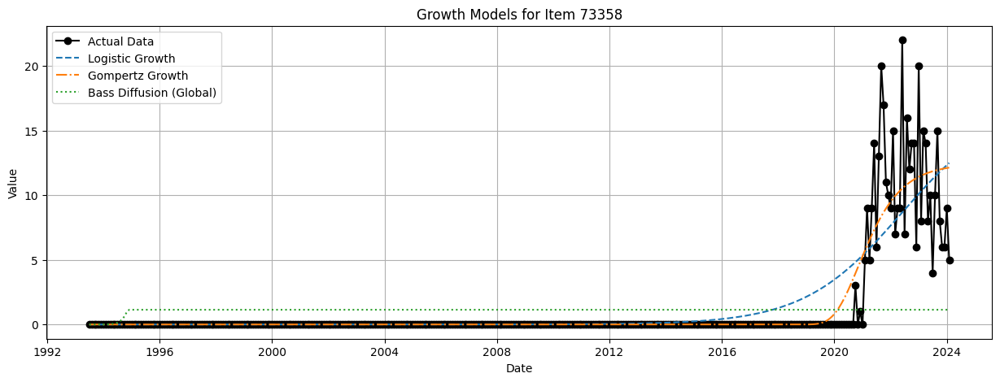

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


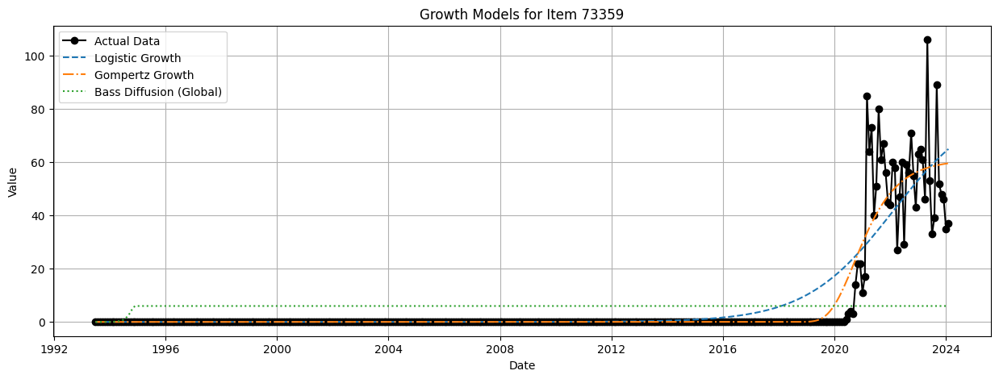

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


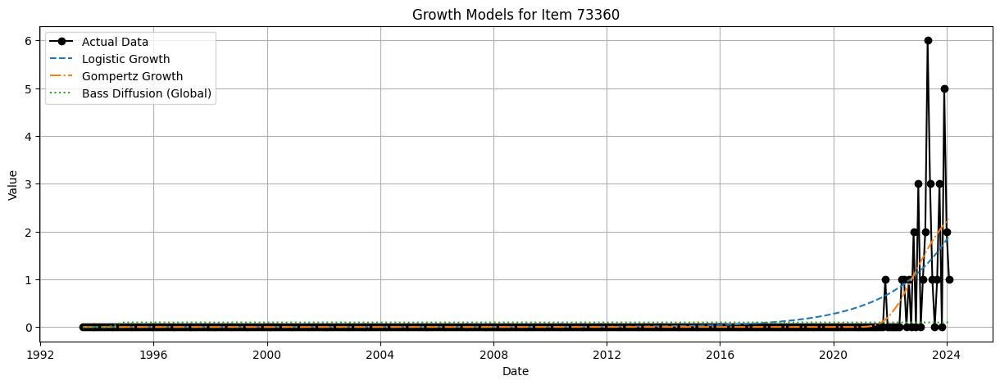

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


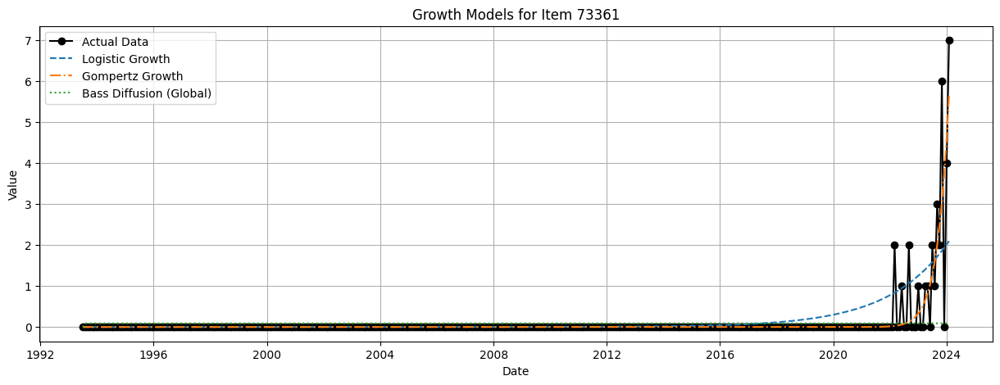

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


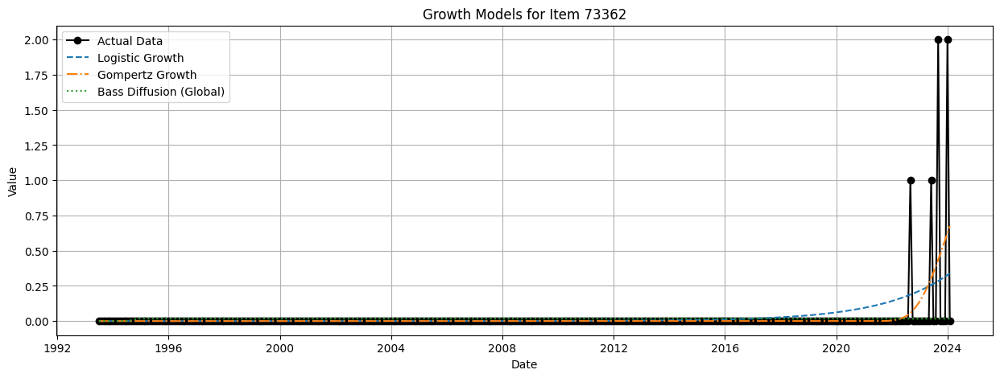

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


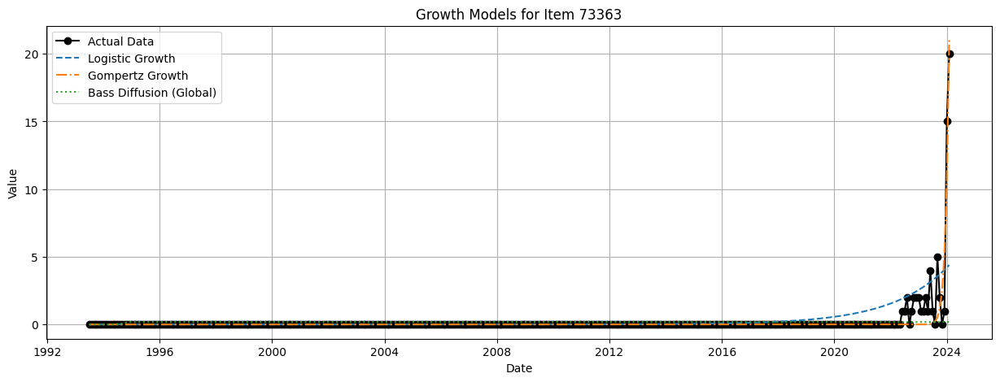

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


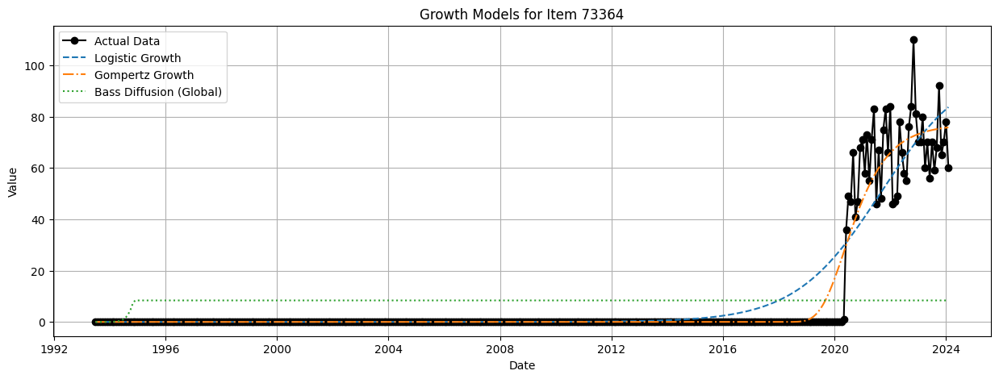

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


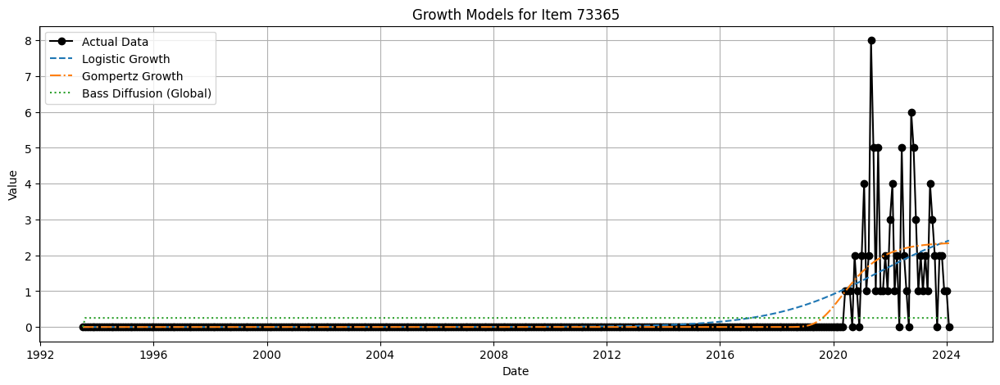

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


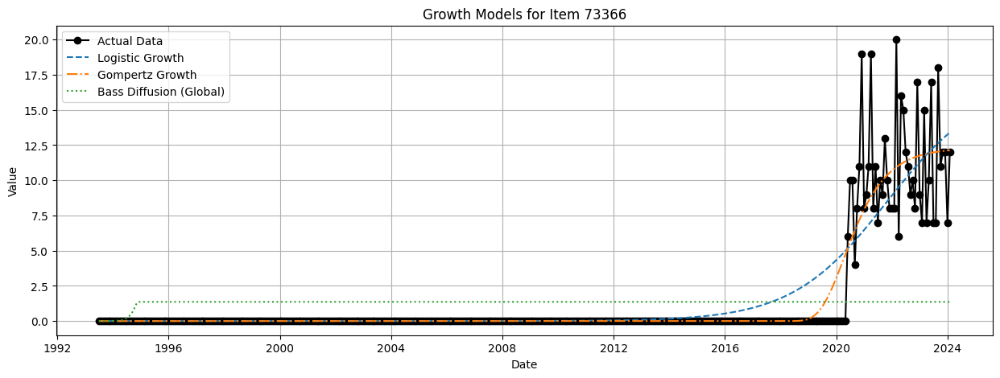

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


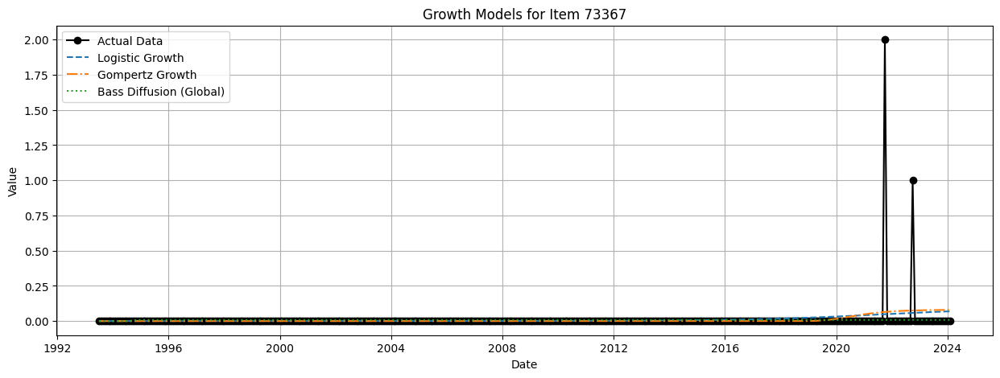

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


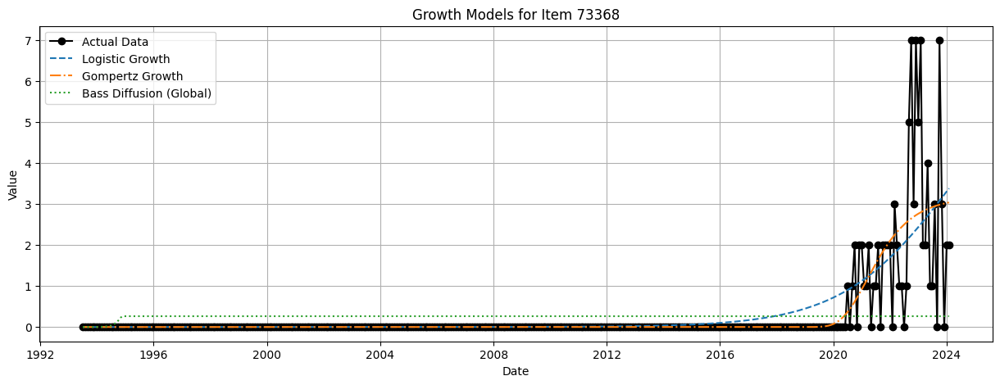

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


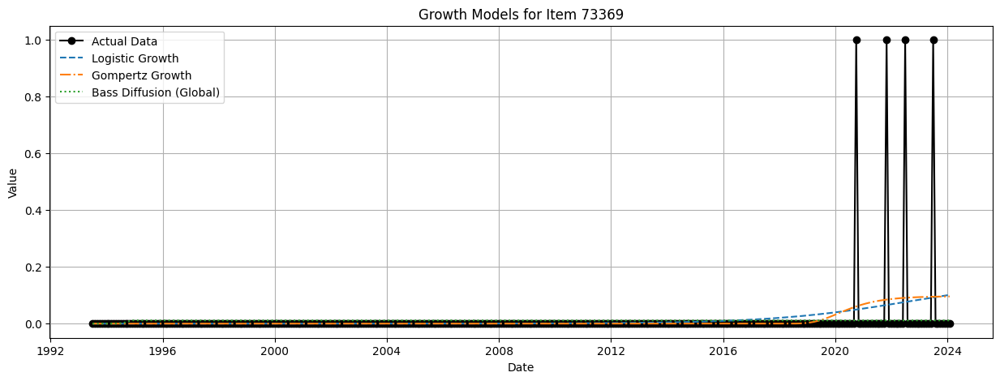

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


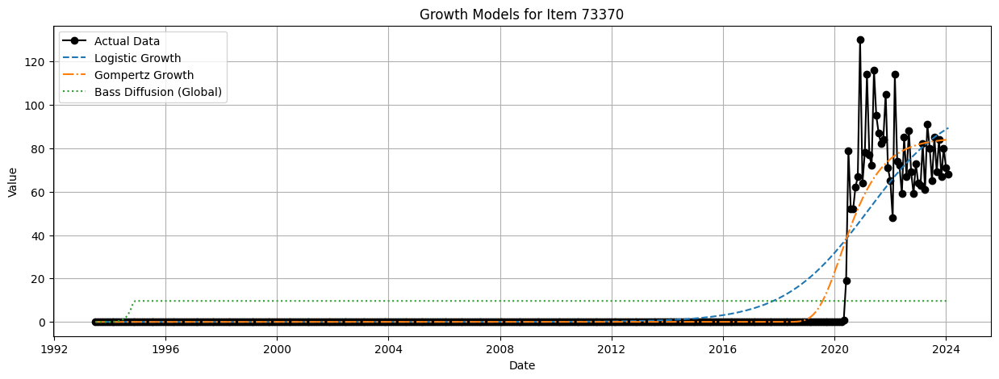

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


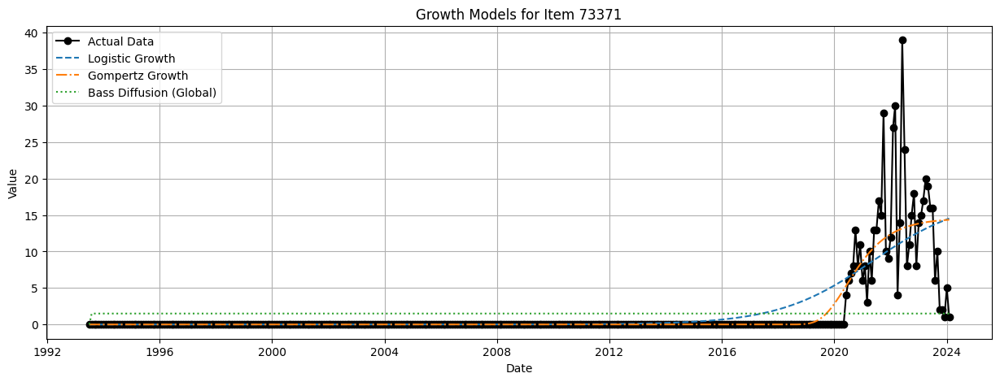

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


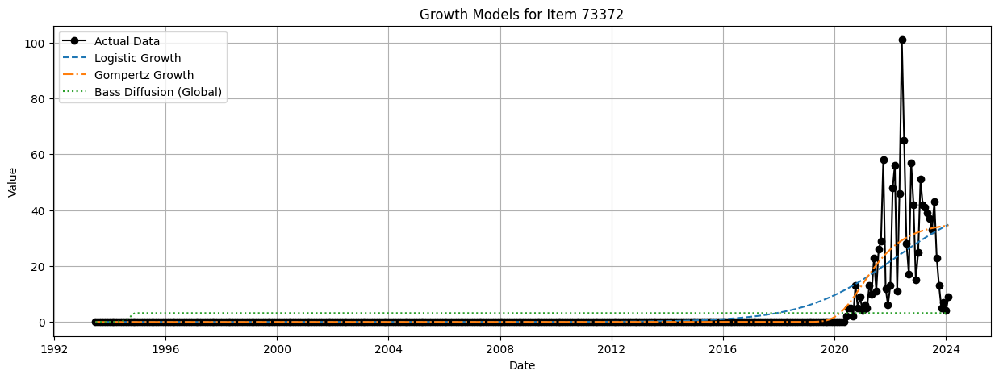

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


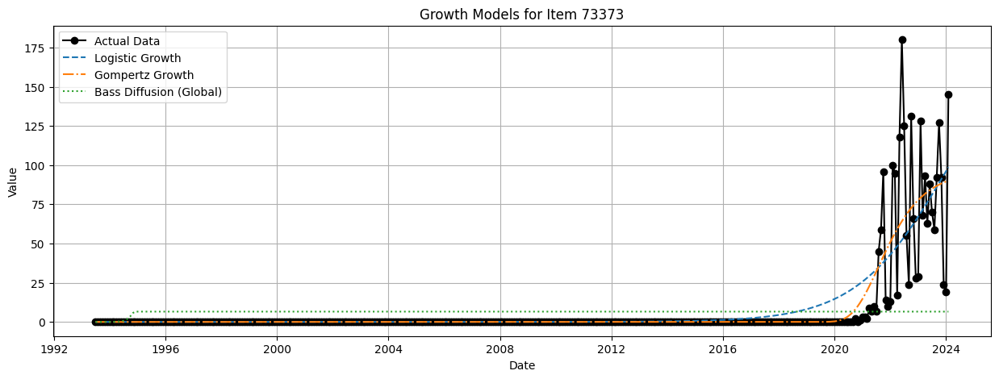

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


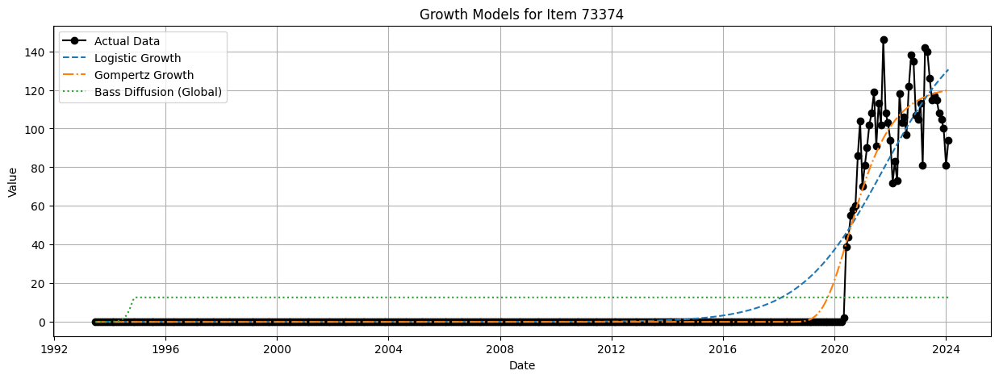

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


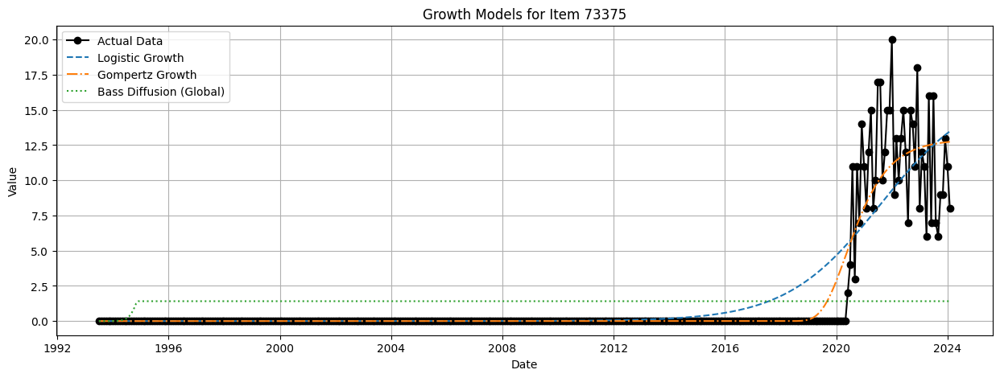

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


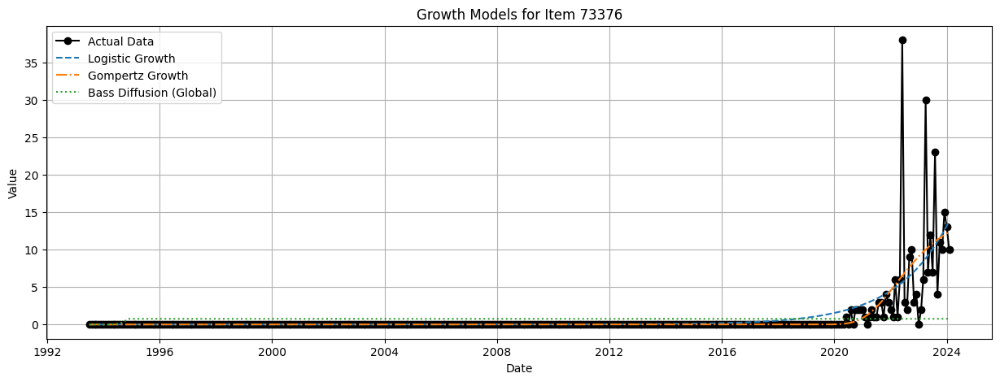

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


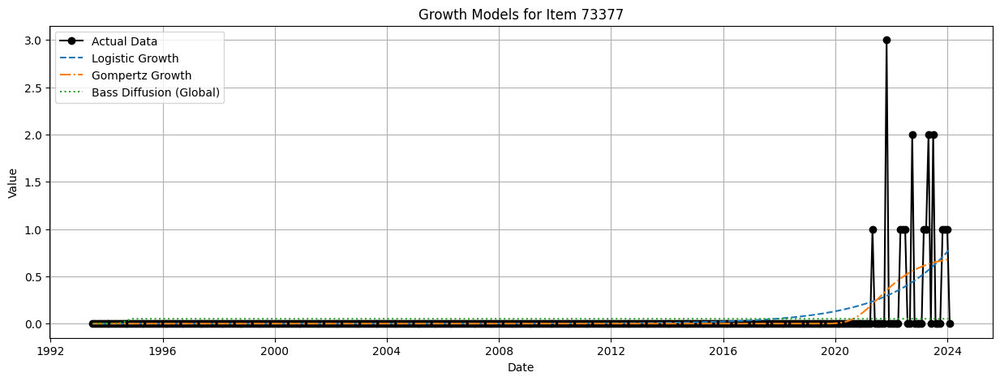

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


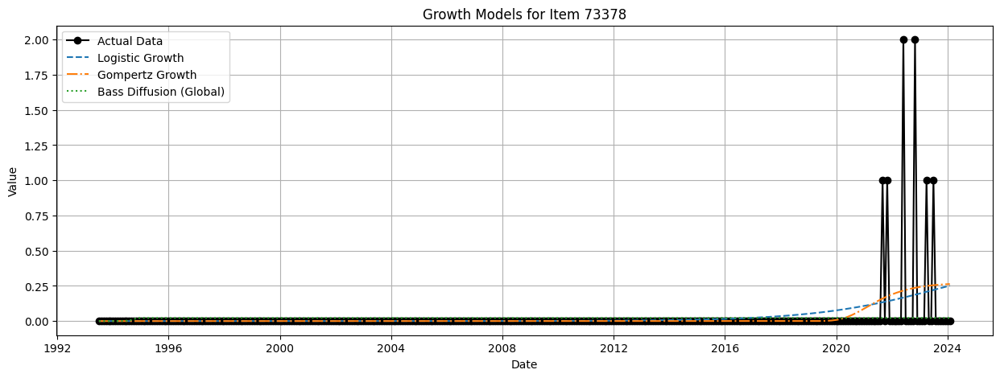

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


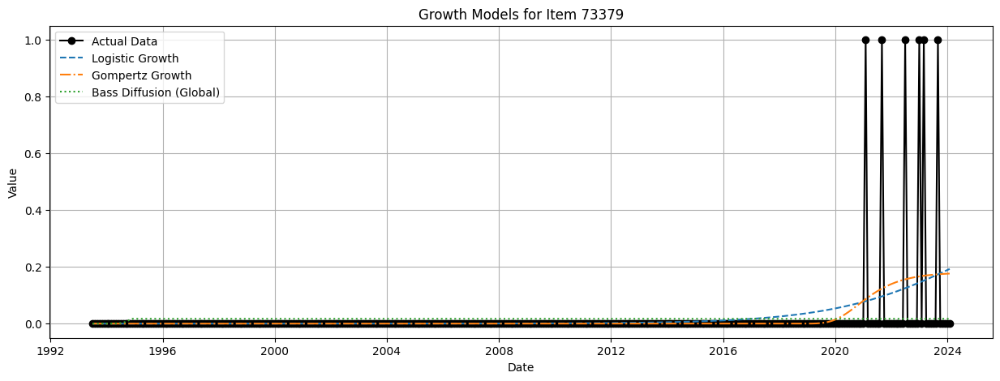

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


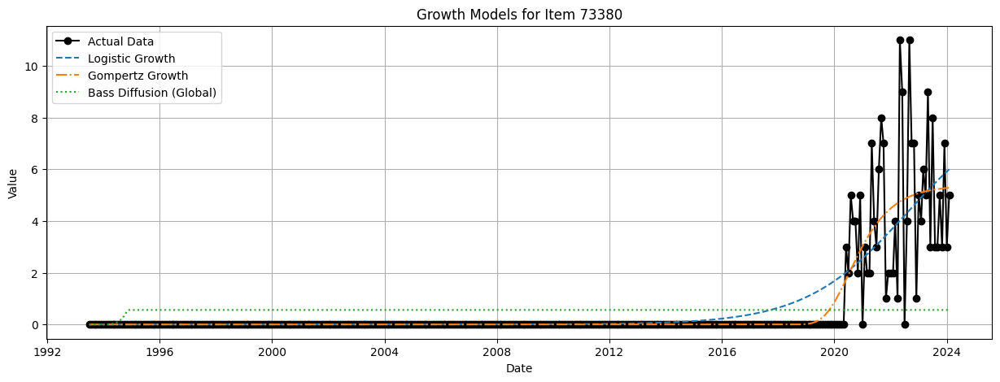

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


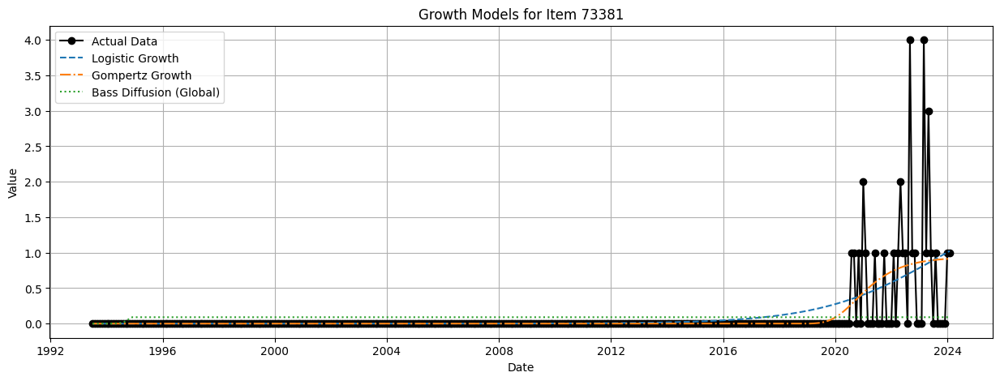

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


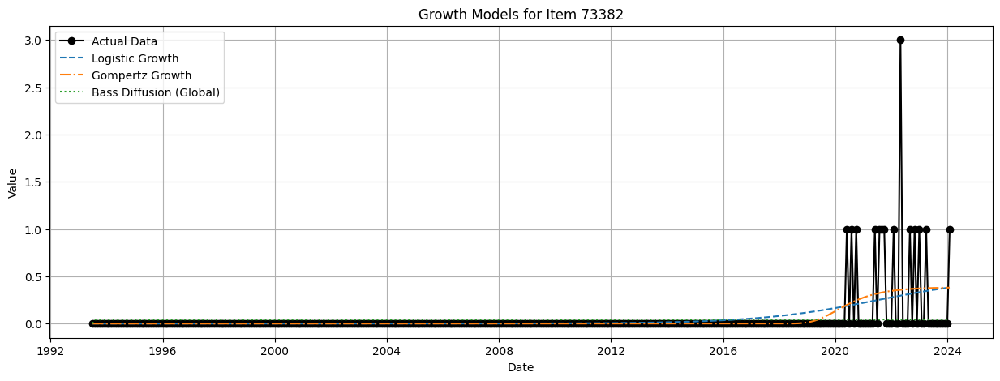

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


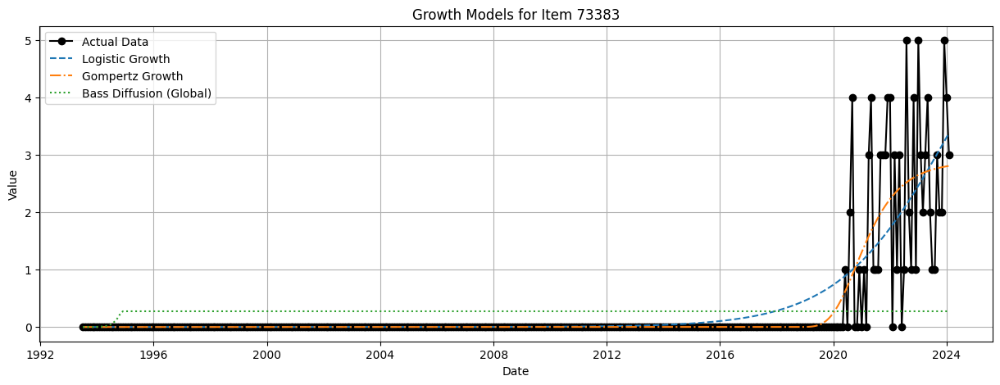

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


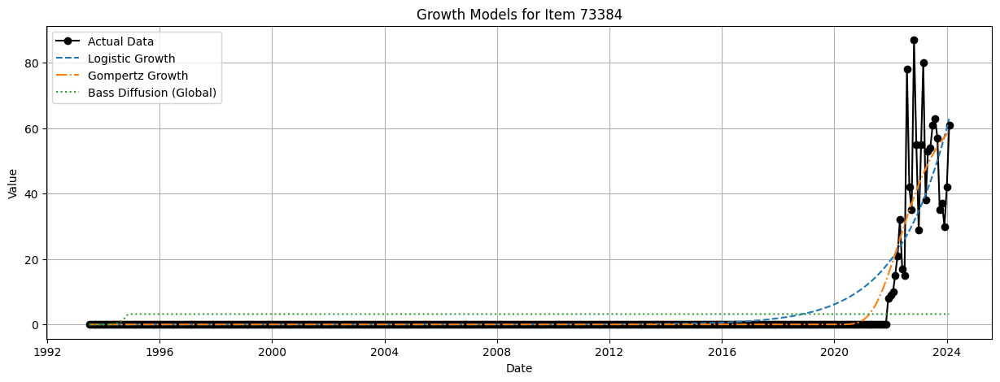

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


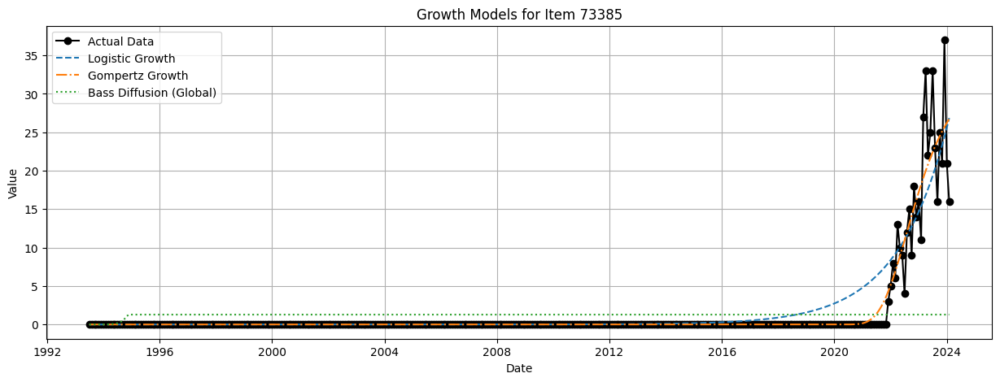

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


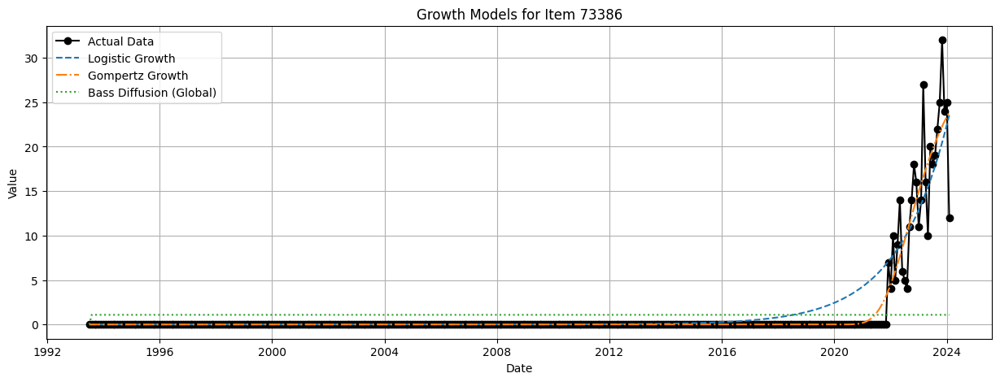

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


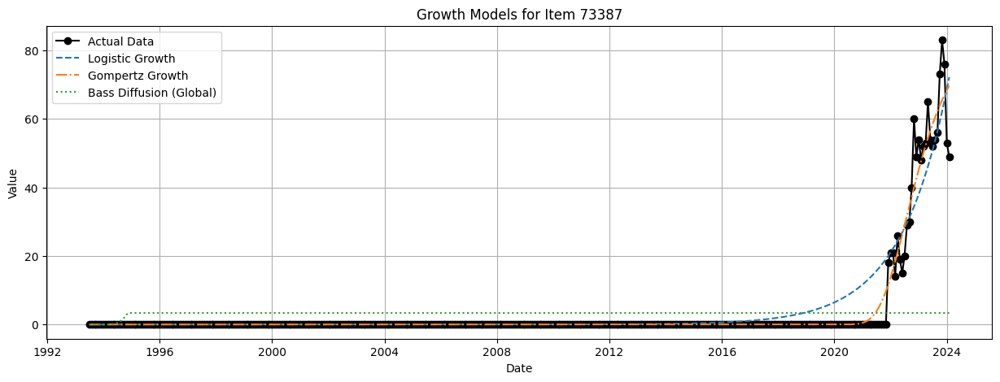

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


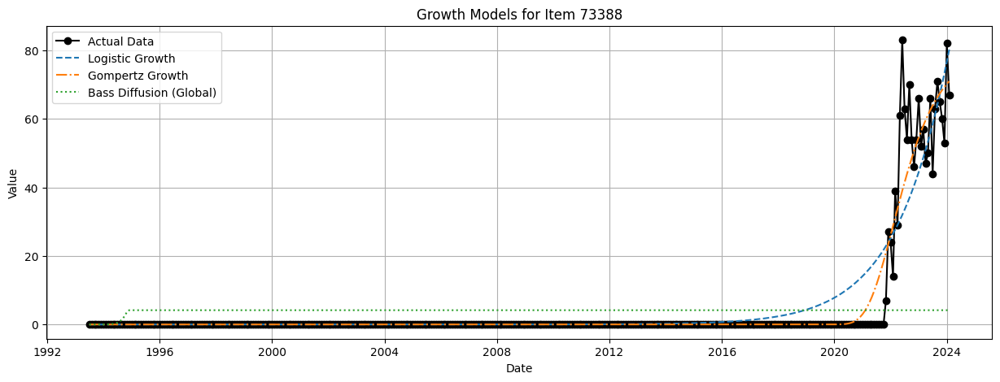

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


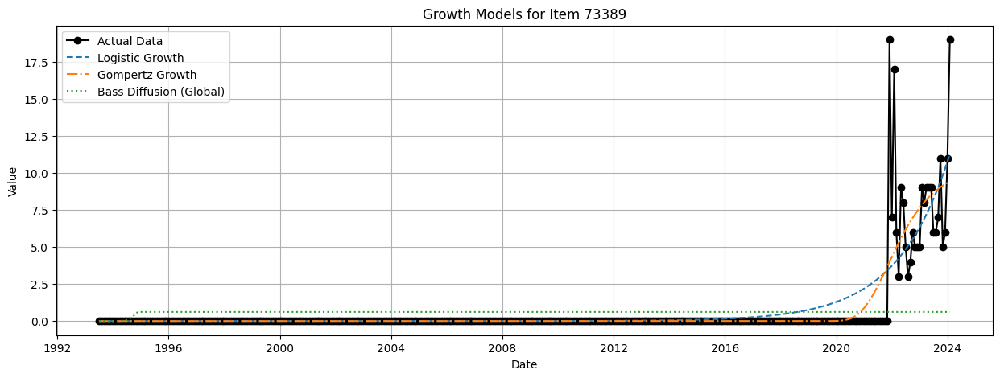

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


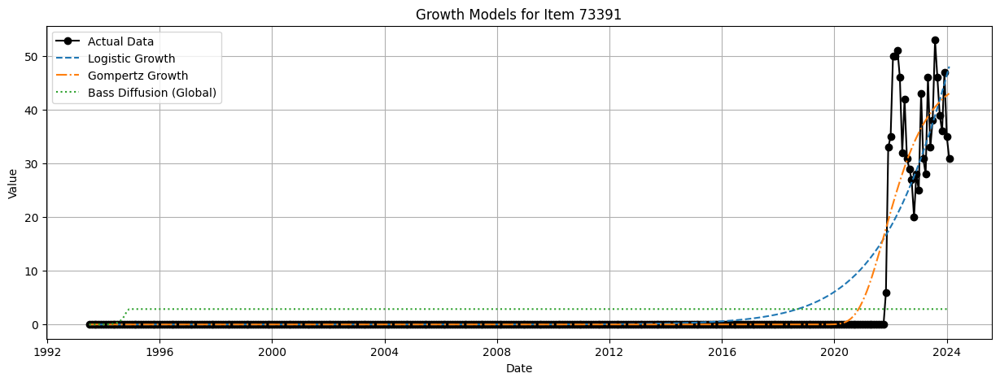

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


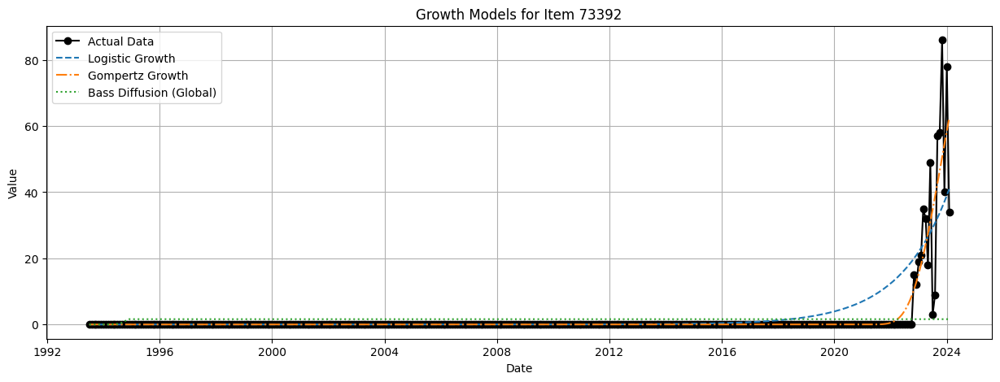

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


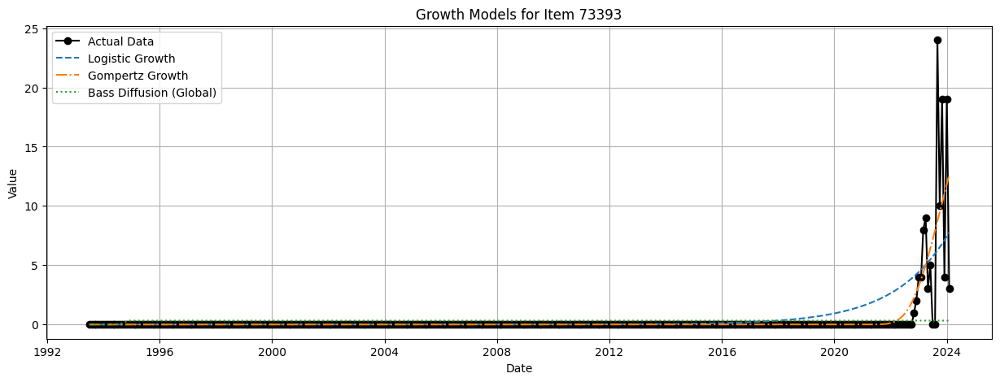

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


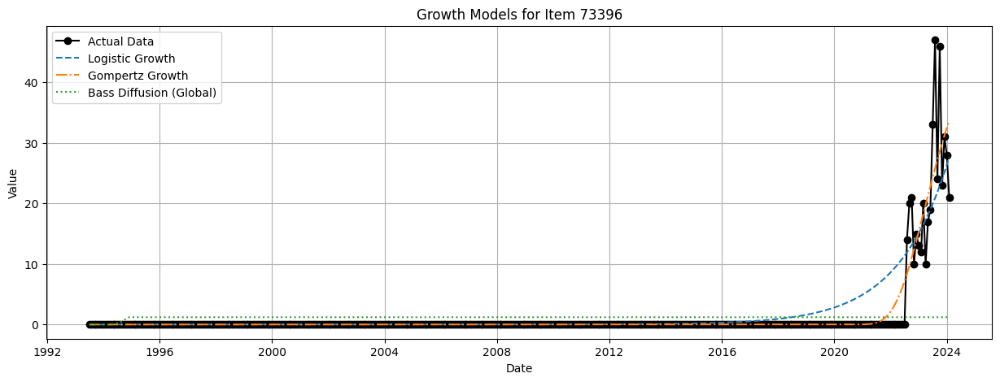

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


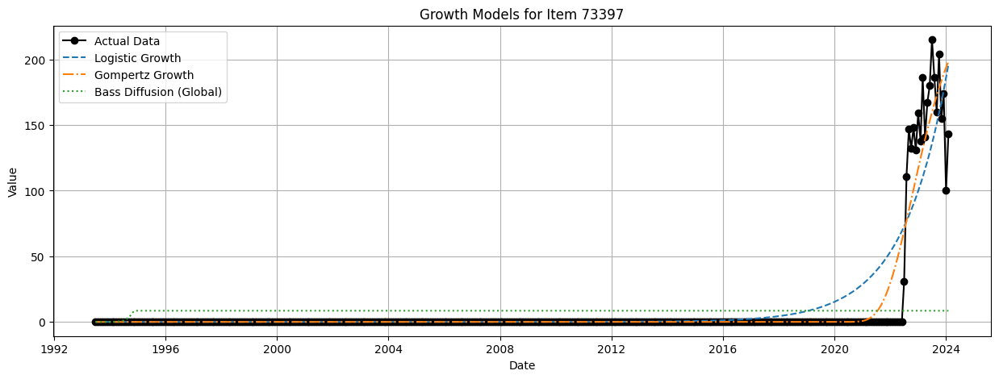

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


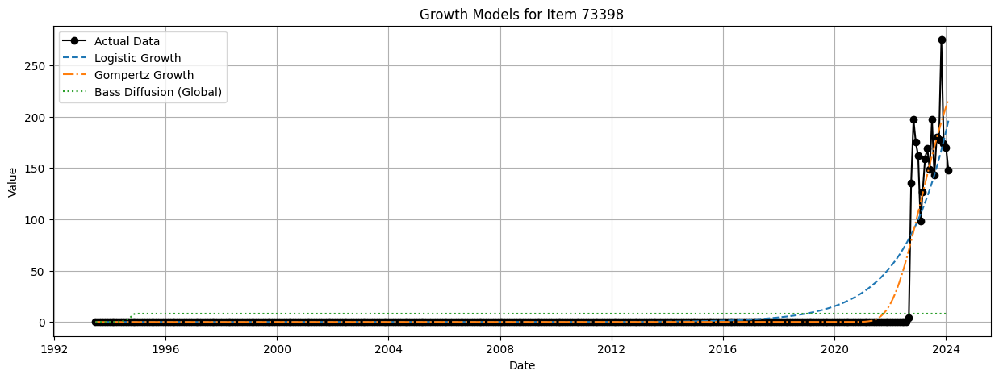

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


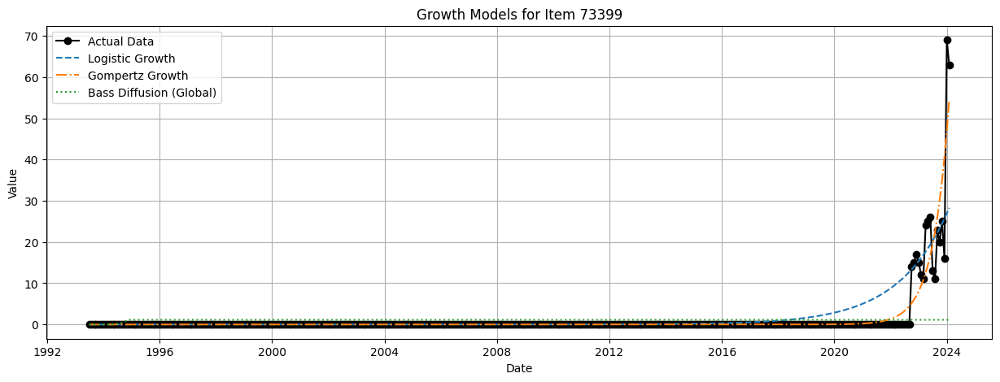

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


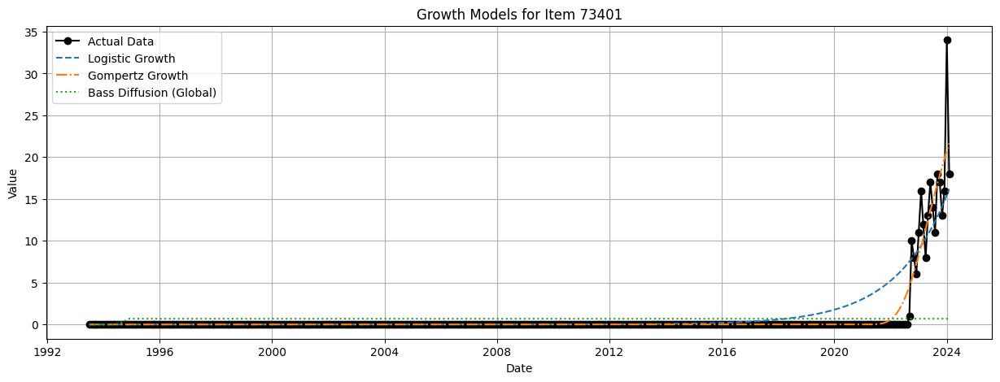

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


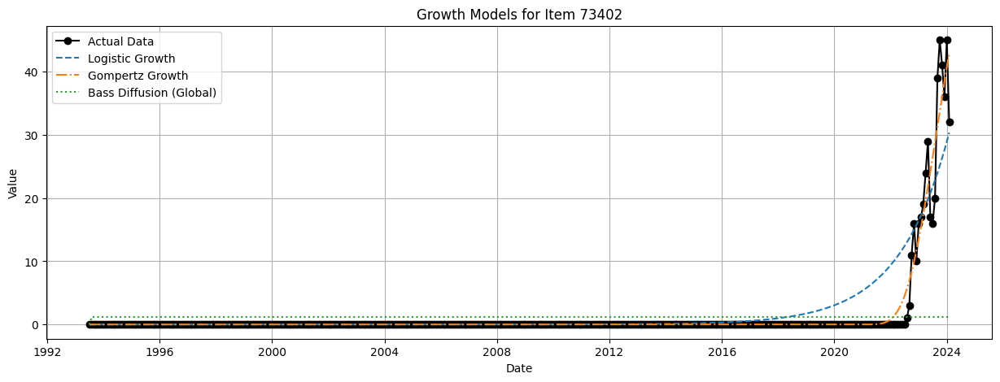

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


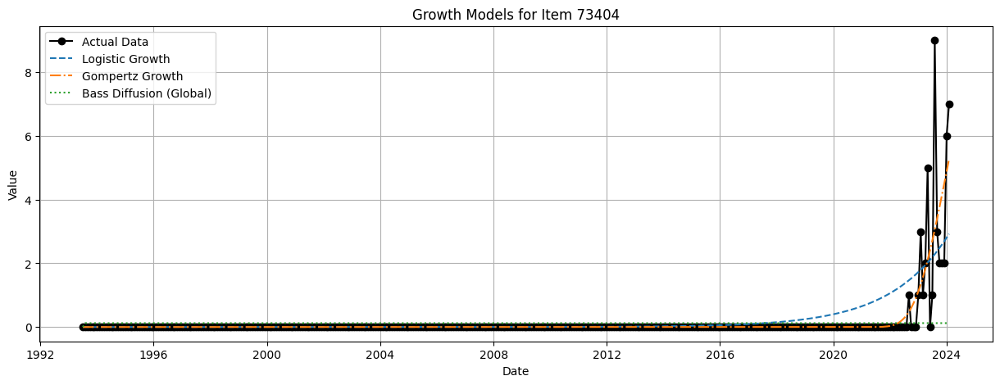

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


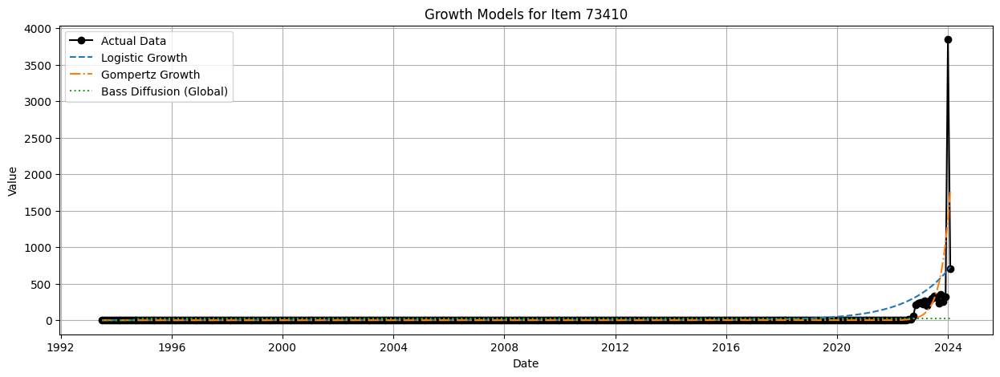

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


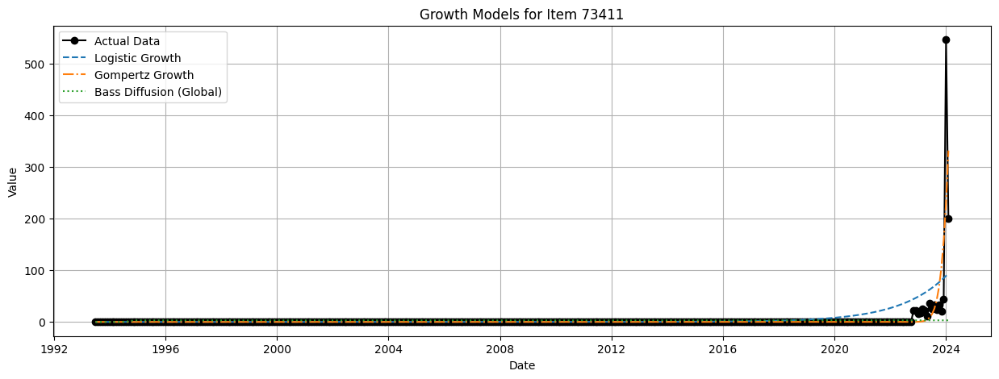

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


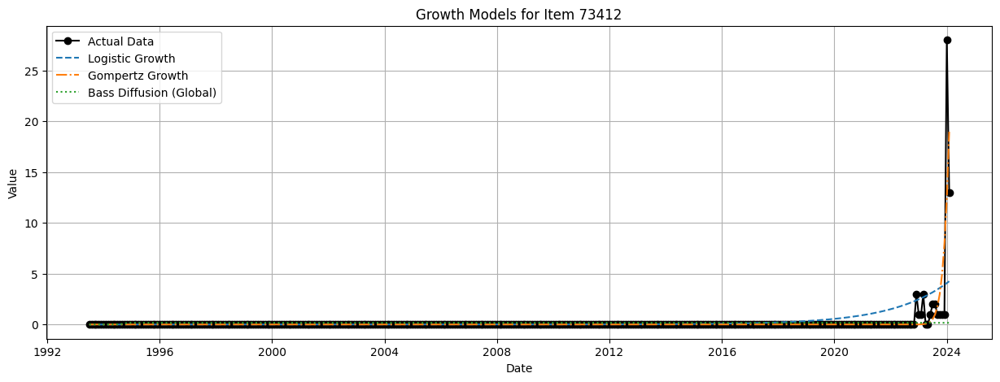

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


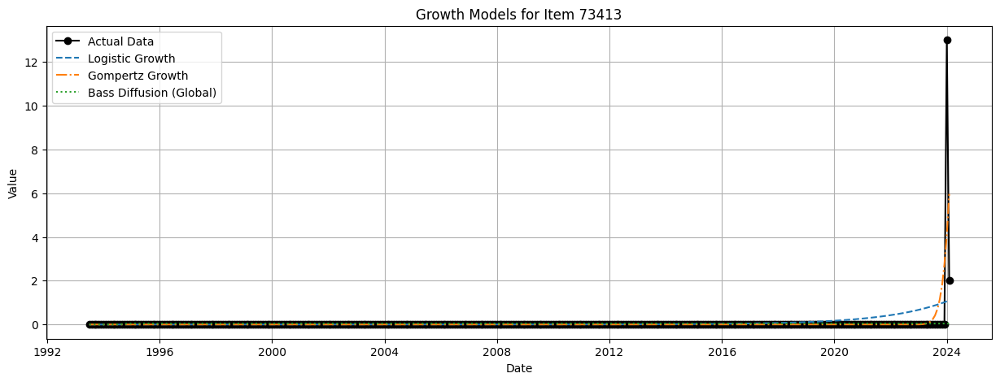

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


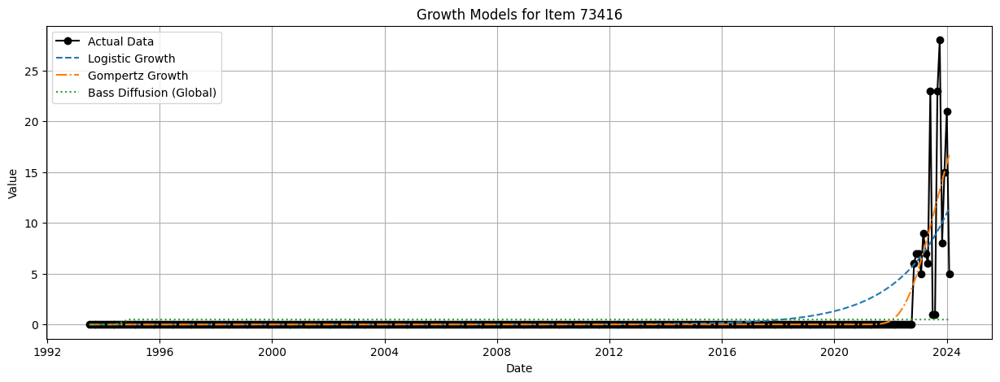

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


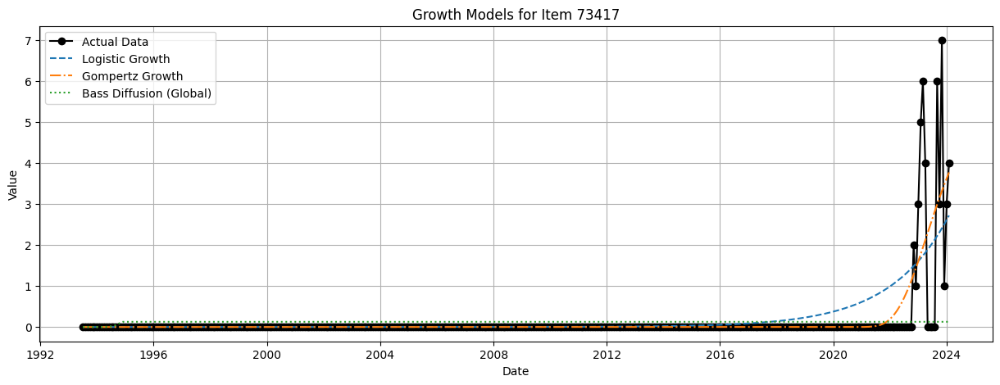

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


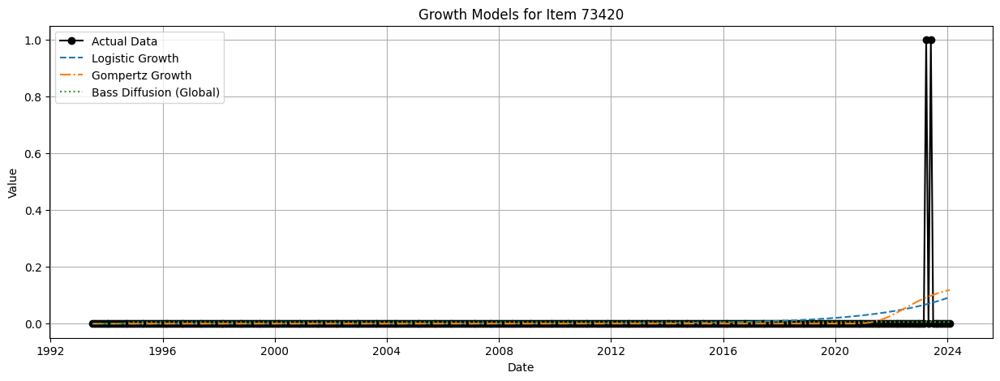

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


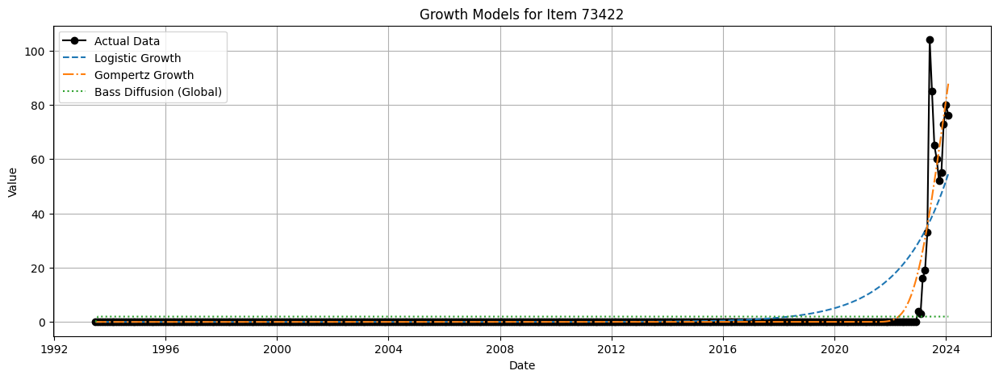

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


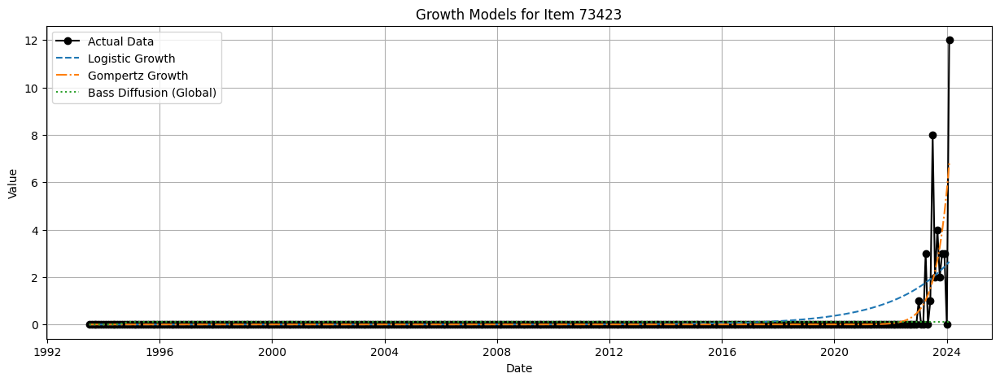

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


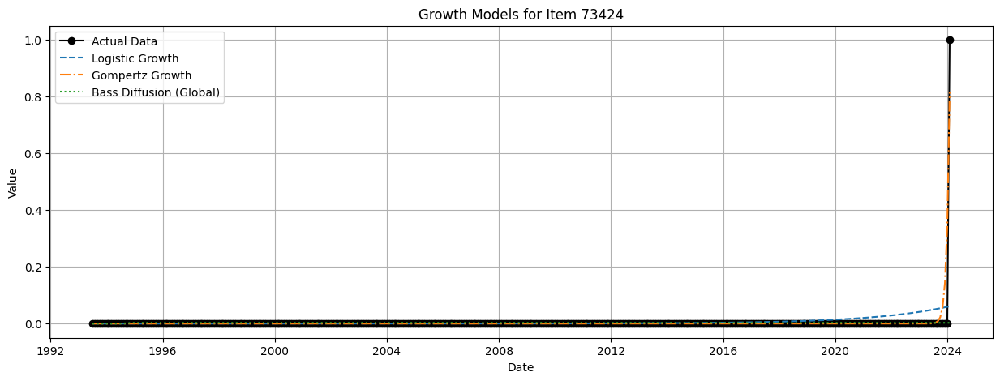

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


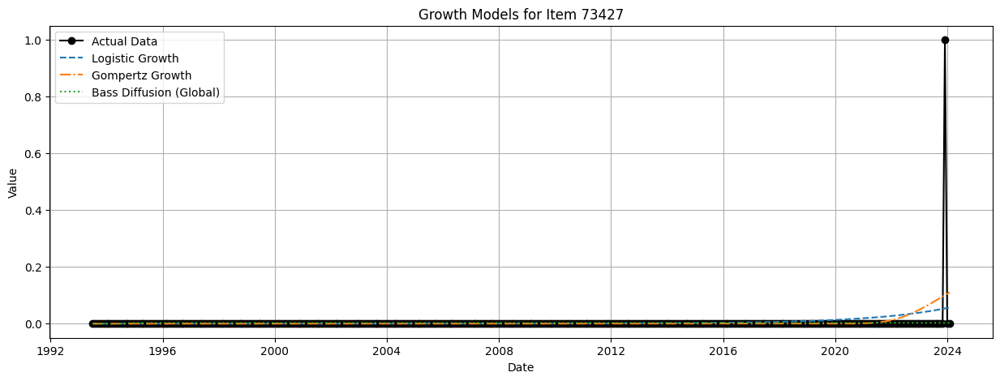

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


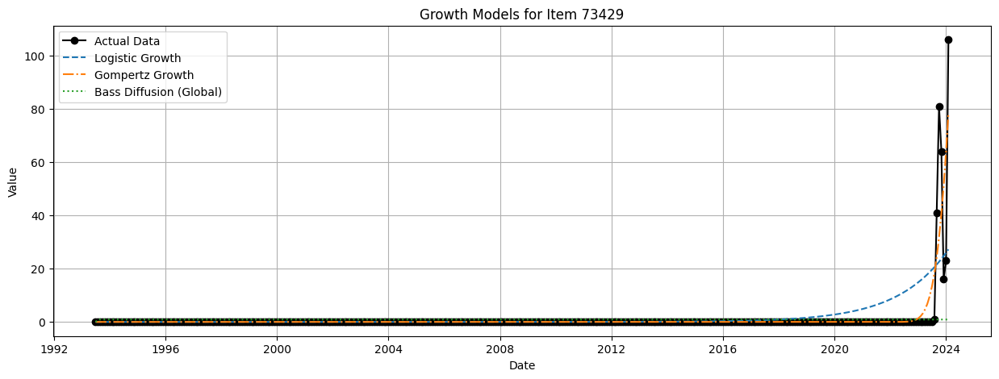

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


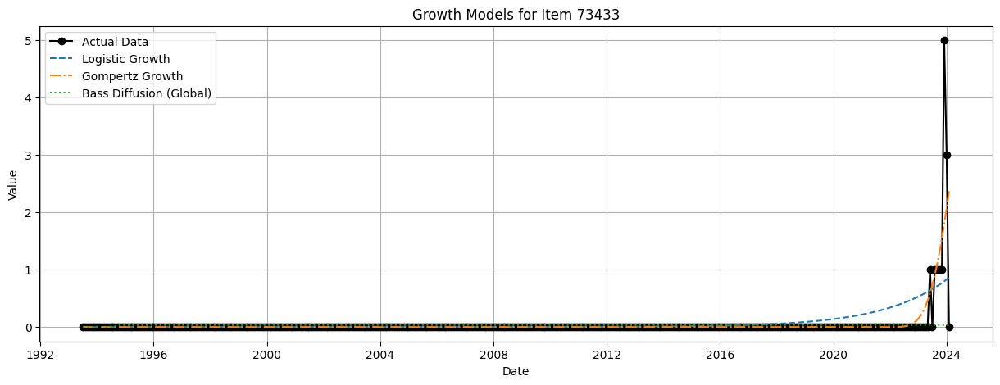

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


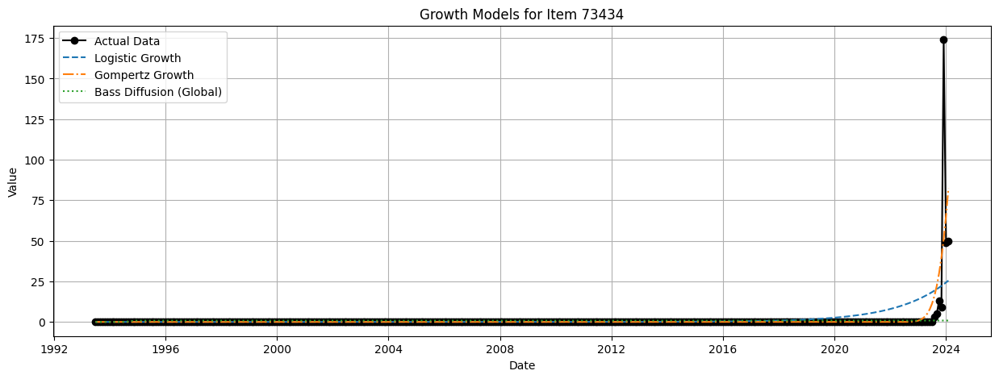

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


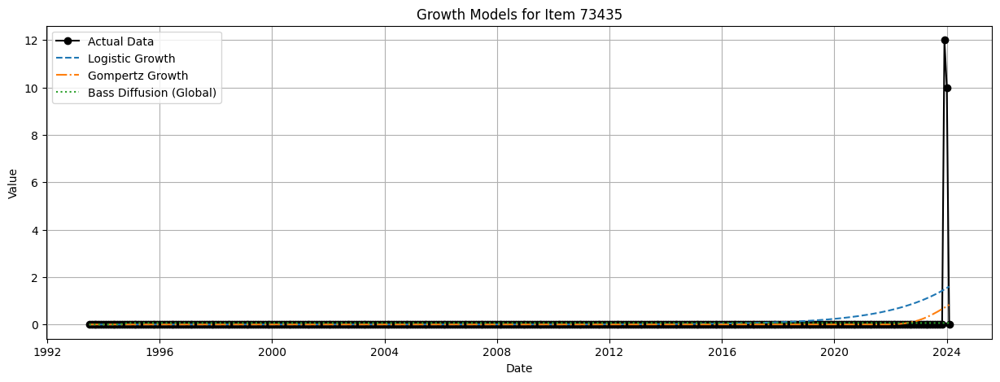

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


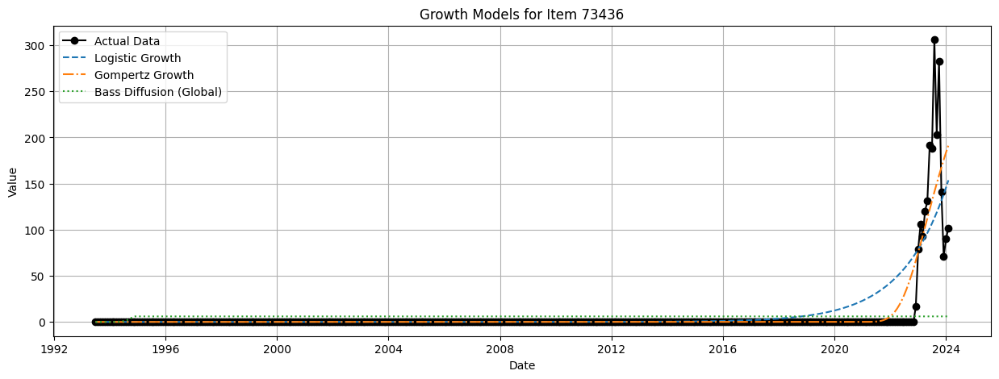

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


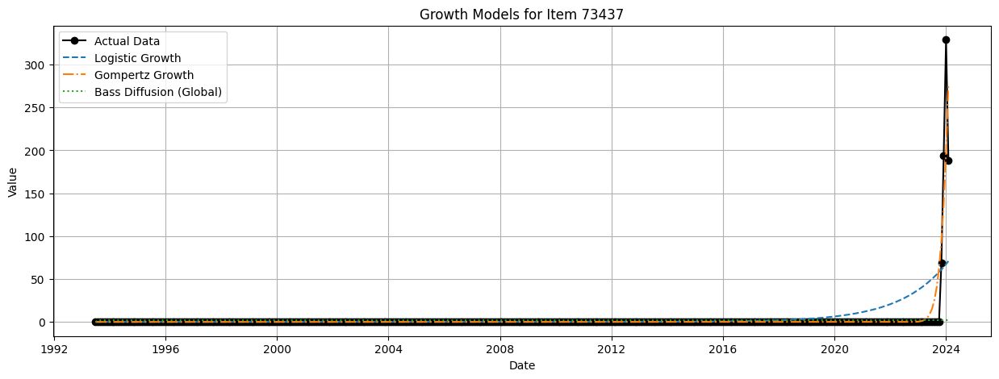

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


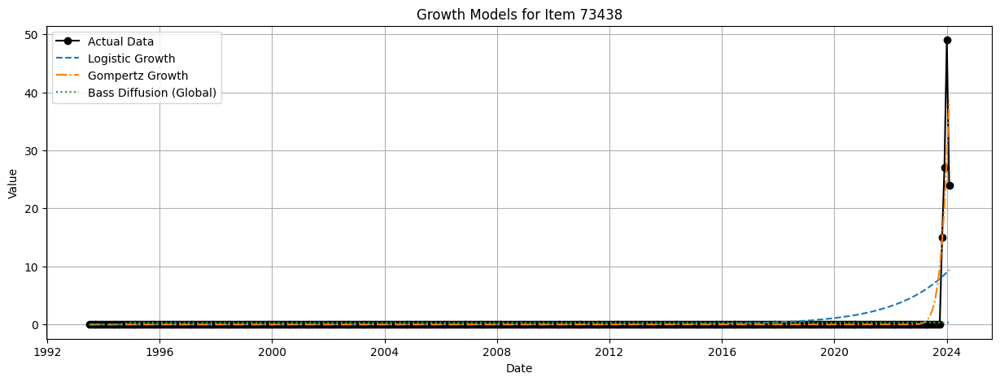

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


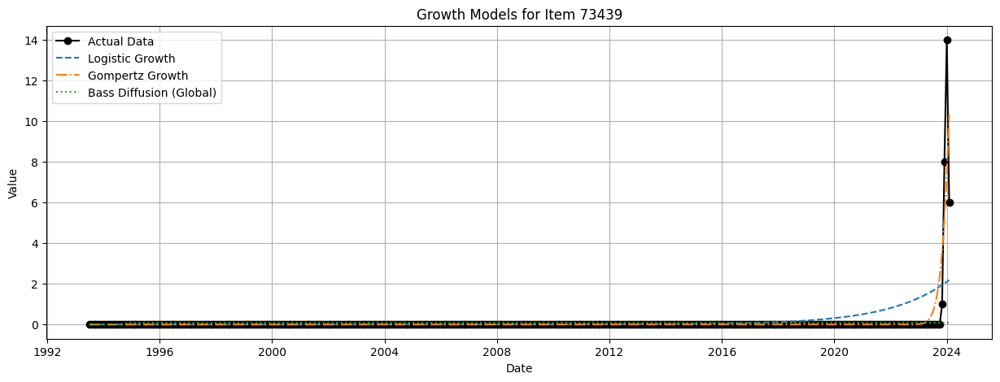

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


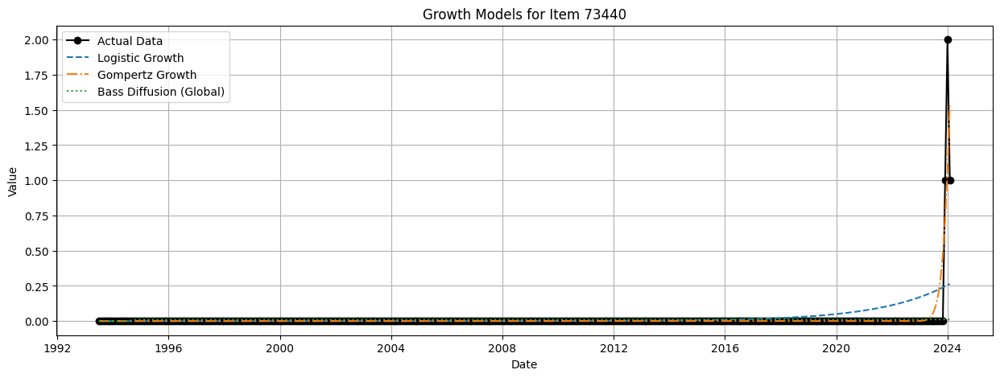

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


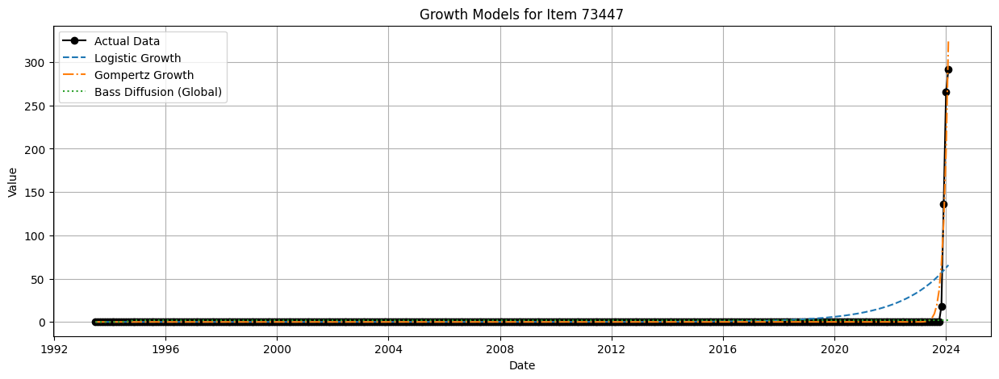

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


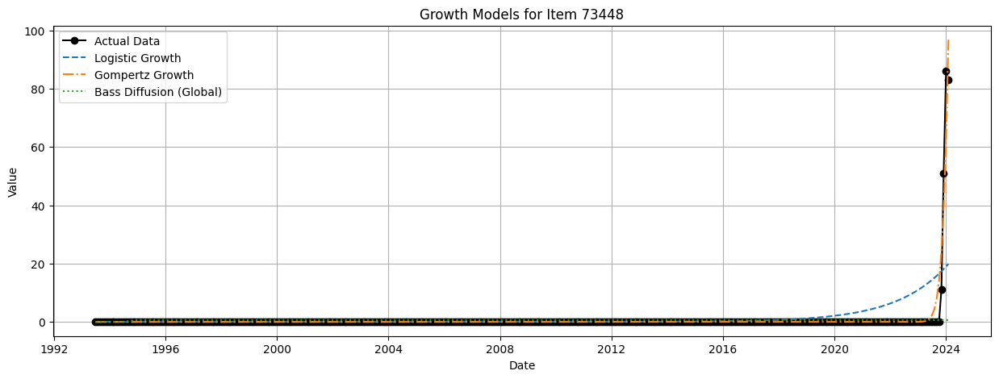

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


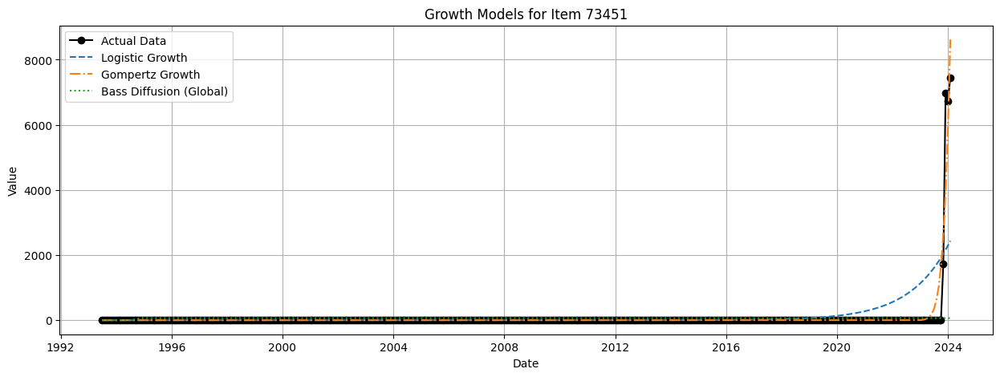

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


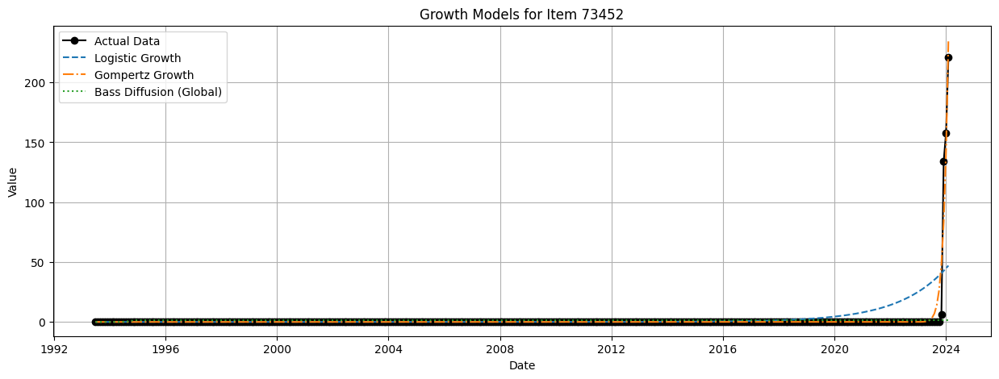

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


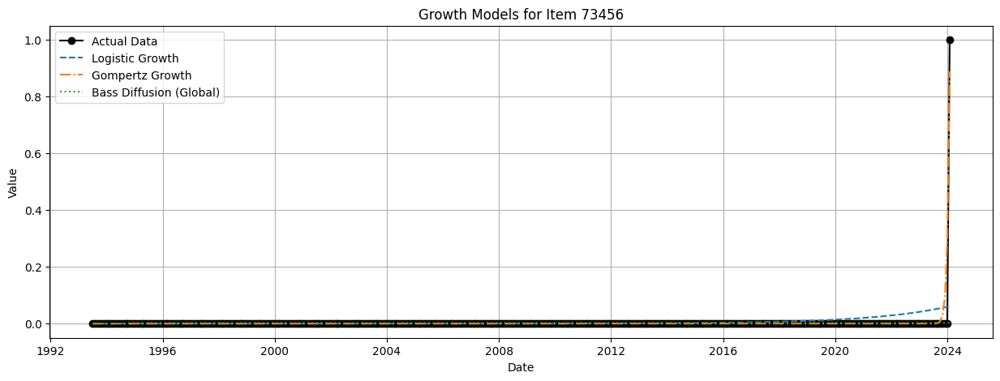

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


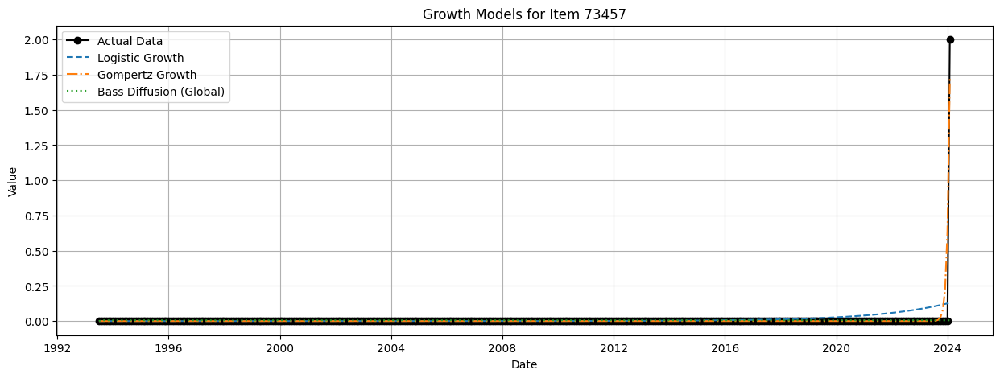

Results for Item 73287:
Logistic Growth Metrics (R², MAE, MAPE, RMSE): (0.04579073994048055, 377.7540813344855, 33.08699408863756, 440.014624031564)
Gompertz Growth Metrics (R², MAE, MAPE, RMSE): (0.046807608235910125, 377.32961675562524, 32.52230551466375, 439.7801072397212)
Bass Diffusion Metrics (Global Optimization) (R², MAE, MAPE, RMSE): (0.04762328781784264, 376.76668286563034, 30.689489416546532, 439.59189946962067)


Results for Item 73289:
Logistic Growth Metrics (R², MAE, MAPE, RMSE): (0.9080839007400645, 340.21400842822584, 15.604091200670148, 510.18642056222546)
Gompertz Growth Metrics (R², MAE, MAPE, RMSE): (0.9079723393170784, 340.7900927778669, 15.426802088334416, 510.49594122007215)
Bass Diffusion Metrics (Global Optimization) (R², MAE, MAPE, RMSE): (0.07157280939939903, 1356.342418471748, 74.4239239016912, 1621.4629431192989)


Results for Item 73290:
Logistic Growth Metrics (R², MAE, MAPE, RMSE): (0.948576787522192, 49.4074156208773, inf, 86.08085072736156)
Gompertz G

In [11]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.optimize import curve_fit, least_squares, differential_evolution
from sklearn.metrics import r2_score, mean_absolute_error, mean_squared_error

# Load the dataset from the Feather file using pandas
mdf = pd.read_feather("/mnt/c/Users/doughnut/OneDrive - The University of Melbourne/Phase 1 - Study 4 - Australian Genetic and Genomic Test Utilisation/Data Files/Processed_MBSGeneticsCount_20240325_175333.feather")

# Ensure that "Month" is in datetime format
mdf['Month'] = pd.to_datetime(mdf['Month'])

# Group data by 'Month' and 'Item' and calculate the sum of 'Value' with observed=False to prevent warnings
df = mdf.groupby(['Month', 'Item'], observed=False)['Value'].sum().reset_index()

# Make all values positive
df['Value'] = df['Value'].abs()

# Rename the "Month" and "Value" columns
df = df.rename(columns={"Month": "ds", "Value": "y"})

# Convert the "ds" column to ordinal to use in growth models
df['ds_ordinal'] = df['ds'].apply(lambda x: x.toordinal())

# Define the logistic, Gompertz, and Bass diffusion models
def logistic_growth(t, K, P0, r):
    P0 = max(P0, 1e-6)  # Add a small constant to avoid division by zero
    return K / (1 + ((K - P0) / P0) * np.exp(-r * t))

def gompertz_growth(t, a, b, c):
    return a * np.exp(-b * np.exp(-c * t))

def bass_diffusion(t, p, q, m):
    # Ensure p and q are not too small to avoid invalid division
    p = max(p, 1e-6)
    q = max(q, 1e-6)
    
    # Prevent overflow by limiting the input to exp()
    t = np.clip(t, -500, 500)
    
    # Compute the Bass diffusion model
    diffusion_value = m * (1 - np.exp(-(p + q) * t)) / (1 + (q / p) * np.exp(-(p + q) * t))
    
    # Clip any NaN or infinite values that result from invalid inputs
    diffusion_value = np.nan_to_num(diffusion_value, nan=0.0, posinf=0.0, neginf=0.0)
    
    return diffusion_value

# Optimized initial guess function for Gompertz model
def optimize_initial_guesses(func, t_data, y_data, param_ranges, num_trials=100):
    best_params = None
    best_r2 = -np.inf
    
    for _ in range(num_trials):
        initial_guesses = [np.random.uniform(low, high) for low, high in param_ranges]
        
        try:
            params, _ = curve_fit(func, t_data, y_data, p0=initial_guesses, bounds=([0, 0, 0], [np.inf, np.inf, np.inf]), maxfev=5000)
            y_pred = func(t_data, *params)
            r2 = r2_score(y_data, y_pred)
            if r2 > best_r2:
                best_r2 = r2
                best_params = params
        except RuntimeError:
            continue
    
    return best_params, best_r2

# Define ranges for the Gompertz parameters (a, b, c)
gompertz_param_ranges = [(0.8 * max(df['y']), 1.2 * max(df['y'])), (0.001, 2), (0.001, 2)]

# Global optimization for Bass diffusion using differential evolution
def global_optim_bass_diffusion(t_data, y_data):
    # Objective function to minimize: -R² (to maximize R²)
    def objective(params):
        p, q, m = params
        y_pred = bass_diffusion(t_data, p, q, m)
        # Check for invalid values before calculating R²
        if np.any(np.isnan(y_pred)) or np.any(np.isinf(y_pred)):
            return 1e6  # Return a large penalty if invalid values are found
        r2 = r2_score(y_data, y_pred)
        return -r2  # We minimize, so we negate R²
    
    # Set bounds for p, q, m
    bounds = [(1e-6, 1), (1e-6, 1), (0, max(y_data))]
    
    # Perform global optimization using differential evolution
    result = differential_evolution(objective, bounds)
    return result.x

# Loop over each unique Item and apply the models
items = df['Item'].unique()
results = []

for item in items:
    df_item = df[df['Item'] == item].copy()
    t_data = df_item['ds_ordinal'] - df_item['ds_ordinal'].min()
    y_data = df_item['y']

    # Fit the logistic model
    logistic_params, _ = curve_fit(logistic_growth, t_data, y_data, p0=[max(y_data), min(y_data), 0.1], maxfev=5000)

    # Fit the Gompertz model with optimized initial guesses
    gompertz_params, gompertz_r2 = optimize_initial_guesses(gompertz_growth, t_data, y_data, gompertz_param_ranges)

    # Fit the Bass diffusion model using global optimization (differential evolution)
    bass_params_global = global_optim_bass_diffusion(t_data, y_data)

    # Generate predictions
    df_item['logistic_pred'] = logistic_growth(t_data, *logistic_params)
    df_item['gompertz_pred'] = gompertz_growth(t_data, *gompertz_params)
    df_item['bass_pred_global'] = bass_diffusion(t_data, *bass_params_global)

    # Ensure predictions contain no invalid values
    df_item.replace([np.inf, -np.inf, np.nan], 0, inplace=True)

    # Define evaluation metrics
    def calculate_metrics(y_true, y_pred):
        r2 = r2_score(y_true, y_pred)
        mae = mean_absolute_error(y_true, y_pred)
        mape = np.mean(np.abs((y_true - y_pred) / y_true)) * 100
        rmse = np.sqrt(mean_squared_error(y_true, y_pred))
        return r2, mae, mape, rmse

    # Calculate metrics for each model
    logistic_metrics = calculate_metrics(df_item['y'], df_item['logistic_pred'])
    gompertz_metrics = calculate_metrics(df_item['y'], df_item['gompertz_pred'])
    bass_metrics_global = calculate_metrics(df_item['y'], df_item['bass_pred_global'])

    results.append({
        "Item": item,
        "Logistic_Metrics": logistic_metrics,
        "Gompertz_Metrics": gompertz_metrics,
        "Bass_Metrics_Global": bass_metrics_global
    })

    # Plot the results for this item
    plt.figure(figsize=(15, 5))
    plt.plot(df_item['ds'], df_item['y'], label='Actual Data', color='black', marker='o')
    plt.plot(df_item['ds'], df_item['logistic_pred'], label='Logistic Growth', linestyle='--')
    plt.plot(df_item['ds'], df_item['gompertz_pred'], label='Gompertz Growth', linestyle='-.')
    plt.plot(df_item['ds'], df_item['bass_pred_global'], label='Bass Diffusion (Global)', linestyle=':')
    plt.xlabel('Date')
    plt.ylabel('Value')
    plt.title(f'Growth Models for Item {item}')
    plt.legend()
    plt.grid(True)
    plt.show()

# Display final results
for result in results:
    print(f"Results for Item {result['Item']}:")
    print("Logistic Growth Metrics (R², MAE, MAPE, RMSE):", result['Logistic_Metrics'])
    print("Gompertz Growth Metrics (R², MAE, MAPE, RMSE):", result['Gompertz_Metrics'])
    print("Bass Diffusion Metrics (Global Optimization) (R², MAE, MAPE, RMSE):", result['Bass_Metrics_Global'])
    print("\n")


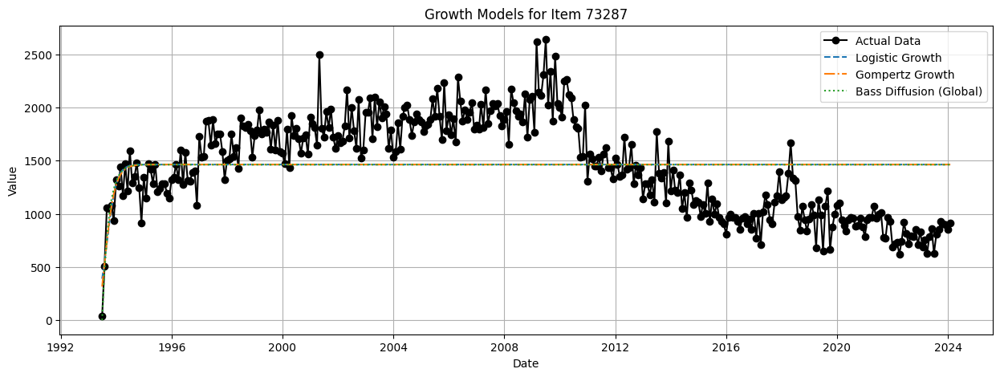

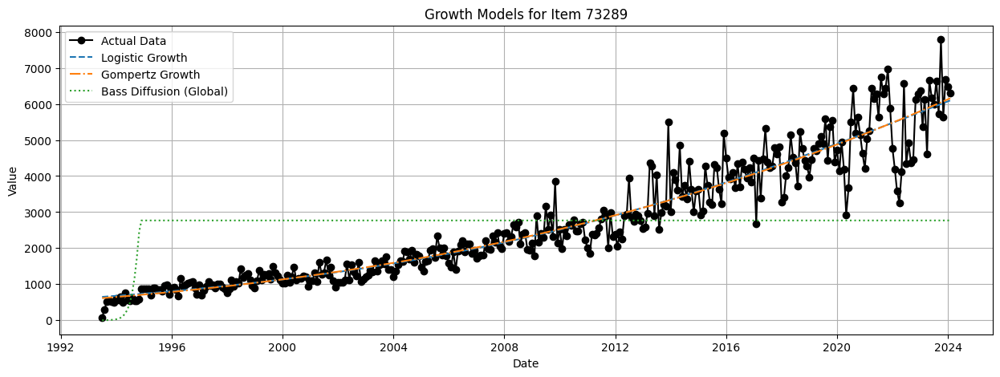

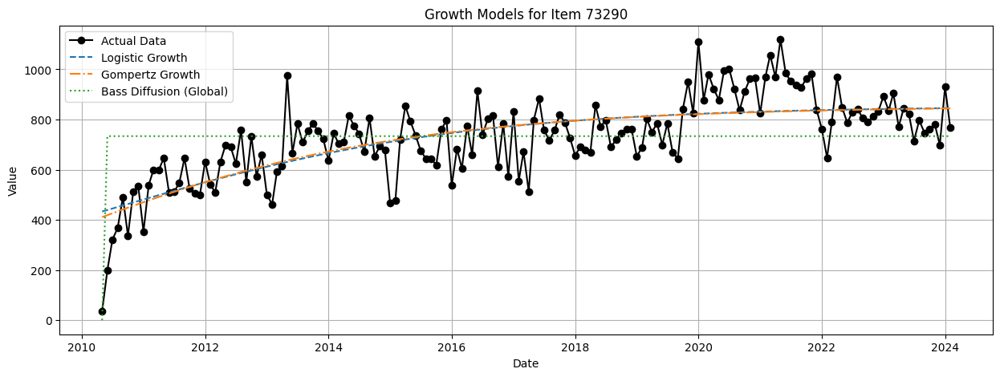

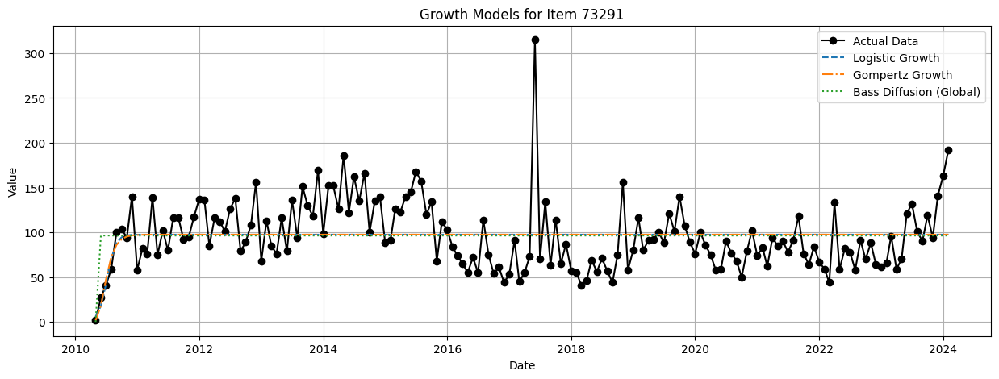

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


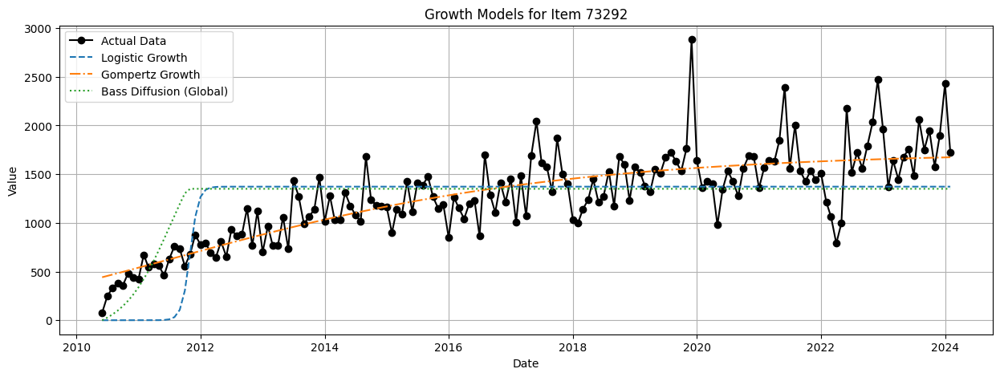

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: overflow encountered in exp
  result = getattr(ufunc, method)(*inputs, **kwargs)
/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


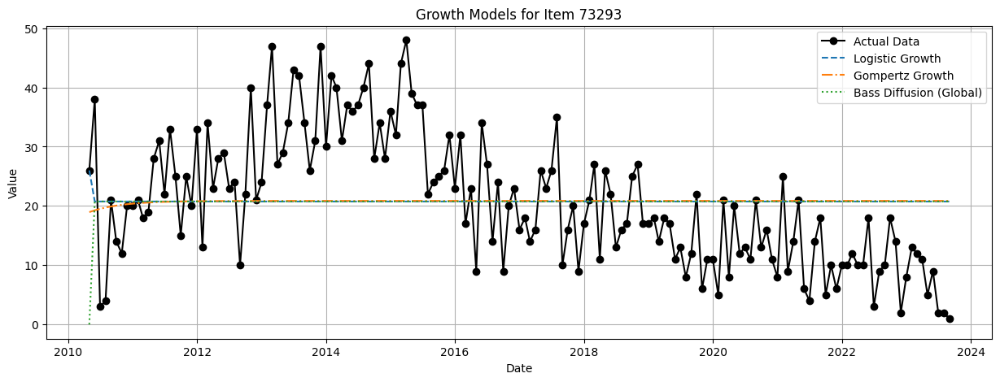

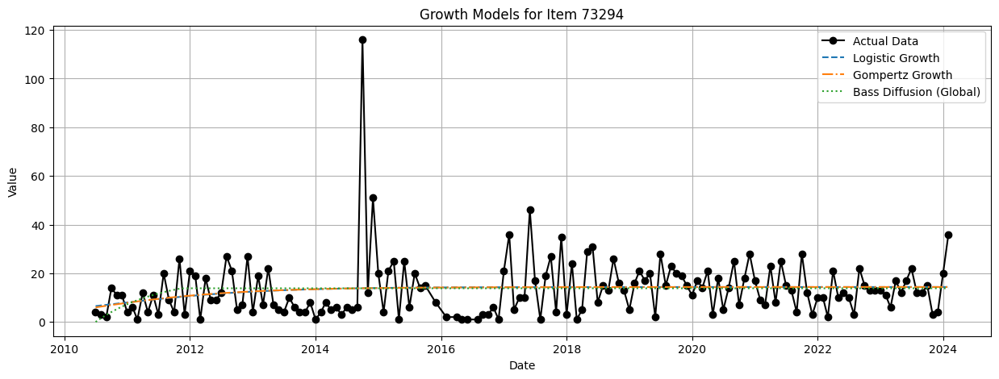

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


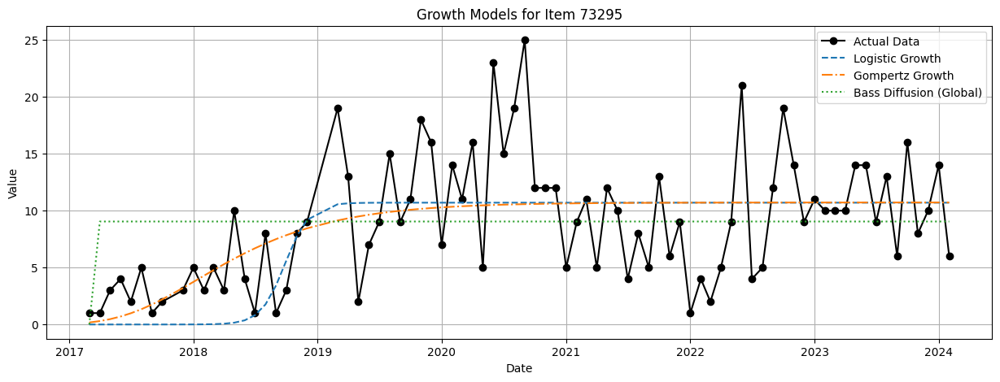

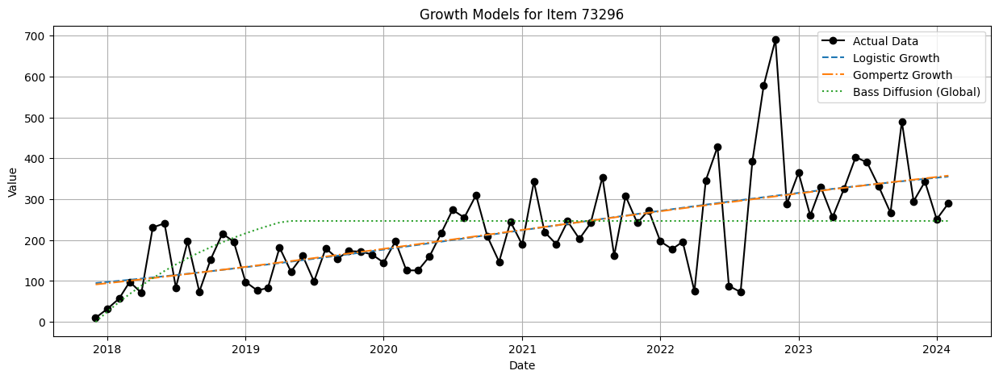

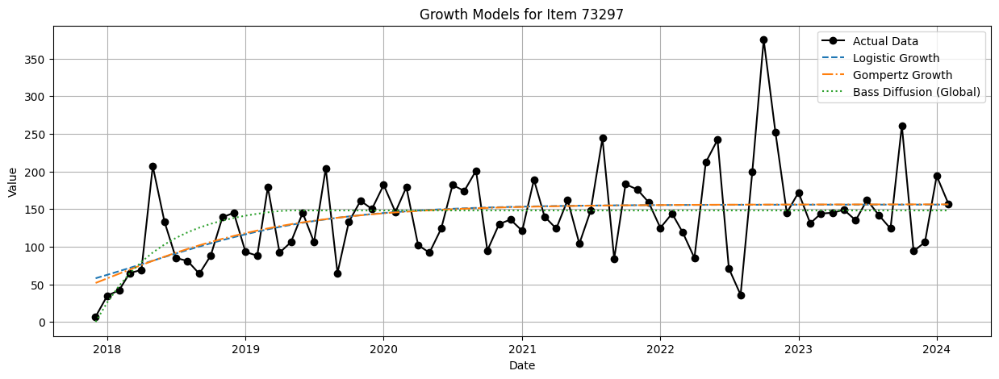

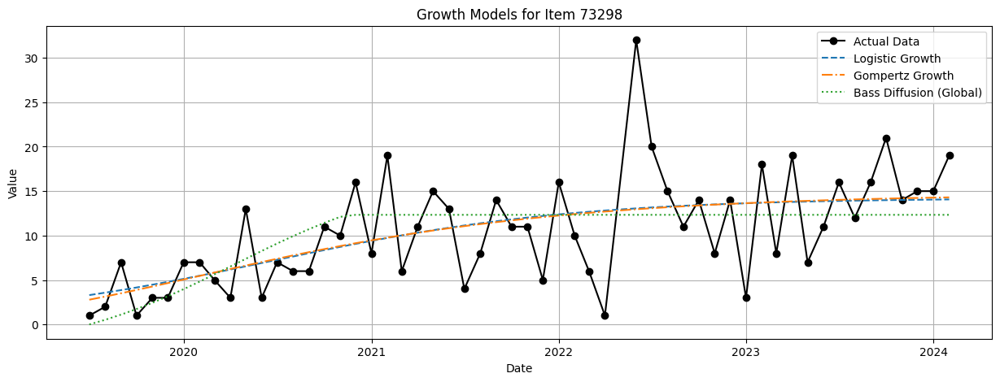

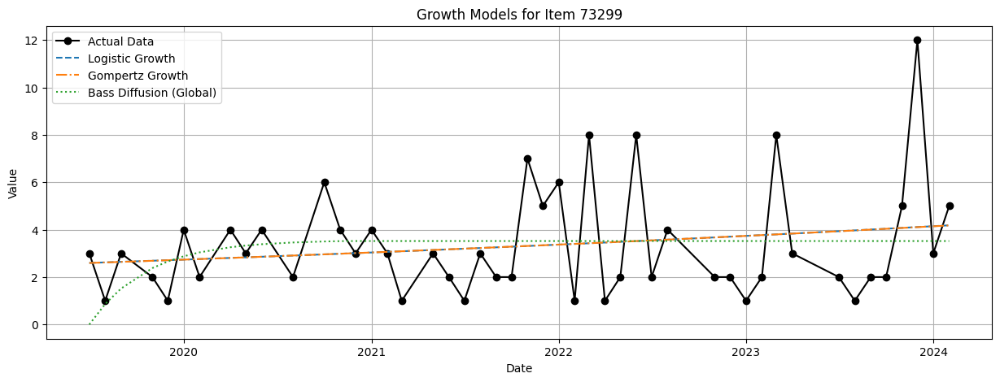

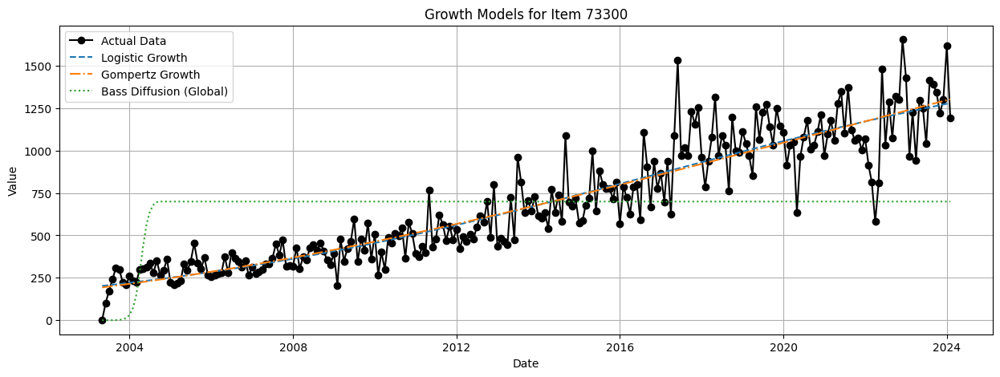

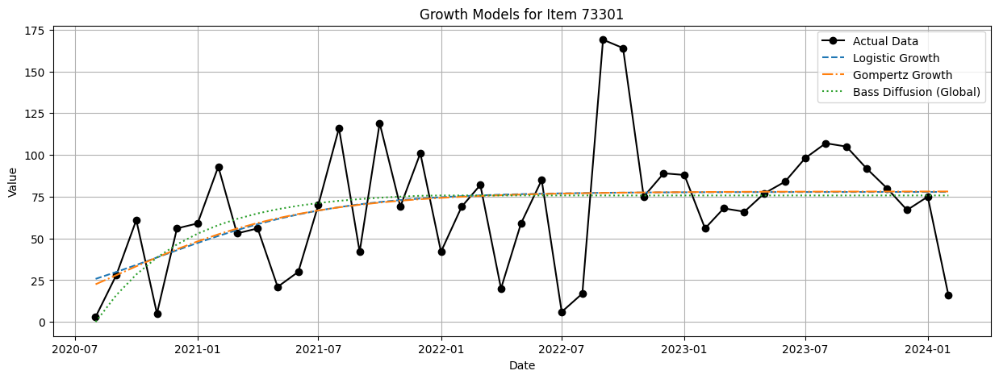

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


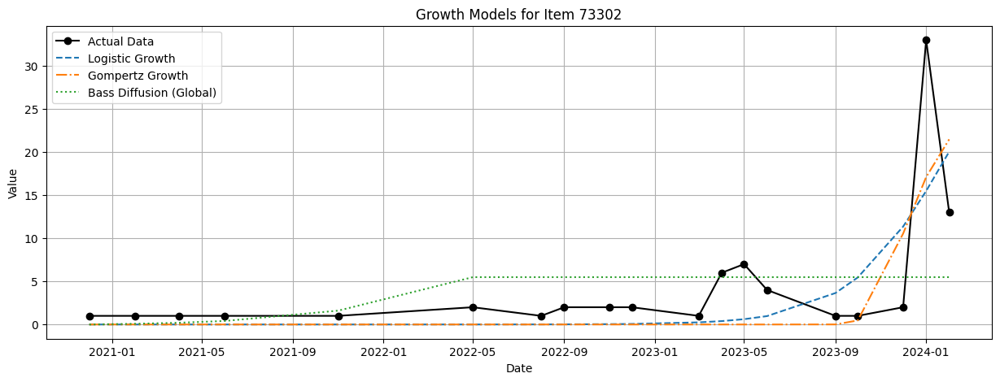

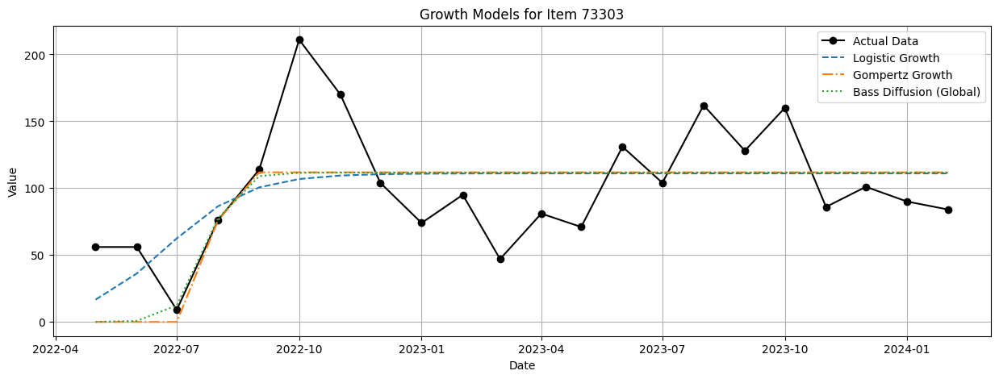

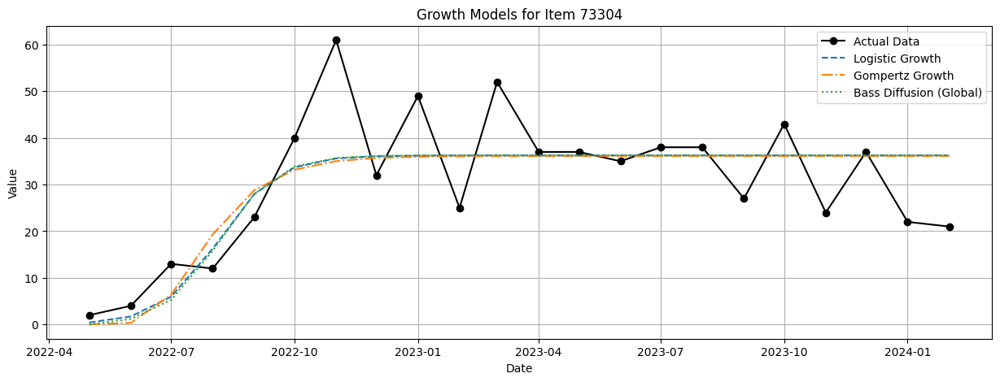

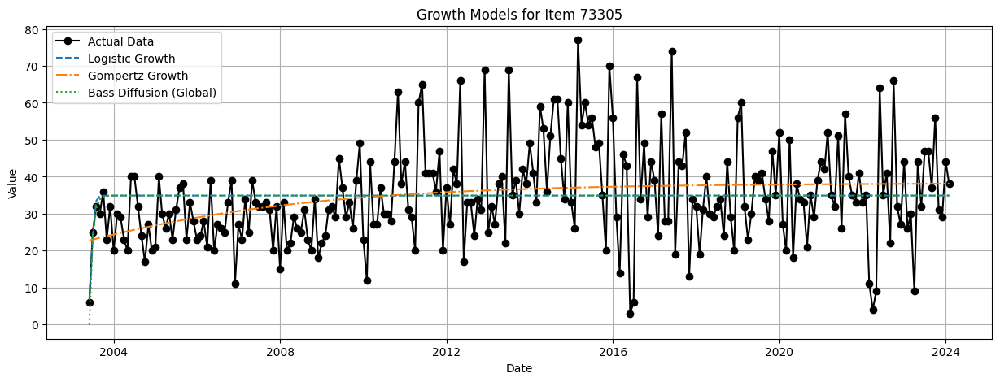

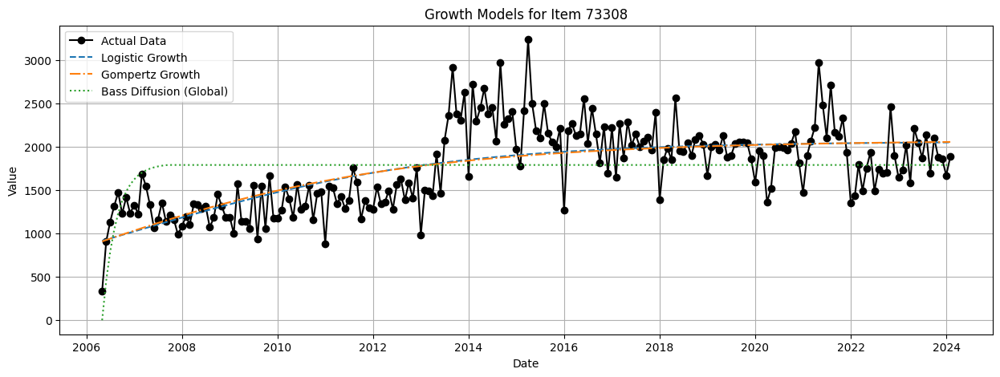

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


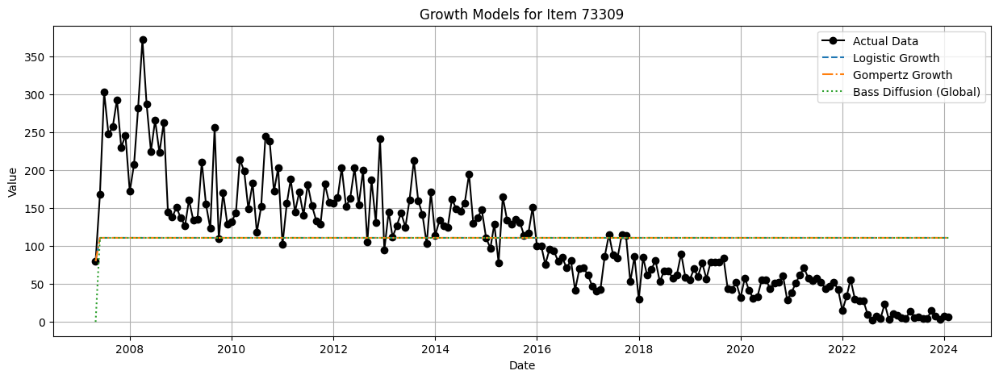

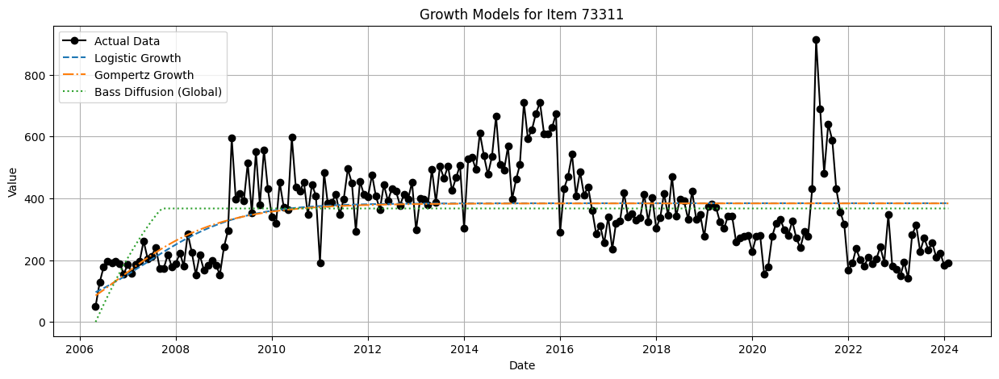

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


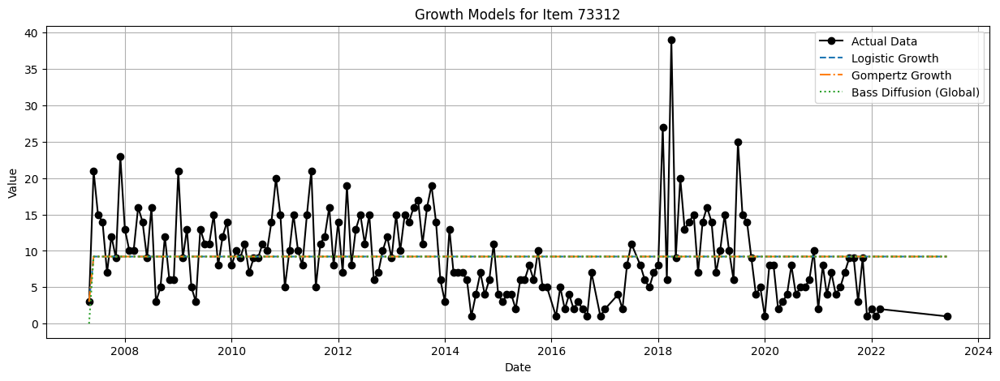

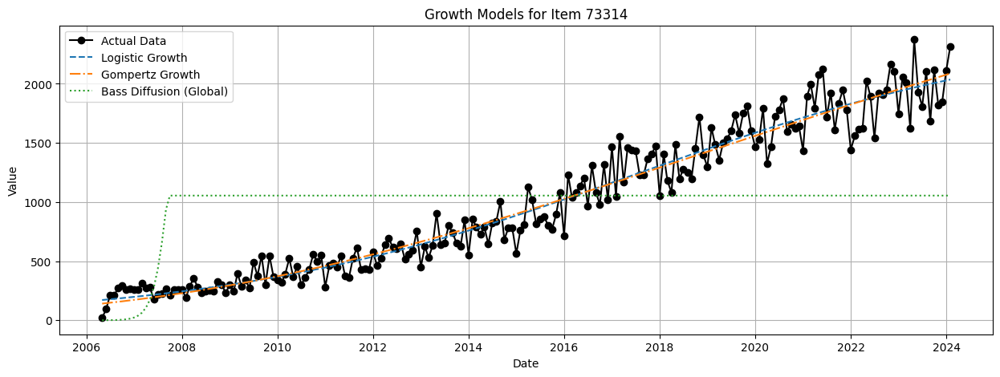

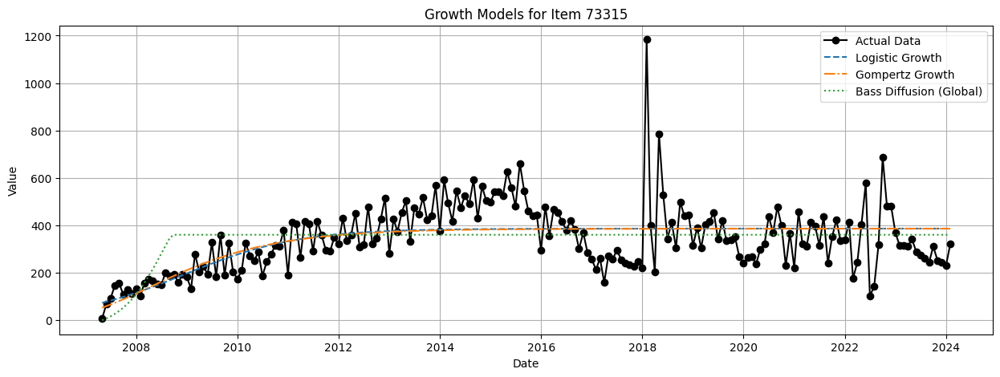

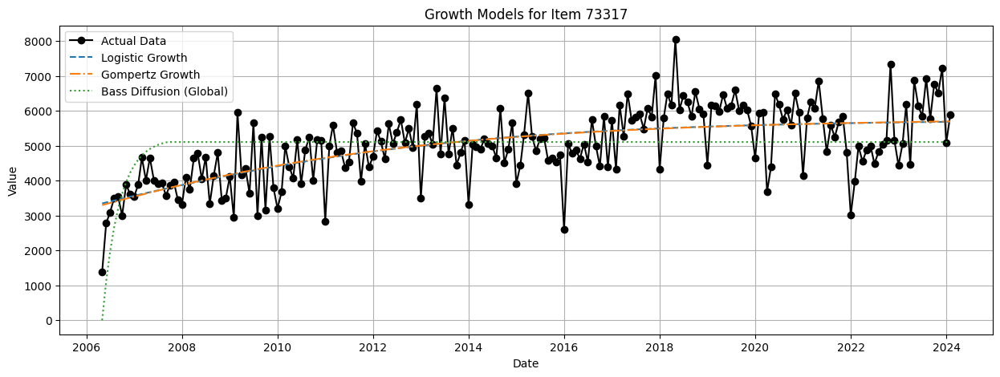

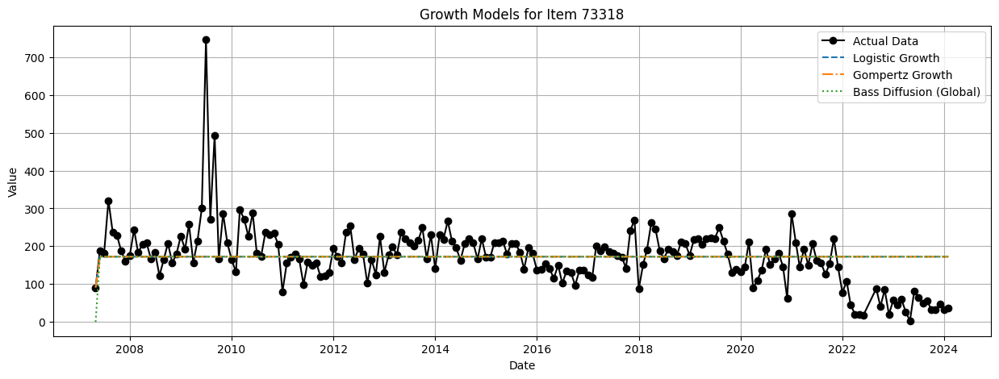

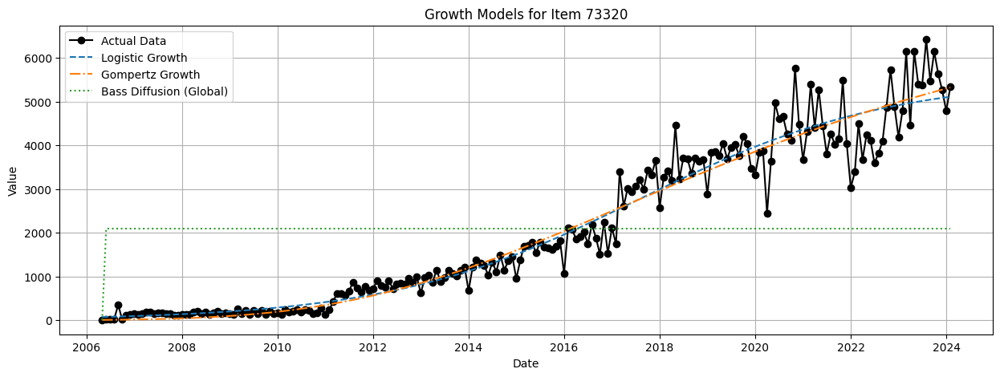

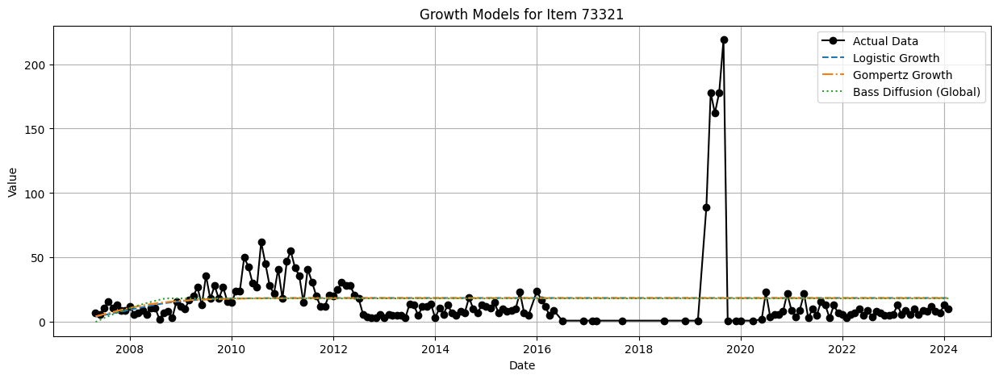

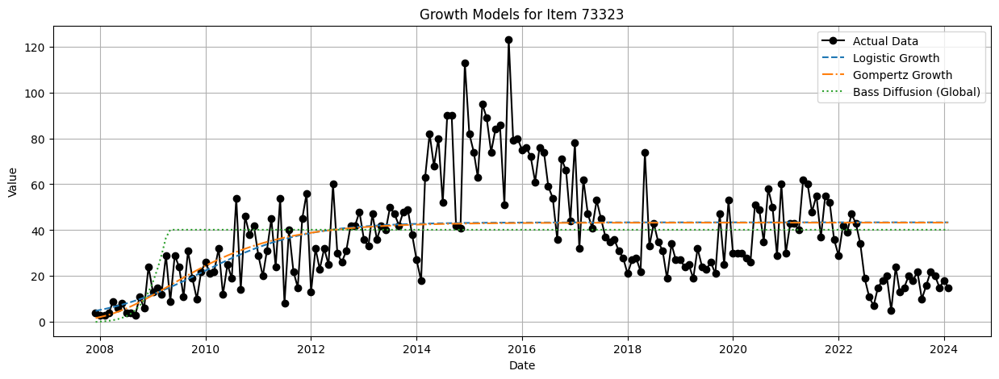

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: overflow encountered in exp
  result = getattr(ufunc, method)(*inputs, **kwargs)
/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: overflow encountered in exp
  result = getattr(ufunc, method)(*inputs, **kwargs)


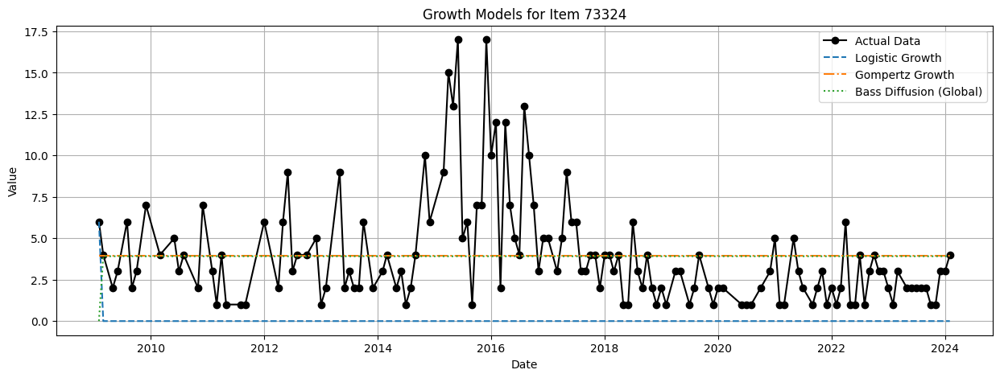

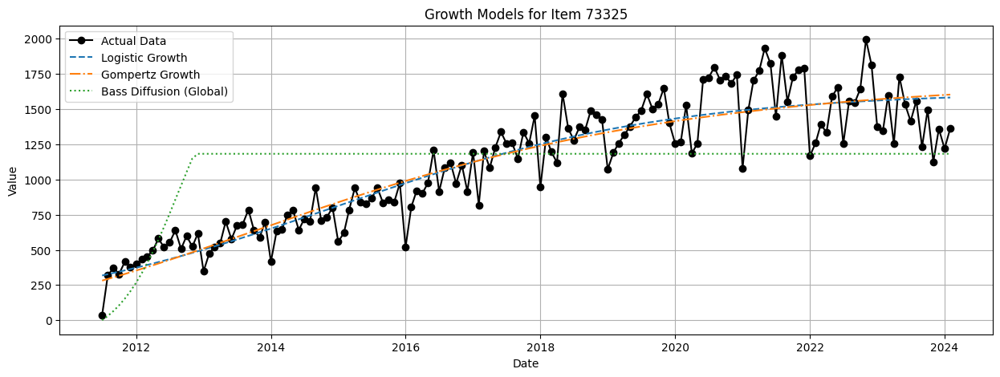

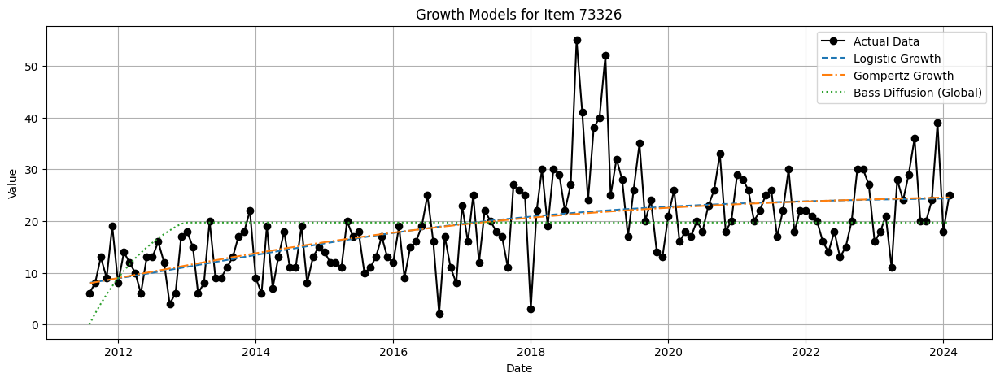

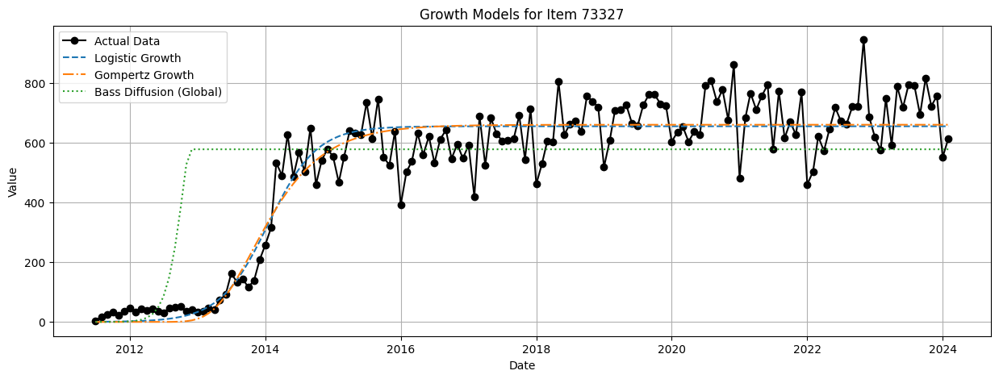

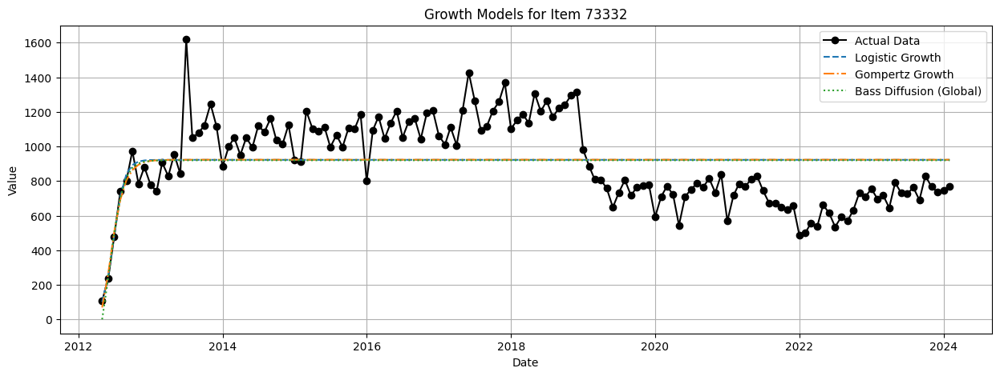

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


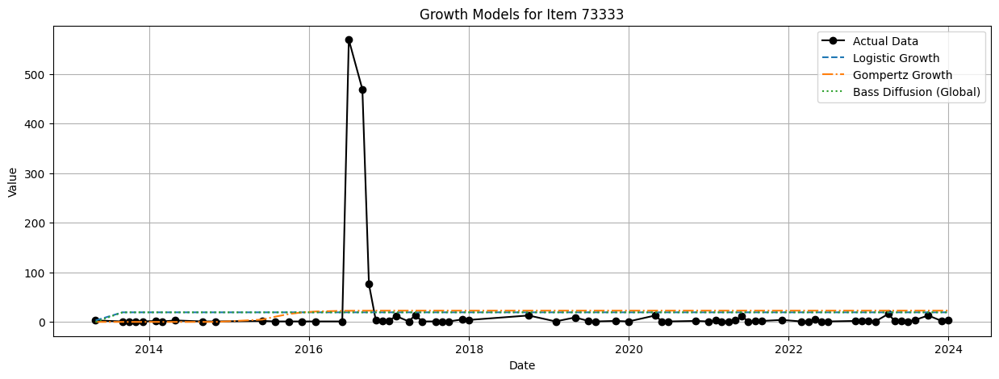

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


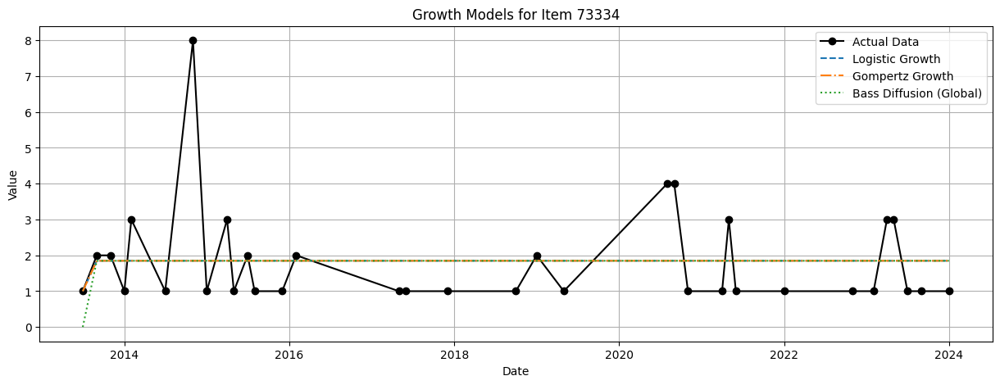

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


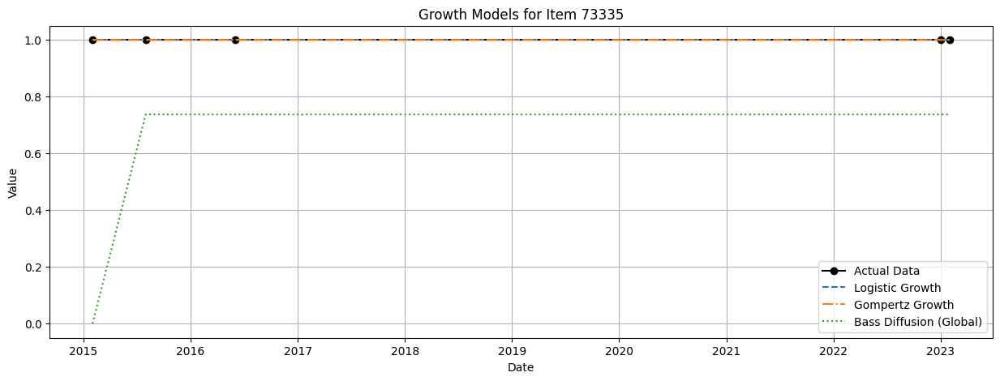

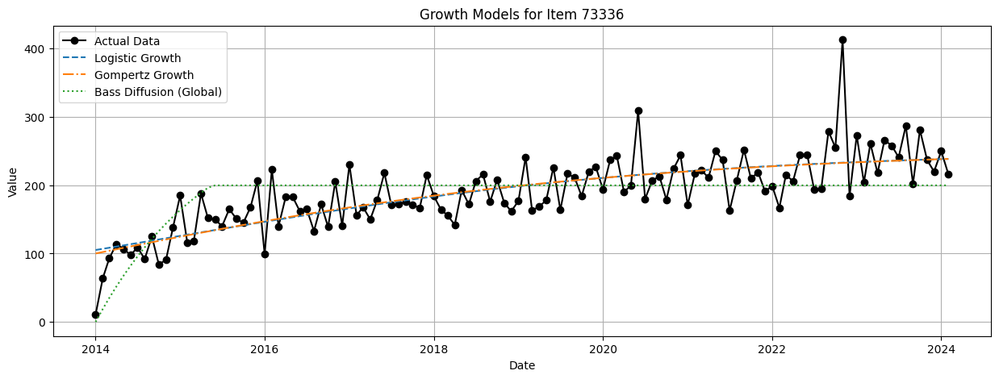

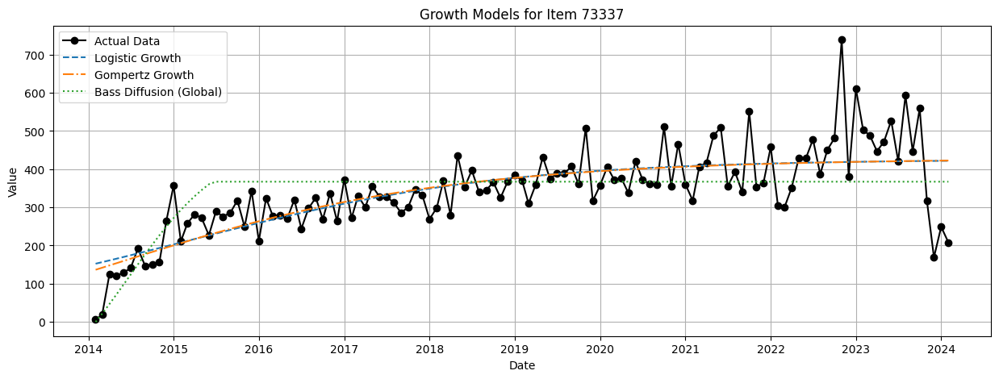

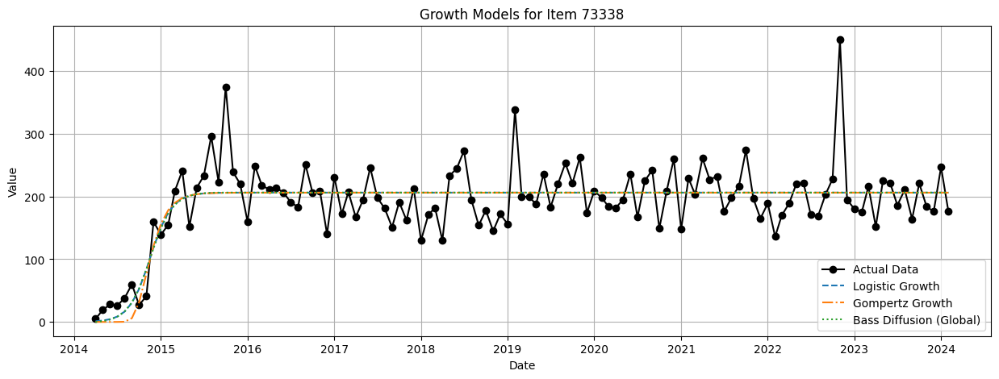

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


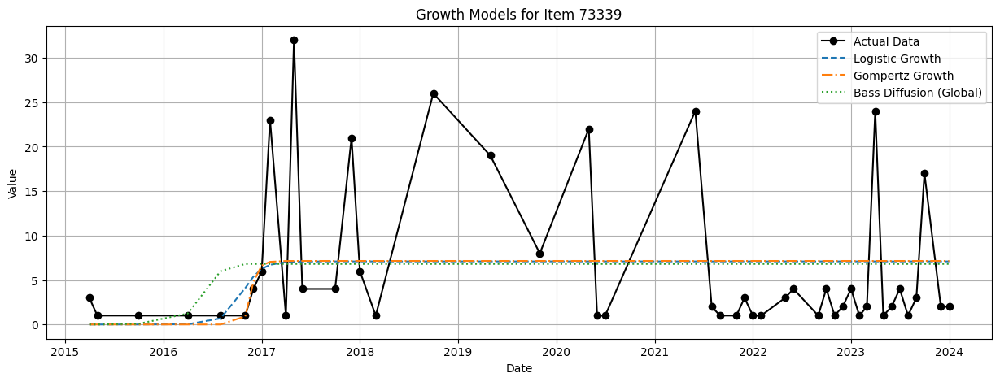

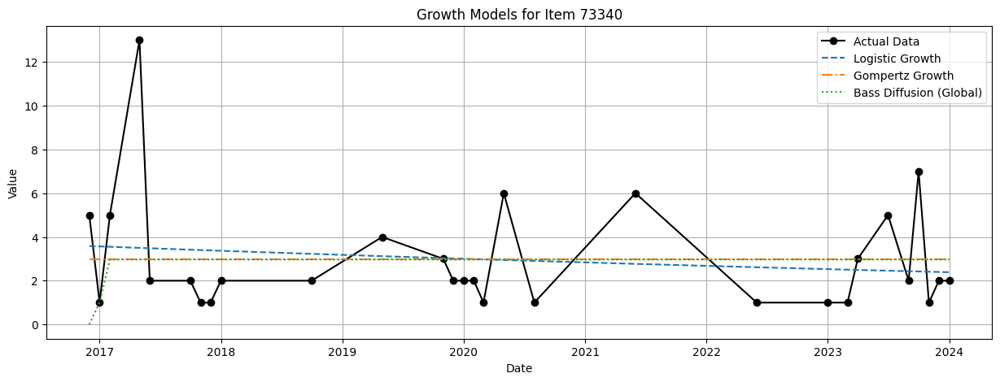

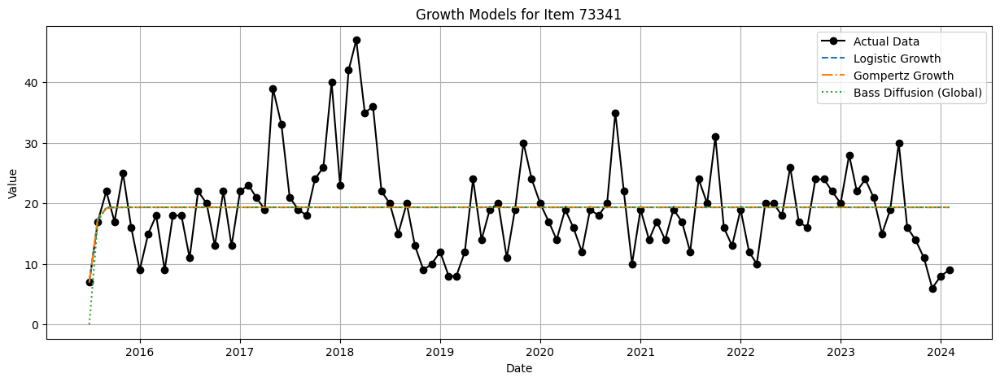

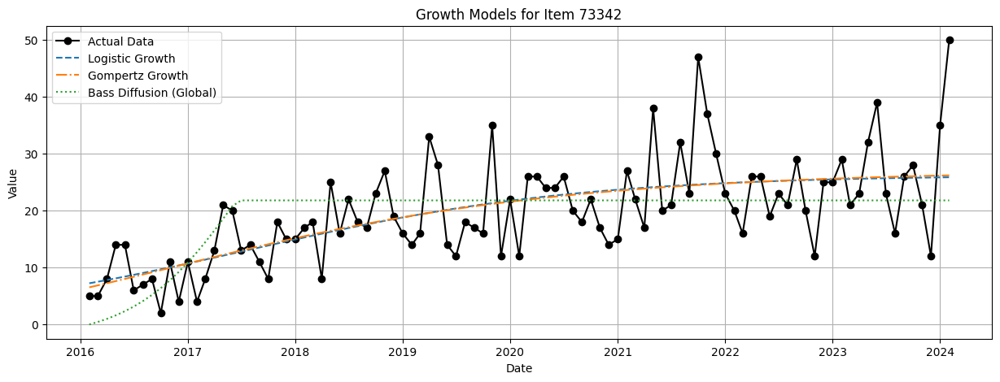

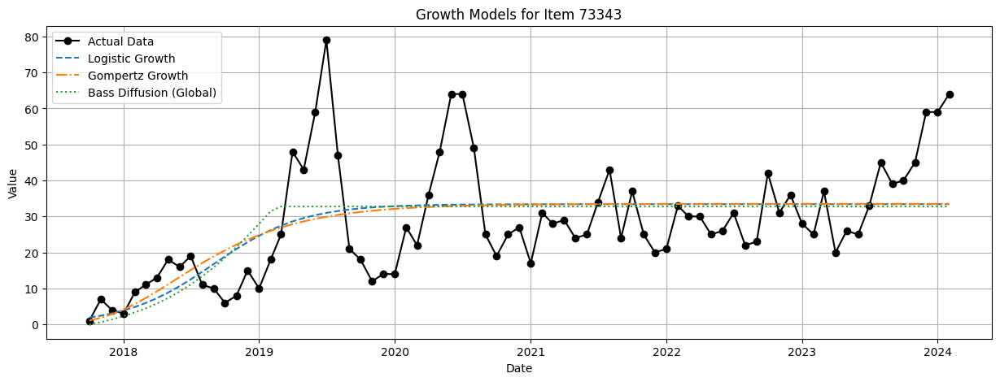

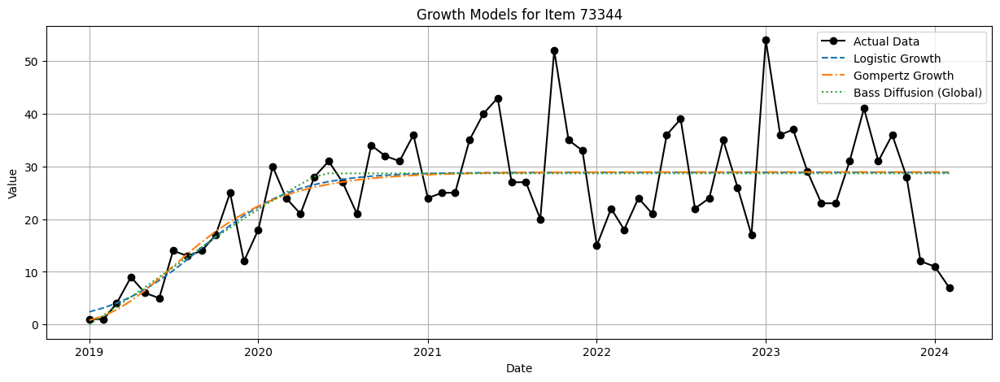

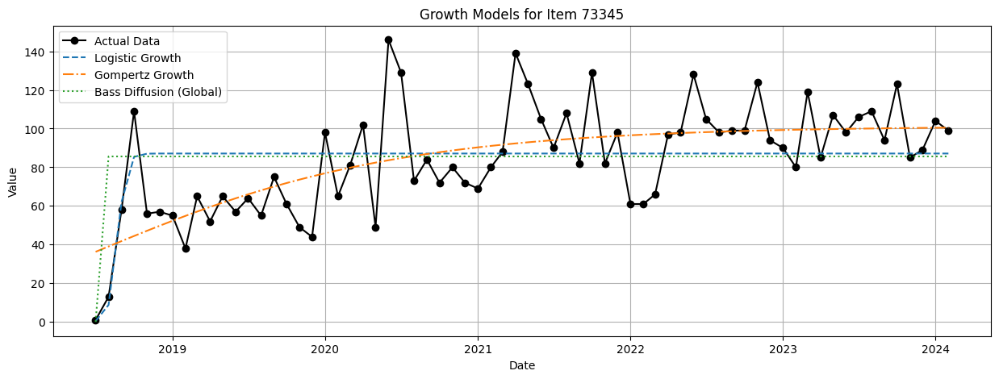

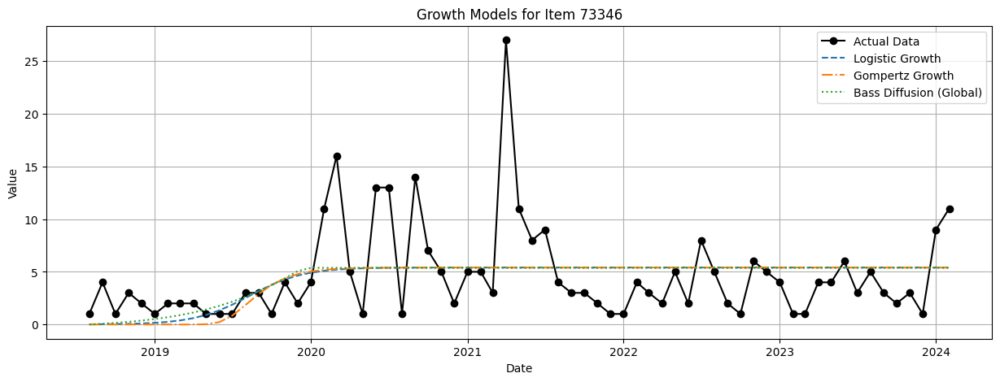

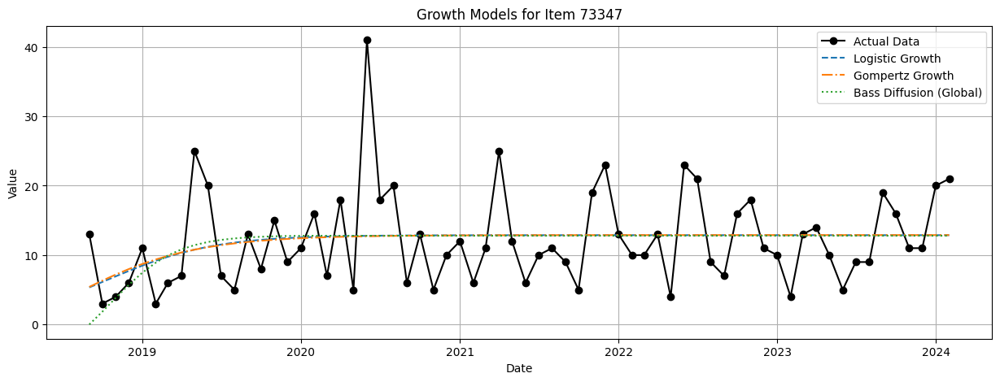

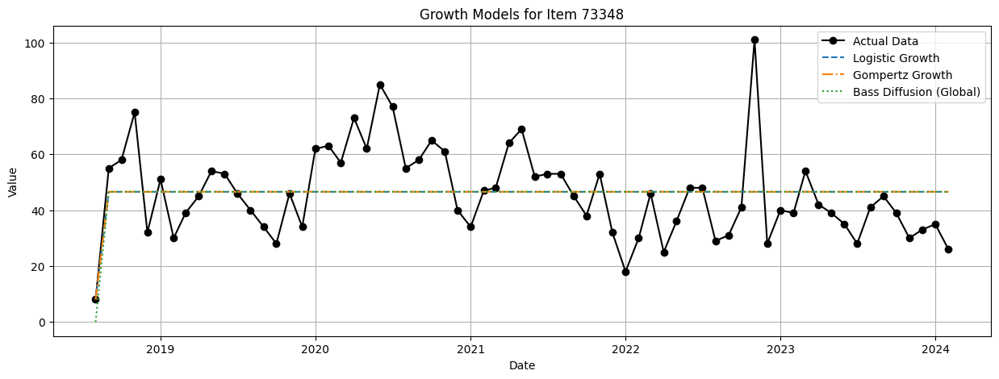

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


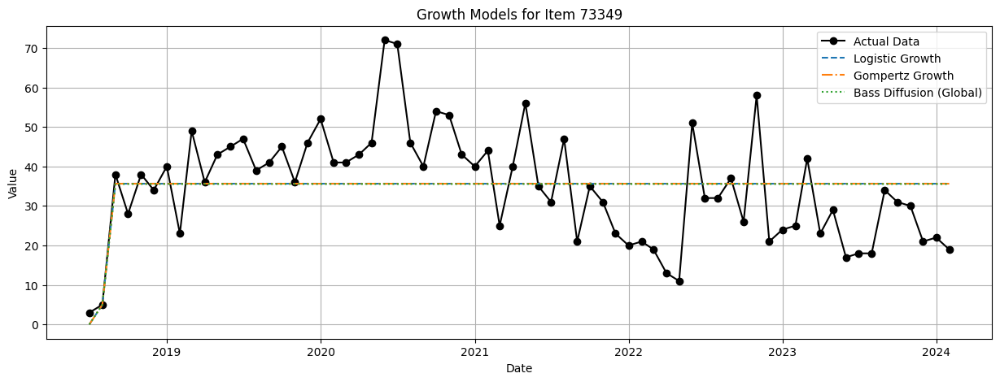

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: overflow encountered in exp
  result = getattr(ufunc, method)(*inputs, **kwargs)
/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: overflow encountered in exp
  result = getattr(ufunc, method)(*inputs, **kwargs)


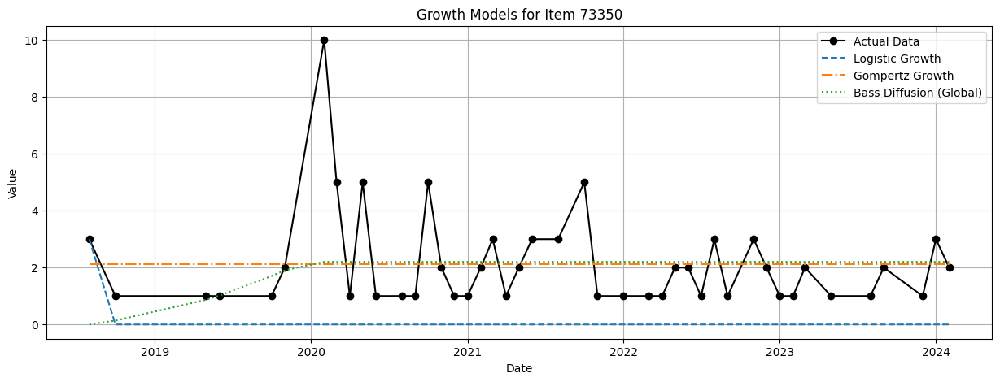

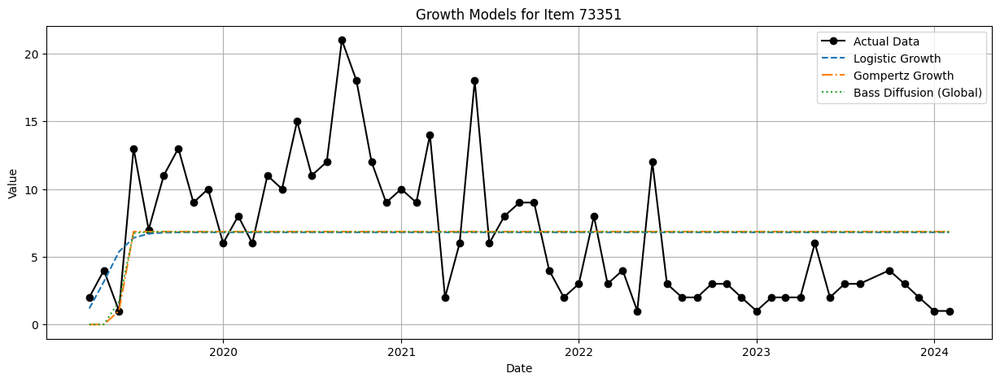

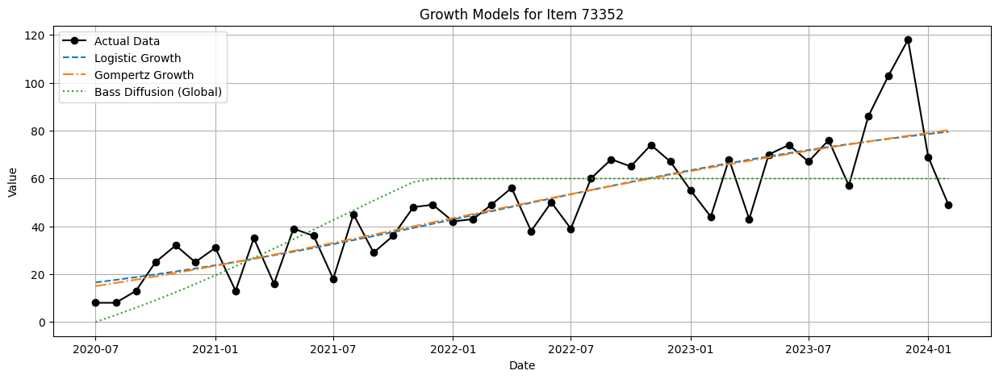

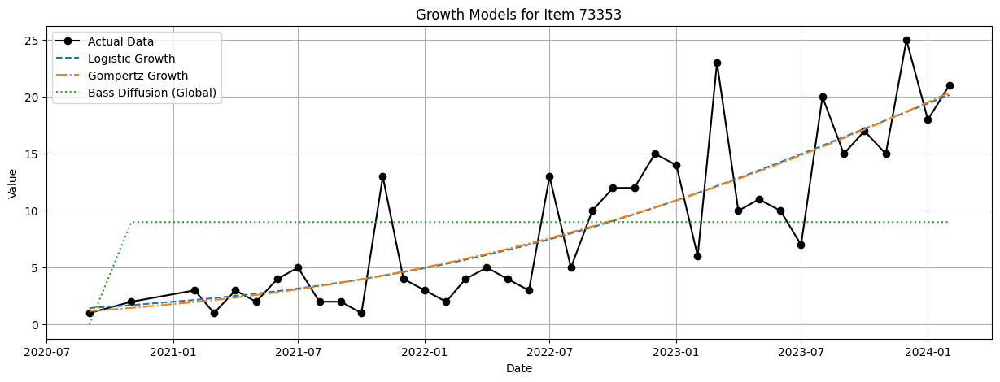

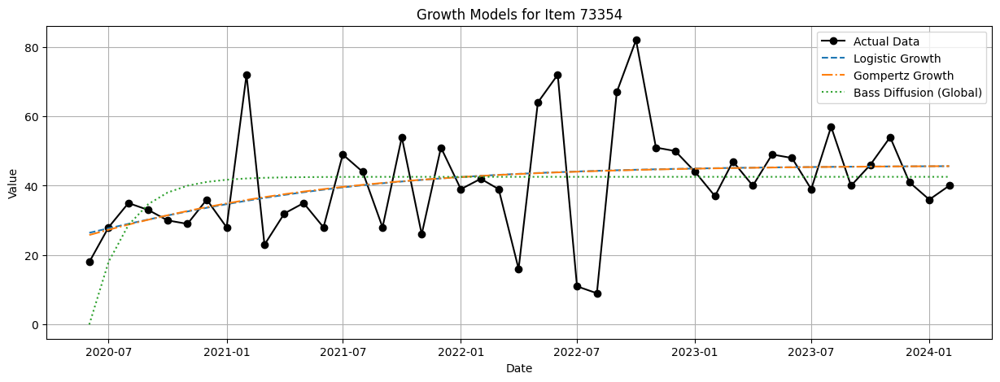

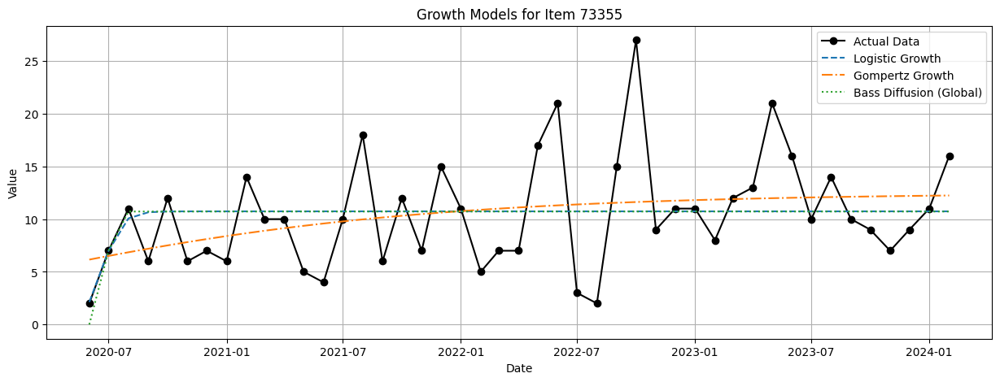

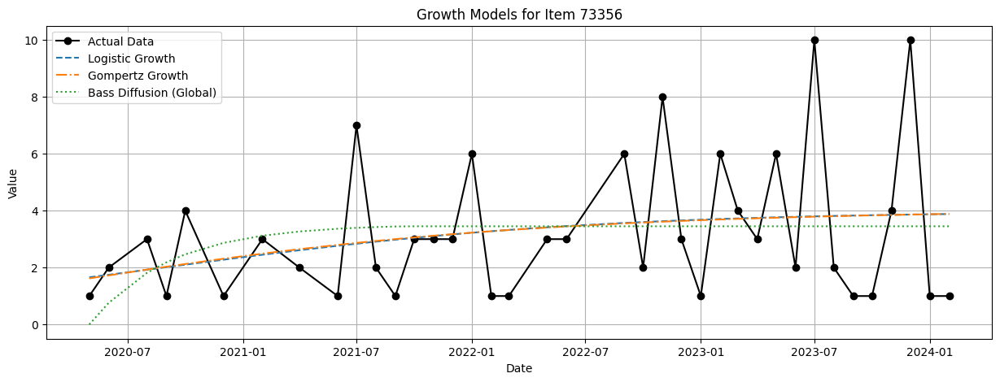

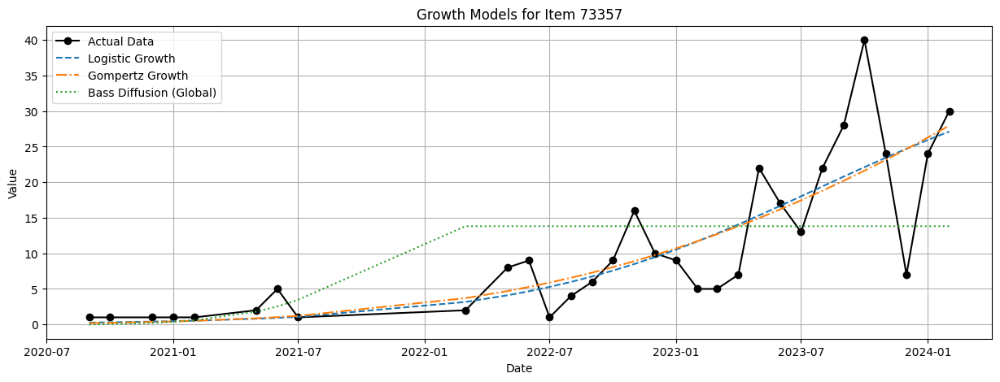

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


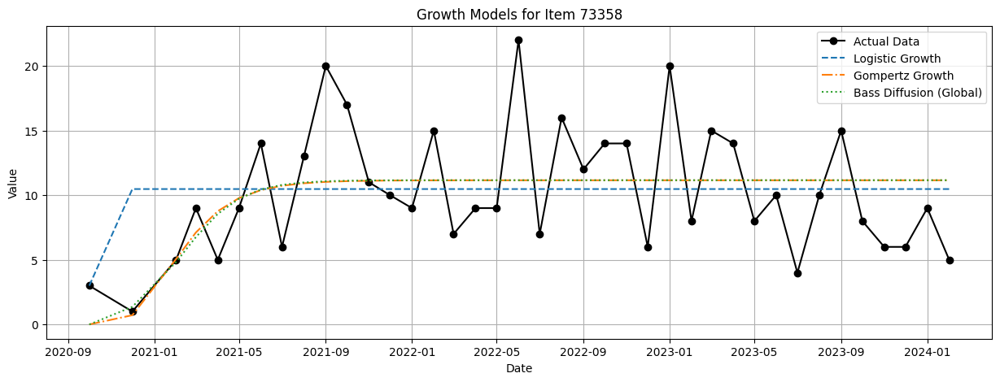

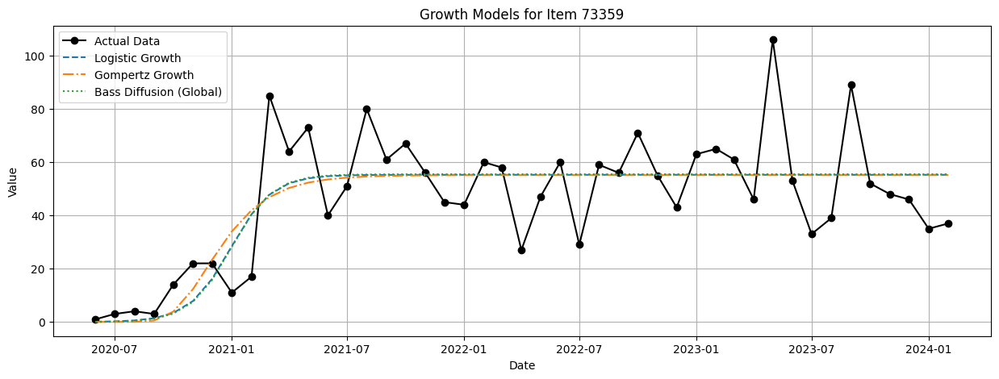

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: overflow encountered in exp
  result = getattr(ufunc, method)(*inputs, **kwargs)
/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: overflow encountered in exp
  result = getattr(ufunc, method)(*inputs, **kwargs)


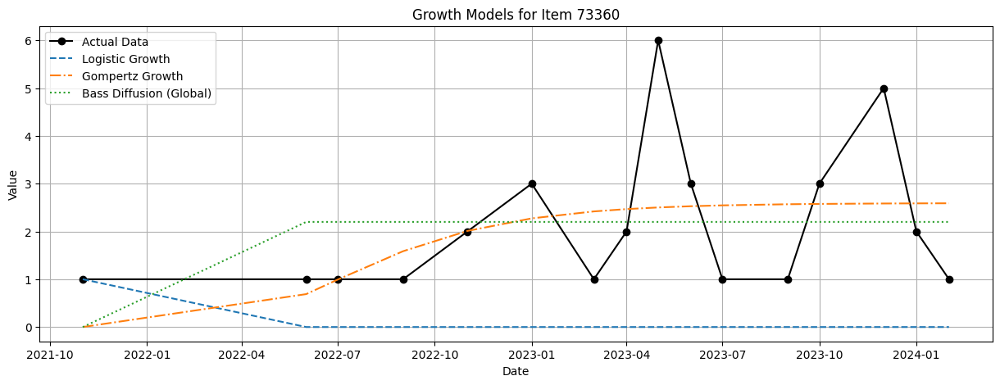

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: overflow encountered in exp
  result = getattr(ufunc, method)(*inputs, **kwargs)
/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: overflow encountered in exp
  result = getattr(ufunc, method)(*inputs, **kwargs)


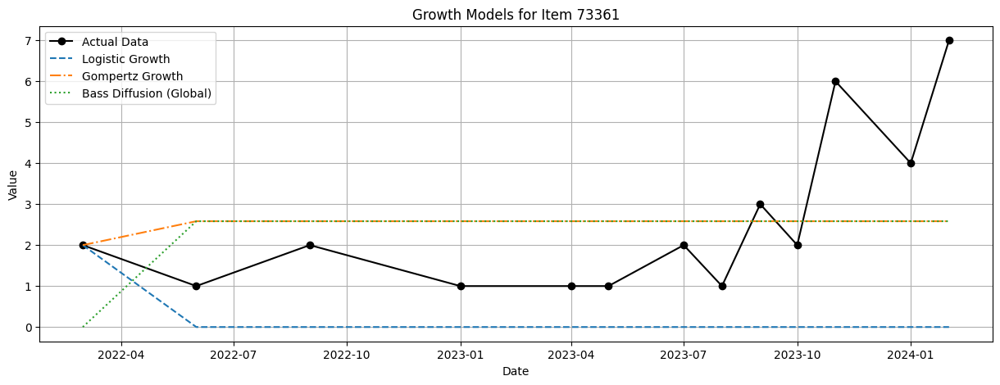

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


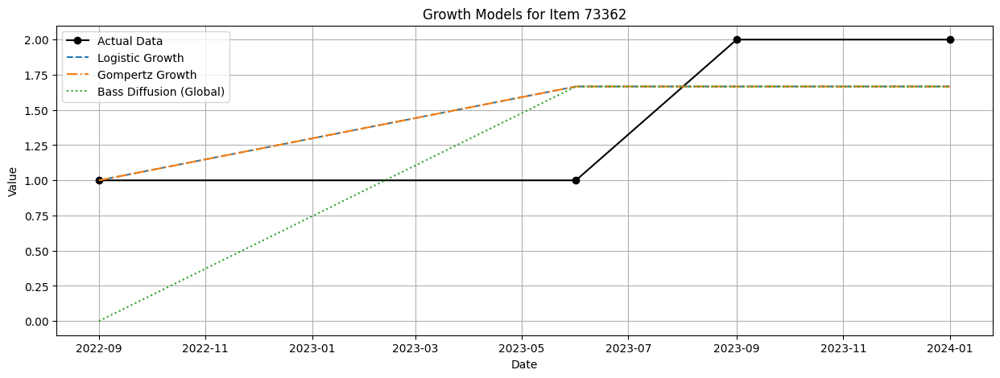

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


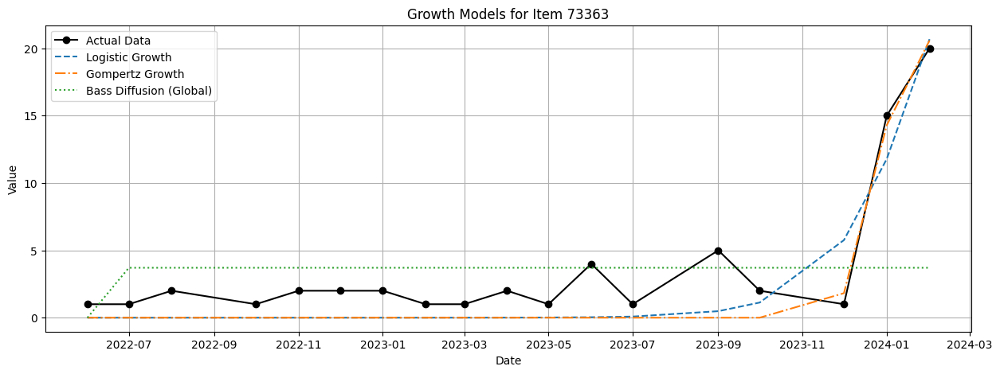

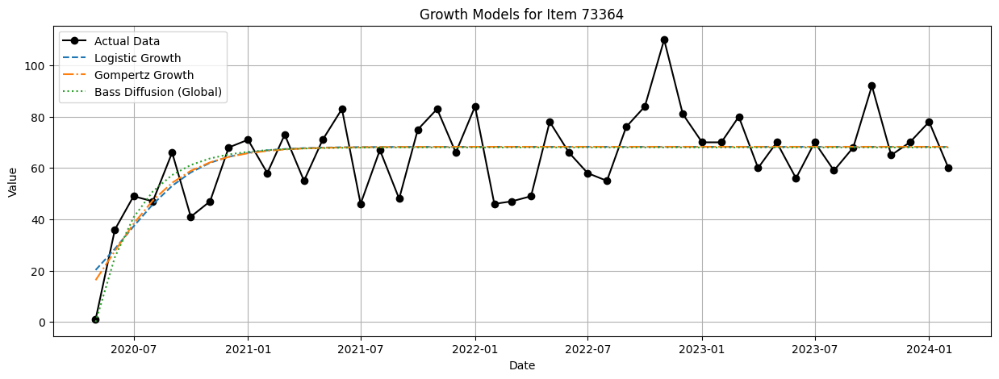

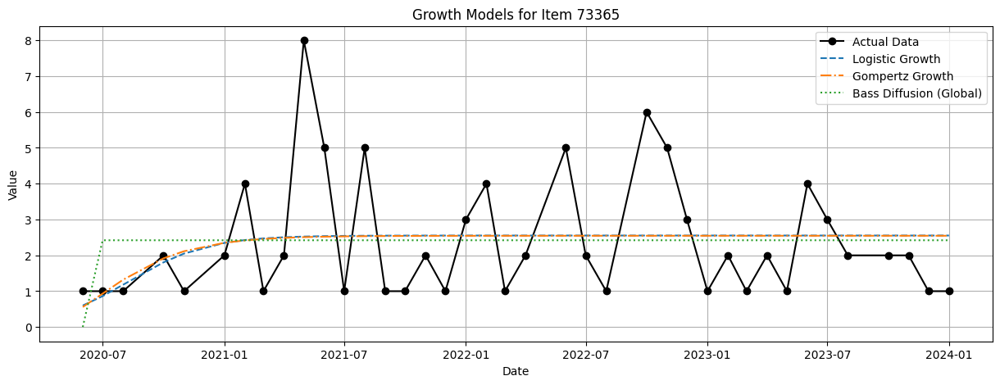

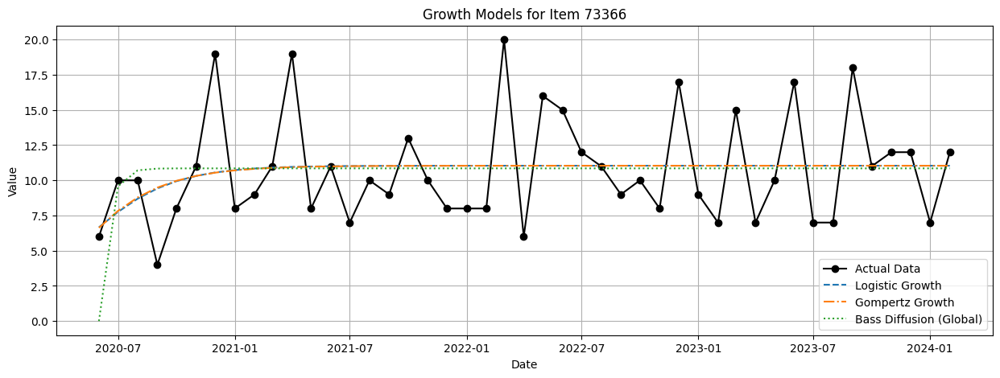

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


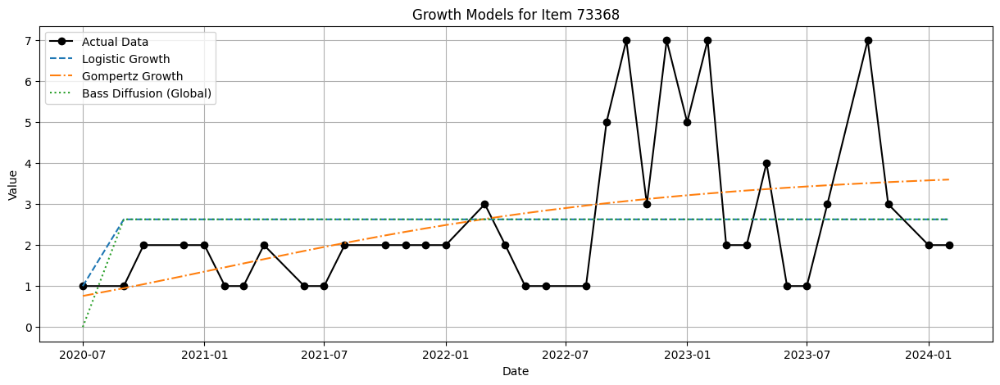

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


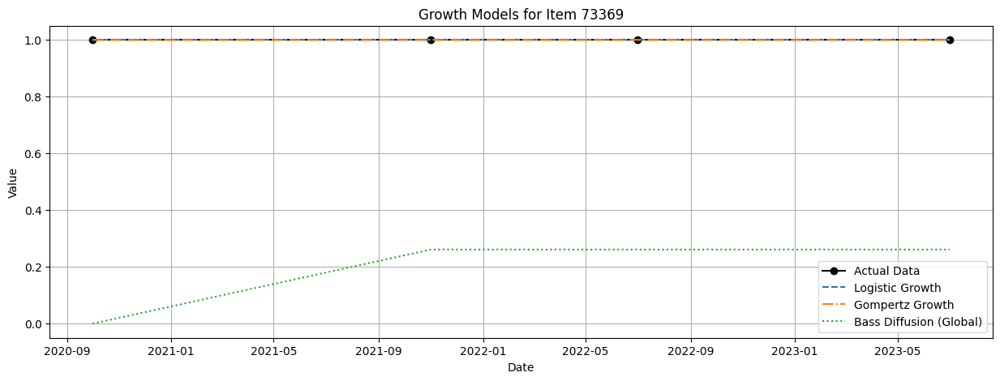

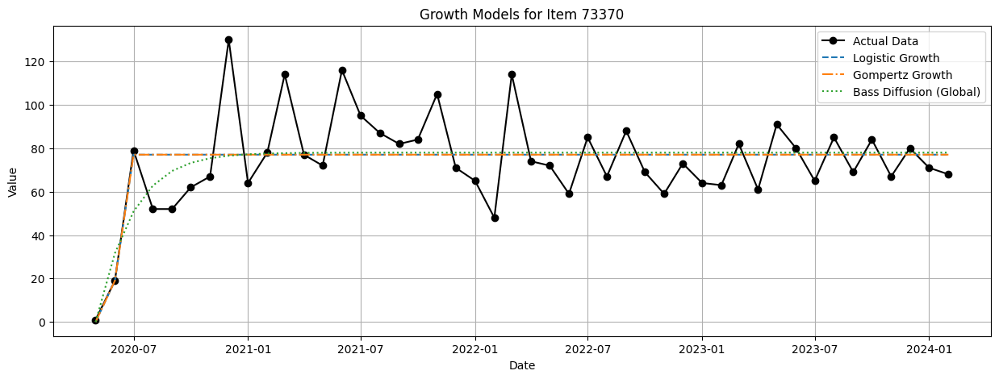

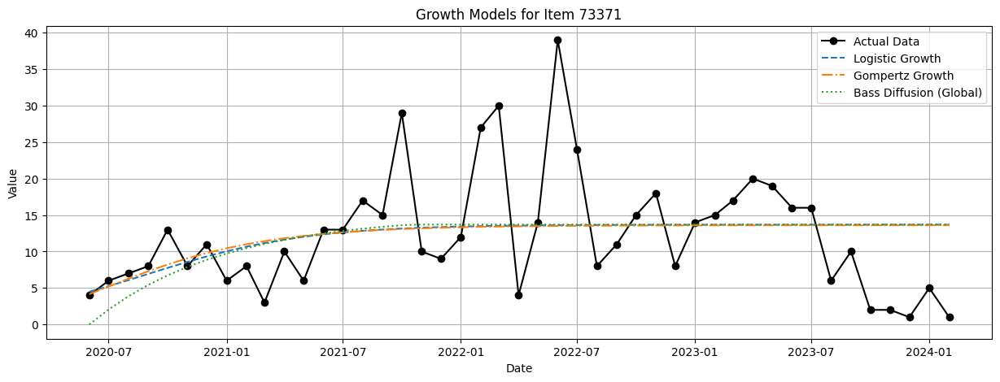

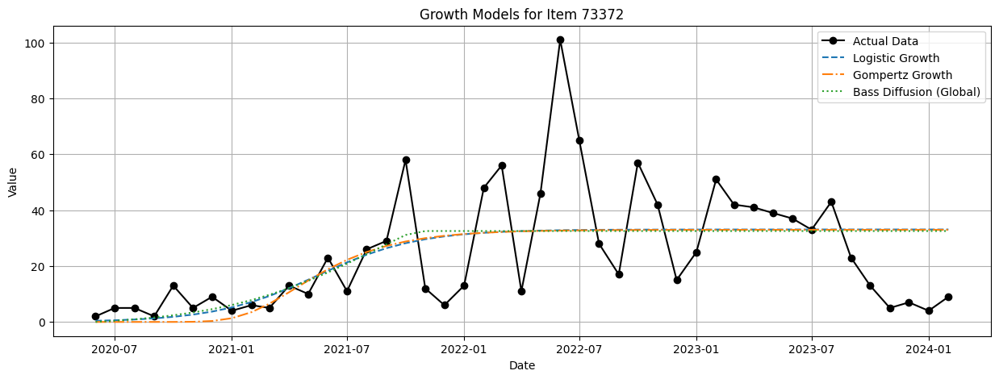

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


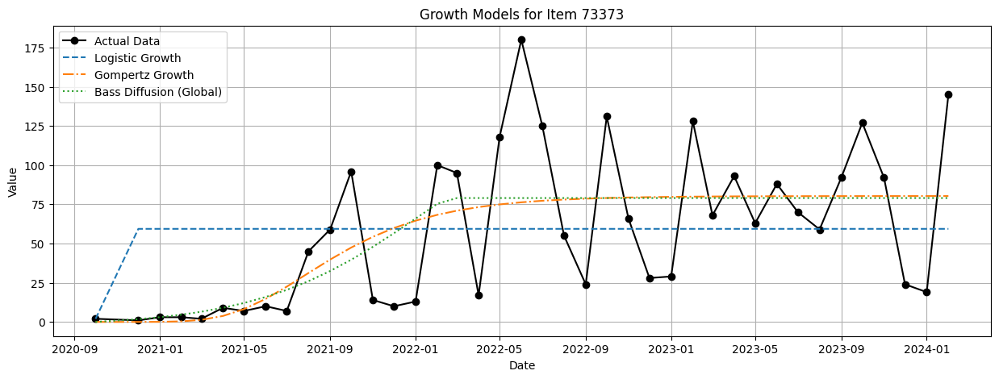

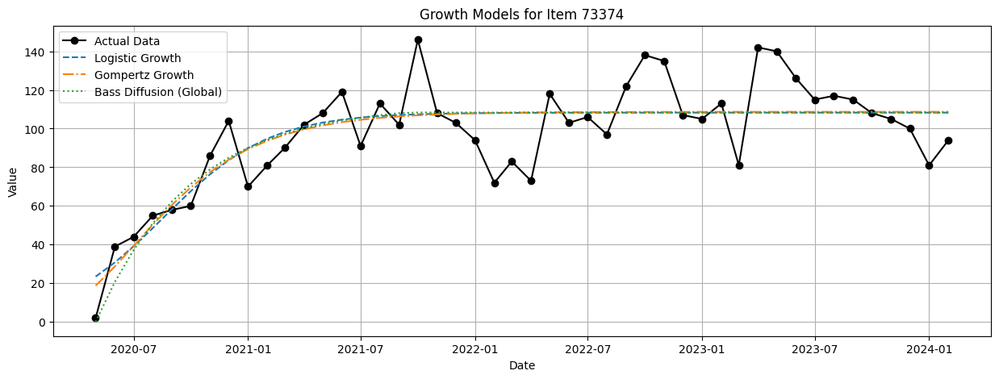

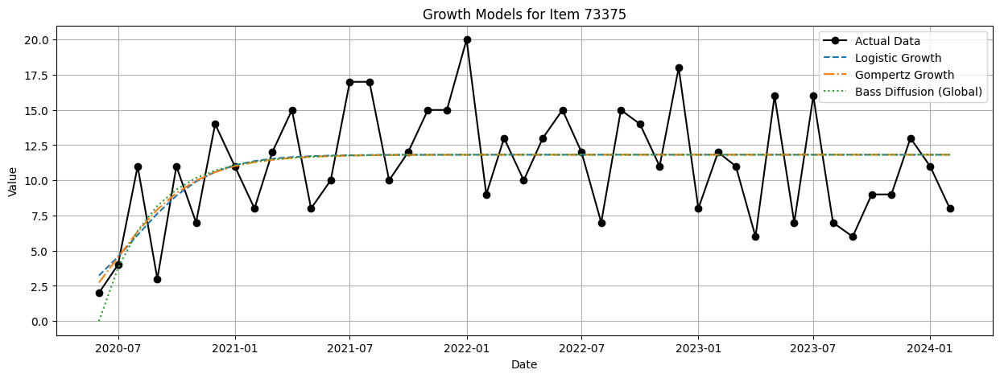

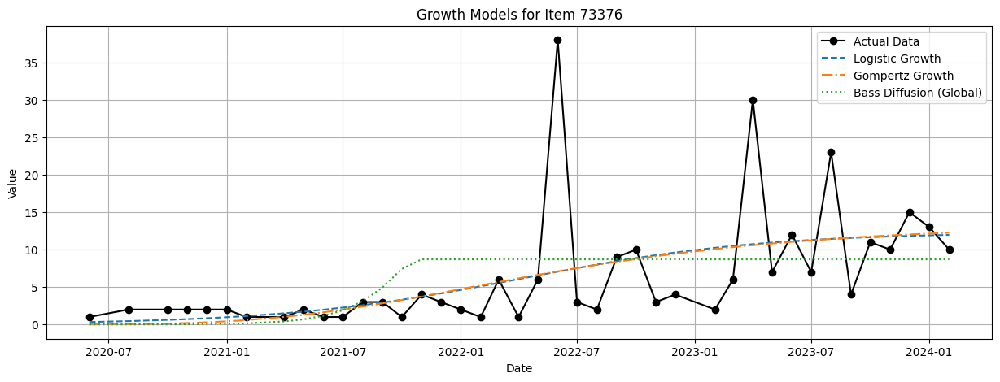

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


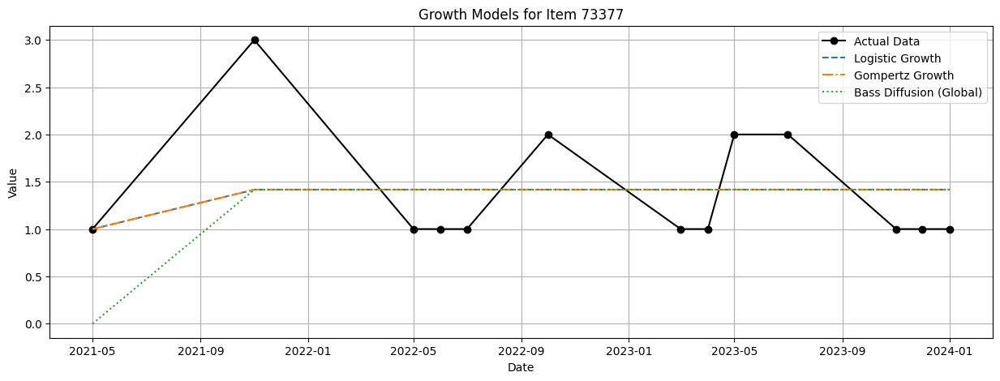

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: overflow encountered in exp
  result = getattr(ufunc, method)(*inputs, **kwargs)


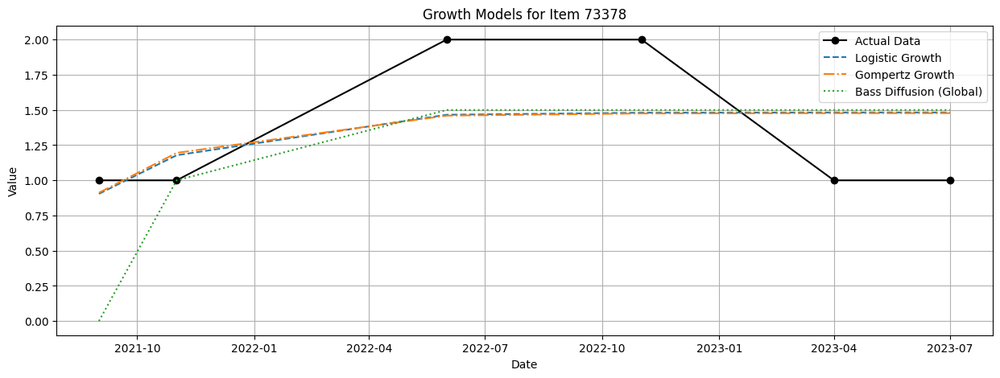

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


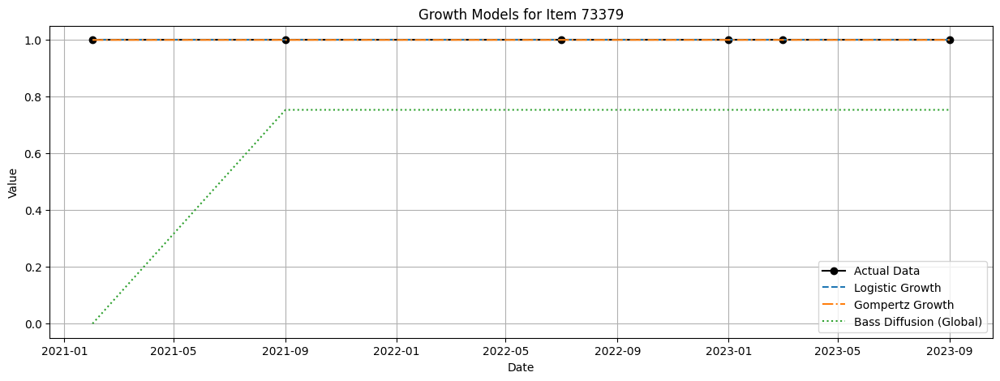

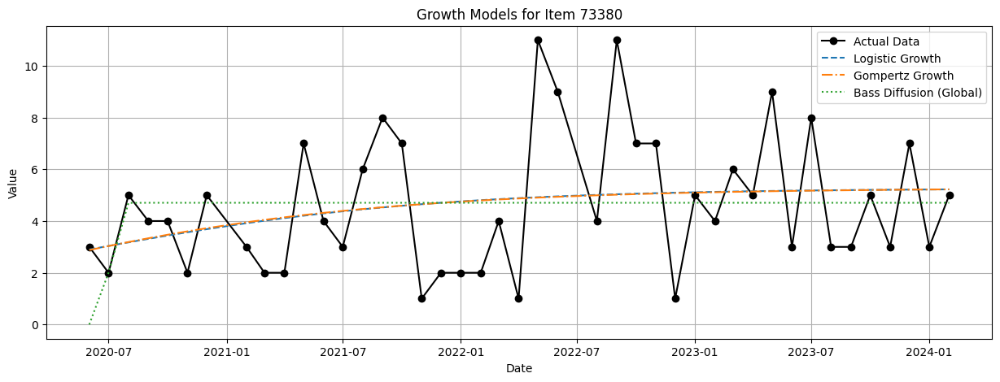

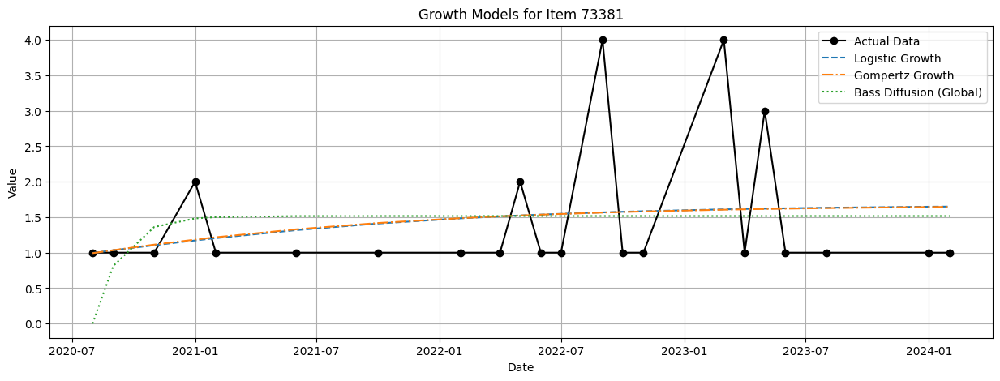

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


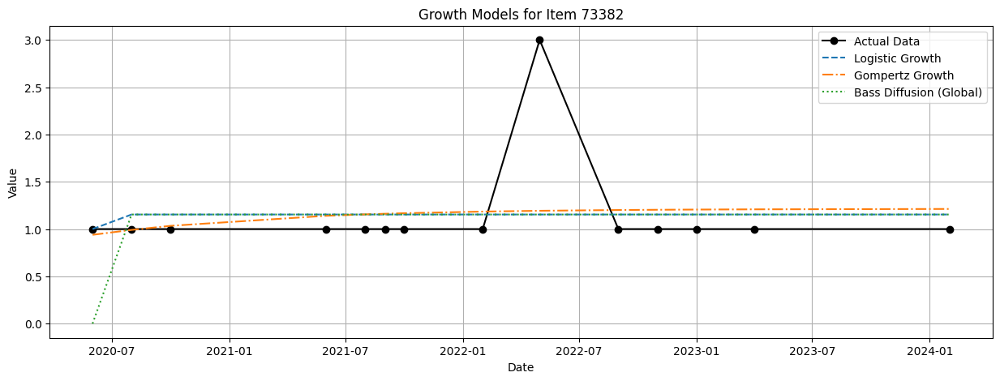

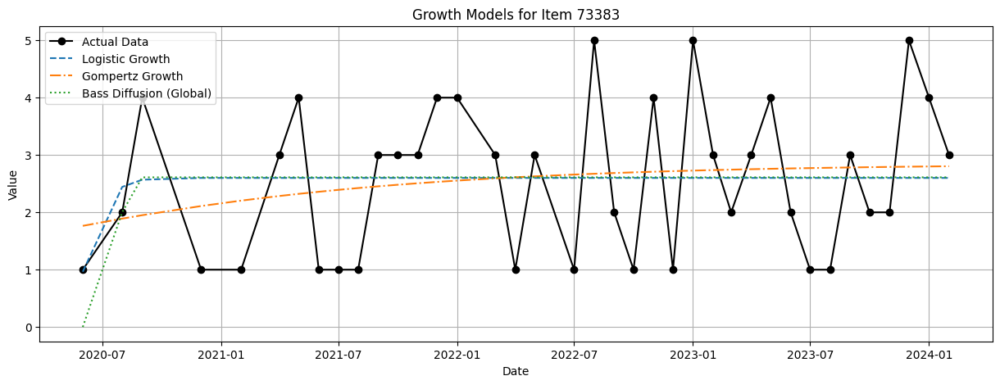

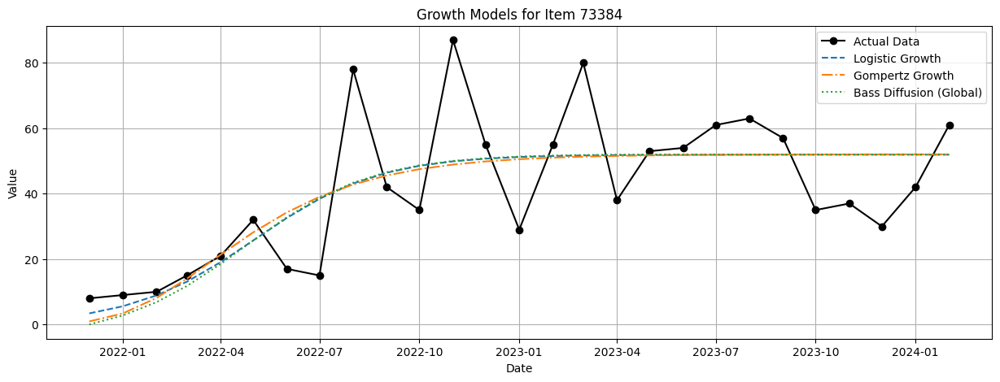

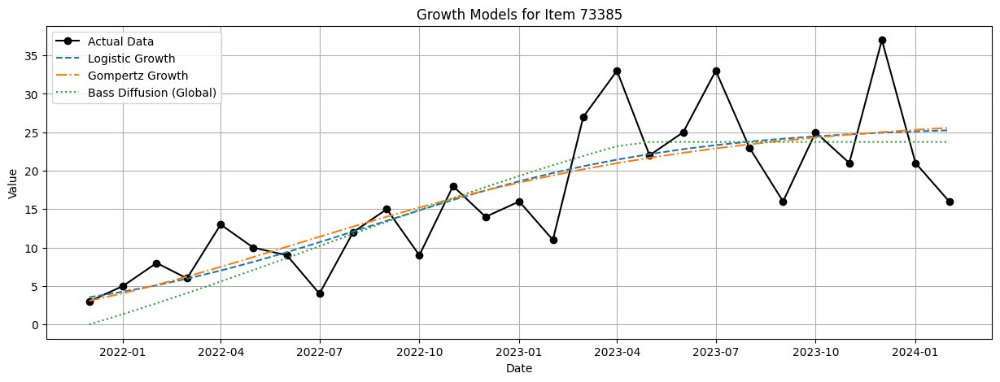

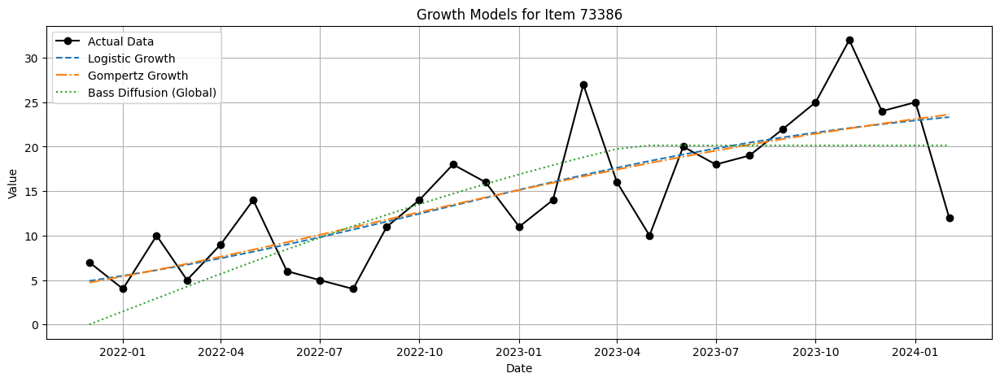

...

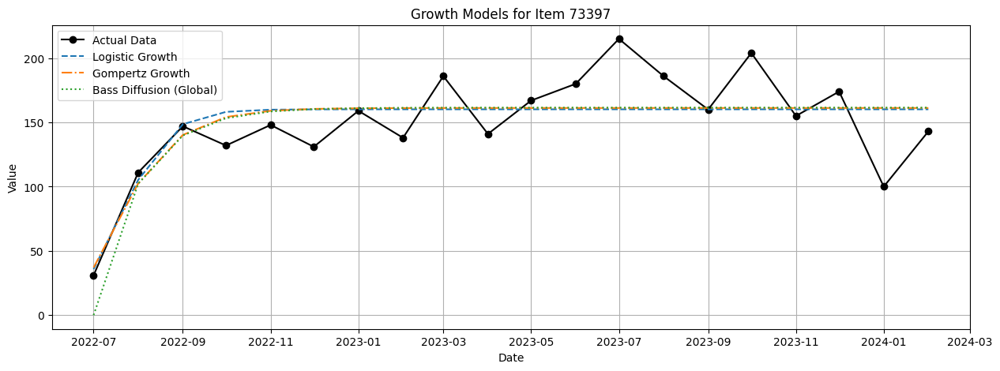

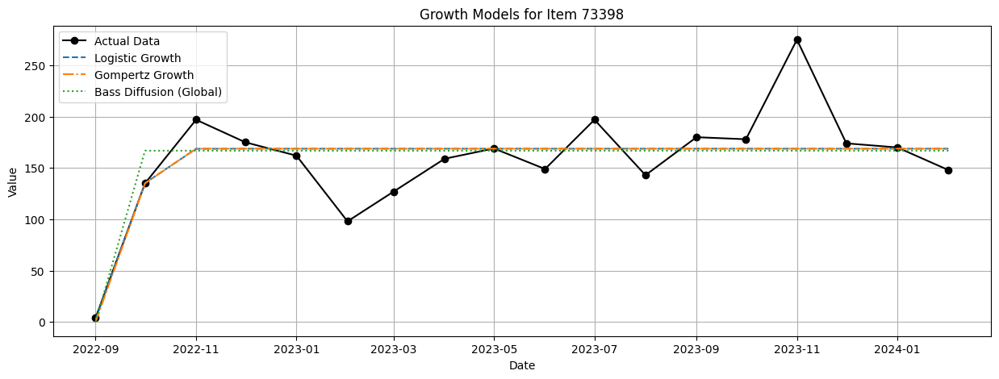

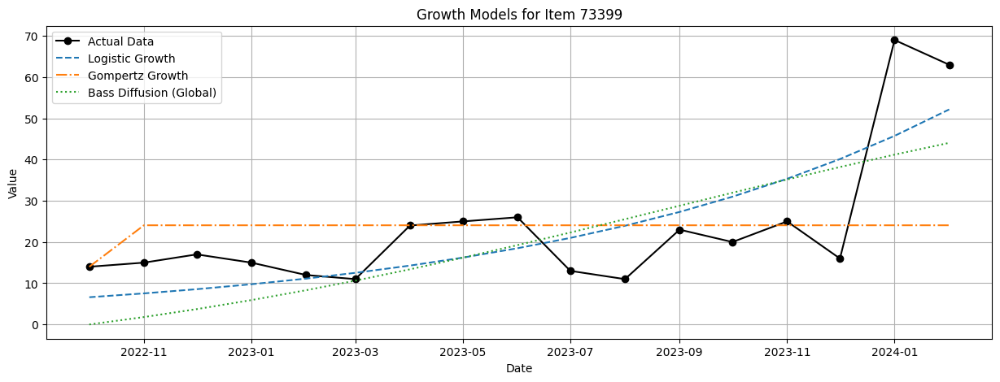

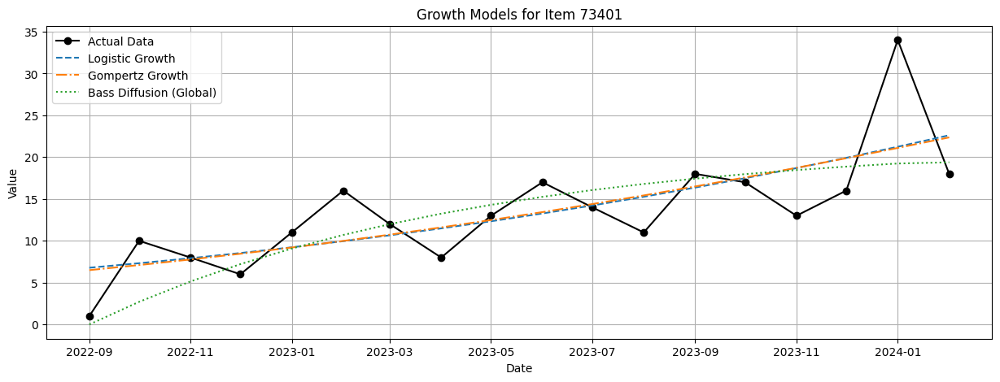

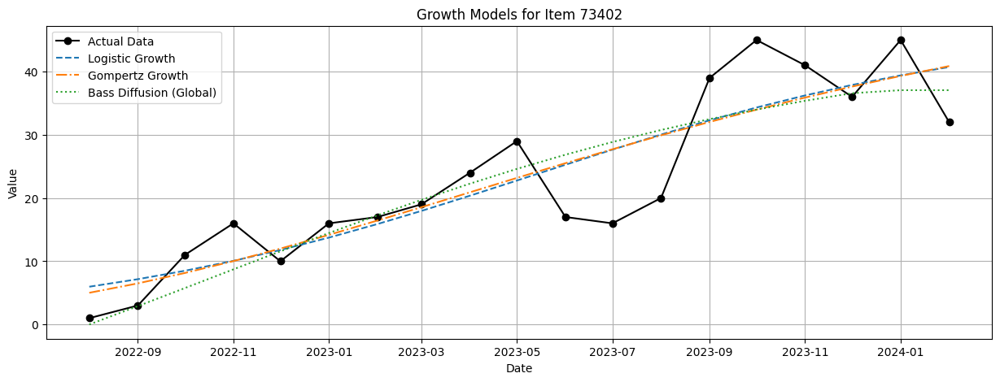

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: overflow encountered in exp
  result = getattr(ufunc, method)(*inputs, **kwargs)
/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: overflow encountered in exp
  result = getattr(ufunc, method)(*inputs, **kwargs)


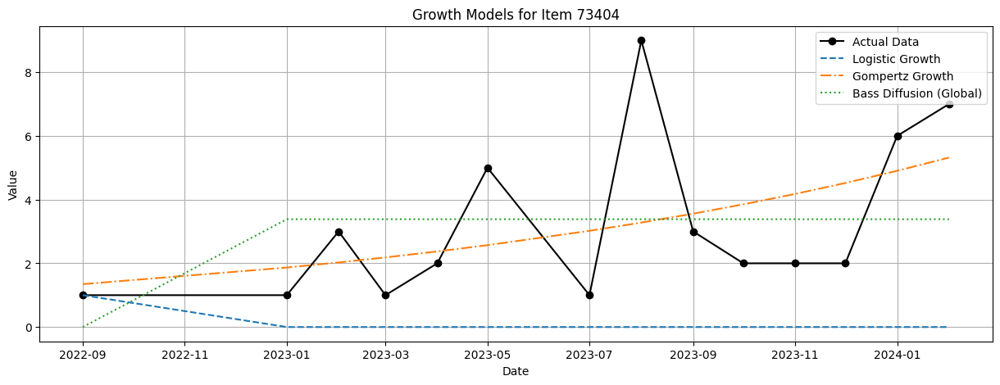

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


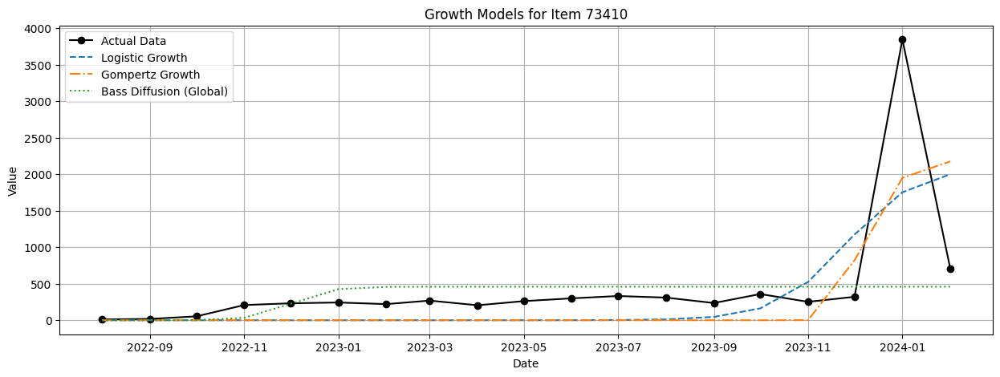

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


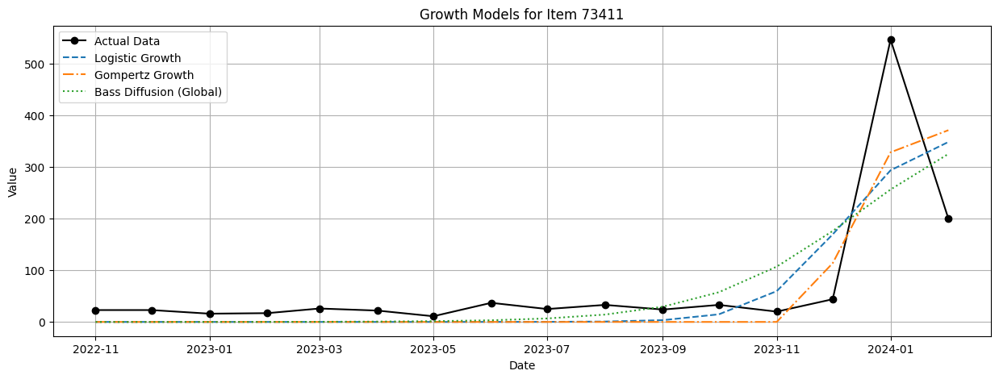

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


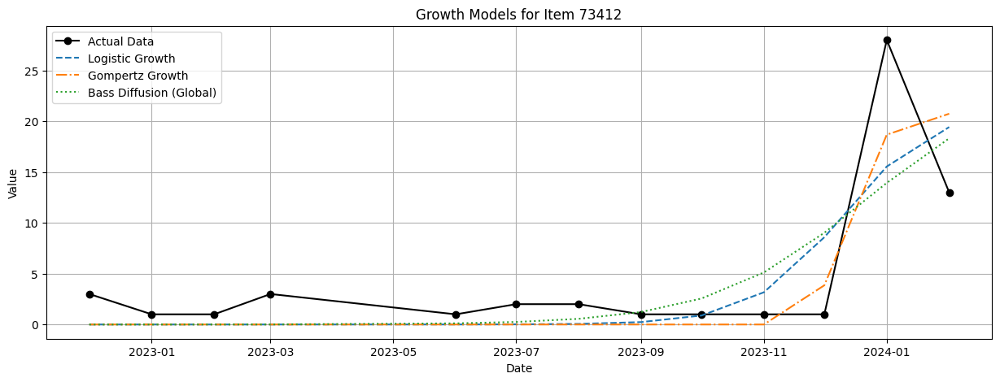

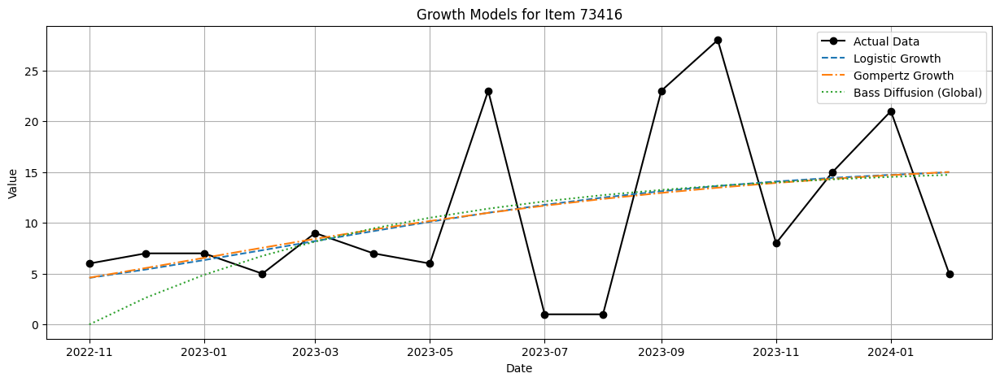

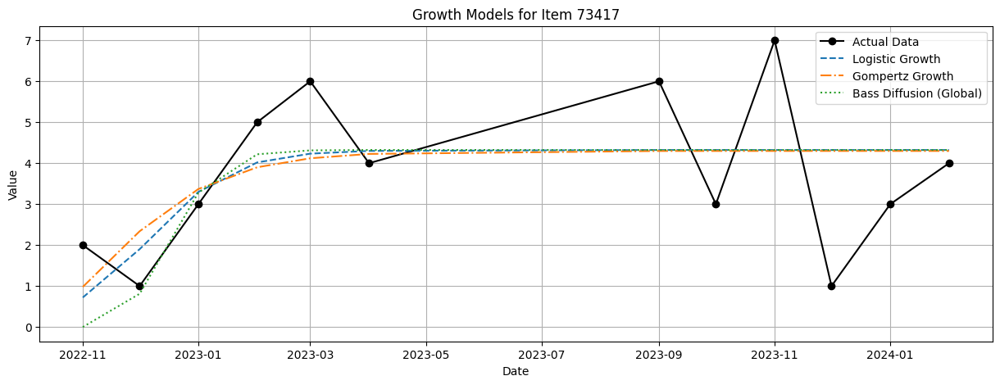

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


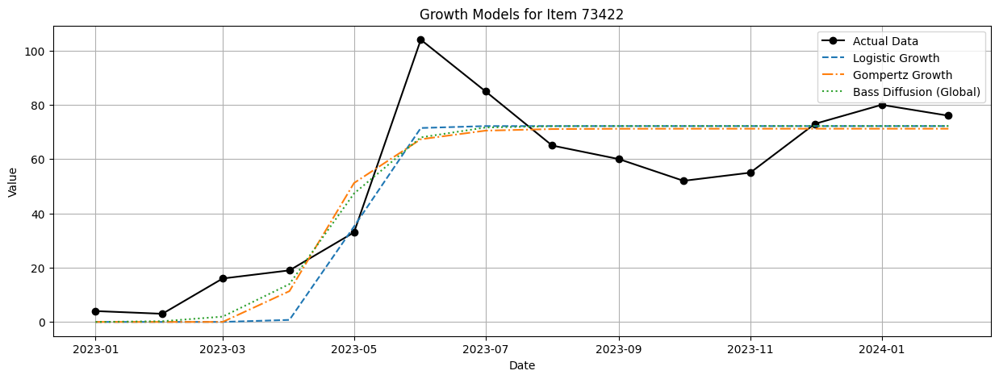

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


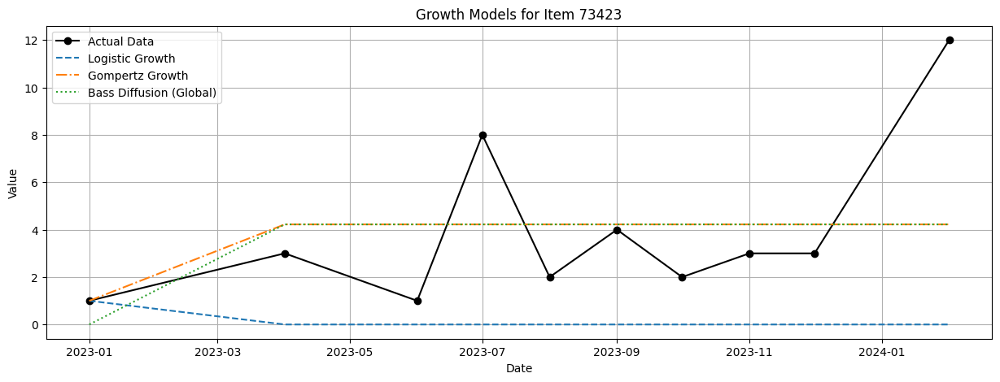

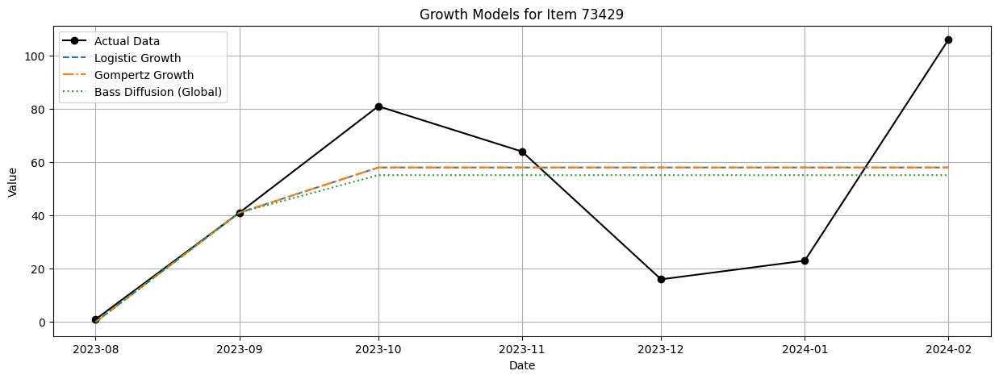

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


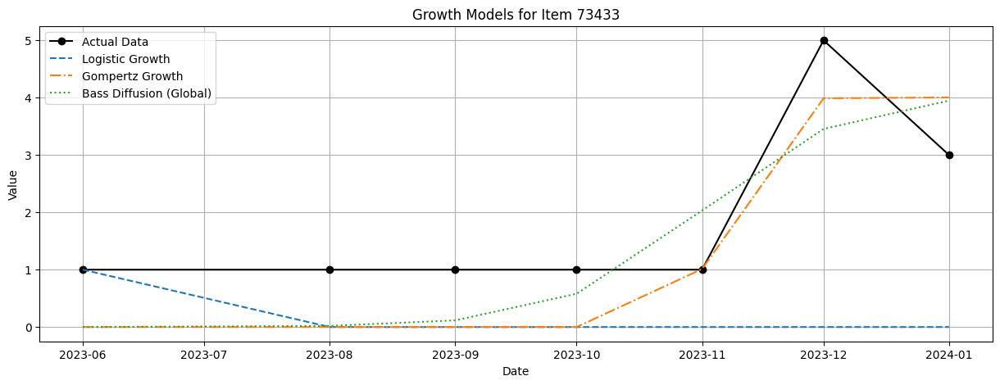

/home/doughnut/miniconda3/envs/uplift_env/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


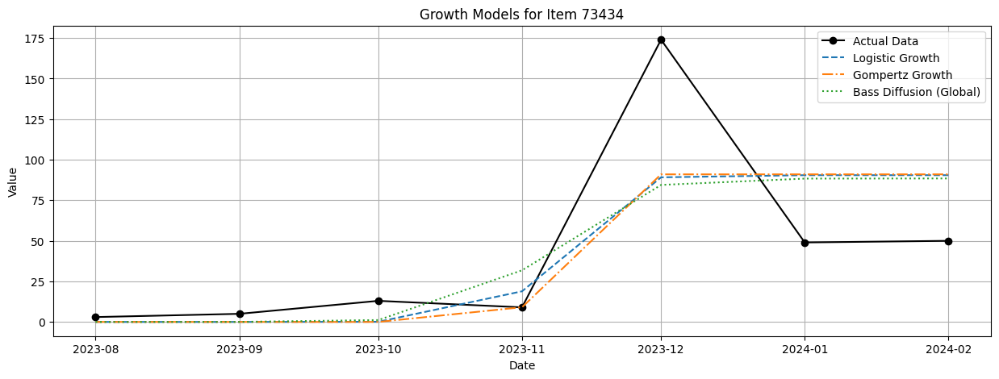

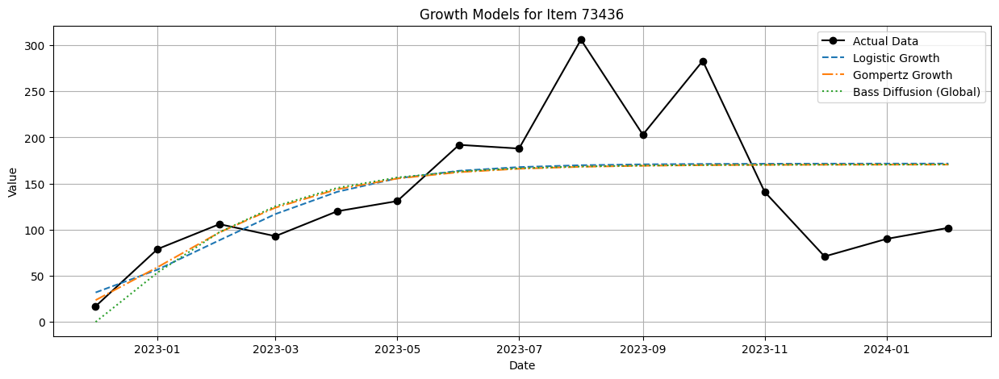

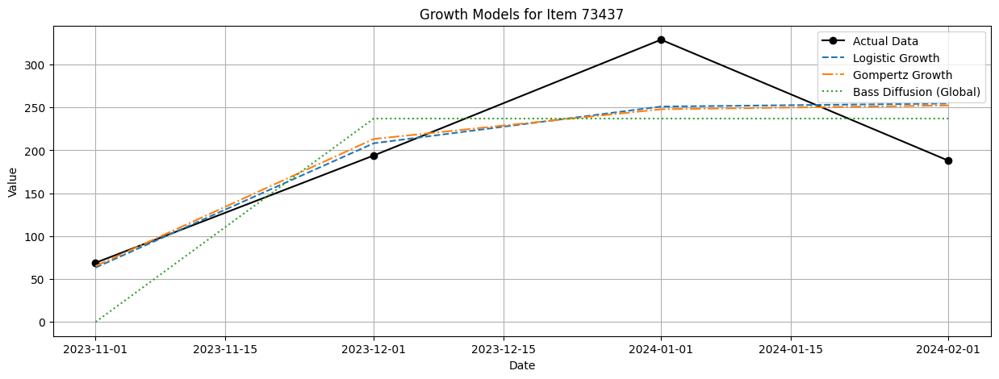

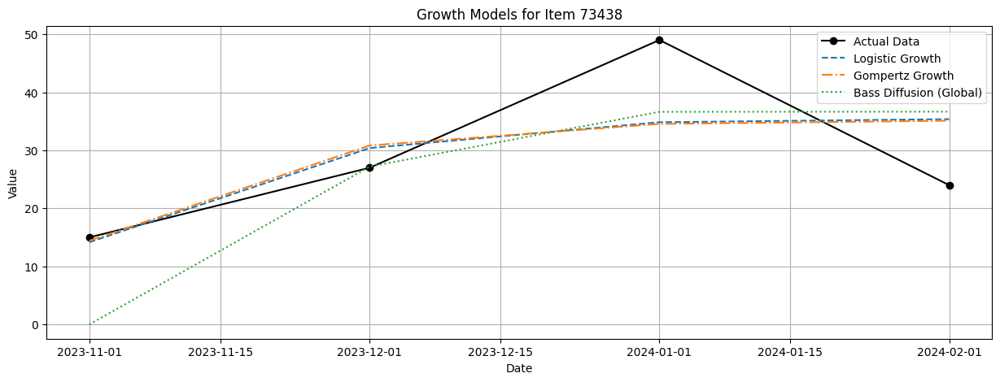

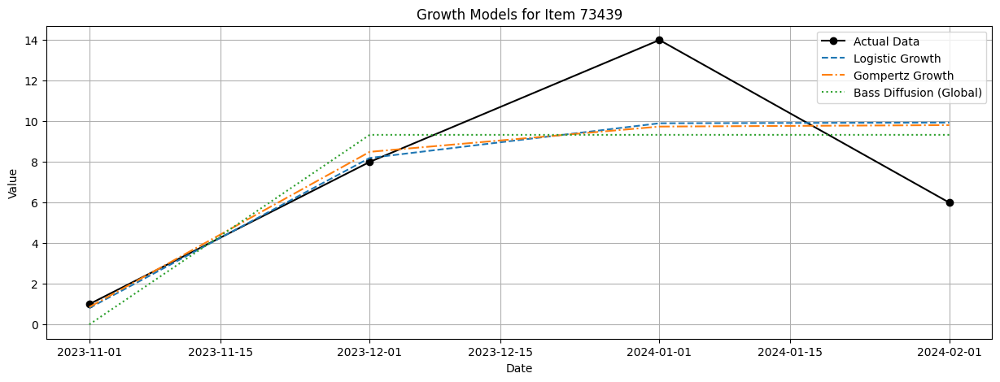

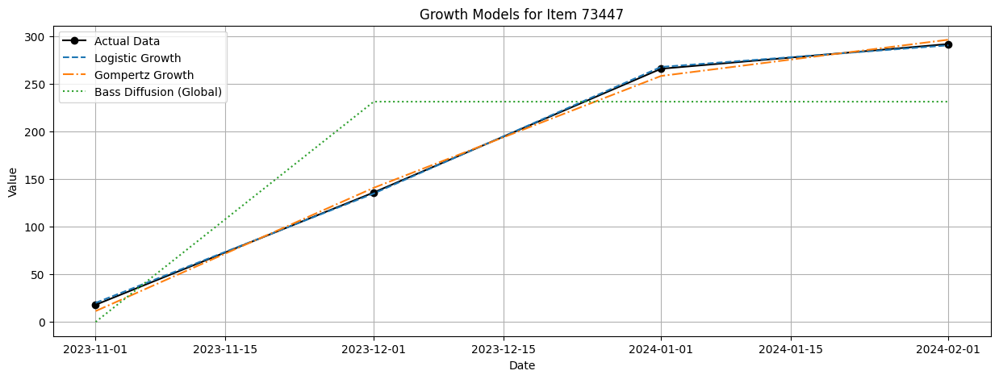

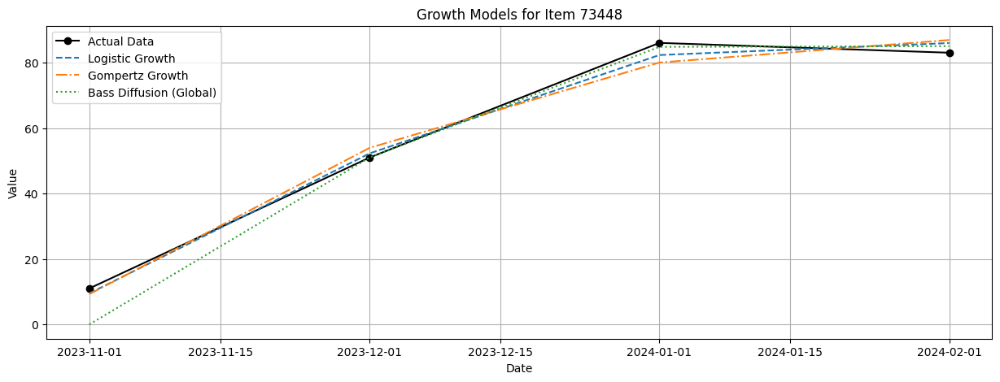

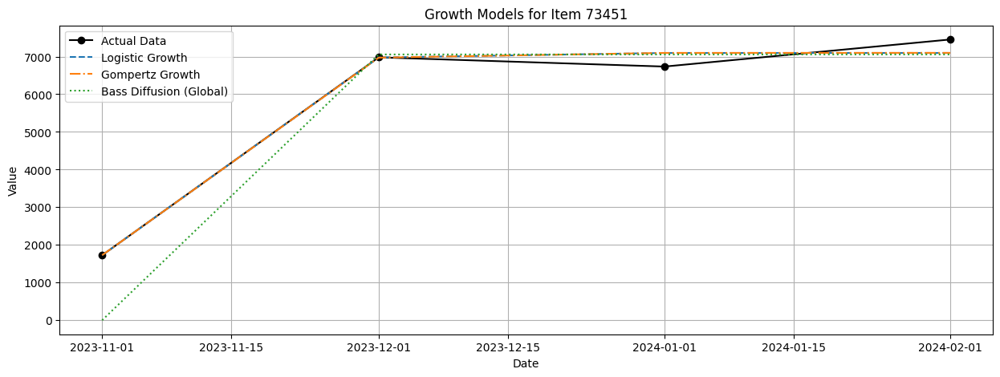

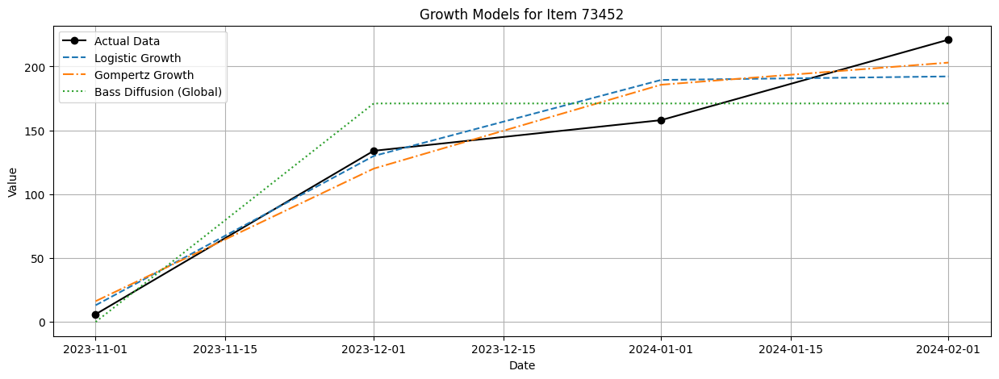

Results for Item 73287:
Logistic Growth Metrics (R², MAE, MAPE, RMSE): (0.04579073994048055, 377.7540813344855, 33.08699408863756, 440.014624031564)
Gompertz Growth Metrics (R², MAE, MAPE, RMSE): (0.04680760823453234, 377.32961603206155, 32.522304700083495, 439.780107240039)
Bass Diffusion Metrics (Global Optimization) (R², MAE, MAPE, RMSE): (0.04766448517476829, 376.73562724750224, 30.728754492222855, 439.5823915616653)


Results for Item 73289:
Logistic Growth Metrics (R², MAE, MAPE, RMSE): (0.9080839007400645, 340.21400842822584, 15.604091200670148, 510.18642056222546)
Gompertz Growth Metrics (R², MAE, MAPE, RMSE): (0.907972339317059, 340.79009382707426, 15.42680197984912, 510.495941220126)
Bass Diffusion Metrics (Global Optimization) (R², MAE, MAPE, RMSE): (0.07175218609066392, 1355.976774632262, 74.35255269222401, 1621.3062982522656)


Results for Item 73290:
Logistic Growth Metrics (R², MAE, MAPE, RMSE): (0.538438073540016, 87.70287520756234, 19.394772084516827, 112.2704501049715

In [13]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.optimize import curve_fit, differential_evolution
from sklearn.metrics import r2_score, mean_absolute_error, mean_squared_error

# Load the dataset from the Feather file using pandas
mdf = pd.read_feather("/mnt/c/Users/doughnut/OneDrive - The University of Melbourne/Phase 1 - Study 4 - Australian Genetic and Genomic Test Utilisation/Data Files/Processed_MBSGeneticsCount_20240325_175333.feather")

# Ensure that "Month" is in datetime format
mdf['Month'] = pd.to_datetime(mdf['Month'])

# Group data by 'Month' and 'Item' and calculate the sum of 'Value' with observed=False to prevent warnings
df = mdf.groupby(['Month', 'Item'], observed=False)['Value'].sum().reset_index()

# Make all values positive
df['Value'] = df['Value'].abs()

# Rename the "Month" and "Value" columns
df = df.rename(columns={"Month": "ds", "Value": "y"})

# Convert the "ds" column to ordinal to use in growth models
df['ds_ordinal'] = df['ds'].apply(lambda x: x.toordinal())

# Define the logistic, Gompertz, and Bass diffusion models
def logistic_growth(t, K, P0, r):
    P0 = max(P0, 1e-6)  # Add a small constant to avoid division by zero
    return K / (1 + ((K - P0) / P0) * np.exp(-r * t))

def gompertz_growth(t, a, b, c):
    return a * np.exp(-b * np.exp(-c * t))

def bass_diffusion(t, p, q, m):
    # Ensure p and q are not too small to avoid invalid division
    p = max(p, 1e-6)
    q = max(q, 1e-6)
    
    # Prevent overflow by limiting the input to exp()
    t = np.clip(t, -500, 500)
    
    # Compute the Bass diffusion model
    diffusion_value = m * (1 - np.exp(-(p + q) * t)) / (1 + (q / p) * np.exp(-(p + q) * t))
    
    # Clip any NaN or infinite values that result from invalid inputs
    diffusion_value = np.nan_to_num(diffusion_value, nan=0.0, posinf=0.0, neginf=0.0)
    
    return diffusion_value

# Optimized initial guess function for Gompertz model
def optimize_initial_guesses(func, t_data, y_data, param_ranges, num_trials=100):
    best_params = None
    best_r2 = -np.inf
    
    for _ in range(num_trials):
        initial_guesses = [np.random.uniform(low, high) for low, high in param_ranges]
        
        try:
            params, _ = curve_fit(func, t_data, y_data, p0=initial_guesses, bounds=([0, 0, 0], [np.inf, np.inf, np.inf]), maxfev=5000)
            y_pred = func(t_data, *params)
            r2 = r2_score(y_data, y_pred)
            if r2 > best_r2:
                best_r2 = r2
                best_params = params
        except RuntimeError:
            continue
    
    return best_params, best_r2

# Define ranges for the Gompertz parameters (a, b, c)
gompertz_param_ranges = [(0.8 * max(df['y']), 1.2 * max(df['y'])), (0.001, 2), (0.001, 2)]

# Global optimization for Bass diffusion using differential evolution
def global_optim_bass_diffusion(t_data, y_data):
    # Objective function to minimize: -R² (to maximize R²)
    def objective(params):
        p, q, m = params
        y_pred = bass_diffusion(t_data, p, q, m)
        # Check for invalid values before calculating R²
        if np.any(np.isnan(y_pred)) or np.any(np.isinf(y_pred)):
            return 1e6  # Return a large penalty if invalid values are found
        r2 = r2_score(y_data, y_pred)
        return -r2  # We minimize, so we negate R²
    
    # Set bounds for p, q, m
    bounds = [(1e-6, 1), (1e-6, 1), (0, max(y_data))]
    
    # Perform global optimization using differential evolution
    result = differential_evolution(objective, bounds)
    return result.x

# Loop over each unique Item and apply the models
items = df['Item'].unique()
results = []

for item in items:
    # Filter data for the current Item and start from the first non-zero value
    df_item = df[(df['Item'] == item) & (df['y'] > 0)].copy()

    # Skip if no data is available after filtering
    if df_item.empty or len(df_item) < 4:  # Check for minimum number of data points
        continue

    # Prepare t_data starting from the first non-zero value
    t_data = df_item['ds_ordinal'] - df_item['ds_ordinal'].min()
    y_data = df_item['y']

    # Fit the logistic model if there are enough data points
    try:
        logistic_params, _ = curve_fit(logistic_growth, t_data, y_data, p0=[max(y_data), min(y_data), 0.1], maxfev=5000)
    except (TypeError, RuntimeError) as e:
        print(f"Skipping logistic model for item {item} due to error: {e}")
        continue

    # Fit the Gompertz model with optimized initial guesses
    try:
        gompertz_params, gompertz_r2 = optimize_initial_guesses(gompertz_growth, t_data, y_data, gompertz_param_ranges)
    except (TypeError, RuntimeError) as e:
        print(f"Skipping Gompertz model for item {item} due to error: {e}")
        continue

    # Fit the Bass diffusion model using global optimization (differential evolution)
    bass_params_global = global_optim_bass_diffusion(t_data, y_data)

    # Generate predictions
    df_item['logistic_pred'] = logistic_growth(t_data, *logistic_params)
    df_item['gompertz_pred'] = gompertz_growth(t_data, *gompertz_params)
    df_item['bass_pred_global'] = bass_diffusion(t_data, *bass_params_global)

    # Ensure predictions contain no invalid values
    df_item.replace([np.inf, -np.inf, np.nan], 0, inplace=True)

    # Define evaluation metrics
    def calculate_metrics(y_true, y_pred):
        r2 = r2_score(y_true, y_pred)
        mae = mean_absolute_error(y_true, y_pred)
        mape = np.mean(np.abs((y_true - y_pred) / y_true)) * 100
        rmse = np.sqrt(mean_squared_error(y_true, y_pred))
        return r2, mae, mape, rmse

    # Calculate metrics for each model
    logistic_metrics = calculate_metrics(df_item['y'], df_item['logistic_pred'])
    gompertz_metrics = calculate_metrics(df_item['y'], df_item['gompertz_pred'])
    bass_metrics_global = calculate_metrics(df_item['y'], df_item['bass_pred_global'])

    results.append({
        "Item": item,
        "Logistic_Metrics": logistic_metrics,
        "Gompertz_Metrics": gompertz_metrics,
        "Bass_Metrics_Global": bass_metrics_global
    })

    # Plot the results for this item
    plt.figure(figsize=(15, 5))
    plt.plot(df_item['ds'], df_item['y'], label='Actual Data', color='black', marker='o')
    plt.plot(df_item['ds'], df_item['logistic_pred'], label='Logistic Growth', linestyle='--')
    plt.plot(df_item['ds'], df_item['gompertz_pred'], label='Gompertz Growth', linestyle='-.')
    plt.plot(df_item['ds'], df_item['bass_pred_global'], label='Bass Diffusion (Global)', linestyle=':')
    plt.xlabel('Date')
    plt.ylabel('Value')
    plt.title(f'Growth Models for Item {item}')
    plt.legend()
    plt.grid(True)
    plt.show()

# Display final results
for result in results:
    print(f"Results for Item {result['Item']}:")
    print("Logistic Growth Metrics (R², MAE, MAPE, RMSE):", result['Logistic_Metrics'])
    print("Gompertz Growth Metrics (R², MAE, MAPE, RMSE):", result['Gompertz_Metrics'])
    print("Bass Diffusion Metrics (Global Optimization) (R², MAE, MAPE, RMSE):", result['Bass_Metrics_Global'])
    print("\n")


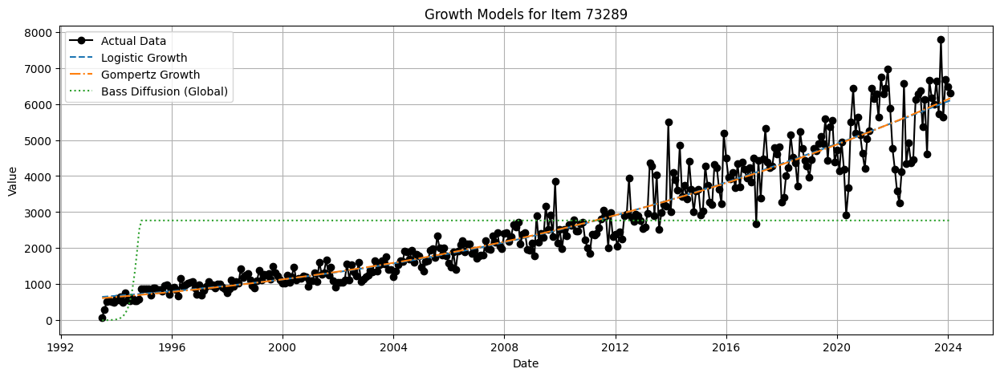

/tmp/ipykernel_204610/4240927435.py:119: OptimizeWarning: Covariance of the parameters could not be estimated
  logistic_params, _ = curve_fit(logistic_growth, t_data, y_data, p0=[max(y_data), min(y_data), 0.1], maxfev=5000)


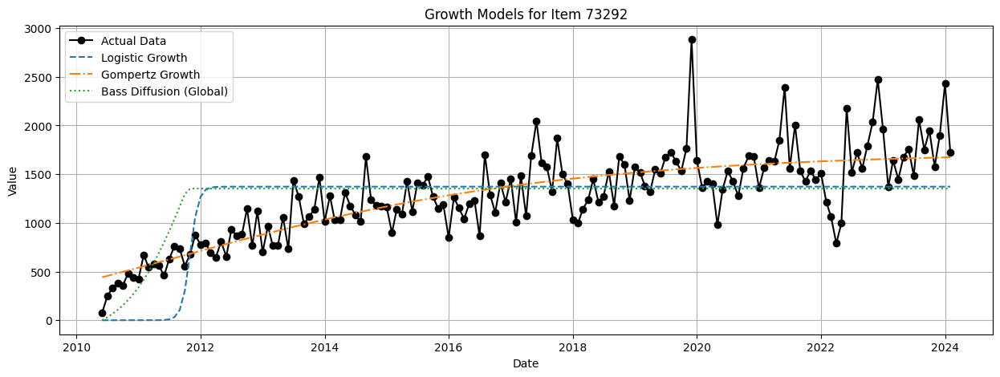

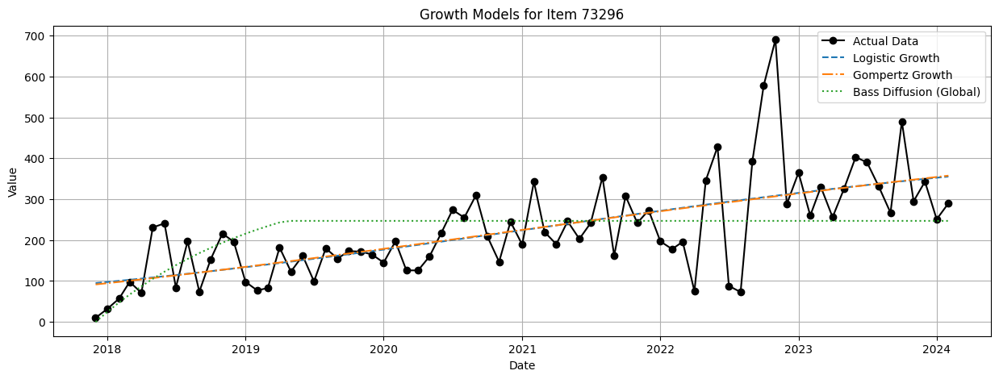

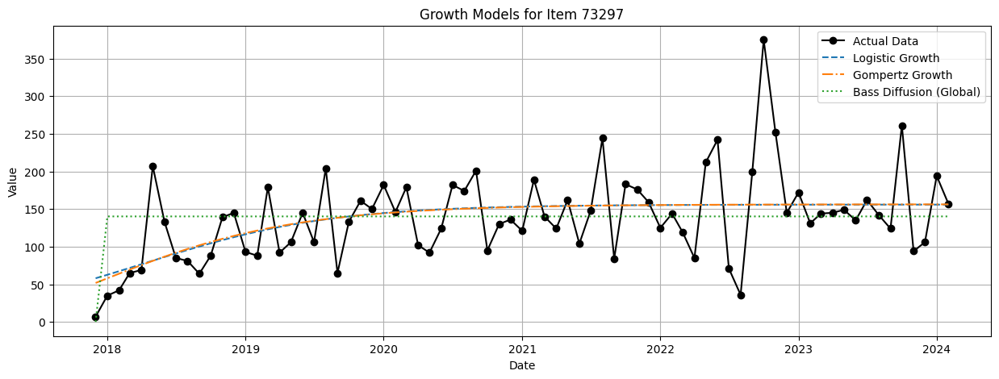

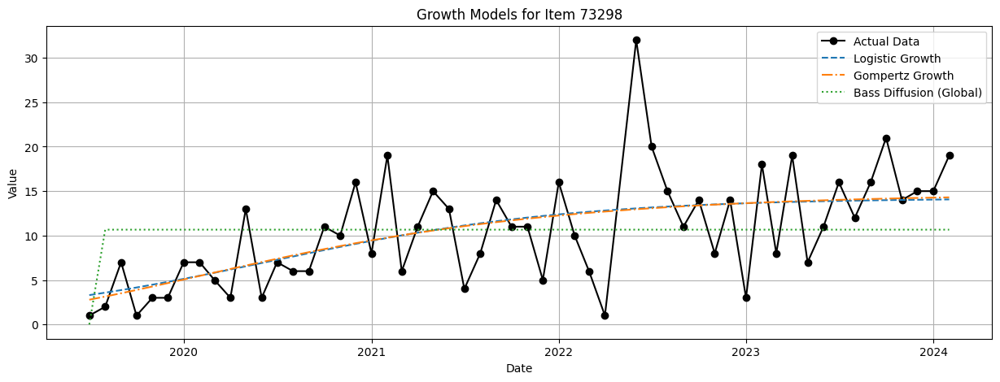

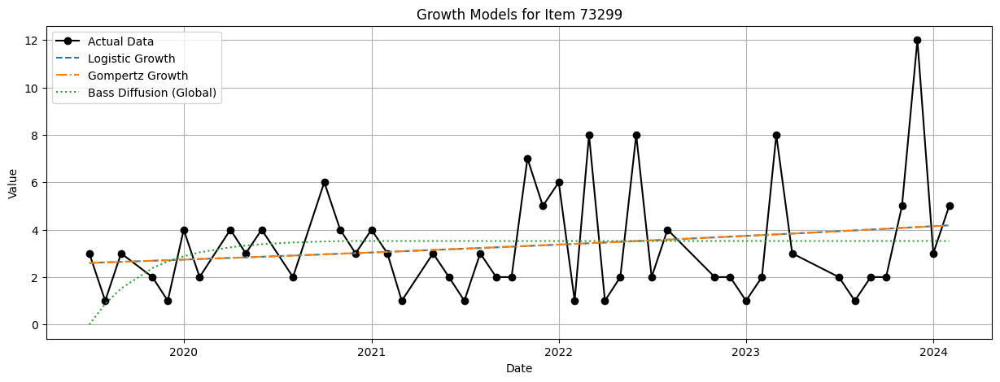

/tmp/ipykernel_204610/4240927435.py:119: OptimizeWarning: Covariance of the parameters could not be estimated
  logistic_params, _ = curve_fit(logistic_growth, t_data, y_data, p0=[max(y_data), min(y_data), 0.1], maxfev=5000)


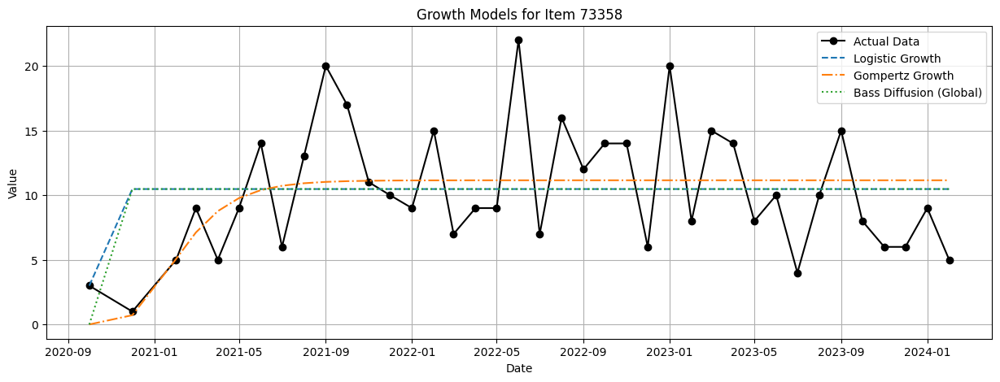

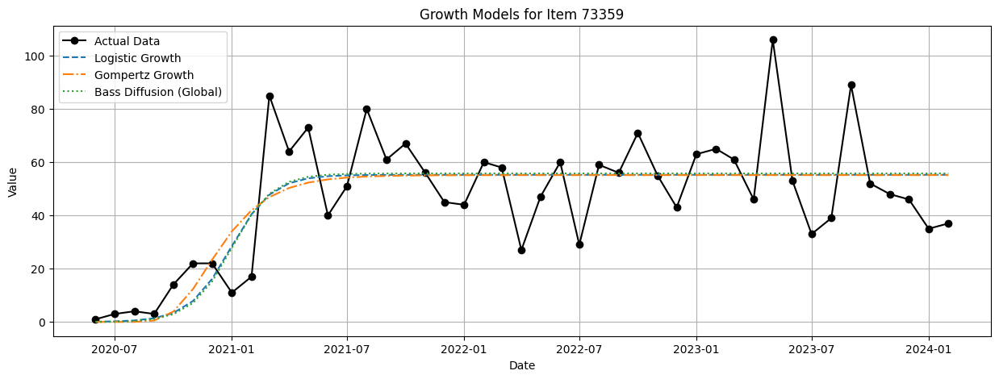

/home/doughnut/miniconda3/lib/python3.12/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: overflow encountered in exp
  result = getattr(ufunc, method)(*inputs, **kwargs)
/tmp/ipykernel_204610/4240927435.py:119: OptimizeWarning: Covariance of the parameters could not be estimated
  logistic_params, _ = curve_fit(logistic_growth, t_data, y_data, p0=[max(y_data), min(y_data), 0.1], maxfev=5000)
/home/doughnut/miniconda3/lib/python3.12/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: overflow encountered in exp
  result = getattr(ufunc, method)(*inputs, **kwargs)


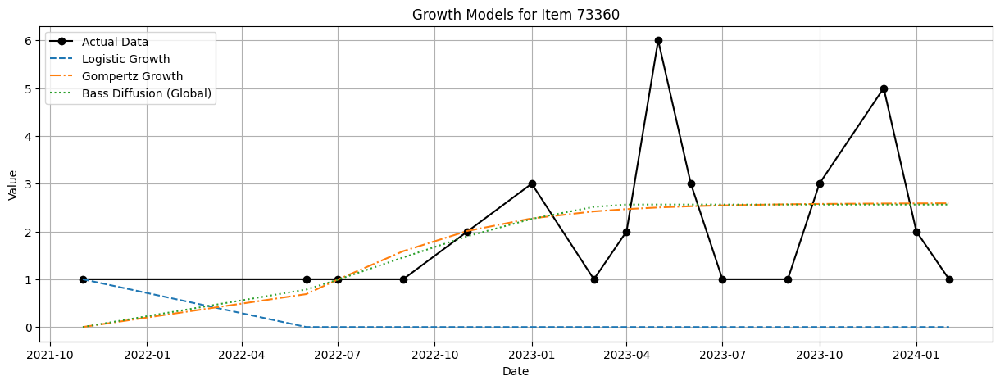

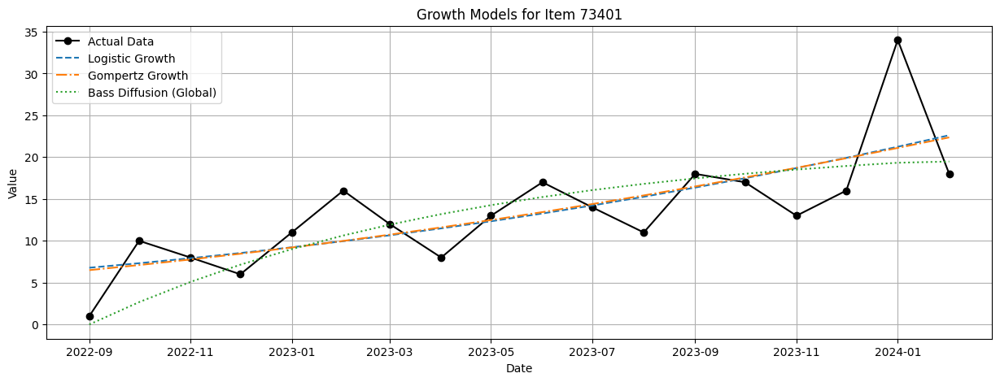

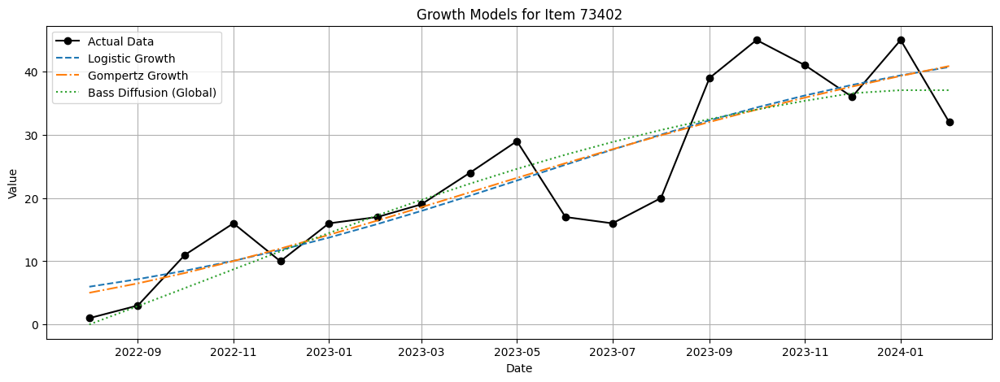

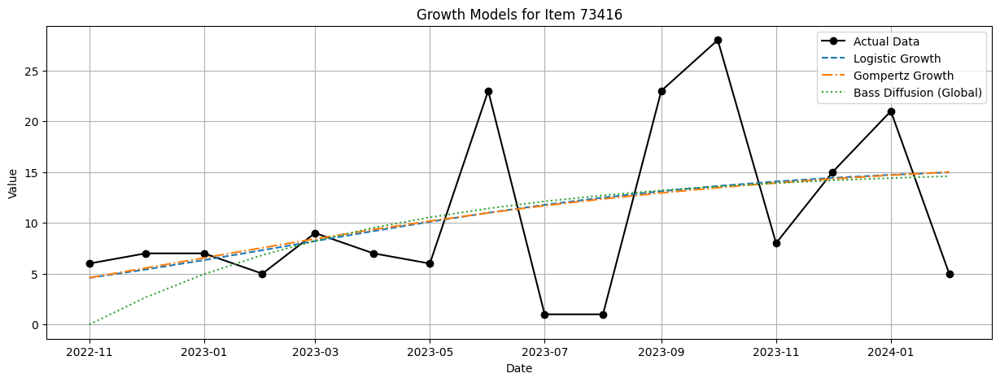

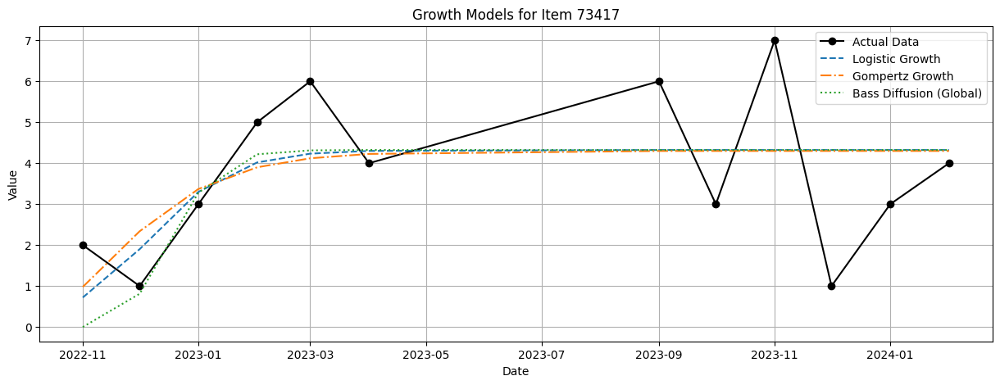

/tmp/ipykernel_204610/4240927435.py:119: OptimizeWarning: Covariance of the parameters could not be estimated
  logistic_params, _ = curve_fit(logistic_growth, t_data, y_data, p0=[max(y_data), min(y_data), 0.1], maxfev=5000)


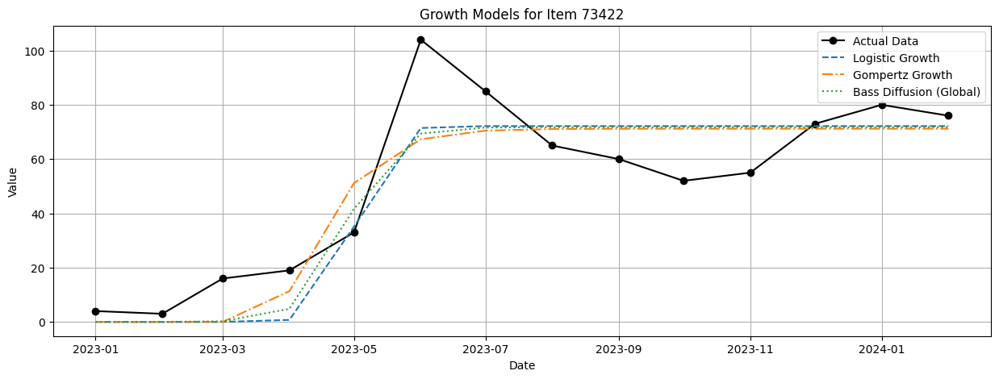

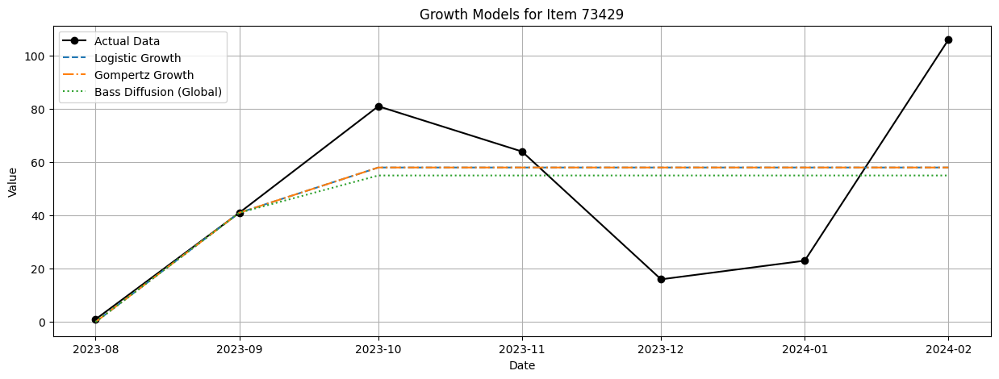

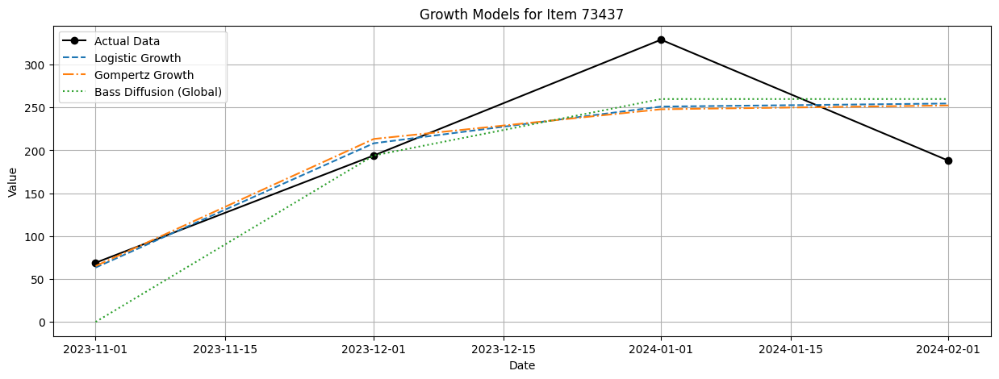

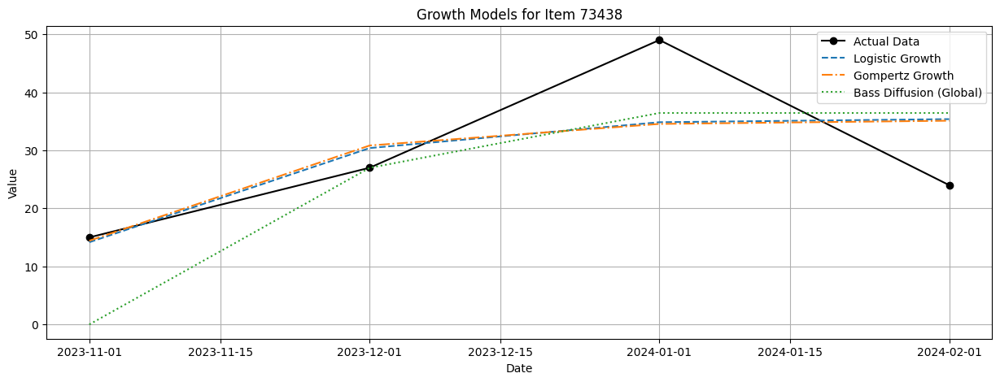

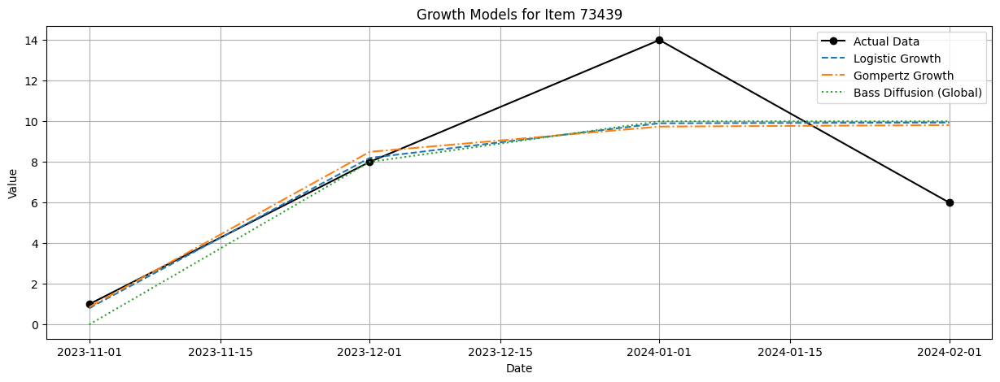

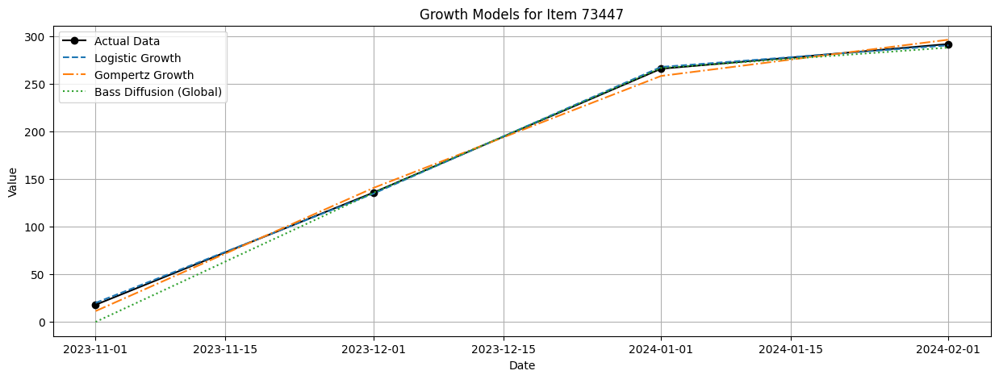

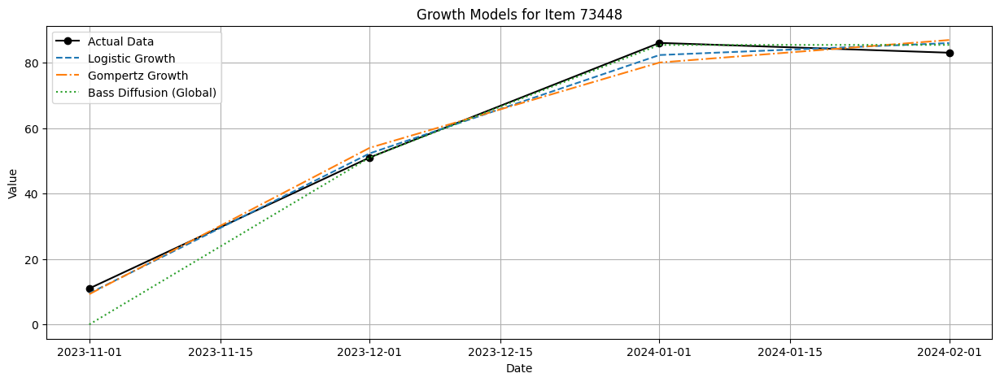

Results for Item 73289:
Logistic Growth Metrics (R², MAE, MAPE, RMSE): (0.9080839007400645, 340.21400842822584, 15.604091200670148, 510.18642056222546)
Gompertz Growth Metrics (R², MAE, MAPE, RMSE): (0.9079723393171202, 340.7900889119946, 15.426801841491637, 510.495941219956)
Bass Diffusion Metrics (Global Optimization) (R², MAE, MAPE, RMSE): (0.0711131249685758, 1356.7809754614407, 74.49573814905771, 1621.864304173432)


Results for Item 73292:
Logistic Growth Metrics (R², MAE, MAPE, RMSE): (0.2615559596980238, 314.51082228096675, 31.72612702385481, 394.3170062381979)
Gompertz Growth Metrics (R², MAE, MAPE, RMSE): (0.6504016411505176, 190.79655135229723, 18.651760701670685, 271.31350105051996)
Bass Diffusion Metrics (Global Optimization) (R², MAE, MAPE, RMSE): (0.3106879764276981, 299.30054122054236, 28.1658356245119, 380.97338782582085)


Results for Item 73296:
Logistic Growth Metrics (R², MAE, MAPE, RMSE): (0.4321484474977523, 64.81716730552562, 49.77836996120205, 91.64374251911651

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.optimize import curve_fit, differential_evolution
from sklearn.metrics import r2_score, mean_absolute_error, mean_squared_error

# Load the dataset from the Feather file using pandas
mdf = pd.read_feather("/mnt/c/Users/doughnut/OneDrive - The University of Melbourne/Phase 1 - Study 4 - Australian Genetic and Genomic Test Utilisation/Data Files/Processed_MBSGeneticsCount_20240325_175333.feather")

# Ensure that "Month" is in datetime format
mdf['Month'] = pd.to_datetime(mdf['Month'])

# Group data by 'Month' and 'Item' and calculate the sum of 'Value' with observed=False to prevent warnings
df = mdf.groupby(['Month', 'Item'], observed=False)['Value'].sum().reset_index()

# Make all values positive
df['Value'] = df['Value'].abs()

# Rename the "Month" and "Value" columns
df = df.rename(columns={"Month": "ds", "Value": "y"})

# Convert the "ds" column to ordinal to use in growth models
df['ds_ordinal'] = df['ds'].apply(lambda x: x.toordinal())

# Define the list of Item values to filter for
items_to_include = [
    73289, 73292, 73296, 73297, 73298, 73299, 73358, 73359, 73360, 73395, 73401, 73402, 73416, 
    73417, 73419, 73422, 73425, 73426, 73428, 73429, 73437, 73438, 73439, 73442, 73445, 73446, 
    73447, 73448, 73456, 73457, 73458
]

# Filter the dataset for the specified Item values
df = df[df['Item'].isin(items_to_include)]

# Define the logistic, Gompertz, and Bass diffusion models
def logistic_growth(t, K, P0, r):
    P0 = max(P0, 1e-6)  # Add a small constant to avoid division by zero
    return K / (1 + ((K - P0) / P0) * np.exp(-r * t))

def gompertz_growth(t, a, b, c):
    return a * np.exp(-b * np.exp(-c * t))

def bass_diffusion(t, p, q, m):
    # Ensure p and q are not too small to avoid invalid division
    p = max(p, 1e-6)
    q = max(q, 1e-6)
    
    # Prevent overflow by limiting the input to exp()
    t = np.clip(t, -500, 500)
    
    # Compute the Bass diffusion model
    diffusion_value = m * (1 - np.exp(-(p + q) * t)) / (1 + (q / p) * np.exp(-(p + q) * t))
    
    # Clip any NaN or infinite values that result from invalid inputs
    diffusion_value = np.nan_to_num(diffusion_value, nan=0.0, posinf=0.0, neginf=0.0)
    
    return diffusion_value

# Optimized initial guess function for Gompertz model
def optimize_initial_guesses(func, t_data, y_data, param_ranges, num_trials=100):
    best_params = None
    best_r2 = -np.inf
    
    for _ in range(num_trials):
        initial_guesses = [np.random.uniform(low, high) for low, high in param_ranges]
        
        try:
            params, _ = curve_fit(func, t_data, y_data, p0=initial_guesses, bounds=([0, 0, 0], [np.inf, np.inf, np.inf]), maxfev=5000)
            y_pred = func(t_data, *params)
            r2 = r2_score(y_data, y_pred)
            if r2 > best_r2:
                best_r2 = r2
                best_params = params
        except RuntimeError:
            continue
    
    return best_params, best_r2

# Define ranges for the Gompertz parameters (a, b, c)
gompertz_param_ranges = [(0.8 * max(df['y']), 1.2 * max(df['y'])), (0.001, 2), (0.001, 2)]

# Global optimization for Bass diffusion using differential evolution
def global_optim_bass_diffusion(t_data, y_data):
    # Objective function to minimize: -R² (to maximize R²)
    def objective(params):
        p, q, m = params
        y_pred = bass_diffusion(t_data, p, q, m)
        # Check for invalid values before calculating R²
        if np.any(np.isnan(y_pred)) or np.any(np.isinf(y_pred)):
            return 1e6  # Return a large penalty if invalid values are found
        r2 = r2_score(y_data, y_pred)
        return -r2  # We minimize, so we negate R²
    
    # Set bounds for p, q, m
    bounds = [(1e-6, 1), (1e-6, 1), (0, max(y_data))]
    
    # Perform global optimization using differential evolution
    result = differential_evolution(objective, bounds)
    return result.x

# Loop over each unique Item and apply the models
items = df['Item'].unique()
results = []

for item in items:
    # Filter data for the current Item and start from the first non-zero value
    df_item = df[(df['Item'] == item) & (df['y'] > 0)].copy()

    # Skip if no data is available after filtering
    if df_item.empty or len(df_item) < 4:  # Check for minimum number of data points
        continue

    # Prepare t_data starting from the first non-zero value
    t_data = df_item['ds_ordinal'] - df_item['ds_ordinal'].min()
    y_data = df_item['y']

    # Fit the logistic model if there are enough data points
    try:
        logistic_params, _ = curve_fit(logistic_growth, t_data, y_data, p0=[max(y_data), min(y_data), 0.1], maxfev=5000)
    except (TypeError, RuntimeError) as e:
        print(f"Skipping logistic model for item {item} due to error: {e}")
        continue

    # Fit the Gompertz model with optimized initial guesses
    try:
        gompertz_params, gompertz_r2 = optimize_initial_guesses(gompertz_growth, t_data, y_data, gompertz_param_ranges)
    except (TypeError, RuntimeError) as e:
        print(f"Skipping Gompertz model for item {item} due to error: {e}")
        continue

    # Fit the Bass diffusion model using global optimization (differential evolution)
    bass_params_global = global_optim_bass_diffusion(t_data, y_data)

    # Generate predictions
    df_item['logistic_pred'] = logistic_growth(t_data, *logistic_params)
    df_item['gompertz_pred'] = gompertz_growth(t_data, *gompertz_params)
    df_item['bass_pred_global'] = bass_diffusion(t_data, *bass_params_global)

    # Ensure predictions contain no invalid values
    df_item.replace([np.inf, -np.inf, np.nan], 0, inplace=True)

    # Define evaluation metrics
    def calculate_metrics(y_true, y_pred):
        r2 = r2_score(y_true, y_pred)
        mae = mean_absolute_error(y_true, y_pred)
        mape = np.mean(np.abs((y_true - y_pred) / y_true)) * 100
        rmse = np.sqrt(mean_squared_error(y_true, y_pred))
        return r2, mae, mape, rmse

    # Calculate metrics for each model
    logistic_metrics = calculate_metrics(df_item['y'], df_item['logistic_pred'])
    gompertz_metrics = calculate_metrics(df_item['y'], df_item['gompertz_pred'])
    bass_metrics_global = calculate_metrics(df_item['y'], df_item['bass_pred_global'])

    results.append({
        "Item": item,
        "Logistic_Metrics": logistic_metrics,
        "Gompertz_Metrics": gompertz_metrics,
        "Bass_Metrics_Global": bass_metrics_global
    })

    # Plot the results for this item
    plt.figure(figsize=(15, 5))
    plt.plot(df_item['ds'], df_item['y'], label='Actual Data', color='black', marker='o')
    plt.plot(df_item['ds'], df_item['logistic_pred'], label='Logistic Growth', linestyle='--')
    plt.plot(df_item['ds'], df_item['gompertz_pred'], label='Gompertz Growth', linestyle='-.')
    plt.plot(df_item['ds'], df_item['bass_pred_global'], label='Bass Diffusion (Global)', linestyle=':')
    plt.xlabel('Date')
    plt.ylabel('Value')
    plt.title(f'Growth Models for Item {item}')
    plt.legend()
    plt.grid(True)
    plt.show()

# Display final results
for result in results:
    print(f"Results for Item {result['Item']}:")
    print("Logistic Growth Metrics (R², MAE, MAPE, RMSE):", result['Logistic_Metrics'])
    print("Gompertz Growth Metrics (R², MAE, MAPE, RMSE):", result['Gompertz_Metrics'])
    print("Bass Diffusion Metrics (Global Optimization) (R², MAE, MAPE, RMSE):", result['Bass_Metrics_Global'])
    print("\n")


/tmp/ipykernel_204610/181378332.py:129: OptimizeWarning: Covariance of the parameters could not be estimated
  logistic_params, _ = curve_fit(logistic_growth, t_data, y_data, p0=[max(y_data), min(y_data), 0.1], maxfev=5000)
/tmp/ipykernel_204610/181378332.py:129: OptimizeWarning: Covariance of the parameters could not be estimated
  logistic_params, _ = curve_fit(logistic_growth, t_data, y_data, p0=[max(y_data), min(y_data), 0.1], maxfev=5000)
/home/doughnut/miniconda3/lib/python3.12/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: overflow encountered in exp
  result = getattr(ufunc, method)(*inputs, **kwargs)
/tmp/ipykernel_204610/181378332.py:129: OptimizeWarning: Covariance of the parameters could not be estimated
  logistic_params, _ = curve_fit(logistic_growth, t_data, y_data, p0=[max(y_data), min(y_data), 0.1], maxfev=5000)
/home/doughnut/miniconda3/lib/python3.12/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: overflow encountered in exp
  result = getatt

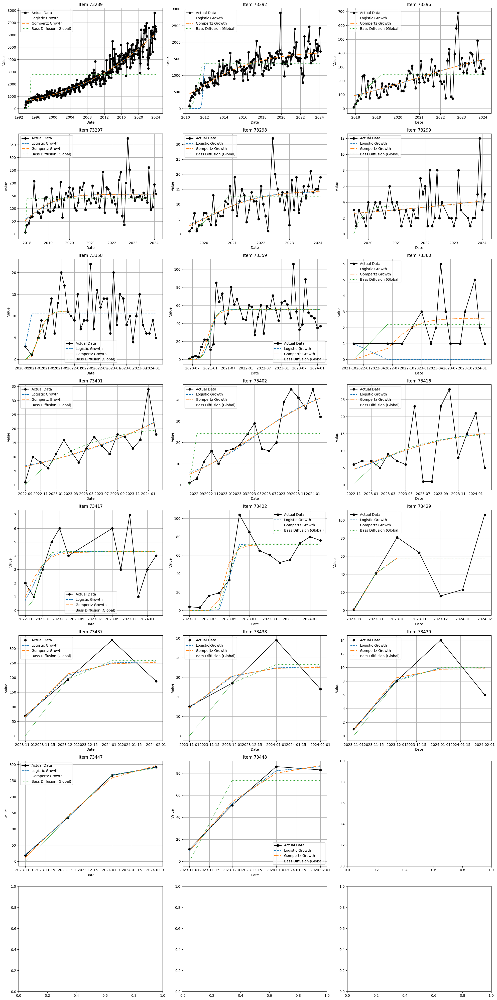

In [16]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.optimize import curve_fit, differential_evolution
from sklearn.metrics import r2_score, mean_absolute_error, mean_squared_error

# Load the dataset from the Feather file using pandas
mdf = pd.read_feather("/mnt/c/Users/doughnut/OneDrive - The University of Melbourne/Phase 1 - Study 4 - Australian Genetic and Genomic Test Utilisation/Data Files/Processed_MBSGeneticsCount_20240325_175333.feather")

# Ensure that "Month" is in datetime format
mdf['Month'] = pd.to_datetime(mdf['Month'])

# Group data by 'Month' and 'Item' and calculate the sum of 'Value' with observed=False to prevent warnings
df = mdf.groupby(['Month', 'Item'], observed=False)['Value'].sum().reset_index()

# Make all values positive
df['Value'] = df['Value'].abs()

# Rename the "Month" and "Value" columns
df = df.rename(columns={"Month": "ds", "Value": "y"})

# Convert the "ds" column to ordinal to use in growth models
df['ds_ordinal'] = df['ds'].apply(lambda x: x.toordinal())

# Define the list of Item values to filter for
items_to_include = [
    73289, 73292, 73296, 73297, 73298, 73299, 73358, 73359, 73360, 73395, 73401, 73402, 73416, 
    73417, 73419, 73422, 73425, 73426, 73428, 73429, 73437, 73438, 73439, 73442, 73445, 73446, 
    73447, 73448, 73456, 73457, 73458
]

# Filter the dataset for the specified Item values
df = df[df['Item'].isin(items_to_include)]

# Define the logistic, Gompertz, and Bass diffusion models
def logistic_growth(t, K, P0, r):
    P0 = max(P0, 1e-6)  # Add a small constant to avoid division by zero
    return K / (1 + ((K - P0) / P0) * np.exp(-r * t))

def gompertz_growth(t, a, b, c):
    return a * np.exp(-b * np.exp(-c * t))

def bass_diffusion(t, p, q, m):
    # Ensure p and q are not too small to avoid invalid division
    p = max(p, 1e-6)
    q = max(q, 1e-6)
    
    # Prevent overflow by limiting the input to exp()
    t = np.clip(t, -500, 500)
    
    # Compute the Bass diffusion model
    diffusion_value = m * (1 - np.exp(-(p + q) * t)) / (1 + (q / p) * np.exp(-(p + q) * t))
    
    # Clip any NaN or infinite values that result from invalid inputs
    diffusion_value = np.nan_to_num(diffusion_value, nan=0.0, posinf=0.0, neginf=0.0)
    
    return diffusion_value

# Optimized initial guess function for Gompertz model
def optimize_initial_guesses(func, t_data, y_data, param_ranges, num_trials=100):
    best_params = None
    best_r2 = -np.inf
    
    for _ in range(num_trials):
        initial_guesses = [np.random.uniform(low, high) for low, high in param_ranges]
        
        try:
            params, _ = curve_fit(func, t_data, y_data, p0=initial_guesses, bounds=([0, 0, 0], [np.inf, np.inf, np.inf]), maxfev=5000)
            y_pred = func(t_data, *params)
            r2 = r2_score(y_data, y_pred)
            if r2 > best_r2:
                best_r2 = r2
                best_params = params
        except RuntimeError:
            continue
    
    return best_params, best_r2

# Define ranges for the Gompertz parameters (a, b, c)
gompertz_param_ranges = [(0.8 * max(df['y']), 1.2 * max(df['y'])), (0.001, 2), (0.001, 2)]

# Global optimization for Bass diffusion using differential evolution
def global_optim_bass_diffusion(t_data, y_data):
    # Objective function to minimize: -R² (to maximize R²)
    def objective(params):
        p, q, m = params
        y_pred = bass_diffusion(t_data, p, q, m)
        # Check for invalid values before calculating R²
        if np.any(np.isnan(y_pred)) or np.any(np.isinf(y_pred)):
            return 1e6  # Return a large penalty if invalid values are found
        r2 = r2_score(y_data, y_pred)
        return -r2  # We minimize, so we negate R²
    
    # Set bounds for p, q, m
    bounds = [(1e-6, 1), (1e-6, 1), (0, max(y_data))]
    
    # Perform global optimization using differential evolution
    result = differential_evolution(objective, bounds)
    return result.x

# Loop over each unique Item and apply the models
items = df['Item'].unique()
results = []

# Set up the subplot structure: 3 columns
n_items = len(items)
n_cols = 3
n_rows = (n_items + n_cols - 1) // n_cols  # Calculate number of rows dynamically

fig, axes = plt.subplots(n_rows, n_cols, figsize=(20, 5 * n_rows))

# Flatten axes for easier indexing when plotting
axes = axes.flatten()

for idx, item in enumerate(items):
    # Filter data for the current Item and start from the first non-zero value
    df_item = df[(df['Item'] == item) & (df['y'] > 0)].copy()

    # Skip if no data is available after filtering
    if df_item.empty or len(df_item) < 4:  # Check for minimum number of data points
        continue

    # Prepare t_data starting from the first non-zero value
    t_data = df_item['ds_ordinal'] - df_item['ds_ordinal'].min()
    y_data = df_item['y']

    # Fit the logistic model if there are enough data points
    try:
        logistic_params, _ = curve_fit(logistic_growth, t_data, y_data, p0=[max(y_data), min(y_data), 0.1], maxfev=5000)
    except (TypeError, RuntimeError) as e:
        print(f"Skipping logistic model for item {item} due to error: {e}")
        continue

    # Fit the Gompertz model with optimized initial guesses
    try:
        gompertz_params, gompertz_r2 = optimize_initial_guesses(gompertz_growth, t_data, y_data, gompertz_param_ranges)
    except (TypeError, RuntimeError) as e:
        print(f"Skipping Gompertz model for item {item} due to error: {e}")
        continue

    # Fit the Bass diffusion model using global optimization (differential evolution)
    bass_params_global = global_optim_bass_diffusion(t_data, y_data)

    # Generate predictions
    df_item['logistic_pred'] = logistic_growth(t_data, *logistic_params)
    df_item['gompertz_pred'] = gompertz_growth(t_data, *gompertz_params)
    df_item['bass_pred_global'] = bass_diffusion(t_data, *bass_params_global)

    # Plot the results for this item in the corresponding subplot
    ax = axes[idx]
    ax.plot(df_item['ds'], df_item['y'], label='Actual Data', color='black', marker='o')
    ax.plot(df_item['ds'], df_item['logistic_pred'], label='Logistic Growth', linestyle='--')
    ax.plot(df_item['ds'], df_item['gompertz_pred'], label='Gompertz Growth', linestyle='-.')
    ax.plot(df_item['ds'], df_item['bass_pred_global'], label='Bass Diffusion (Global)', linestyle=':')
    ax.set_xlabel('Date')
    ax.set_ylabel('Value')
    ax.set_title(f'Item {item}')
    ax.legend()
    ax.grid(True)

# Adjust layout to avoid overlapping subplots
plt.tight_layout()

# Show the final array of subplots
plt.show()


/tmp/ipykernel_204610/1547407516.py:129: OptimizeWarning: Covariance of the parameters could not be estimated
  logistic_params, _ = curve_fit(logistic_growth, t_data, y_data, p0=[max(y_data), min(y_data), 0.1], maxfev=5000)
/tmp/ipykernel_204610/1547407516.py:129: OptimizeWarning: Covariance of the parameters could not be estimated
  logistic_params, _ = curve_fit(logistic_growth, t_data, y_data, p0=[max(y_data), min(y_data), 0.1], maxfev=5000)
/home/doughnut/miniconda3/lib/python3.12/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: overflow encountered in exp
  result = getattr(ufunc, method)(*inputs, **kwargs)
/tmp/ipykernel_204610/1547407516.py:129: OptimizeWarning: Covariance of the parameters could not be estimated
  logistic_params, _ = curve_fit(logistic_growth, t_data, y_data, p0=[max(y_data), min(y_data), 0.1], maxfev=5000)
/home/doughnut/miniconda3/lib/python3.12/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: overflow encountered in exp
  result = get

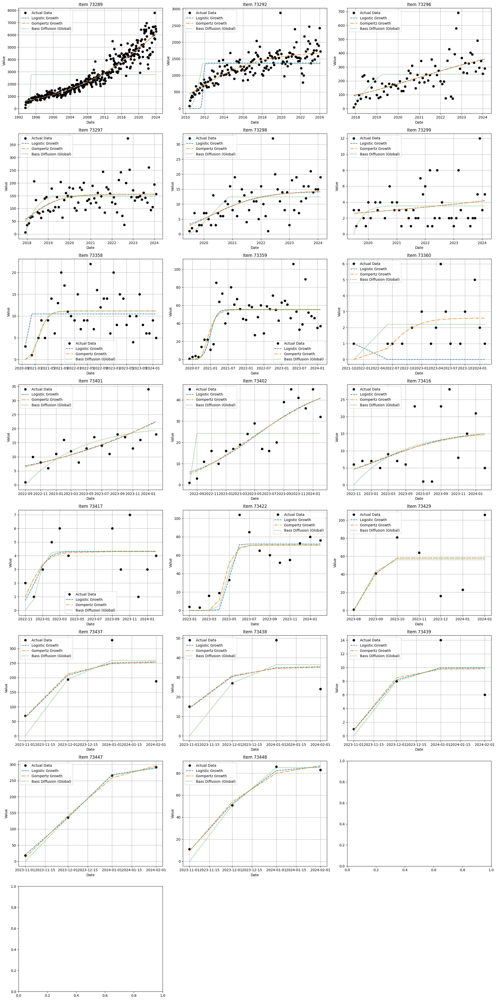

In [17]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.optimize import curve_fit, differential_evolution
from sklearn.metrics import r2_score, mean_absolute_error, mean_squared_error

# Load the dataset from the Feather file using pandas
mdf = pd.read_feather("/mnt/c/Users/doughnut/OneDrive - The University of Melbourne/Phase 1 - Study 4 - Australian Genetic and Genomic Test Utilisation/Data Files/Processed_MBSGeneticsCount_20240325_175333.feather")

# Ensure that "Month" is in datetime format
mdf['Month'] = pd.to_datetime(mdf['Month'])

# Group data by 'Month' and 'Item' and calculate the sum of 'Value' with observed=False to prevent warnings
df = mdf.groupby(['Month', 'Item'], observed=False)['Value'].sum().reset_index()

# Make all values positive
df['Value'] = df['Value'].abs()

# Rename the "Month" and "Value" columns
df = df.rename(columns={"Month": "ds", "Value": "y"})

# Convert the "ds" column to ordinal to use in growth models
df['ds_ordinal'] = df['ds'].apply(lambda x: x.toordinal())

# Define the list of Item values to filter for
items_to_include = [
    73289, 73292, 73296, 73297, 73298, 73299, 73358, 73359, 73360, 73395, 73401, 73402, 73416, 
    73417, 73419, 73422, 73425, 73426, 73428, 73429, 73437, 73438, 73439, 73442, 73445, 73446, 
    73447, 73448, 73456, 73457, 73458
]

# Filter the dataset for the specified Item values
df = df[df['Item'].isin(items_to_include)]

# Define the logistic, Gompertz, and Bass diffusion models
def logistic_growth(t, K, P0, r):
    P0 = max(P0, 1e-6)  # Add a small constant to avoid division by zero
    return K / (1 + ((K - P0) / P0) * np.exp(-r * t))

def gompertz_growth(t, a, b, c):
    return a * np.exp(-b * np.exp(-c * t))

def bass_diffusion(t, p, q, m):
    # Ensure p and q are not too small to avoid invalid division
    p = max(p, 1e-6)
    q = max(q, 1e-6)
    
    # Prevent overflow by limiting the input to exp()
    t = np.clip(t, -500, 500)
    
    # Compute the Bass diffusion model
    diffusion_value = m * (1 - np.exp(-(p + q) * t)) / (1 + (q / p) * np.exp(-(p + q) * t))
    
    # Clip any NaN or infinite values that result from invalid inputs
    diffusion_value = np.nan_to_num(diffusion_value, nan=0.0, posinf=0.0, neginf=0.0)
    
    return diffusion_value

# Optimized initial guess function for Gompertz model
def optimize_initial_guesses(func, t_data, y_data, param_ranges, num_trials=100):
    best_params = None
    best_r2 = -np.inf
    
    for _ in range(num_trials):
        initial_guesses = [np.random.uniform(low, high) for low, high in param_ranges]
        
        try:
            params, _ = curve_fit(func, t_data, y_data, p0=initial_guesses, bounds=([0, 0, 0], [np.inf, np.inf, np.inf]), maxfev=5000)
            y_pred = func(t_data, *params)
            r2 = r2_score(y_data, y_pred)
            if r2 > best_r2:
                best_r2 = r2
                best_params = params
        except RuntimeError:
            continue
    
    return best_params, best_r2

# Define ranges for the Gompertz parameters (a, b, c)
gompertz_param_ranges = [(0.8 * max(df['y']), 1.2 * max(df['y'])), (0.001, 2), (0.001, 2)]

# Global optimization for Bass diffusion using differential evolution
def global_optim_bass_diffusion(t_data, y_data):
    # Objective function to minimize: -R² (to maximize R²)
    def objective(params):
        p, q, m = params
        y_pred = bass_diffusion(t_data, p, q, m)
        # Check for invalid values before calculating R²
        if np.any(np.isnan(y_pred)) or np.any(np.isinf(y_pred)):
            return 1e6  # Return a large penalty if invalid values are found
        r2 = r2_score(y_data, y_pred)
        return -r2  # We minimize, so we negate R²
    
    # Set bounds for p, q, m
    bounds = [(1e-6, 1), (1e-6, 1), (0, max(y_data))]
    
    # Perform global optimization using differential evolution
    result = differential_evolution(objective, bounds)
    return result.x

# Loop over each unique Item and apply the models
items = df['Item'].unique()
results = []

# Set up the subplot structure: 3 columns
n_items = len(items)
n_cols = 3
n_rows = (n_items + n_cols - 1) // n_cols  # Calculate number of rows dynamically

fig, axes = plt.subplots(n_rows, n_cols, figsize=(20, 5 * n_rows))

# Flatten axes for easier indexing when plotting
axes = axes.flatten()

for idx, item in enumerate(items):
    # Filter data for the current Item and start from the first non-zero value
    df_item = df[(df['Item'] == item) & (df['y'] > 0)].copy()

    # Skip if no data is available after filtering
    if df_item.empty or len(df_item) < 4:  # Check for minimum number of data points
        continue

    # Prepare t_data starting from the first non-zero value
    t_data = df_item['ds_ordinal'] - df_item['ds_ordinal'].min()
    y_data = df_item['y']

    # Fit the logistic model if there are enough data points
    try:
        logistic_params, _ = curve_fit(logistic_growth, t_data, y_data, p0=[max(y_data), min(y_data), 0.1], maxfev=5000)
    except (TypeError, RuntimeError) as e:
        print(f"Skipping logistic model for item {item} due to error: {e}")
        continue

    # Fit the Gompertz model with optimized initial guesses
    try:
        gompertz_params, gompertz_r2 = optimize_initial_guesses(gompertz_growth, t_data, y_data, gompertz_param_ranges)
    except (TypeError, RuntimeError) as e:
        print(f"Skipping Gompertz model for item {item} due to error: {e}")
        continue

    # Fit the Bass diffusion model using global optimization (differential evolution)
    bass_params_global = global_optim_bass_diffusion(t_data, y_data)

    # Generate predictions
    df_item['logistic_pred'] = logistic_growth(t_data, *logistic_params)
    df_item['gompertz_pred'] = gompertz_growth(t_data, *gompertz_params)
    df_item['bass_pred_global'] = bass_diffusion(t_data, *bass_params_global)

    # Plot the results for this item in the corresponding subplot
    ax = axes[idx]
    ax.plot(df_item['ds'], df_item['y'], 'o', label='Actual Data', color='black')  # Dots only for actual data
    ax.plot(df_item['ds'], df_item['logistic_pred'], label='Logistic Growth', linestyle='--')
    ax.plot(df_item['ds'], df_item['gompertz_pred'], label='Gompertz Growth', linestyle='-.')
    ax.plot(df_item['ds'], df_item['bass_pred_global'], label='Bass Diffusion (Global)', linestyle=':')
    ax.set_xlabel('Date')
    ax.set_ylabel('Value')
    ax.set_title(f'Item {item}')
    ax.legend()
    ax.grid(True)

# Hide any unused subplots (empty ones)
for idx in range(len(items), len(axes)):
    fig.delaxes(axes[idx])

# Adjust layout to avoid overlapping subplots
plt.tight_layout()

# Show the final array of subplots
plt.show()


/tmp/ipykernel_204610/857224440.py:129: OptimizeWarning: Covariance of the parameters could not be estimated
  logistic_params, _ = curve_fit(logistic_growth, t_data, y_data, p0=[max(y_data), min(y_data), 0.1], maxfev=5000)
/tmp/ipykernel_204610/857224440.py:129: OptimizeWarning: Covariance of the parameters could not be estimated
  logistic_params, _ = curve_fit(logistic_growth, t_data, y_data, p0=[max(y_data), min(y_data), 0.1], maxfev=5000)
/home/doughnut/miniconda3/lib/python3.12/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: overflow encountered in exp
  result = getattr(ufunc, method)(*inputs, **kwargs)
/tmp/ipykernel_204610/857224440.py:129: OptimizeWarning: Covariance of the parameters could not be estimated
  logistic_params, _ = curve_fit(logistic_growth, t_data, y_data, p0=[max(y_data), min(y_data), 0.1], maxfev=5000)
/home/doughnut/miniconda3/lib/python3.12/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: overflow encountered in exp
  result = getatt

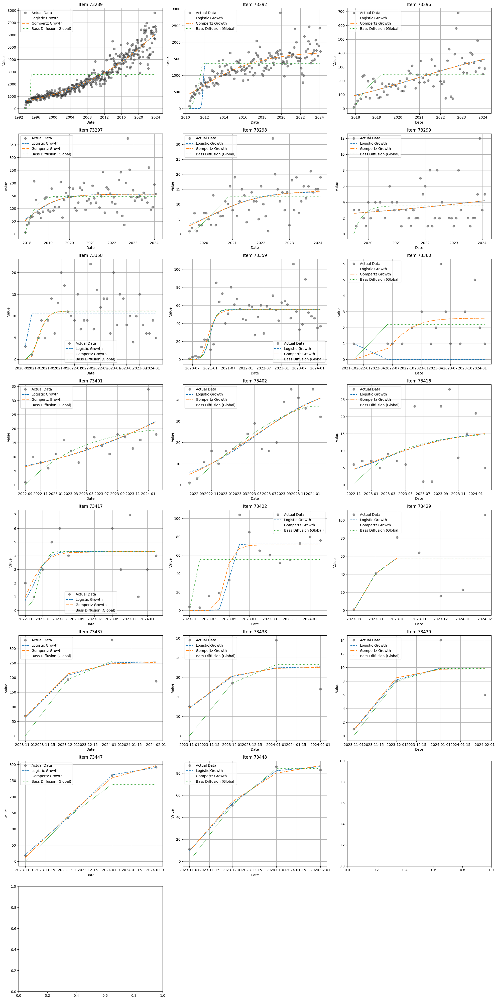

In [18]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.optimize import curve_fit, differential_evolution
from sklearn.metrics import r2_score, mean_absolute_error, mean_squared_error

# Load the dataset from the Feather file using pandas
mdf = pd.read_feather("/mnt/c/Users/doughnut/OneDrive - The University of Melbourne/Phase 1 - Study 4 - Australian Genetic and Genomic Test Utilisation/Data Files/Processed_MBSGeneticsCount_20240325_175333.feather")

# Ensure that "Month" is in datetime format
mdf['Month'] = pd.to_datetime(mdf['Month'])

# Group data by 'Month' and 'Item' and calculate the sum of 'Value' with observed=False to prevent warnings
df = mdf.groupby(['Month', 'Item'], observed=False)['Value'].sum().reset_index()

# Make all values positive
df['Value'] = df['Value'].abs()

# Rename the "Month" and "Value" columns
df = df.rename(columns={"Month": "ds", "Value": "y"})

# Convert the "ds" column to ordinal to use in growth models
df['ds_ordinal'] = df['ds'].apply(lambda x: x.toordinal())

# Define the list of Item values to filter for
items_to_include = [
    73289, 73292, 73296, 73297, 73298, 73299, 73358, 73359, 73360, 73395, 73401, 73402, 73416, 
    73417, 73419, 73422, 73425, 73426, 73428, 73429, 73437, 73438, 73439, 73442, 73445, 73446, 
    73447, 73448, 73456, 73457, 73458
]

# Filter the dataset for the specified Item values
df = df[df['Item'].isin(items_to_include)]

# Define the logistic, Gompertz, and Bass diffusion models
def logistic_growth(t, K, P0, r):
    P0 = max(P0, 1e-6)  # Add a small constant to avoid division by zero
    return K / (1 + ((K - P0) / P0) * np.exp(-r * t))

def gompertz_growth(t, a, b, c):
    return a * np.exp(-b * np.exp(-c * t))

def bass_diffusion(t, p, q, m):
    # Ensure p and q are not too small to avoid invalid division
    p = max(p, 1e-6)
    q = max(q, 1e-6)
    
    # Prevent overflow by limiting the input to exp()
    t = np.clip(t, -500, 500)
    
    # Compute the Bass diffusion model
    diffusion_value = m * (1 - np.exp(-(p + q) * t)) / (1 + (q / p) * np.exp(-(p + q) * t))
    
    # Clip any NaN or infinite values that result from invalid inputs
    diffusion_value = np.nan_to_num(diffusion_value, nan=0.0, posinf=0.0, neginf=0.0)
    
    return diffusion_value

# Optimized initial guess function for Gompertz model
def optimize_initial_guesses(func, t_data, y_data, param_ranges, num_trials=100):
    best_params = None
    best_r2 = -np.inf
    
    for _ in range(num_trials):
        initial_guesses = [np.random.uniform(low, high) for low, high in param_ranges]
        
        try:
            params, _ = curve_fit(func, t_data, y_data, p0=initial_guesses, bounds=([0, 0, 0], [np.inf, np.inf, np.inf]), maxfev=5000)
            y_pred = func(t_data, *params)
            r2 = r2_score(y_data, y_pred)
            if r2 > best_r2:
                best_r2 = r2
                best_params = params
        except RuntimeError:
            continue
    
    return best_params, best_r2

# Define ranges for the Gompertz parameters (a, b, c)
gompertz_param_ranges = [(0.8 * max(df['y']), 1.2 * max(df['y'])), (0.001, 2), (0.001, 2)]

# Global optimization for Bass diffusion using differential evolution
def global_optim_bass_diffusion(t_data, y_data):
    # Objective function to minimize: -R² (to maximize R²)
    def objective(params):
        p, q, m = params
        y_pred = bass_diffusion(t_data, p, q, m)
        # Check for invalid values before calculating R²
        if np.any(np.isnan(y_pred)) or np.any(np.isinf(y_pred)):
            return 1e6  # Return a large penalty if invalid values are found
        r2 = r2_score(y_data, y_pred)
        return -r2  # We minimize, so we negate R²
    
    # Set bounds for p, q, m
    bounds = [(1e-6, 1), (1e-6, 1), (0, max(y_data))]
    
    # Perform global optimization using differential evolution
    result = differential_evolution(objective, bounds)
    return result.x

# Loop over each unique Item and apply the models
items = df['Item'].unique()
results = []

# Set up the subplot structure: 3 columns
n_items = len(items)
n_cols = 3
n_rows = (n_items + n_cols - 1) // n_cols  # Calculate number of rows dynamically

fig, axes = plt.subplots(n_rows, n_cols, figsize=(20, 5 * n_rows))

# Flatten axes for easier indexing when plotting
axes = axes.flatten()

for idx, item in enumerate(items):
    # Filter data for the current Item and start from the first non-zero value
    df_item = df[(df['Item'] == item) & (df['y'] > 0)].copy()

    # Skip if no data is available after filtering
    if df_item.empty or len(df_item) < 4:  # Check for minimum number of data points
        continue

    # Prepare t_data starting from the first non-zero value
    t_data = df_item['ds_ordinal'] - df_item['ds_ordinal'].min()
    y_data = df_item['y']

    # Fit the logistic model if there are enough data points
    try:
        logistic_params, _ = curve_fit(logistic_growth, t_data, y_data, p0=[max(y_data), min(y_data), 0.1], maxfev=5000)
    except (TypeError, RuntimeError) as e:
        print(f"Skipping logistic model for item {item} due to error: {e}")
        continue

    # Fit the Gompertz model with optimized initial guesses
    try:
        gompertz_params, gompertz_r2 = optimize_initial_guesses(gompertz_growth, t_data, y_data, gompertz_param_ranges)
    except (TypeError, RuntimeError) as e:
        print(f"Skipping Gompertz model for item {item} due to error: {e}")
        continue

    # Fit the Bass diffusion model using global optimization (differential evolution)
    bass_params_global = global_optim_bass_diffusion(t_data, y_data)

    # Generate predictions
    df_item['logistic_pred'] = logistic_growth(t_data, *logistic_params)
    df_item['gompertz_pred'] = gompertz_growth(t_data, *gompertz_params)
    df_item['bass_pred_global'] = bass_diffusion(t_data, *bass_params_global)

    # Plot the results for this item in the corresponding subplot
    ax = axes[idx]
    # Plot actual data as charcoal dots with 50% transparency
    ax.plot(df_item['ds'], df_item['y'], 'o', label='Actual Data', color=(0.2, 0.2, 0.2, 0.5))  # Charcoal with 50% transparency
    ax.plot(df_item['ds'], df_item['logistic_pred'], label='Logistic Growth', linestyle='--')
    ax.plot(df_item['ds'], df_item['gompertz_pred'], label='Gompertz Growth', linestyle='-.')
    ax.plot(df_item['ds'], df_item['bass_pred_global'], label='Bass Diffusion (Global)', linestyle=':')
    ax.set_xlabel('Date')
    ax.set_ylabel('Value')
    ax.set_title(f'Item {item}')
    ax.legend()
    ax.grid(True)

# Hide any unused subplots (empty ones)
for idx in range(len(items), len(axes)):
    fig.delaxes(axes[idx])

# Adjust layout to avoid overlapping subplots
plt.tight_layout()

# Show the final array of subplots
plt.show()


/tmp/ipykernel_204610/3805295563.py:129: OptimizeWarning: Covariance of the parameters could not be estimated
  logistic_params, _ = curve_fit(logistic_growth, t_data, y_data, p0=[max(y_data), min(y_data), 0.1], maxfev=5000)
/tmp/ipykernel_204610/3805295563.py:129: OptimizeWarning: Covariance of the parameters could not be estimated
  logistic_params, _ = curve_fit(logistic_growth, t_data, y_data, p0=[max(y_data), min(y_data), 0.1], maxfev=5000)
/home/doughnut/miniconda3/lib/python3.12/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: overflow encountered in exp
  result = getattr(ufunc, method)(*inputs, **kwargs)
/tmp/ipykernel_204610/3805295563.py:129: OptimizeWarning: Covariance of the parameters could not be estimated
  logistic_params, _ = curve_fit(logistic_growth, t_data, y_data, p0=[max(y_data), min(y_data), 0.1], maxfev=5000)
/home/doughnut/miniconda3/lib/python3.12/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: overflow encountered in exp
  result = get

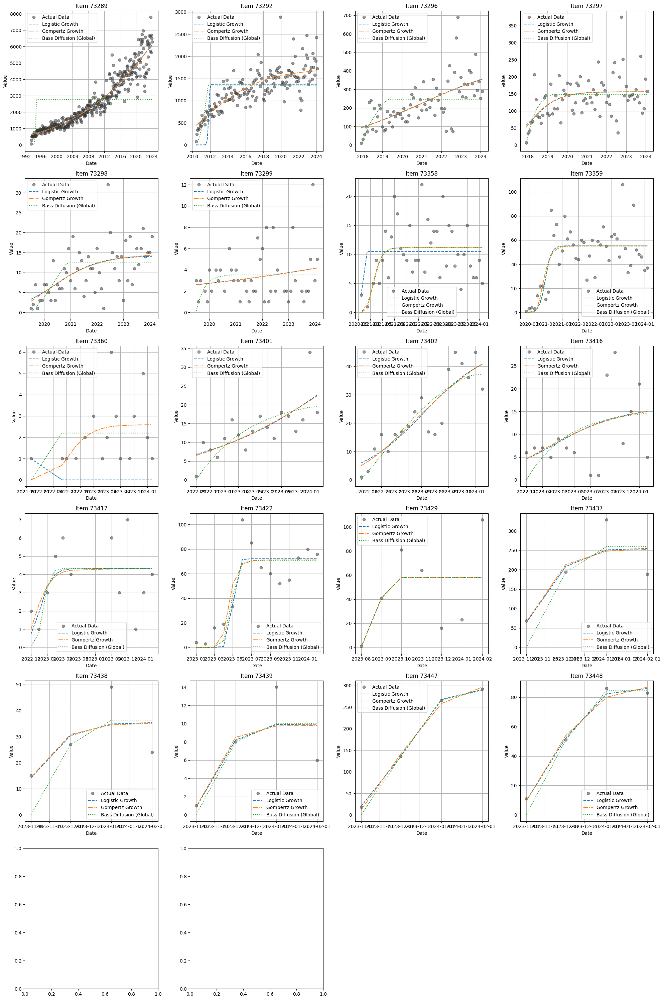

In [19]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.optimize import curve_fit, differential_evolution
from sklearn.metrics import r2_score, mean_absolute_error, mean_squared_error

# Load the dataset from the Feather file using pandas
mdf = pd.read_feather("/mnt/c/Users/doughnut/OneDrive - The University of Melbourne/Phase 1 - Study 4 - Australian Genetic and Genomic Test Utilisation/Data Files/Processed_MBSGeneticsCount_20240325_175333.feather")

# Ensure that "Month" is in datetime format
mdf['Month'] = pd.to_datetime(mdf['Month'])

# Group data by 'Month' and 'Item' and calculate the sum of 'Value' with observed=False to prevent warnings
df = mdf.groupby(['Month', 'Item'], observed=False)['Value'].sum().reset_index()

# Make all values positive
df['Value'] = df['Value'].abs()

# Rename the "Month" and "Value" columns
df = df.rename(columns={"Month": "ds", "Value": "y"})

# Convert the "ds" column to ordinal to use in growth models
df['ds_ordinal'] = df['ds'].apply(lambda x: x.toordinal())

# Define the list of Item values to filter for
items_to_include = [
    73289, 73292, 73296, 73297, 73298, 73299, 73358, 73359, 73360, 73395, 73401, 73402, 73416, 
    73417, 73419, 73422, 73425, 73426, 73428, 73429, 73437, 73438, 73439, 73442, 73445, 73446, 
    73447, 73448, 73456, 73457, 73458
]

# Filter the dataset for the specified Item values
df = df[df['Item'].isin(items_to_include)]

# Define the logistic, Gompertz, and Bass diffusion models
def logistic_growth(t, K, P0, r):
    P0 = max(P0, 1e-6)  # Add a small constant to avoid division by zero
    return K / (1 + ((K - P0) / P0) * np.exp(-r * t))

def gompertz_growth(t, a, b, c):
    return a * np.exp(-b * np.exp(-c * t))

def bass_diffusion(t, p, q, m):
    # Ensure p and q are not too small to avoid invalid division
    p = max(p, 1e-6)
    q = max(q, 1e-6)
    
    # Prevent overflow by limiting the input to exp()
    t = np.clip(t, -500, 500)
    
    # Compute the Bass diffusion model
    diffusion_value = m * (1 - np.exp(-(p + q) * t)) / (1 + (q / p) * np.exp(-(p + q) * t))
    
    # Clip any NaN or infinite values that result from invalid inputs
    diffusion_value = np.nan_to_num(diffusion_value, nan=0.0, posinf=0.0, neginf=0.0)
    
    return diffusion_value

# Optimized initial guess function for Gompertz model
def optimize_initial_guesses(func, t_data, y_data, param_ranges, num_trials=100):
    best_params = None
    best_r2 = -np.inf
    
    for _ in range(num_trials):
        initial_guesses = [np.random.uniform(low, high) for low, high in param_ranges]
        
        try:
            params, _ = curve_fit(func, t_data, y_data, p0=initial_guesses, bounds=([0, 0, 0], [np.inf, np.inf, np.inf]), maxfev=5000)
            y_pred = func(t_data, *params)
            r2 = r2_score(y_data, y_pred)
            if r2 > best_r2:
                best_r2 = r2
                best_params = params
        except RuntimeError:
            continue
    
    return best_params, best_r2

# Define ranges for the Gompertz parameters (a, b, c)
gompertz_param_ranges = [(0.8 * max(df['y']), 1.2 * max(df['y'])), (0.001, 2), (0.001, 2)]

# Global optimization for Bass diffusion using differential evolution
def global_optim_bass_diffusion(t_data, y_data):
    # Objective function to minimize: -R² (to maximize R²)
    def objective(params):
        p, q, m = params
        y_pred = bass_diffusion(t_data, p, q, m)
        # Check for invalid values before calculating R²
        if np.any(np.isnan(y_pred)) or np.any(np.isinf(y_pred)):
            return 1e6  # Return a large penalty if invalid values are found
        r2 = r2_score(y_data, y_pred)
        return -r2  # We minimize, so we negate R²
    
    # Set bounds for p, q, m
    bounds = [(1e-6, 1), (1e-6, 1), (0, max(y_data))]
    
    # Perform global optimization using differential evolution
    result = differential_evolution(objective, bounds)
    return result.x

# Loop over each unique Item and apply the models
items = df['Item'].unique()
results = []

# Set up the subplot structure: 4 columns instead of 3
n_items = len(items)
n_cols = 4  # Set to 4 columns
n_rows = (n_items + n_cols - 1) // n_cols  # Calculate number of rows dynamically

fig, axes = plt.subplots(n_rows, n_cols, figsize=(20, 5 * n_rows))

# Flatten axes for easier indexing when plotting
axes = axes.flatten()

for idx, item in enumerate(items):
    # Filter data for the current Item and start from the first non-zero value
    df_item = df[(df['Item'] == item) & (df['y'] > 0)].copy()

    # Skip if no data is available after filtering
    if df_item.empty or len(df_item) < 4:  # Check for minimum number of data points
        continue

    # Prepare t_data starting from the first non-zero value
    t_data = df_item['ds_ordinal'] - df_item['ds_ordinal'].min()
    y_data = df_item['y']

    # Fit the logistic model if there are enough data points
    try:
        logistic_params, _ = curve_fit(logistic_growth, t_data, y_data, p0=[max(y_data), min(y_data), 0.1], maxfev=5000)
    except (TypeError, RuntimeError) as e:
        print(f"Skipping logistic model for item {item} due to error: {e}")
        continue

    # Fit the Gompertz model with optimized initial guesses
    try:
        gompertz_params, gompertz_r2 = optimize_initial_guesses(gompertz_growth, t_data, y_data, gompertz_param_ranges)
    except (TypeError, RuntimeError) as e:
        print(f"Skipping Gompertz model for item {item} due to error: {e}")
        continue

    # Fit the Bass diffusion model using global optimization (differential evolution)
    bass_params_global = global_optim_bass_diffusion(t_data, y_data)

    # Generate predictions
    df_item['logistic_pred'] = logistic_growth(t_data, *logistic_params)
    df_item['gompertz_pred'] = gompertz_growth(t_data, *gompertz_params)
    df_item['bass_pred_global'] = bass_diffusion(t_data, *bass_params_global)

    # Plot the results for this item in the corresponding subplot
    ax = axes[idx]
    # Plot actual data as charcoal dots with 50% transparency
    ax.plot(df_item['ds'], df_item['y'], 'o', label='Actual Data', color=(0.2, 0.2, 0.2, 0.5))  # Charcoal with 50% transparency
    ax.plot(df_item['ds'], df_item['logistic_pred'], label='Logistic Growth', linestyle='--')
    ax.plot(df_item['ds'], df_item['gompertz_pred'], label='Gompertz Growth', linestyle='-.')
    ax.plot(df_item['ds'], df_item['bass_pred_global'], label='Bass Diffusion (Global)', linestyle=':')
    ax.set_xlabel('Date')
    ax.set_ylabel('Value')
    ax.set_title(f'Item {item}')
    ax.legend()
    ax.grid(True)

# Hide any unused subplots (empty ones)
for idx in range(len(items), len(axes)):
    fig.delaxes(axes[idx])

# Adjust layout to avoid overlapping subplots
plt.tight_layout()

# Show the final array of subplots
plt.show()


/tmp/ipykernel_204610/3374978099.py:129: OptimizeWarning: Covariance of the parameters could not be estimated
  logistic_params, _ = curve_fit(logistic_growth, t_data, y_data, p0=[max(y_data), min(y_data), 0.1], maxfev=5000)
/tmp/ipykernel_204610/3374978099.py:129: OptimizeWarning: Covariance of the parameters could not be estimated
  logistic_params, _ = curve_fit(logistic_growth, t_data, y_data, p0=[max(y_data), min(y_data), 0.1], maxfev=5000)
/home/doughnut/miniconda3/lib/python3.12/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: overflow encountered in exp
  result = getattr(ufunc, method)(*inputs, **kwargs)
/tmp/ipykernel_204610/3374978099.py:129: OptimizeWarning: Covariance of the parameters could not be estimated
  logistic_params, _ = curve_fit(logistic_growth, t_data, y_data, p0=[max(y_data), min(y_data), 0.1], maxfev=5000)
/home/doughnut/miniconda3/lib/python3.12/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: overflow encountered in exp
  result = get

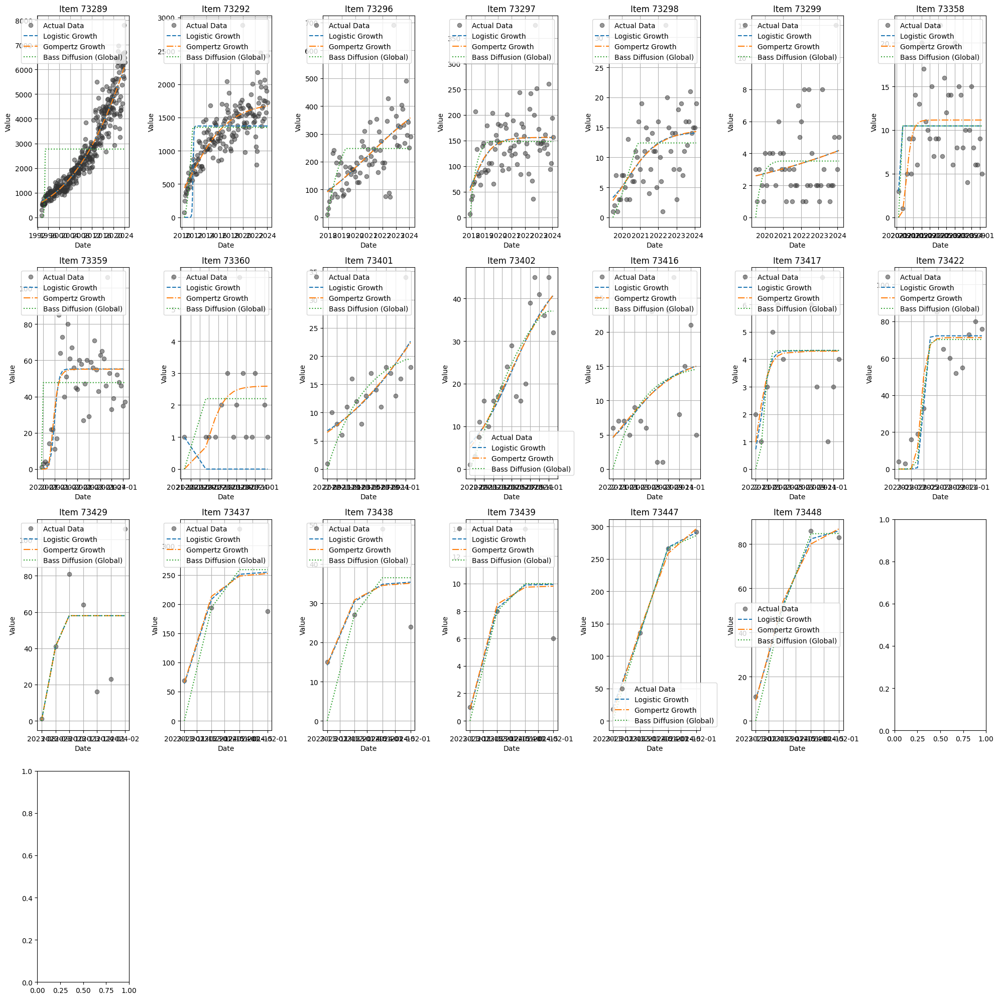

In [21]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.optimize import curve_fit, differential_evolution
from sklearn.metrics import r2_score, mean_absolute_error, mean_squared_error

# Load the dataset from the Feather file using pandas
mdf = pd.read_feather("/mnt/c/Users/doughnut/OneDrive - The University of Melbourne/Phase 1 - Study 4 - Australian Genetic and Genomic Test Utilisation/Data Files/Processed_MBSGeneticsCount_20240325_175333.feather")

# Ensure that "Month" is in datetime format
mdf['Month'] = pd.to_datetime(mdf['Month'])

# Group data by 'Month' and 'Item' and calculate the sum of 'Value' with observed=False to prevent warnings
df = mdf.groupby(['Month', 'Item'], observed=False)['Value'].sum().reset_index()

# Make all values positive
df['Value'] = df['Value'].abs()

# Rename the "Month" and "Value" columns
df = df.rename(columns={"Month": "ds", "Value": "y"})

# Convert the "ds" column to ordinal to use in growth models
df['ds_ordinal'] = df['ds'].apply(lambda x: x.toordinal())

# Define the list of Item values to filter for
items_to_include = [
    73289, 73292, 73296, 73297, 73298, 73299, 73358, 73359, 73360, 73395, 73401, 73402, 73416, 
    73417, 73419, 73422, 73425, 73426, 73428, 73429, 73437, 73438, 73439, 73442, 73445, 73446, 
    73447, 73448, 73456, 73457, 73458
]

# Filter the dataset for the specified Item values
df = df[df['Item'].isin(items_to_include)]

# Define the logistic, Gompertz, and Bass diffusion models
def logistic_growth(t, K, P0, r):
    P0 = max(P0, 1e-6)  # Add a small constant to avoid division by zero
    return K / (1 + ((K - P0) / P0) * np.exp(-r * t))

def gompertz_growth(t, a, b, c):
    return a * np.exp(-b * np.exp(-c * t))

def bass_diffusion(t, p, q, m):
    # Ensure p and q are not too small to avoid invalid division
    p = max(p, 1e-6)
    q = max(q, 1e-6)
    
    # Prevent overflow by limiting the input to exp()
    t = np.clip(t, -500, 500)
    
    # Compute the Bass diffusion model
    diffusion_value = m * (1 - np.exp(-(p + q) * t)) / (1 + (q / p) * np.exp(-(p + q) * t))
    
    # Clip any NaN or infinite values that result from invalid inputs
    diffusion_value = np.nan_to_num(diffusion_value, nan=0.0, posinf=0.0, neginf=0.0)
    
    return diffusion_value

# Optimized initial guess function for Gompertz model
def optimize_initial_guesses(func, t_data, y_data, param_ranges, num_trials=100):
    best_params = None
    best_r2 = -np.inf
    
    for _ in range(num_trials):
        initial_guesses = [np.random.uniform(low, high) for low, high in param_ranges]
        
        try:
            params, _ = curve_fit(func, t_data, y_data, p0=initial_guesses, bounds=([0, 0, 0], [np.inf, np.inf, np.inf]), maxfev=5000)
            y_pred = func(t_data, *params)
            r2 = r2_score(y_data, y_pred)
            if r2 > best_r2:
                best_r2 = r2
                best_params = params
        except RuntimeError:
            continue
    
    return best_params, best_r2

# Define ranges for the Gompertz parameters (a, b, c)
gompertz_param_ranges = [(0.8 * max(df['y']), 1.2 * max(df['y'])), (0.001, 2), (0.001, 2)]

# Global optimization for Bass diffusion using differential evolution
def global_optim_bass_diffusion(t_data, y_data):
    # Objective function to minimize: -R² (to maximize R²)
    def objective(params):
        p, q, m = params
        y_pred = bass_diffusion(t_data, p, q, m)
        # Check for invalid values before calculating R²
        if np.any(np.isnan(y_pred)) or np.any(np.isinf(y_pred)):
            return 1e6  # Return a large penalty if invalid values are found
        r2 = r2_score(y_data, y_pred)
        return -r2  # We minimize, so we negate R²
    
    # Set bounds for p, q, m
    bounds = [(1e-6, 1), (1e-6, 1), (0, max(y_data))]
    
    # Perform global optimization using differential evolution
    result = differential_evolution(objective, bounds)
    return result.x

# Loop over each unique Item and apply the models
items = df['Item'].unique()
results = []

# Set up the subplot structure: 4 columns instead of 3
n_items = len(items)
n_cols = 7  # Set to 4 columns
n_rows = (n_items + n_cols - 1) // n_cols  # Calculate number of rows dynamically

fig, axes = plt.subplots(n_rows, n_cols, figsize=(20, 5 * n_rows))

# Flatten axes for easier indexing when plotting
axes = axes.flatten()

for idx, item in enumerate(items):
    # Filter data for the current Item and start from the first non-zero value
    df_item = df[(df['Item'] == item) & (df['y'] > 0)].copy()

    # Skip if no data is available after filtering
    if df_item.empty or len(df_item) < 4:  # Check for minimum number of data points
        continue

    # Prepare t_data starting from the first non-zero value
    t_data = df_item['ds_ordinal'] - df_item['ds_ordinal'].min()
    y_data = df_item['y']

    # Fit the logistic model if there are enough data points
    try:
        logistic_params, _ = curve_fit(logistic_growth, t_data, y_data, p0=[max(y_data), min(y_data), 0.1], maxfev=5000)
    except (TypeError, RuntimeError) as e:
        print(f"Skipping logistic model for item {item} due to error: {e}")
        continue

    # Fit the Gompertz model with optimized initial guesses
    try:
        gompertz_params, gompertz_r2 = optimize_initial_guesses(gompertz_growth, t_data, y_data, gompertz_param_ranges)
    except (TypeError, RuntimeError) as e:
        print(f"Skipping Gompertz model for item {item} due to error: {e}")
        continue

    # Fit the Bass diffusion model using global optimization (differential evolution)
    bass_params_global = global_optim_bass_diffusion(t_data, y_data)

    # Generate predictions
    df_item['logistic_pred'] = logistic_growth(t_data, *logistic_params)
    df_item['gompertz_pred'] = gompertz_growth(t_data, *gompertz_params)
    df_item['bass_pred_global'] = bass_diffusion(t_data, *bass_params_global)

    # Plot the results for this item in the corresponding subplot
    ax = axes[idx]
    # Plot actual data as charcoal dots with 50% transparency
    ax.plot(df_item['ds'], df_item['y'], 'o', label='Actual Data', color=(0.2, 0.2, 0.2, 0.5))  # Charcoal with 50% transparency
    ax.plot(df_item['ds'], df_item['logistic_pred'], label='Logistic Growth', linestyle='--')
    ax.plot(df_item['ds'], df_item['gompertz_pred'], label='Gompertz Growth', linestyle='-.')
    ax.plot(df_item['ds'], df_item['bass_pred_global'], label='Bass Diffusion (Global)', linestyle=':')
    ax.set_xlabel('Date')
    ax.set_ylabel('Value')
    ax.set_title(f'Item {item}')
    ax.legend()
    ax.grid(True)

# Hide any unused subplots (empty ones)
for idx in range(len(items), len(axes)):
    fig.delaxes(axes[idx])

# Adjust layout to avoid overlapping subplots
plt.tight_layout()

# Show the final array of subplots
plt.show()


In [3]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.optimize import curve_fit, differential_evolution
from sklearn.metrics import r2_score, mean_absolute_error, mean_squared_error

# Load the dataset from the Feather file using pandas
mdf = pd.read_feather("/mnt/c/Users/doughnut/OneDrive - The University of Melbourne/Phase 1 - Study 4 - Australian Genetic and Genomic Test Utilisation/Data Files/Processed_MBSGeneticsCount_20240325_175333.feather")

# Ensure that "Month" is in datetime format
mdf['Month'] = pd.to_datetime(mdf['Month'])

# Group data by 'Month' and 'Item' and calculate the sum of 'Value' with observed=False to prevent warnings
df = mdf.groupby(['Month', 'Item'], observed=False)['Value'].sum().reset_index()

# Make all values positive
df['Value'] = df['Value'].abs()

# Rename the "Month" and "Value" columns
df = df.rename(columns={"Month": "ds", "Value": "y"})

# Convert the "ds" column to ordinal to use in growth models
df['ds_ordinal'] = df['ds'].apply(lambda x: x.toordinal())

# Define the list of Item values to filter for
items_to_include = [
    73289, 73292, 73296, 73297, 73298, 73299, 73358, 73359, 73360, 73395, 73401, 73402, 73416, 
    73417, 73419, 73422, 73425, 73426, 73428, 73429, 73437, 73438, 73439, 73442, 73445, 73446, 
    73447, 73448, 73456, 73457, 73458
]

# Filter the dataset for the specified Item values
df = df[df['Item'].isin(items_to_include)]

# Define the logistic, Gompertz, and Bass diffusion models
def logistic_growth(t, K, P0, r):
    P0 = max(P0, 1e-6)  # Add a small constant to avoid division by zero
    return K / (1 + ((K - P0) / P0) * np.exp(-r * t))

def gompertz_growth(t, a, b, c):
    return a * np.exp(-b * np.exp(-c * t))

def bass_diffusion(t, p, q, m):
    # Ensure p and q are not too small to avoid invalid division
    p = max(p, 1e-6)
    q = max(q, 1e-6)
    
    # Prevent overflow by limiting the input to exp()
    t = np.clip(t, -500, 500)
    
    # Compute the Bass diffusion model
    diffusion_value = m * (1 - np.exp(-(p + q) * t)) / (1 + (q / p) * np.exp(-(p + q) * t))
    
    # Clip any NaN or infinite values that result from invalid inputs
    diffusion_value = np.nan_to_num(diffusion_value, nan=0.0, posinf=0.0, neginf=0.0)
    
    return diffusion_value

# Optimized initial guess function for Gompertz model
def optimize_initial_guesses(func, t_data, y_data, param_ranges, num_trials=100):
    best_params = None
    best_r2 = -np.inf
    
    for _ in range(num_trials):
        initial_guesses = [np.random.uniform(low, high) for low, high in param_ranges]
        
        try:
            params, _ = curve_fit(func, t_data, y_data, p0=initial_guesses, bounds=([0, 0, 0], [np.inf, np.inf, np.inf]), maxfev=5000)
            y_pred = func(t_data, *params)
            r2 = r2_score(y_data, y_pred)
            if r2 > best_r2:
                best_r2 = r2
                best_params = params
        except RuntimeError:
            continue
    
    return best_params, best_r2

# Define ranges for the Gompertz parameters (a, b, c)
gompertz_param_ranges = [(0.8 * max(df['y']), 1.2 * max(df['y'])), (0.001, 2), (0.001, 2)]

# Global optimization for Bass diffusion using differential evolution
def global_optim_bass_diffusion(t_data, y_data):
    # Objective function to minimize: -R² (to maximize R²)
    def objective(params):
        p, q, m = params
        y_pred = bass_diffusion(t_data, p, q, m)
        # Check for invalid values before calculating R²
        if np.any(np.isnan(y_pred)) or np.any(np.isinf(y_pred)):
            return 1e6  # Return a large penalty if invalid values are found
        r2 = r2_score(y_data, y_pred)
        return -r2  # We minimize, so we negate R²
    
    # Set bounds for p, q, m
    bounds = [(1e-6, 1), (1e-6, 1), (0, max(y_data))]
    
    # Perform global optimization using differential evolution
    result = differential_evolution(objective, bounds)
    return result.x

# Initialize a list to store the results for each item
results = []

# Loop over each unique Item and apply the models
items = df['Item'].unique()

for item in items:
    # Filter data for the current Item and start from the first non-zero value
    df_item = df[(df['Item'] == item) & (df['y'] > 0)].copy()

    # Skip if no data is available after filtering
    if df_item.empty or len(df_item) < 4:  # Check for minimum number of data points
        continue

    # Prepare t_data starting from the first non-zero value
    t_data = df_item['ds_ordinal'] - df_item['ds_ordinal'].min()
    y_data = df_item['y']

    # Initialize placeholders for parameters and metrics
    logistic_params, gompertz_params, bass_params_global = None, None, None
    logistic_metrics, gompertz_metrics, bass_metrics_global = [None] * 4, [None] * 4, [None] * 4

    # Fit the logistic model if there are enough data points
    try:
        logistic_params, _ = curve_fit(logistic_growth, t_data, y_data, p0=[max(y_data), min(y_data), 0.1], maxfev=5000)
        df_item['logistic_pred'] = logistic_growth(t_data, *logistic_params)
        logistic_metrics = [
            r2_score(y_data, df_item['logistic_pred']),
            mean_absolute_error(y_data, df_item['logistic_pred']),
            np.mean(np.abs((y_data - df_item['logistic_pred']) / y_data)) * 100,
            np.sqrt(mean_squared_error(y_data, df_item['logistic_pred']))
        ]
    except (TypeError, RuntimeError) as e:
        print(f"Skipping logistic model for item {item} due to error: {e}")

    # Fit the Gompertz model with optimized initial guesses
    try:
        gompertz_params, gompertz_r2 = optimize_initial_guesses(gompertz_growth, t_data, y_data, gompertz_param_ranges)
        df_item['gompertz_pred'] = gompertz_growth(t_data, *gompertz_params)
        gompertz_metrics = [
            r2_score(y_data, df_item['gompertz_pred']),
            mean_absolute_error(y_data, df_item['gompertz_pred']),
            np.mean(np.abs((y_data - df_item['gompertz_pred']) / y_data)) * 100,
            np.sqrt(mean_squared_error(y_data, df_item['gompertz_pred']))
        ]
    except (TypeError, RuntimeError) as e:
        print(f"Skipping Gompertz model for item {item} due to error: {e}")

    # Fit the Bass diffusion model using global optimization (differential evolution)
    try:
        bass_params_global = global_optim_bass_diffusion(t_data, y_data)
        df_item['bass_pred_global'] = bass_diffusion(t_data, *bass_params_global)
        bass_metrics_global = [
            r2_score(y_data, df_item['bass_pred_global']),
            mean_absolute_error(y_data, df_item['bass_pred_global']),
            np.mean(np.abs((y_data - df_item['bass_pred_global']) / y_data)) * 100,
            np.sqrt(mean_squared_error(y_data, df_item['bass_pred_global']))
        ]
    except (TypeError, RuntimeError) as e:
        print(f"Skipping Bass diffusion model for item {item} due to error: {e}")

    # Store results for this item in a dictionary
    results.append({
        "Item": item,
        # Logistic model parameters and metrics
        "Logistic_K": logistic_params[0] if logistic_params is not None else None,
        "Logistic_P0": logistic_params[1] if logistic_params is not None else None,
        "Logistic_r": logistic_params[2] if logistic_params is not None else None,
        "Logistic_R2": logistic_metrics[0],
        "Logistic_MAE": logistic_metrics[1],
        "Logistic_MAPE": logistic_metrics[2],
        "Logistic_RMSE": logistic_metrics[3],
        # Gompertz model parameters and metrics
        "Gompertz_a": gompertz_params[0] if gompertz_params is not None else None,
        "Gompertz_b": gompertz_params[1] if gompertz_params is not None else None,
        "Gompertz_c": gompertz_params[2] if gompertz_params is not None else None,
        "Gompertz_R2": gompertz_metrics[0],
        "Gompertz_MAE": gompertz_metrics[1],
        "Gompertz_MAPE": gompertz_metrics[2],
        "Gompertz_RMSE": gompertz_metrics[3],
        # Bass diffusion model parameters and metrics
        "Bass_p": bass_params_global[0] if bass_params_global is not None else None,
        "Bass_q": bass_params_global[1] if bass_params_global is not None else None,
        "Bass_m": bass_params_global[2] if bass_params_global is not None else None,
        "Bass_R2": bass_metrics_global[0],
        "Bass_MAE": bass_metrics_global[1],
        "Bass_MAPE": bass_metrics_global[2],
        "Bass_RMSE": bass_metrics_global[3],
    })

# Convert the results list into a DataFrame
results_df = pd.DataFrame(results)


/tmp/ipykernel_204610/2086796741.py:125: OptimizeWarning: Covariance of the parameters could not be estimated
  logistic_params, _ = curve_fit(logistic_growth, t_data, y_data, p0=[max(y_data), min(y_data), 0.1], maxfev=5000)
/tmp/ipykernel_204610/2086796741.py:125: OptimizeWarning: Covariance of the parameters could not be estimated
  logistic_params, _ = curve_fit(logistic_growth, t_data, y_data, p0=[max(y_data), min(y_data), 0.1], maxfev=5000)
/home/doughnut/miniconda3/lib/python3.12/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: overflow encountered in exp
  result = getattr(ufunc, method)(*inputs, **kwargs)
/tmp/ipykernel_204610/2086796741.py:125: OptimizeWarning: Covariance of the parameters could not be estimated
  logistic_params, _ = curve_fit(logistic_growth, t_data, y_data, p0=[max(y_data), min(y_data), 0.1], maxfev=5000)
/tmp/ipykernel_204610/2086796741.py:125: OptimizeWarning: Covariance of the parameters could not be estimated
  logistic_params, _ = curve_fit(

In [4]:
results_df

,Item,Logistic_K,Logistic_P0,Logistic_r,Logistic_R2,Logistic_MAE,Logistic_MAPE,Logistic_RMSE,Gompertz_a,Gompertz_b,...,Gompertz_MAE,Gompertz_MAPE,Gompertz_RMSE,Bass_p,Bass_q,Bass_m,Bass_R2,Bass_MAE,Bass_MAPE,Bass_RMSE
0,73289,13244.637336,6.475340e+02,0.000252,0.908084,340.214008,15.604091,510.186421,9.783037e+04,5.072323,...,340.790090,15.426802,510.495941,0.000001,0.019746,5589.793880,0.071815,1356.694105,74.480685,1621.251725
1,73292,1371.807515,-2.532365e+01,0.040623,0.261556,314.510822,31.726127,394.317006,1.730053e+03,1.366363,...,190.796550,18.651759,271.313501,0.000322,0.005323,2850.060180,0.310665,299.315008,28.171417,380.979753
2,73296,454.251684,9.492955e+01,0.001159,0.432148,64.817167,49.778370,91.643743,5.874601e+02,1.858122,...,64.763359,49.118453,91.681942,0.002004,0.000001,390.944788,0.179111,82.292595,48.240093,110.186318
3,73297,155.895021,5.800783e+01,0.004051,0.219680,38.182068,41.946395,51.763845,1.562956e+02,1.104623,...,38.029602,40.539974,51.636129,0.649932,0.489934,140.202175,0.067772,41.832058,41.696221,56.578484
4,73298,14.224010,3.305221e+00,0.003389,0.331135,3.752490,74.871961,5.050848,1.472655e+01,1.664603,...,3.718412,72.718603,5.031268,0.000632,0.002540,28.526781,0.296050,3.940759,69.888083,5.181626
5,73299,99549.174758,2.596617e+00,0.000285,0.040423,1.737495,75.264100,2.252686,1.262574e+08,17.700732,...,1.737626,75.264662,2.252729,0.008965,0.000001,3.560374,-0.000383,1.769971,74.342912,2.300085
6,73358,10.473684,3.000000e+00,0.507862,0.059163,3.840756,63.824232,4.710800,1.115141e+01,9.333739,...,3.569699,41.803892,4.317164,0.000999,0.023203,11.125646,0.210878,3.571091,41.932710,4.314290
7,73359,55.252376,8.662963e-02,0.030448,0.523855,12.347516,38.338033,16.352998,5.513837e+01,25.436454,...,12.398864,39.969038,16.568047,0.000041,0.031197,55.053657,0.523661,12.372326,38.841750,16.356332
8,73360,2.316206,9.999999e-01,-417772.477653,-1.993007,2.062500,93.750000,2.586020,2.594334e+00,13.052184,...,1.039386,63.555665,1.378347,0.497160,0.552924,2.199996,0.009790,1.187499,73.083169,1.487447
9,73401,79.028678,6.782056e+00,0.002803,0.539038,3.428637,53.766054,4.522036,1.555599e+02,3.176146,...,3.421786,52.321913,4.516295,0.004388,0.000001,21.842419,0.468084,3.435508,30.732795,4.857611


In [5]:
results_df.to_csv('model_parameters_and_metrics.csv', index=False)


/tmp/ipykernel_204610/207584286.py:38: OptimizeWarning: Covariance of the parameters could not be estimated
  logistic_params, _ = curve_fit(logistic_growth, t_data, y_data, p0=[max(y_data), min(y_data), 0.1], maxfev=5000)
/home/doughnut/miniconda3/lib/python3.12/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: overflow encountered in exp
  result = getattr(ufunc, method)(*inputs, **kwargs)
/tmp/ipykernel_204610/207584286.py:42: OptimizeWarning: Covariance of the parameters could not be estimated
  gompertz_params, _ = curve_fit(gompertz_growth, t_data, y_data, p0=[max(y_data), 0.1, 0.1], maxfev=5000)
/tmp/ipykernel_204610/207584286.py:38: OptimizeWarning: Covariance of the parameters could not be estimated
  logistic_params, _ = curve_fit(logistic_growth, t_data, y_data, p0=[max(y_data), min(y_data), 0.1], maxfev=5000)
/home/doughnut/miniconda3/lib/python3.12/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: overflow encountered in exp
  result = getattr(ufunc, me

Metrics for item 73292:
{'logistic': {'params': array([1.47607731e+03, 0.00000000e+00, 3.07373440e-03]), 'r2': 0.9133588437652364, 'mae': 108.32462971407773, 'rmse': 207.0238721386149, 'pred': 4           0.000001
131         0.000001
258         0.000001
385         0.000001
512         0.000001
            ...     
46105    1476.073430
46232    1476.073783
46359    1476.074093
46486    1476.074386
46613    1476.074651
Name: ds_ordinal, Length: 368, dtype: float64}, 'gompertz': {'params': array([573.79849885,   7.29853124,  -1.3883082 ]), 'r2': -0.6576832226296812, 'mae': 570.3842070458684, 'rmse': 905.5430018099003, 'pred': 4        0.388193
131      0.000000
258      0.000000
385      0.000000
512      0.000000
           ...   
46105    0.000000
46232    0.000000
46359    0.000000
46486    0.000000
46613    0.000000
Name: ds_ordinal, Length: 368, dtype: float64}, 'bass': {'params': array([1.98505373e-01, 5.91229673e-01, 5.71968235e+02]), 'r2': 0.001792050450188376, 'mae': 638.81810

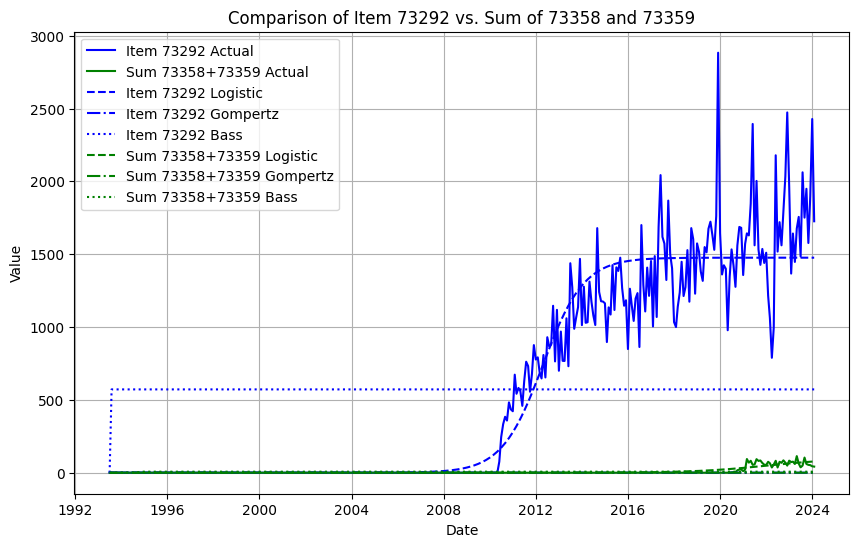

In [6]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.optimize import curve_fit, differential_evolution
from sklearn.metrics import r2_score, mean_absolute_error, mean_squared_error

# Assuming `df` is already loaded and contains the data
# We will filter for item 73292 and the sum of 73358 and 73359

# Filter for the specified items
df_73292 = df[df['Item'] == 73292].copy()
df_sum_73358_73359 = df[df['Item'].isin([73358, 73359])].groupby('ds').agg({'y': 'sum'}).reset_index()

# Convert the "ds" column to ordinal for both datasets
df_73292['ds_ordinal'] = df_73292['ds'].apply(lambda x: pd.to_datetime(x).toordinal())
df_sum_73358_73359['ds_ordinal'] = df_sum_73358_73359['ds'].apply(lambda x: pd.to_datetime(x).toordinal())

# Define the logistic, Gompertz, and Bass diffusion models
def logistic_growth(t, K, P0, r):
    P0 = max(P0, 1e-6)  # Add a small constant to avoid division by zero
    return K / (1 + ((K - P0) / P0) * np.exp(-r * t))

def gompertz_growth(t, a, b, c):
    return a * np.exp(-b * np.exp(-c * t))

def bass_diffusion(t, p, q, m):
    p = max(p, 1e-6)
    q = max(q, 1e-6)
    t = np.clip(t, -500, 500)
    return m * (1 - np.exp(-(p + q) * t)) / (1 + (q / p) * np.exp(-(p + q) * t))

# Function to fit the models and return parameters and metrics
def fit_diffusion_models(df):
    t_data = df['ds_ordinal'] - df['ds_ordinal'].min()
    y_data = df['y']

    # Fit logistic model
    logistic_params, _ = curve_fit(logistic_growth, t_data, y_data, p0=[max(y_data), min(y_data), 0.1], maxfev=5000)
    logistic_pred = logistic_growth(t_data, *logistic_params)
    
    # Fit Gompertz model
    gompertz_params, _ = curve_fit(gompertz_growth, t_data, y_data, p0=[max(y_data), 0.1, 0.1], maxfev=5000)
    gompertz_pred = gompertz_growth(t_data, *gompertz_params)

    # Fit Bass diffusion model
    bass_params = differential_evolution(lambda params: -r2_score(y_data, bass_diffusion(t_data, *params)), bounds=[(1e-6, 1), (1e-6, 1), (0, max(y_data))]).x
    bass_pred = bass_diffusion(t_data, *bass_params)

    # Return model parameters and metrics
    metrics = {
        'logistic': {
            'params': logistic_params,
            'r2': r2_score(y_data, logistic_pred),
            'mae': mean_absolute_error(y_data, logistic_pred),
            'rmse': np.sqrt(mean_squared_error(y_data, logistic_pred)),
            'pred': logistic_pred
        },
        'gompertz': {
            'params': gompertz_params,
            'r2': r2_score(y_data, gompertz_pred),
            'mae': mean_absolute_error(y_data, gompertz_pred),
            'rmse': np.sqrt(mean_squared_error(y_data, gompertz_pred)),
            'pred': gompertz_pred
        },
        'bass': {
            'params': bass_params,
            'r2': r2_score(y_data, bass_pred),
            'mae': mean_absolute_error(y_data, bass_pred),
            'rmse': np.sqrt(mean_squared_error(y_data, bass_pred)),
            'pred': bass_pred
        }
    }
    
    return metrics

# Fit models for item 73292 and the sum of 73358 and 73359
metrics_73292 = fit_diffusion_models(df_73292)
metrics_73358_73359 = fit_diffusion_models(df_sum_73358_73359)

# Print comparison metrics for both groups
print("Metrics for item 73292:")
print(metrics_73292)

print("\nMetrics for the sum of items 73358 and 73359:")
print(metrics_73358_73359)

# Plot the comparison
plt.figure(figsize=(10, 6))
t_data_73292 = df_73292['ds_ordinal'] - df_73292['ds_ordinal'].min()
t_data_73358_73359 = df_sum_73358_73359['ds_ordinal'] - df_sum_73358_73359['ds_ordinal'].min()

# Plot actual data
plt.plot(df_73292['ds'], df_73292['y'], label='Item 73292 Actual', color='blue')
plt.plot(df_sum_73358_73359['ds'], df_sum_73358_73359['y'], label='Sum 73358+73359 Actual', color='green')

# Plot model predictions for item 73292
plt.plot(df_73292['ds'], metrics_73292['logistic']['pred'], label='Item 73292 Logistic', linestyle='--', color='blue')
plt.plot(df_73292['ds'], metrics_73292['gompertz']['pred'], label='Item 73292 Gompertz', linestyle='-.', color='blue')
plt.plot(df_73292['ds'], metrics_73292['bass']['pred'], label='Item 73292 Bass', linestyle=':', color='blue')

# Plot model predictions for sum of 73358 and 73359
plt.plot(df_sum_73358_73359['ds'], metrics_73358_73359['logistic']['pred'], label='Sum 73358+73359 Logistic', linestyle='--', color='green')
plt.plot(df_sum_73358_73359['ds'], metrics_73358_73359['gompertz']['pred'], label='Sum 73358+73359 Gompertz', linestyle='-.', color='green')
plt.plot(df_sum_73358_73359['ds'], metrics_73358_73359['bass']['pred'], label='Sum 73358+73359 Bass', linestyle=':', color='green')

plt.xlabel('Date')
plt.ylabel('Value')
plt.title('Comparison of Item 73292 vs. Sum of 73358 and 73359')
plt.legend()
plt.grid(True)
plt.show()


/tmp/ipykernel_204610/3655516749.py:38: OptimizeWarning: Covariance of the parameters could not be estimated
  logistic_params, _ = curve_fit(logistic_growth, t_data, y_data, p0=[max(y_data), min(y_data), 0.1], maxfev=5000)
/home/doughnut/miniconda3/lib/python3.12/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: overflow encountered in exp
  result = getattr(ufunc, method)(*inputs, **kwargs)
/tmp/ipykernel_204610/3655516749.py:42: OptimizeWarning: Covariance of the parameters could not be estimated
  gompertz_params, _ = curve_fit(gompertz_growth, t_data, y_data, p0=[max(y_data), 0.1, 0.1], maxfev=5000)
/tmp/ipykernel_204610/3655516749.py:38: OptimizeWarning: Covariance of the parameters could not be estimated
  logistic_params, _ = curve_fit(logistic_growth, t_data, y_data, p0=[max(y_data), min(y_data), 0.1], maxfev=5000)
/home/doughnut/miniconda3/lib/python3.12/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: overflow encountered in exp
  result = getattr(ufunc,

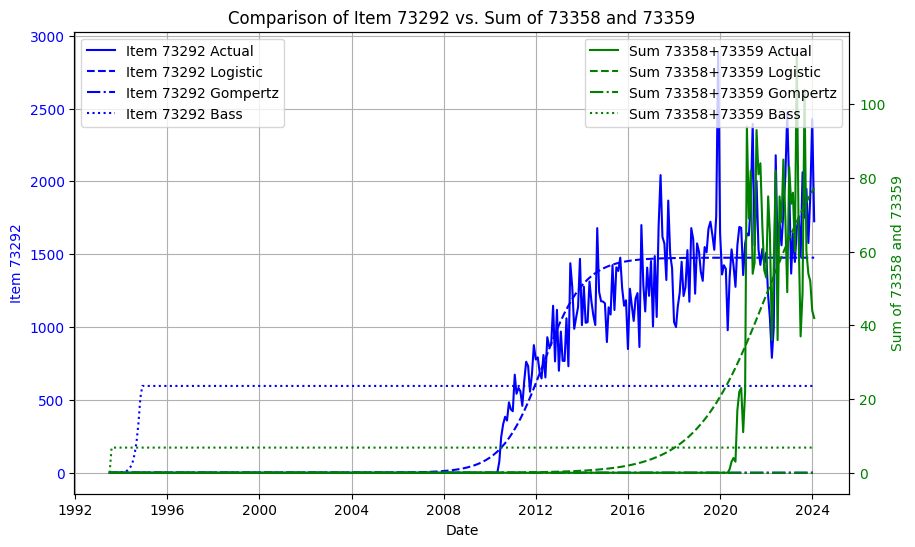

In [7]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.optimize import curve_fit, differential_evolution
from sklearn.metrics import r2_score, mean_absolute_error, mean_squared_error

# Assuming `df` is already loaded and contains the data
# We will filter for item 73292 and the sum of 73358 and 73359

# Filter for the specified items
df_73292 = df[df['Item'] == 73292].copy()
df_sum_73358_73359 = df[df['Item'].isin([73358, 73359])].groupby('ds').agg({'y': 'sum'}).reset_index()

# Convert the "ds" column to ordinal for both datasets
df_73292['ds_ordinal'] = df_73292['ds'].apply(lambda x: pd.to_datetime(x).toordinal())
df_sum_73358_73359['ds_ordinal'] = df_sum_73358_73359['ds'].apply(lambda x: pd.to_datetime(x).toordinal())

# Define the logistic, Gompertz, and Bass diffusion models
def logistic_growth(t, K, P0, r):
    P0 = max(P0, 1e-6)  # Add a small constant to avoid division by zero
    return K / (1 + ((K - P0) / P0) * np.exp(-r * t))

def gompertz_growth(t, a, b, c):
    return a * np.exp(-b * np.exp(-c * t))

def bass_diffusion(t, p, q, m):
    p = max(p, 1e-6)
    q = max(q, 1e-6)
    t = np.clip(t, -500, 500)
    return m * (1 - np.exp(-(p + q) * t)) / (1 + (q / p) * np.exp(-(p + q) * t))

# Function to fit the models and return parameters and metrics
def fit_diffusion_models(df):
    t_data = df['ds_ordinal'] - df['ds_ordinal'].min()
    y_data = df['y']

    # Fit logistic model
    logistic_params, _ = curve_fit(logistic_growth, t_data, y_data, p0=[max(y_data), min(y_data), 0.1], maxfev=5000)
    logistic_pred = logistic_growth(t_data, *logistic_params)
    
    # Fit Gompertz model
    gompertz_params, _ = curve_fit(gompertz_growth, t_data, y_data, p0=[max(y_data), 0.1, 0.1], maxfev=5000)
    gompertz_pred = gompertz_growth(t_data, *gompertz_params)

    # Fit Bass diffusion model
    bass_params = differential_evolution(lambda params: -r2_score(y_data, bass_diffusion(t_data, *params)), bounds=[(1e-6, 1), (1e-6, 1), (0, max(y_data))]).x
    bass_pred = bass_diffusion(t_data, *bass_params)

    # Return model parameters and metrics
    metrics = {
        'logistic': {
            'params': logistic_params,
            'r2': r2_score(y_data, logistic_pred),
            'mae': mean_absolute_error(y_data, logistic_pred),
            'rmse': np.sqrt(mean_squared_error(y_data, logistic_pred)),
            'pred': logistic_pred
        },
        'gompertz': {
            'params': gompertz_params,
            'r2': r2_score(y_data, gompertz_pred),
            'mae': mean_absolute_error(y_data, gompertz_pred),
            'rmse': np.sqrt(mean_squared_error(y_data, gompertz_pred)),
            'pred': gompertz_pred
        },
        'bass': {
            'params': bass_params,
            'r2': r2_score(y_data, bass_pred),
            'mae': mean_absolute_error(y_data, bass_pred),
            'rmse': np.sqrt(mean_squared_error(y_data, bass_pred)),
            'pred': bass_pred
        }
    }
    
    return metrics

# Fit models for item 73292 and the sum of 73358 and 73359
metrics_73292 = fit_diffusion_models(df_73292)
metrics_73358_73359 = fit_diffusion_models(df_sum_73358_73359)

# Plot the comparison with primary and secondary y-axes
fig, ax1 = plt.subplots(figsize=(10, 6))

# Set the primary y-axis (for item 73292)
ax1.set_xlabel('Date')
ax1.set_ylabel('Item 73292', color='blue')
ax1.plot(df_73292['ds'], df_73292['y'], label='Item 73292 Actual', color='blue')
ax1.plot(df_73292['ds'], metrics_73292['logistic']['pred'], label='Item 73292 Logistic', linestyle='--', color='blue')
ax1.plot(df_73292['ds'], metrics_73292['gompertz']['pred'], label='Item 73292 Gompertz', linestyle='-.', color='blue')
ax1.plot(df_73292['ds'], metrics_73292['bass']['pred'], label='Item 73292 Bass', linestyle=':', color='blue')
ax1.tick_params(axis='y', labelcolor='blue')

# Create a secondary y-axis (for the sum of 73358 + 73359)
ax2 = ax1.twinx()  
ax2.set_ylabel('Sum of 73358 and 73359', color='green')  
ax2.plot(df_sum_73358_73359['ds'], df_sum_73358_73359['y'], label='Sum 73358+73359 Actual', color='green')
ax2.plot(df_sum_73358_73359['ds'], metrics_73358_73359['logistic']['pred'], label='Sum 73358+73359 Logistic', linestyle='--', color='green')
ax2.plot(df_sum_73358_73359['ds'], metrics_73358_73359['gompertz']['pred'], label='Sum 73358+73359 Gompertz', linestyle='-.', color='green')
ax2.plot(df_sum_73358_73359['ds'], metrics_73358_73359['bass']['pred'], label='Sum 73358+73359 Bass', linestyle=':', color='green')
ax2.tick_params(axis='y', labelcolor='green')

# Add a title and grid
plt.title('Comparison of Item 73292 vs. Sum of 73358 and 73359')
ax1.grid(True)

# Show plot legends
ax1.legend(loc='upper left')
ax2.legend(loc='upper right')

plt.show()


/tmp/ipykernel_204610/2330789487.py:51: OptimizeWarning: Covariance of the parameters could not be estimated
  logistic_params, _ = curve_fit(logistic_growth, t_data, y_data, p0=[max(y_data), min(y_data), 0.1], maxfev=5000)
/home/doughnut/miniconda3/lib/python3.12/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: overflow encountered in exp
  result = getattr(ufunc, method)(*inputs, **kwargs)
/tmp/ipykernel_204610/2330789487.py:55: OptimizeWarning: Covariance of the parameters could not be estimated
  gompertz_params, _ = curve_fit(gompertz_growth, t_data, y_data, p0=[max(y_data), 0.1, 0.1], maxfev=5000)
/tmp/ipykernel_204610/2330789487.py:51: OptimizeWarning: Covariance of the parameters could not be estimated
  logistic_params, _ = curve_fit(logistic_growth, t_data, y_data, p0=[max(y_data), min(y_data), 0.1], maxfev=5000)
/home/doughnut/miniconda3/lib/python3.12/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: overflow encountered in exp
  result = getattr(ufunc,

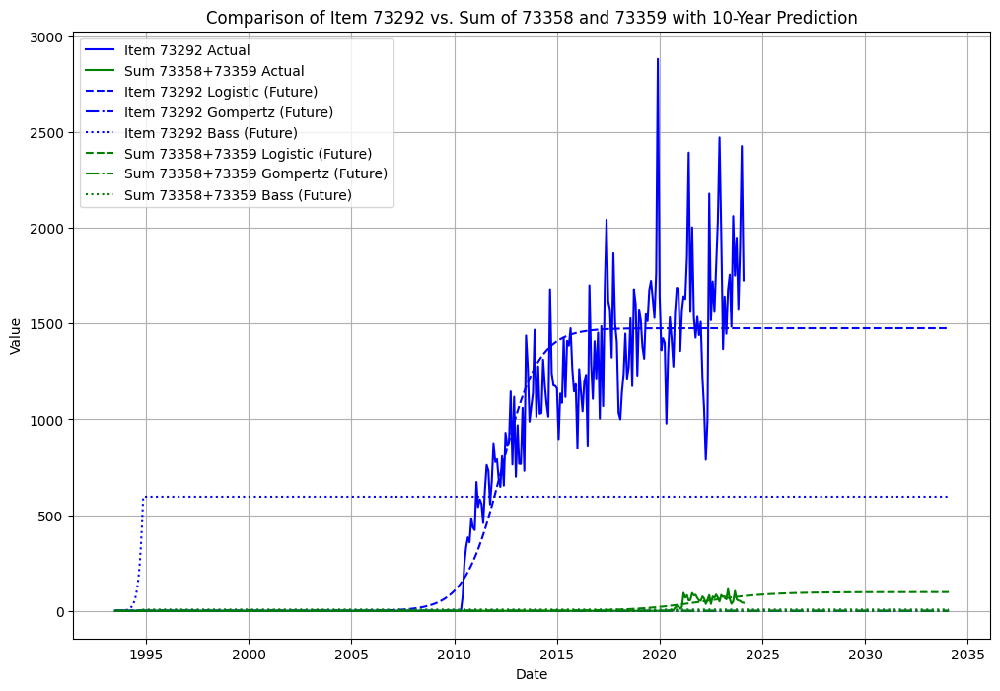

In [8]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.optimize import curve_fit, differential_evolution
from sklearn.metrics import r2_score, mean_absolute_error, mean_squared_error
from datetime import timedelta

# Load the dataset
mdf = pd.read_feather("/mnt/c/Users/doughnut/OneDrive - The University of Melbourne/Phase 1 - Study 4 - Australian Genetic and Genomic Test Utilisation/Data Files/Processed_MBSGeneticsCount_20240325_175333.feather")

# Ensure that "Month" is in datetime format
mdf['Month'] = pd.to_datetime(mdf['Month'])

# Group data by 'Month' and 'Item' and calculate the sum of 'Value'
df = mdf.groupby(['Month', 'Item'], observed=False)['Value'].sum().reset_index()

# Make all values positive
df['Value'] = df['Value'].abs()

# Rename the "Month" and "Value" columns
df = df.rename(columns={"Month": "ds", "Value": "y"})

# Filter for the specified items
df_73292 = df[df['Item'] == 73292].copy()
df_sum_73358_73359 = df[df['Item'].isin([73358, 73359])].groupby('ds').agg({'y': 'sum'}).reset_index()

# Convert the "ds" column to ordinal for both datasets
df_73292['ds_ordinal'] = df_73292['ds'].apply(lambda x: x.toordinal())
df_sum_73358_73359['ds_ordinal'] = df_sum_73358_73359['ds'].apply(lambda x: x.toordinal())

# Define the logistic, Gompertz, and Bass diffusion models
def logistic_growth(t, K, P0, r):
    P0 = max(P0, 1e-6)  # Add a small constant to avoid division by zero
    return K / (1 + ((K - P0) / P0) * np.exp(-r * t))

def gompertz_growth(t, a, b, c):
    return a * np.exp(-b * np.exp(-c * t))

def bass_diffusion(t, p, q, m):
    p = max(p, 1e-6)
    q = max(q, 1e-6)
    t = np.clip(t, -500, 500)
    return m * (1 - np.exp(-(p + q) * t)) / (1 + (q / p) * np.exp(-(p + q) * t))

# Function to fit the models and return parameters and metrics
def fit_diffusion_models(df):
    t_data = df['ds_ordinal'] - df['ds_ordinal'].min()
    y_data = df['y']

    # Fit logistic model
    logistic_params, _ = curve_fit(logistic_growth, t_data, y_data, p0=[max(y_data), min(y_data), 0.1], maxfev=5000)
    logistic_pred = logistic_growth(t_data, *logistic_params)
    
    # Fit Gompertz model
    gompertz_params, _ = curve_fit(gompertz_growth, t_data, y_data, p0=[max(y_data), 0.1, 0.1], maxfev=5000)
    gompertz_pred = gompertz_growth(t_data, *gompertz_params)

    # Fit Bass diffusion model
    bass_params = differential_evolution(lambda params: -r2_score(y_data, bass_diffusion(t_data, *params)), bounds=[(1e-6, 1), (1e-6, 1), (0, max(y_data))]).x
    bass_pred = bass_diffusion(t_data, *bass_params)

    # Return model parameters and metrics
    metrics = {
        'logistic': {
            'params': logistic_params,
            'r2': r2_score(y_data, logistic_pred),
            'mae': mean_absolute_error(y_data, logistic_pred),
            'rmse': np.sqrt(mean_squared_error(y_data, logistic_pred)),
            'pred': logistic_pred
        },
        'gompertz': {
            'params': gompertz_params,
            'r2': r2_score(y_data, gompertz_pred),
            'mae': mean_absolute_error(y_data, gompertz_pred),
            'rmse': np.sqrt(mean_squared_error(y_data, gompertz_pred)),
            'pred': gompertz_pred
        },
        'bass': {
            'params': bass_params,
            'r2': r2_score(y_data, bass_pred),
            'mae': mean_absolute_error(y_data, bass_pred),
            'rmse': np.sqrt(mean_squared_error(y_data, bass_pred)),
            'pred': bass_pred
        }
    }
    
    return metrics

# Fit models for item 73292 and the sum of 73358 and 73359
metrics_73292 = fit_diffusion_models(df_73292)
metrics_73358_73359 = fit_diffusion_models(df_sum_73358_73359)

# Extend predictions 10 years into the future
future_years = 10
days_in_10_years = future_years * 365

# Generate future dates for predictions
t_future_73292 = np.arange(df_73292['ds_ordinal'].min(), df_73292['ds_ordinal'].max() + days_in_10_years)
t_future_73358_73359 = np.arange(df_sum_73358_73359['ds_ordinal'].min(), df_sum_73358_73359['ds_ordinal'].max() + days_in_10_years)

# Predict future values for item 73292
future_logistic_73292 = logistic_growth(t_future_73292 - df_73292['ds_ordinal'].min(), *metrics_73292['logistic']['params'])
future_gompertz_73292 = gompertz_growth(t_future_73292 - df_73292['ds_ordinal'].min(), *metrics_73292['gompertz']['params'])
future_bass_73292 = bass_diffusion(t_future_73292 - df_73292['ds_ordinal'].min(), *metrics_73292['bass']['params'])

# Predict future values for sum of 73358 and 73359
future_logistic_73358_73359 = logistic_growth(t_future_73358_73359 - df_sum_73358_73359['ds_ordinal'].min(), *metrics_73358_73359['logistic']['params'])
future_gompertz_73358_73359 = gompertz_growth(t_future_73358_73359 - df_sum_73358_73359['ds_ordinal'].min(), *metrics_73358_73359['gompertz']['params'])
future_bass_73358_73359 = bass_diffusion(t_future_73358_73359 - df_sum_73358_73359['ds_ordinal'].min(), *metrics_73358_73359['bass']['params'])

# Convert the future t-values back to dates
future_dates_73292 = [pd.Timestamp.fromordinal(int(date)) for date in t_future_73292]
future_dates_73358_73359 = [pd.Timestamp.fromordinal(int(date)) for date in t_future_73358_73359]

# Plot the comparison
plt.figure(figsize=(12, 8))

# Plot actual data
plt.plot(df_73292['ds'], df_73292['y'], label='Item 73292 Actual', color='blue')
plt.plot(df_sum_73358_73359['ds'], df_sum_73358_73359['y'], label='Sum 73358+73359 Actual', color='green')

# Plot model predictions for item 73292
plt.plot(future_dates_73292, future_logistic_73292, label='Item 73292 Logistic (Future)', linestyle='--', color='blue')
plt.plot(future_dates_73292, future_gompertz_73292, label='Item 73292 Gompertz (Future)', linestyle='-.', color='blue')
plt.plot(future_dates_73292, future_bass_73292, label='Item 73292 Bass (Future)', linestyle=':', color='blue')

# Plot model predictions for sum of 73358 and 73359
plt.plot(future_dates_73358_73359, future_logistic_73358_73359, label='Sum 73358+73359 Logistic (Future)', linestyle='--', color='green')
plt.plot(future_dates_73358_73359, future_gompertz_73358_73359, label='Sum 73358+73359 Gompertz (Future)', linestyle='-.', color='green')
plt.plot(future_dates_73358_73359, future_bass_73358_73359, label='Sum 73358+73359 Bass (Future)', linestyle=':', color='green')

plt.xlabel('Date')
plt.ylabel('Value')
plt.title('Comparison of Item 73292 vs. Sum of 73358 and 73359 with 10-Year Prediction')
plt.legend()
plt.grid(True)
plt.show()


/tmp/ipykernel_204610/14476024.py:52: OptimizeWarning: Covariance of the parameters could not be estimated
  logistic_params, _ = curve_fit(logistic_growth, t_data, y_data, p0=[max(y_data), min(y_data), 0.1], maxfev=5000)
/home/doughnut/miniconda3/lib/python3.12/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: overflow encountered in exp
  result = getattr(ufunc, method)(*inputs, **kwargs)
/tmp/ipykernel_204610/14476024.py:56: OptimizeWarning: Covariance of the parameters could not be estimated
  gompertz_params, _ = curve_fit(gompertz_growth, t_data, y_data, p0=[max(y_data), 0.1, 0.1], maxfev=5000)
/tmp/ipykernel_204610/14476024.py:52: OptimizeWarning: Covariance of the parameters could not be estimated
  logistic_params, _ = curve_fit(logistic_growth, t_data, y_data, p0=[max(y_data), min(y_data), 0.1], maxfev=5000)
/home/doughnut/miniconda3/lib/python3.12/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: overflow encountered in exp
  result = getattr(ufunc, metho

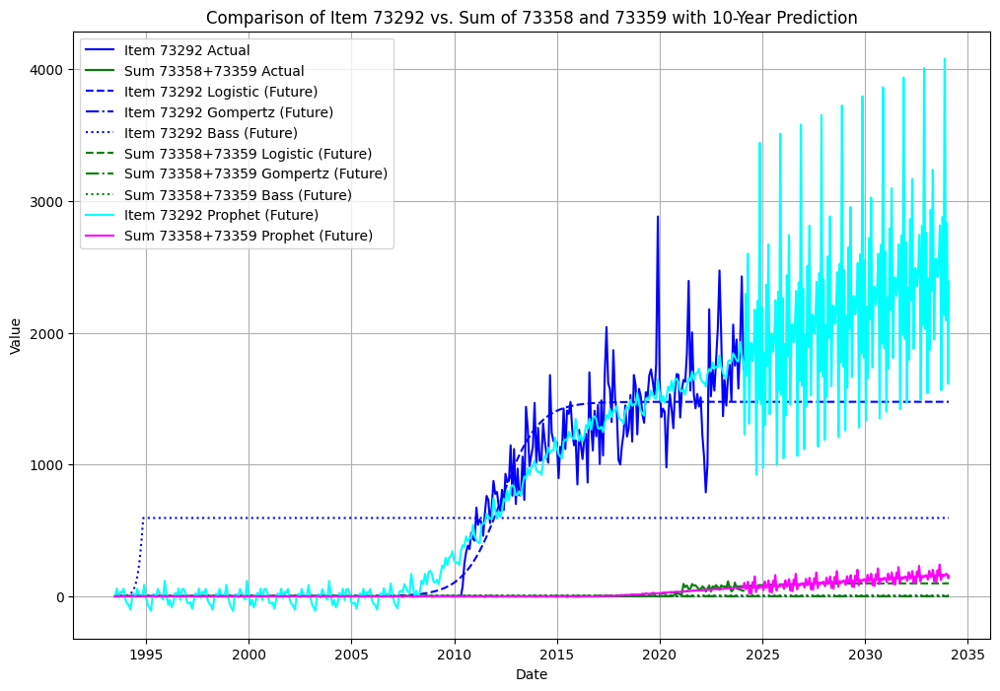

In [12]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.optimize import curve_fit, differential_evolution
from sklearn.metrics import r2_score, mean_absolute_error, mean_squared_error
from prophet import Prophet
from datetime import timedelta

# Load the dataset
mdf = pd.read_feather("/mnt/c/Users/doughnut/OneDrive - The University of Melbourne/Phase 1 - Study 4 - Australian Genetic and Genomic Test Utilisation/Data Files/Processed_MBSGeneticsCount_20240325_175333.feather")

# Ensure that "Month" is in datetime format
mdf['Month'] = pd.to_datetime(mdf['Month'])

# Group data by 'Month' and 'Item' and calculate the sum of 'Value'
df = mdf.groupby(['Month', 'Item'], observed=False)['Value'].sum().reset_index()

# Make all values positive
df['Value'] = df['Value'].abs()

# Rename the "Month" and "Value" columns
df = df.rename(columns={"Month": "ds", "Value": "y"})

# Filter for the specified items
df_73292 = df[df['Item'] == 73292].copy()
df_sum_73358_73359 = df[df['Item'].isin([73358, 73359])].groupby('ds').agg({'y': 'sum'}).reset_index()

# Convert the "ds" column to ordinal for both datasets
df_73292['ds_ordinal'] = df_73292['ds'].apply(lambda x: x.toordinal())
df_sum_73358_73359['ds_ordinal'] = df_sum_73358_73359['ds'].apply(lambda x: x.toordinal())

# Define the logistic, Gompertz, and Bass diffusion models
def logistic_growth(t, K, P0, r):
    P0 = max(P0, 1e-6)  # Add a small constant to avoid division by zero
    return K / (1 + ((K - P0) / P0) * np.exp(-r * t))

def gompertz_growth(t, a, b, c):
    return a * np.exp(-b * np.exp(-c * t))

def bass_diffusion(t, p, q, m):
    p = max(p, 1e-6)
    q = max(q, 1e-6)
    t = np.clip(t, -500, 500)
    return m * (1 - np.exp(-(p + q) * t)) / (1 + (q / p) * np.exp(-(p + q) * t))

# Function to fit the models and return parameters and metrics
def fit_diffusion_models(df):
    t_data = df['ds_ordinal'] - df['ds_ordinal'].min()
    y_data = df['y']

    # Fit logistic model
    logistic_params, _ = curve_fit(logistic_growth, t_data, y_data, p0=[max(y_data), min(y_data), 0.1], maxfev=5000)
    logistic_pred = logistic_growth(t_data, *logistic_params)
    
    # Fit Gompertz model
    gompertz_params, _ = curve_fit(gompertz_growth, t_data, y_data, p0=[max(y_data), 0.1, 0.1], maxfev=5000)
    gompertz_pred = gompertz_growth(t_data, *gompertz_params)

    # Fit Bass diffusion model
    bass_params = differential_evolution(lambda params: -r2_score(y_data, bass_diffusion(t_data, *params)), bounds=[(1e-6, 1), (1e-6, 1), (0, max(y_data))]).x
    bass_pred = bass_diffusion(t_data, *bass_params)

    # Return model parameters and metrics
    metrics = {
        'logistic': {
            'params': logistic_params,
            'r2': r2_score(y_data, logistic_pred),
            'mae': mean_absolute_error(y_data, logistic_pred),
            'rmse': np.sqrt(mean_squared_error(y_data, logistic_pred)),
            'pred': logistic_pred
        },
        'gompertz': {
            'params': gompertz_params,
            'r2': r2_score(y_data, gompertz_pred),
            'mae': mean_absolute_error(y_data, gompertz_pred),
            'rmse': np.sqrt(mean_squared_error(y_data, gompertz_pred)),
            'pred': gompertz_pred
        },
        'bass': {
            'params': bass_params,
            'r2': r2_score(y_data, bass_pred),
            'mae': mean_absolute_error(y_data, bass_pred),
            'rmse': np.sqrt(mean_squared_error(y_data, bass_pred)),
            'pred': bass_pred
        }
    }
    
    return metrics

# Fit models for item 73292 and the sum of 73358 and 73359
metrics_73292 = fit_diffusion_models(df_73292)
metrics_73358_73359 = fit_diffusion_models(df_sum_73358_73359)

# Extend predictions 10 years into the future
future_years = 10
days_in_10_years = future_years * 365

# Generate future dates for predictions
t_future_73292 = np.arange(df_73292['ds_ordinal'].min(), df_73292['ds_ordinal'].max() + days_in_10_years)
t_future_73358_73359 = np.arange(df_sum_73358_73359['ds_ordinal'].min(), df_sum_73358_73359['ds_ordinal'].max() + days_in_10_years)

# Predict future values for item 73292
future_logistic_73292 = logistic_growth(t_future_73292 - df_73292['ds_ordinal'].min(), *metrics_73292['logistic']['params'])
future_gompertz_73292 = gompertz_growth(t_future_73292 - df_73292['ds_ordinal'].min(), *metrics_73292['gompertz']['params'])
future_bass_73292 = bass_diffusion(t_future_73292 - df_73292['ds_ordinal'].min(), *metrics_73292['bass']['params'])

# Predict future values for sum of 73358 and 73359
future_logistic_73358_73359 = logistic_growth(t_future_73358_73359 - df_sum_73358_73359['ds_ordinal'].min(), *metrics_73358_73359['logistic']['params'])
future_gompertz_73358_73359 = gompertz_growth(t_future_73358_73359 - df_sum_73358_73359['ds_ordinal'].min(), *metrics_73358_73359['gompertz']['params'])
future_bass_73358_73359 = bass_diffusion(t_future_73358_73359 - df_sum_73358_73359['ds_ordinal'].min(), *metrics_73358_73359['bass']['params'])

# Prophet Forecast for item 73292
model_73292 = Prophet()
model_73292.fit(df_73292[['ds', 'y']])
future_73292 = model_73292.make_future_dataframe(periods=days_in_10_years)
forecast_73292 = model_73292.predict(future_73292)

# Prophet Forecast for the sum of 73358 and 73359
model_73358_73359 = Prophet()
model_73358_73359.fit(df_sum_73358_73359[['ds', 'y']])
future_73358_73359 = model_73358_73359.make_future_dataframe(periods=days_in_10_years)
forecast_73358_73359 = model_73358_73359.predict(future_73358_73359)

# Convert the future t-values back to dates
future_dates_73292 = [pd.Timestamp.fromordinal(int(date)) for date in t_future_73292]
future_dates_73358_73359 = [pd.Timestamp.fromordinal(int(date)) for date in t_future_73358_73359]

# Plot the comparison
plt.figure(figsize=(12, 8))

# Plot actual data
plt.plot(df_73292['ds'], df_73292['y'], label='Item 73292 Actual', color='blue')
plt.plot(df_sum_73358_73359['ds'], df_sum_73358_73359['y'], label='Sum 73358+73359 Actual', color='green')

# Plot model predictions for item 73292
plt.plot(future_dates_73292, future_logistic_73292, label='Item 73292 Logistic (Future)', linestyle='--', color='blue')
plt.plot(future_dates_73292, future_gompertz_73292, label='Item 73292 Gompertz (Future)', linestyle='-.', color='blue')
plt.plot(future_dates_73292, future_bass_73292, label='Item 73292 Bass (Future)', linestyle=':', color='blue')

# Plot model predictions for sum of 73358 and 73359
plt.plot(future_dates_73358_73359, future_logistic_73358_73359, label='Sum 73358+73359 Logistic (Future)', linestyle='--', color='green')
plt.plot(future_dates_73358_73359, future_gompertz_73358_73359, label='Sum 73358+73359 Gompertz (Future)', linestyle='-.', color='green')
plt.plot(future_dates_73358_73359, future_bass_73358_73359, label='Sum 73358+73359 Bass (Future)', linestyle=':', color='green')

# Plot Prophet forecasts for item 73292
plt.plot(forecast_73292['ds'], forecast_73292['yhat'], label='Item 73292 Prophet (Future)', linestyle='-', color='cyan')

# Plot Prophet forecasts for sum of 73358 and 73359
plt.plot(forecast_73358_73359['ds'], forecast_73358_73359['yhat'], label='Sum 73358+73359 Prophet (Future)', linestyle='-', color='magenta')

plt.xlabel('Date')
plt.ylabel('Value')
plt.title('Comparison of Item 73292 vs. Sum of 73358 and 73359 with 10-Year Prediction')
plt.legend()
plt.grid(True)
plt.show()


/tmp/ipykernel_204610/1943250563.py:52: OptimizeWarning: Covariance of the parameters could not be estimated
  logistic_params, _ = curve_fit(logistic_growth, t_data, y_data, p0=[max(y_data), min(y_data), 0.1], maxfev=5000)
/home/doughnut/miniconda3/lib/python3.12/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: overflow encountered in exp
  result = getattr(ufunc, method)(*inputs, **kwargs)
/tmp/ipykernel_204610/1943250563.py:56: OptimizeWarning: Covariance of the parameters could not be estimated
  gompertz_params, _ = curve_fit(gompertz_growth, t_data, y_data, p0=[max(y_data), 0.1, 0.1], maxfev=5000)
/tmp/ipykernel_204610/1943250563.py:52: OptimizeWarning: Covariance of the parameters could not be estimated
  logistic_params, _ = curve_fit(logistic_growth, t_data, y_data, p0=[max(y_data), min(y_data), 0.1], maxfev=5000)
/home/doughnut/miniconda3/lib/python3.12/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: overflow encountered in exp
  result = getattr(ufunc,

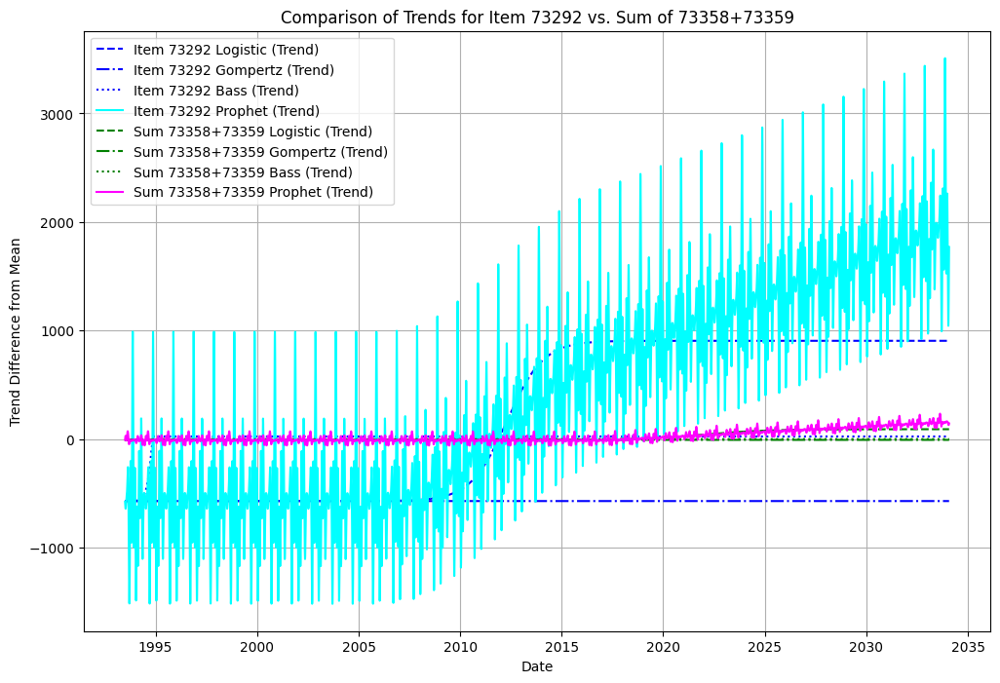

In [14]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.optimize import curve_fit, differential_evolution
from sklearn.metrics import r2_score, mean_absolute_error, mean_squared_error
from prophet import Prophet
from datetime import timedelta

# Load the dataset
mdf = pd.read_feather("/mnt/c/Users/doughnut/OneDrive - The University of Melbourne/Phase 1 - Study 4 - Australian Genetic and Genomic Test Utilisation/Data Files/Processed_MBSGeneticsCount_20240325_175333.feather")

# Ensure that "Month" is in datetime format
mdf['Month'] = pd.to_datetime(mdf['Month'])

# Group data by 'Month' and 'Item' and calculate the sum of 'Value'
df = mdf.groupby(['Month', 'Item'], observed=False)['Value'].sum().reset_index()

# Make all values positive
df['Value'] = df['Value'].abs()

# Rename the "Month" and "Value" columns
df = df.rename(columns={"Month": "ds", "Value": "y"})

# Filter for the specified items
df_73292 = df[df['Item'] == 73292].copy()
df_sum_73358_73359 = df[df['Item'].isin([73358, 73359])].groupby('ds').agg({'y': 'sum'}).reset_index()

# Convert the "ds" column to ordinal for both datasets
df_73292['ds_ordinal'] = df_73292['ds'].apply(lambda x: x.toordinal())
df_sum_73358_73359['ds_ordinal'] = df_sum_73358_73359['ds'].apply(lambda x: x.toordinal())

# Define the logistic, Gompertz, and Bass diffusion models
def logistic_growth(t, K, P0, r):
    P0 = max(P0, 1e-6)  # Add a small constant to avoid division by zero
    return K / (1 + ((K - P0) / P0) * np.exp(-r * t))

def gompertz_growth(t, a, b, c):
    return a * np.exp(-b * np.exp(-c * t))

def bass_diffusion(t, p, q, m):
    p = max(p, 1e-6)
    q = max(q, 1e-6)
    t = np.clip(t, -500, 500)
    return m * (1 - np.exp(-(p + q) * t)) / (1 + (q / p) * np.exp(-(p + q) * t))

# Function to fit the models and return parameters and metrics
def fit_diffusion_models(df):
    t_data = df['ds_ordinal'] - df['ds_ordinal'].min()
    y_data = df['y']

    # Fit logistic model
    logistic_params, _ = curve_fit(logistic_growth, t_data, y_data, p0=[max(y_data), min(y_data), 0.1], maxfev=5000)
    logistic_pred = logistic_growth(t_data, *logistic_params)
    
    # Fit Gompertz model
    gompertz_params, _ = curve_fit(gompertz_growth, t_data, y_data, p0=[max(y_data), 0.1, 0.1], maxfev=5000)
    gompertz_pred = gompertz_growth(t_data, *gompertz_params)

    # Fit Bass diffusion model
    bass_params = differential_evolution(lambda params: -r2_score(y_data, bass_diffusion(t_data, *params)), bounds=[(1e-6, 1), (1e-6, 1), (0, max(y_data))]).x
    bass_pred = bass_diffusion(t_data, *bass_params)

    # Return model parameters and metrics
    metrics = {
        'logistic': {
            'params': logistic_params,
            'pred': logistic_pred
        },
        'gompertz': {
            'params': gompertz_params,
            'pred': gompertz_pred
        },
        'bass': {
            'params': bass_params,
            'pred': bass_pred
        }
    }
    
    return metrics

# Fit models for item 73292 and the sum of 73358 and 73359
metrics_73292 = fit_diffusion_models(df_73292)
metrics_73358_73359 = fit_diffusion_models(df_sum_73358_73359)

# Extend predictions 10 years into the future
future_years = 10
days_in_10_years = future_years * 365

# Generate future dates for predictions
t_future_73292 = np.arange(df_73292['ds_ordinal'].min(), df_73292['ds_ordinal'].max() + days_in_10_years)
t_future_73358_73359 = np.arange(df_sum_73358_73359['ds_ordinal'].min(), df_sum_73358_73359['ds_ordinal'].max() + days_in_10_years)

# Predict future values for item 73292
future_logistic_73292 = logistic_growth(t_future_73292 - df_73292['ds_ordinal'].min(), *metrics_73292['logistic']['params'])
future_gompertz_73292 = gompertz_growth(t_future_73292 - df_73292['ds_ordinal'].min(), *metrics_73292['gompertz']['params'])
future_bass_73292 = bass_diffusion(t_future_73292 - df_73292['ds_ordinal'].min(), *metrics_73292['bass']['params'])

# Predict future values for sum of 73358 and 73359
future_logistic_73358_73359 = logistic_growth(t_future_73358_73359 - df_sum_73358_73359['ds_ordinal'].min(), *metrics_73358_73359['logistic']['params'])
future_gompertz_73358_73359 = gompertz_growth(t_future_73358_73359 - df_sum_73358_73359['ds_ordinal'].min(), *metrics_73358_73359['gompertz']['params'])
future_bass_73358_73359 = bass_diffusion(t_future_73358_73359 - df_sum_73358_73359['ds_ordinal'].min(), *metrics_73358_73359['bass']['params'])

# Prophet Forecast for item 73292
model_73292 = Prophet()
model_73292.fit(df_73292[['ds', 'y']])
# Align future periods with the 10 years forecast (ensure the future DataFrame has the same number of periods)
future_73292 = pd.DataFrame({'ds': future_dates_73292})
forecast_73292 = model_73292.predict(future_73292)

# Prophet Forecast for the sum of 73358 and 73359
model_73358_73359 = Prophet()
model_73358_73359.fit(df_sum_73358_73359[['ds', 'y']])
# Align future periods with the 10 years forecast (ensure the future DataFrame has the same number of periods)
future_73358_73359 = pd.DataFrame({'ds': future_dates_73358_73359})
forecast_73358_73359 = model_73358_73359.predict(future_73358_73359)

# Compute trend differences for item 73292
diff_logistic_73292 = future_logistic_73292 - df_73292['y'].mean()
diff_gompertz_73292 = future_gompertz_73292 - df_73292['y'].mean()
diff_bass_73292 = future_bass_73292 - df_73292['y'].mean()
diff_prophet_73292 = forecast_73292['yhat'].values - df_73292['y'].mean()

# Compute trend differences for sum of 73358 and 73359
diff_logistic_73358_73359 = future_logistic_73358_73359 - df_sum_73358_73359['y'].mean()
diff_gompertz_73358_73359 = future_gompertz_73358_73359 - df_sum_73358_73359['y'].mean()
diff_bass_73358_73359 = future_bass_73358_73359 - df_sum_73358_73359['y'].mean()
diff_prophet_73358_73359 = forecast_73358_73359['yhat'].values - df_sum_73358_73359['y'].mean()

# Plot the comparison of trends (differences from mean)

plt.figure(figsize=(12, 8))

# Plot trend differences for item 73292
plt.plot(future_dates_73292, diff_logistic_73292, label='Item 73292 Logistic (Trend)', linestyle='--', color='blue')
plt.plot(future_dates_73292, diff_gompertz_73292, label='Item 73292 Gompertz (Trend)', linestyle='-.', color='blue')
plt.plot(future_dates_73292, diff_bass_73292, label='Item 73292 Bass (Trend)', linestyle=':', color='blue')
plt.plot(future_dates_73292, diff_prophet_73292, label='Item 73292 Prophet (Trend)', linestyle='-', color='cyan')

# Plot trend differences for sum of 73358 and 73359
plt.plot(future_dates_73358_73359, diff_logistic_73358_73359, label='Sum 73358+73359 Logistic (Trend)', linestyle='--', color='green')
plt.plot(future_dates_73358_73359, diff_gompertz_73358_73359, label='Sum 73358+73359 Gompertz (Trend)', linestyle='-.', color='green')
plt.plot(future_dates_73358_73359, diff_bass_73358_73359, label='Sum 73358+73359 Bass (Trend)', linestyle=':', color='green')
plt.plot(future_dates_73358_73359, diff_prophet_73358_73359, label='Sum 73358+73359 Prophet (Trend)', linestyle='-', color='magenta')

# Set plot labels and title
plt.xlabel('Date')
plt.ylabel('Trend Difference from Mean')
plt.title('Comparison of Trends for Item 73292 vs. Sum of 73358+73359')
plt.legend()
plt.grid(True)

# Show the plot
plt.show()



/tmp/ipykernel_204610/1290307570.py:52: OptimizeWarning: Covariance of the parameters could not be estimated
  logistic_params, _ = curve_fit(logistic_growth, t_data, y_data, p0=[max(y_data), min(y_data), 0.1], maxfev=5000)
/home/doughnut/miniconda3/lib/python3.12/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: overflow encountered in exp
  result = getattr(ufunc, method)(*inputs, **kwargs)
/tmp/ipykernel_204610/1290307570.py:56: OptimizeWarning: Covariance of the parameters could not be estimated
  gompertz_params, _ = curve_fit(gompertz_growth, t_data, y_data, p0=[max(y_data), 0.1, 0.1], maxfev=5000)
/tmp/ipykernel_204610/1290307570.py:52: OptimizeWarning: Covariance of the parameters could not be estimated
  logistic_params, _ = curve_fit(logistic_growth, t_data, y_data, p0=[max(y_data), min(y_data), 0.1], maxfev=5000)
/home/doughnut/miniconda3/lib/python3.12/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: overflow encountered in exp
  result = getattr(ufunc,

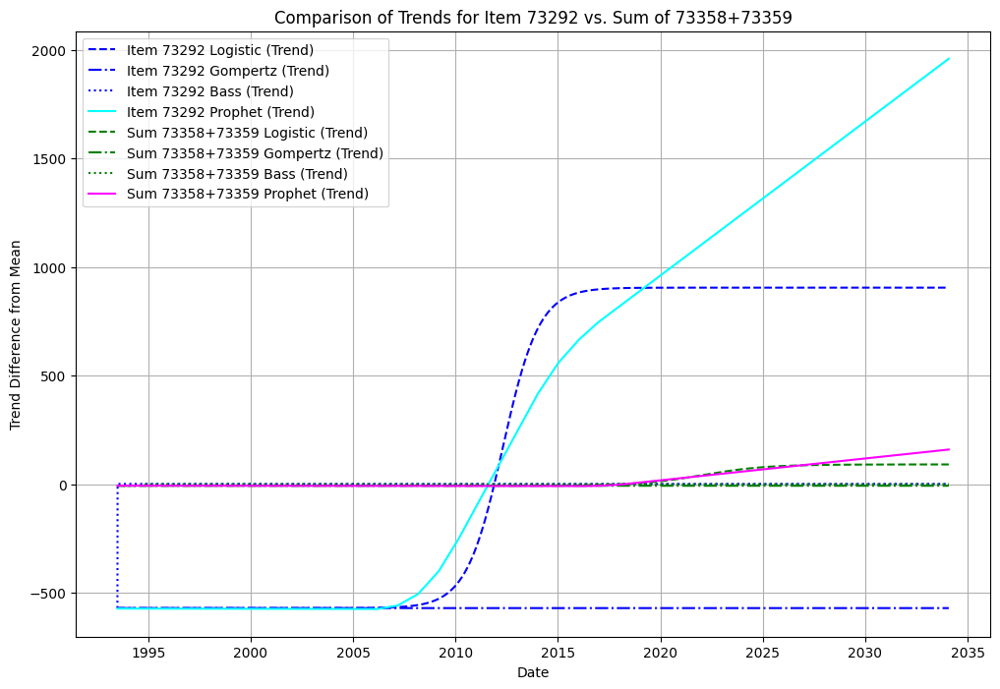

In [15]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.optimize import curve_fit, differential_evolution
from sklearn.metrics import r2_score, mean_absolute_error, mean_squared_error
from prophet import Prophet
from datetime import timedelta

# Load the dataset
mdf = pd.read_feather("/mnt/c/Users/doughnut/OneDrive - The University of Melbourne/Phase 1 - Study 4 - Australian Genetic and Genomic Test Utilisation/Data Files/Processed_MBSGeneticsCount_20240325_175333.feather")

# Ensure that "Month" is in datetime format
mdf['Month'] = pd.to_datetime(mdf['Month'])

# Group data by 'Month' and 'Item' and calculate the sum of 'Value'
df = mdf.groupby(['Month', 'Item'], observed=False)['Value'].sum().reset_index()

# Make all values positive
df['Value'] = df['Value'].abs()

# Rename the "Month" and "Value" columns
df = df.rename(columns={"Month": "ds", "Value": "y"})

# Filter for the specified items
df_73292 = df[df['Item'] == 73292].copy()
df_sum_73358_73359 = df[df['Item'].isin([73358, 73359])].groupby('ds').agg({'y': 'sum'}).reset_index()

# Convert the "ds" column to ordinal for both datasets
df_73292['ds_ordinal'] = df_73292['ds'].apply(lambda x: x.toordinal())
df_sum_73358_73359['ds_ordinal'] = df_sum_73358_73359['ds'].apply(lambda x: x.toordinal())

# Define the logistic, Gompertz, and Bass diffusion models
def logistic_growth(t, K, P0, r):
    P0 = max(P0, 1e-6)  # Add a small constant to avoid division by zero
    return K / (1 + ((K - P0) / P0) * np.exp(-r * t))

def gompertz_growth(t, a, b, c):
    return a * np.exp(-b * np.exp(-c * t))

def bass_diffusion(t, p, q, m):
    p = max(p, 1e-6)
    q = max(q, 1e-6)
    t = np.clip(t, -500, 500)
    return m * (1 - np.exp(-(p + q) * t)) / (1 + (q / p) * np.exp(-(p + q) * t))

# Function to fit the models and return parameters and metrics
def fit_diffusion_models(df):
    t_data = df['ds_ordinal'] - df['ds_ordinal'].min()
    y_data = df['y']

    # Fit logistic model
    logistic_params, _ = curve_fit(logistic_growth, t_data, y_data, p0=[max(y_data), min(y_data), 0.1], maxfev=5000)
    logistic_pred = logistic_growth(t_data, *logistic_params)
    
    # Fit Gompertz model
    gompertz_params, _ = curve_fit(gompertz_growth, t_data, y_data, p0=[max(y_data), 0.1, 0.1], maxfev=5000)
    gompertz_pred = gompertz_growth(t_data, *gompertz_params)

    # Fit Bass diffusion model
    bass_params = differential_evolution(lambda params: -r2_score(y_data, bass_diffusion(t_data, *params)), bounds=[(1e-6, 1), (1e-6, 1), (0, max(y_data))]).x
    bass_pred = bass_diffusion(t_data, *bass_params)

    # Return model parameters and metrics
    metrics = {
        'logistic': {
            'params': logistic_params,
            'pred': logistic_pred
        },
        'gompertz': {
            'params': gompertz_params,
            'pred': gompertz_pred
        },
        'bass': {
            'params': bass_params,
            'pred': bass_pred
        }
    }
    
    return metrics

# Fit models for item 73292 and the sum of 73358 and 73359
metrics_73292 = fit_diffusion_models(df_73292)
metrics_73358_73359 = fit_diffusion_models(df_sum_73358_73359)

# Extend predictions 10 years into the future
future_years = 10
days_in_10_years = future_years * 365

# Generate future dates for predictions
t_future_73292 = np.arange(df_73292['ds_ordinal'].min(), df_73292['ds_ordinal'].max() + days_in_10_years)
t_future_73358_73359 = np.arange(df_sum_73358_73359['ds_ordinal'].min(), df_sum_73358_73359['ds_ordinal'].max() + days_in_10_years)

# Predict future values for item 73292
future_logistic_73292 = logistic_growth(t_future_73292 - df_73292['ds_ordinal'].min(), *metrics_73292['logistic']['params'])
future_gompertz_73292 = gompertz_growth(t_future_73292 - df_73292['ds_ordinal'].min(), *metrics_73292['gompertz']['params'])
future_bass_73292 = bass_diffusion(t_future_73292 - df_73292['ds_ordinal'].min(), *metrics_73292['bass']['params'])

# Predict future values for sum of 73358 and 73359
future_logistic_73358_73359 = logistic_growth(t_future_73358_73359 - df_sum_73358_73359['ds_ordinal'].min(), *metrics_73358_73359['logistic']['params'])
future_gompertz_73358_73359 = gompertz_growth(t_future_73358_73359 - df_sum_73358_73359['ds_ordinal'].min(), *metrics_73358_73359['gompertz']['params'])
future_bass_73358_73359 = bass_diffusion(t_future_73358_73359 - df_sum_73358_73359['ds_ordinal'].min(), *metrics_73358_73359['bass']['params'])

# Prophet Forecast for item 73292
model_73292 = Prophet()
model_73292.fit(df_73292[['ds', 'y']])
# Align future periods with the 10 years forecast (ensure the future DataFrame has the same number of periods)
future_73292 = pd.DataFrame({'ds': [pd.Timestamp.fromordinal(int(date)) for date in t_future_73292]})
forecast_73292 = model_73292.predict(future_73292)

# Prophet Forecast for the sum of 73358 and 73359
model_73358_73359 = Prophet()
model_73358_73359.fit(df_sum_73358_73359[['ds', 'y']])
# Align future periods with the 10 years forecast (ensure the future DataFrame has the same number of periods)
future_73358_73359 = pd.DataFrame({'ds': [pd.Timestamp.fromordinal(int(date)) for date in t_future_73358_73359]})
forecast_73358_73359 = model_73358_73359.predict(future_73358_73359)

# Extract the trend component from the Prophet forecasts
trend_73292 = forecast_73292['trend']
trend_73358_73359 = forecast_73358_73359['trend']

# Compute trend differences for item 73292
diff_logistic_73292 = future_logistic_73292 - df_73292['y'].mean()
diff_gompertz_73292 = future_gompertz_73292 - df_73292['y'].mean()
diff_bass_73292 = future_bass_73292 - df_73292['y'].mean()
diff_prophet_73292 = trend_73292.values - df_73292['y'].mean()

# Compute trend differences for sum of 73358 and 73359
diff_logistic_73358_73359 = future_logistic_73358_73359 - df_sum_73358_73359['y'].mean()
diff_gompertz_73358_73359 = future_gompertz_73358_73359 - df_sum_73358_73359['y'].mean()
diff_bass_73358_73359 = future_bass_73358_73359 - df_sum_73358_73359['y'].mean()
diff_prophet_73358_73359 = trend_73358_73359.values - df_sum_73358_73359['y'].mean()

# Plot the comparison of trends (differences from mean)

plt.figure(figsize=(12, 8))

# Plot trend differences for item 73292
plt.plot(future_dates_73292, diff_logistic_73292, label='Item 73292 Logistic (Trend)', linestyle='--', color='blue')
plt.plot(future_dates_73292, diff_gompertz_73292, label='Item 73292 Gompertz (Trend)', linestyle='-.', color='blue')
plt.plot(future_dates_73292, diff_bass_73292, label='Item 73292 Bass (Trend)', linestyle=':', color='blue')
plt.plot(future_dates_73292, diff_prophet_73292, label='Item 73292 Prophet (Trend)', linestyle='-', color='cyan')

# Plot trend differences for sum of 73358 and 73359
plt.plot(future_dates_73358_73359, diff_logistic_73358_73359, label='Sum 73358+73359 Logistic (Trend)', linestyle='--', color='green')
plt.plot(future_dates_73358_73359, diff_gompertz_73358_73359, label='Sum 73358+73359 Gompertz (Trend)', linestyle='-.', color='green')
plt.plot(future_dates_73358_73359, diff_bass_73358_73359, label='Sum 73358+73359 Bass (Trend)', linestyle=':', color='green')
plt.plot(future_dates_73358_73359, diff_prophet_73358_73359, label='Sum 73358+73359 Prophet (Trend)', linestyle='-', color='magenta')

# Set plot labels and title
plt.xlabel('Date')
plt.ylabel('Trend Difference from Mean')
plt.title('Comparison of Trends for Item 73292 vs. Sum of 73358+73359')
plt.legend()
plt.grid(True)

# Show the plot
plt.show()



/tmp/ipykernel_204610/3119117711.py:52: OptimizeWarning: Covariance of the parameters could not be estimated
  logistic_params, _ = curve_fit(logistic_growth, t_data, y_data, p0=[max(y_data), min(y_data), 0.1], maxfev=5000)
/home/doughnut/miniconda3/lib/python3.12/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: overflow encountered in exp
  result = getattr(ufunc, method)(*inputs, **kwargs)
/tmp/ipykernel_204610/3119117711.py:56: OptimizeWarning: Covariance of the parameters could not be estimated
  gompertz_params, _ = curve_fit(gompertz_growth, t_data, y_data, p0=[max(y_data), 0.1, 0.1], maxfev=5000)
/tmp/ipykernel_204610/3119117711.py:52: OptimizeWarning: Covariance of the parameters could not be estimated
  logistic_params, _ = curve_fit(logistic_growth, t_data, y_data, p0=[max(y_data), min(y_data), 0.1], maxfev=5000)
/home/doughnut/miniconda3/lib/python3.12/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: overflow encountered in exp
  result = getattr(ufunc,

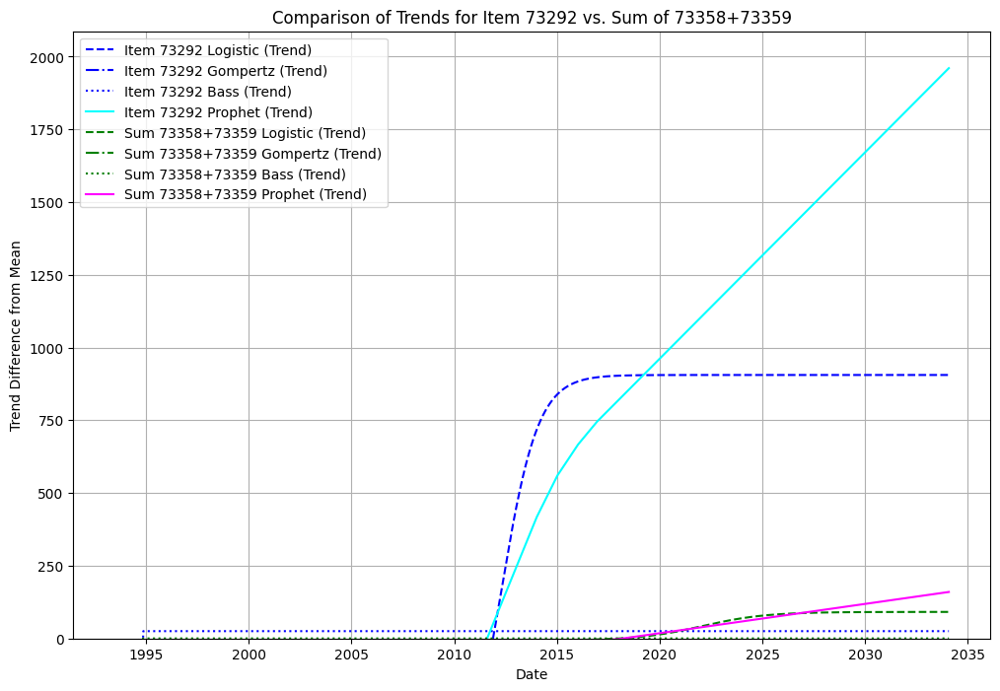

In [22]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.optimize import curve_fit, differential_evolution
from sklearn.metrics import r2_score, mean_absolute_error, mean_squared_error
from prophet import Prophet
from datetime import timedelta

# Load the dataset
mdf = pd.read_feather("/mnt/c/Users/doughnut/OneDrive - The University of Melbourne/Phase 1 - Study 4 - Australian Genetic and Genomic Test Utilisation/Data Files/Processed_MBSGeneticsCount_20240325_175333.feather")

# Ensure that "Month" is in datetime format
mdf['Month'] = pd.to_datetime(mdf['Month'])

# Group data by 'Month' and 'Item' and calculate the sum of 'Value'
df = mdf.groupby(['Month', 'Item'], observed=False)['Value'].sum().reset_index()

# Make all values positive
df['Value'] = df['Value'].abs()

# Rename the "Month" and "Value" columns
df = df.rename(columns={"Month": "ds", "Value": "y"})

# Filter for the specified items
df_73292 = df[df['Item'] == 73292].copy()
df_sum_73358_73359 = df[df['Item'].isin([73358, 73359])].groupby('ds').agg({'y': 'sum'}).reset_index()

# Convert the "ds" column to ordinal for both datasets
df_73292['ds_ordinal'] = df_73292['ds'].apply(lambda x: x.toordinal())
df_sum_73358_73359['ds_ordinal'] = df_sum_73358_73359['ds'].apply(lambda x: x.toordinal())

# Define the logistic, Gompertz, and Bass diffusion models
def logistic_growth(t, K, P0, r):
    P0 = max(P0, 1e-6)  # Add a small constant to avoid division by zero
    return K / (1 + ((K - P0) / P0) * np.exp(-r * t))

def gompertz_growth(t, a, b, c):
    return a * np.exp(-b * np.exp(-c * t))

def bass_diffusion(t, p, q, m):
    p = max(p, 1e-6)
    q = max(q, 1e-6)
    t = np.clip(t, -500, 500)
    return m * (1 - np.exp(-(p + q) * t)) / (1 + (q / p) * np.exp(-(p + q) * t))

# Function to fit the models and return parameters and metrics
def fit_diffusion_models(df):
    t_data = df['ds_ordinal'] - df['ds_ordinal'].min()
    y_data = df['y']

    # Fit logistic model
    logistic_params, _ = curve_fit(logistic_growth, t_data, y_data, p0=[max(y_data), min(y_data), 0.1], maxfev=5000)
    logistic_pred = logistic_growth(t_data, *logistic_params)
    
    # Fit Gompertz model
    gompertz_params, _ = curve_fit(gompertz_growth, t_data, y_data, p0=[max(y_data), 0.1, 0.1], maxfev=5000)
    gompertz_pred = gompertz_growth(t_data, *gompertz_params)

    # Fit Bass diffusion model
    bass_params = differential_evolution(lambda params: -r2_score(y_data, bass_diffusion(t_data, *params)), bounds=[(1e-6, 1), (1e-6, 1), (0, max(y_data))]).x
    bass_pred = bass_diffusion(t_data, *bass_params)

    # Return model parameters and metrics
    metrics = {
        'logistic': {
            'params': logistic_params,
            'pred': logistic_pred
        },
        'gompertz': {
            'params': gompertz_params,
            'pred': gompertz_pred
        },
        'bass': {
            'params': bass_params,
            'pred': bass_pred
        }
    }
    
    return metrics

# Fit models for item 73292 and the sum of 73358 and 73359
metrics_73292 = fit_diffusion_models(df_73292)
metrics_73358_73359 = fit_diffusion_models(df_sum_73358_73359)

# Extend predictions 10 years into the future
future_years = 10
days_in_10_years = future_years * 365

# Generate future dates for predictions
t_future_73292 = np.arange(df_73292['ds_ordinal'].min(), df_73292['ds_ordinal'].max() + days_in_10_years)
t_future_73358_73359 = np.arange(df_sum_73358_73359['ds_ordinal'].min(), df_sum_73358_73359['ds_ordinal'].max() + days_in_10_years)

# Predict future values for item 73292
future_logistic_73292 = logistic_growth(t_future_73292 - df_73292['ds_ordinal'].min(), *metrics_73292['logistic']['params'])
future_gompertz_73292 = gompertz_growth(t_future_73292 - df_73292['ds_ordinal'].min(), *metrics_73292['gompertz']['params'])
future_bass_73292 = bass_diffusion(t_future_73292 - df_73292['ds_ordinal'].min(), *metrics_73292['bass']['params'])

# Predict future values for sum of 73358 and 73359
future_logistic_73358_73359 = logistic_growth(t_future_73358_73359 - df_sum_73358_73359['ds_ordinal'].min(), *metrics_73358_73359['logistic']['params'])
future_gompertz_73358_73359 = gompertz_growth(t_future_73358_73359 - df_sum_73358_73359['ds_ordinal'].min(), *metrics_73358_73359['gompertz']['params'])
future_bass_73358_73359 = bass_diffusion(t_future_73358_73359 - df_sum_73358_73359['ds_ordinal'].min(), *metrics_73358_73359['bass']['params'])

# Prophet Forecast for item 73292
model_73292 = Prophet()
model_73292.fit(df_73292[['ds', 'y']])
# Align future periods with the 10 years forecast (ensure the future DataFrame has the same number of periods)
future_73292 = pd.DataFrame({'ds': [pd.Timestamp.fromordinal(int(date)) for date in t_future_73292]})
forecast_73292 = model_73292.predict(future_73292)

# Prophet Forecast for the sum of 73358 and 73359
model_73358_73359 = Prophet()
model_73358_73359.fit(df_sum_73358_73359[['ds', 'y']])
# Align future periods with the 10 years forecast (ensure the future DataFrame has the same number of periods)
future_73358_73359 = pd.DataFrame({'ds': [pd.Timestamp.fromordinal(int(date)) for date in t_future_73358_73359]})
forecast_73358_73359 = model_73358_73359.predict(future_73358_73359)

# Extract the trend component from the Prophet forecasts
trend_73292 = forecast_73292['trend']
trend_73358_73359 = forecast_73358_73359['trend']

# Compute trend differences for item 73292
diff_logistic_73292 = future_logistic_73292 - df_73292['y'].mean()
diff_gompertz_73292 = future_gompertz_73292 - df_73292['y'].mean()
diff_bass_73292 = future_bass_73292 - df_73292['y'].mean()
diff_prophet_73292 = trend_73292.values - df_73292['y'].mean()

# Compute trend differences for sum of 73358 and 73359
diff_logistic_73358_73359 = future_logistic_73358_73359 - df_sum_73358_73359['y'].mean()
diff_gompertz_73358_73359 = future_gompertz_73358_73359 - df_sum_73358_73359['y'].mean()
diff_bass_73358_73359 = future_bass_73358_73359 - df_sum_73358_73359['y'].mean()
diff_prophet_73358_73359 = trend_73358_73359.values - df_sum_73358_73359['y'].mean()

# Plot the comparison of trends (differences from mean)

plt.figure(figsize=(12, 8))

# Plot trend differences for item 73292
plt.plot(future_dates_73292, diff_logistic_73292, label='Item 73292 Logistic (Trend)', linestyle='--', color='blue')
plt.plot(future_dates_73292, diff_gompertz_73292, label='Item 73292 Gompertz (Trend)', linestyle='-.', color='blue')
plt.plot(future_dates_73292, diff_bass_73292, label='Item 73292 Bass (Trend)', linestyle=':', color='blue')
plt.plot(future_dates_73292, diff_prophet_73292, label='Item 73292 Prophet (Trend)', linestyle='-', color='cyan')

# Plot trend differences for sum of 73358 and 73359
plt.plot(future_dates_73358_73359, diff_logistic_73358_73359, label='Sum 73358+73359 Logistic (Trend)', linestyle='--', color='green')
plt.plot(future_dates_73358_73359, diff_gompertz_73358_73359, label='Sum 73358+73359 Gompertz (Trend)', linestyle='-.', color='green')
plt.plot(future_dates_73358_73359, diff_bass_73358_73359, label='Sum 73358+73359 Bass (Trend)', linestyle=':', color='green')
plt.plot(future_dates_73358_73359, diff_prophet_73358_73359, label='Sum 73358+73359 Prophet (Trend)', linestyle='-', color='magenta')

# Set plot labels and title
plt.xlabel('Date')
plt.ylabel('Trend Difference from Mean')
plt.title('Comparison of Trends for Item 73292 vs. Sum of 73358+73359')

# Ensure the y-axis starts at 0 and does not display negative values
plt.ylim(0, None)

# Add a grid and legend
plt.grid(True)
plt.legend()

# Show the plot
plt.show()



/tmp/ipykernel_204610/592983323.py:52: OptimizeWarning: Covariance of the parameters could not be estimated
  logistic_params, _ = curve_fit(logistic_growth, t_data, y_data, p0=[max(y_data), min(y_data), 0.1], maxfev=5000)
/home/doughnut/miniconda3/lib/python3.12/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: overflow encountered in exp
  result = getattr(ufunc, method)(*inputs, **kwargs)
/tmp/ipykernel_204610/592983323.py:56: OptimizeWarning: Covariance of the parameters could not be estimated
  gompertz_params, _ = curve_fit(gompertz_growth, t_data, y_data, p0=[max(y_data), 0.1, 0.1], maxfev=5000)
/tmp/ipykernel_204610/592983323.py:52: OptimizeWarning: Covariance of the parameters could not be estimated
  logistic_params, _ = curve_fit(logistic_growth, t_data, y_data, p0=[max(y_data), min(y_data), 0.1], maxfev=5000)
/home/doughnut/miniconda3/lib/python3.12/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: overflow encountered in exp
  result = getattr(ufunc, me

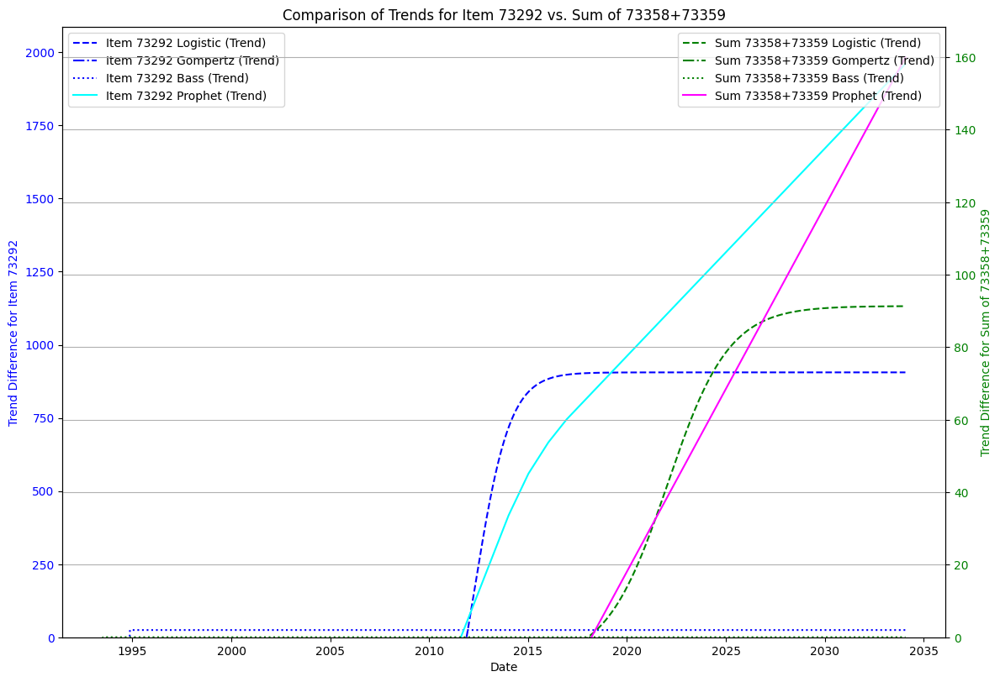

In [23]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.optimize import curve_fit, differential_evolution
from sklearn.metrics import r2_score, mean_absolute_error, mean_squared_error
from prophet import Prophet
from datetime import timedelta

# Load the dataset
mdf = pd.read_feather("/mnt/c/Users/doughnut/OneDrive - The University of Melbourne/Phase 1 - Study 4 - Australian Genetic and Genomic Test Utilisation/Data Files/Processed_MBSGeneticsCount_20240325_175333.feather")

# Ensure that "Month" is in datetime format
mdf['Month'] = pd.to_datetime(mdf['Month'])

# Group data by 'Month' and 'Item' and calculate the sum of 'Value'
df = mdf.groupby(['Month', 'Item'], observed=False)['Value'].sum().reset_index()

# Make all values positive
df['Value'] = df['Value'].abs()

# Rename the "Month" and "Value" columns
df = df.rename(columns={"Month": "ds", "Value": "y"})

# Filter for the specified items
df_73292 = df[df['Item'] == 73292].copy()
df_sum_73358_73359 = df[df['Item'].isin([73358, 73359])].groupby('ds').agg({'y': 'sum'}).reset_index()

# Convert the "ds" column to ordinal for both datasets
df_73292['ds_ordinal'] = df_73292['ds'].apply(lambda x: x.toordinal())
df_sum_73358_73359['ds_ordinal'] = df_sum_73358_73359['ds'].apply(lambda x: x.toordinal())

# Define the logistic, Gompertz, and Bass diffusion models
def logistic_growth(t, K, P0, r):
    P0 = max(P0, 1e-6)  # Add a small constant to avoid division by zero
    return K / (1 + ((K - P0) / P0) * np.exp(-r * t))

def gompertz_growth(t, a, b, c):
    return a * np.exp(-b * np.exp(-c * t))

def bass_diffusion(t, p, q, m):
    p = max(p, 1e-6)
    q = max(q, 1e-6)
    t = np.clip(t, -500, 500)
    return m * (1 - np.exp(-(p + q) * t)) / (1 + (q / p) * np.exp(-(p + q) * t))

# Function to fit the models and return parameters and metrics
def fit_diffusion_models(df):
    t_data = df['ds_ordinal'] - df['ds_ordinal'].min()
    y_data = df['y']

    # Fit logistic model
    logistic_params, _ = curve_fit(logistic_growth, t_data, y_data, p0=[max(y_data), min(y_data), 0.1], maxfev=5000)
    logistic_pred = logistic_growth(t_data, *logistic_params)
    
    # Fit Gompertz model
    gompertz_params, _ = curve_fit(gompertz_growth, t_data, y_data, p0=[max(y_data), 0.1, 0.1], maxfev=5000)
    gompertz_pred = gompertz_growth(t_data, *gompertz_params)

    # Fit Bass diffusion model
    bass_params = differential_evolution(lambda params: -r2_score(y_data, bass_diffusion(t_data, *params)), bounds=[(1e-6, 1), (1e-6, 1), (0, max(y_data))]).x
    bass_pred = bass_diffusion(t_data, *bass_params)

    # Return model parameters and metrics
    metrics = {
        'logistic': {
            'params': logistic_params,
            'pred': logistic_pred
        },
        'gompertz': {
            'params': gompertz_params,
            'pred': gompertz_pred
        },
        'bass': {
            'params': bass_params,
            'pred': bass_pred
        }
    }
    
    return metrics

# Fit models for item 73292 and the sum of 73358 and 73359
metrics_73292 = fit_diffusion_models(df_73292)
metrics_73358_73359 = fit_diffusion_models(df_sum_73358_73359)

# Extend predictions 10 years into the future
future_years = 10
days_in_10_years = future_years * 365

# Generate future dates for predictions
t_future_73292 = np.arange(df_73292['ds_ordinal'].min(), df_73292['ds_ordinal'].max() + days_in_10_years)
t_future_73358_73359 = np.arange(df_sum_73358_73359['ds_ordinal'].min(), df_sum_73358_73359['ds_ordinal'].max() + days_in_10_years)

# Predict future values for item 73292
future_logistic_73292 = logistic_growth(t_future_73292 - df_73292['ds_ordinal'].min(), *metrics_73292['logistic']['params'])
future_gompertz_73292 = gompertz_growth(t_future_73292 - df_73292['ds_ordinal'].min(), *metrics_73292['gompertz']['params'])
future_bass_73292 = bass_diffusion(t_future_73292 - df_73292['ds_ordinal'].min(), *metrics_73292['bass']['params'])

# Predict future values for sum of 73358 and 73359
future_logistic_73358_73359 = logistic_growth(t_future_73358_73359 - df_sum_73358_73359['ds_ordinal'].min(), *metrics_73358_73359['logistic']['params'])
future_gompertz_73358_73359 = gompertz_growth(t_future_73358_73359 - df_sum_73358_73359['ds_ordinal'].min(), *metrics_73358_73359['gompertz']['params'])
future_bass_73358_73359 = bass_diffusion(t_future_73358_73359 - df_sum_73358_73359['ds_ordinal'].min(), *metrics_73358_73359['bass']['params'])

# Prophet Forecast for item 73292
model_73292 = Prophet()
model_73292.fit(df_73292[['ds', 'y']])
# Align future periods with the 10 years forecast (ensure the future DataFrame has the same number of periods)
future_73292 = pd.DataFrame({'ds': [pd.Timestamp.fromordinal(int(date)) for date in t_future_73292]})
forecast_73292 = model_73292.predict(future_73292)

# Prophet Forecast for the sum of 73358 and 73359
model_73358_73359 = Prophet()
model_73358_73359.fit(df_sum_73358_73359[['ds', 'y']])
# Align future periods with the 10 years forecast (ensure the future DataFrame has the same number of periods)
future_73358_73359 = pd.DataFrame({'ds': [pd.Timestamp.fromordinal(int(date)) for date in t_future_73358_73359]})
forecast_73358_73359 = model_73358_73359.predict(future_73358_73359)

# Extract the trend component from the Prophet forecasts
trend_73292 = forecast_73292['trend']
trend_73358_73359 = forecast_73358_73359['trend']

# Compute trend differences for item 73292
diff_logistic_73292 = future_logistic_73292 - df_73292['y'].mean()
diff_gompertz_73292 = future_gompertz_73292 - df_73292['y'].mean()
diff_bass_73292 = future_bass_73292 - df_73292['y'].mean()
diff_prophet_73292 = trend_73292.values - df_73292['y'].mean()

# Compute trend differences for sum of 73358 and 73359
diff_logistic_73358_73359 = future_logistic_73358_73359 - df_sum_73358_73359['y'].mean()
diff_gompertz_73358_73359 = future_gompertz_73358_73359 - df_sum_73358_73359['y'].mean()
diff_bass_73358_73359 = future_bass_73358_73359 - df_sum_73358_73359['y'].mean()
diff_prophet_73358_73359 = trend_73358_73359.values - df_sum_73358_73359['y'].mean()

# Plot the comparison of trends on primary and secondary y-axes

fig, ax1 = plt.subplots(figsize=(12, 8))

# Plot trend differences for item 73292 on the primary y-axis
ax1.set_xlabel('Date')
ax1.set_ylabel('Trend Difference for Item 73292', color='blue')
ax1.plot(future_dates_73292, diff_logistic_73292, label='Item 73292 Logistic (Trend)', linestyle='--', color='blue')
ax1.plot(future_dates_73292, diff_gompertz_73292, label='Item 73292 Gompertz (Trend)', linestyle='-.', color='blue')
ax1.plot(future_dates_73292, diff_bass_73292, label='Item 73292 Bass (Trend)', linestyle=':', color='blue')
ax1.plot(future_dates_73292, diff_prophet_73292, label='Item 73292 Prophet (Trend)', linestyle='-', color='cyan')
ax1.tick_params(axis='y', labelcolor='blue')

# Create secondary y-axis for sum of 73358 and 73359
ax2 = ax1.twinx()  
ax2.set_ylabel('Trend Difference for Sum of 73358+73359', color='green')  
ax2.plot(future_dates_73358_73359, diff_logistic_73358_73359, label='Sum 73358+73359 Logistic (Trend)', linestyle='--', color='green')
ax2.plot(future_dates_73358_73359, diff_gompertz_73358_73359, label='Sum 73358+73359 Gompertz (Trend)', linestyle='-.', color='green')
ax2.plot(future_dates_73358_73359, diff_bass_73358_73359, label='Sum 73358+73359 Bass (Trend)', linestyle=':', color='green')
ax2.plot(future_dates_73358_73359, diff_prophet_73358_73359, label='Sum 73358+73359 Prophet (Trend)', linestyle='-', color='magenta')
ax2.tick_params(axis='y', labelcolor='green')

# Ensure both y-axes start at 0
ax1.set_ylim(0, None)
ax2.set_ylim(0, None)

# Add legends for both sets of plots
fig.tight_layout()  # Adjust layout to prevent overlap
ax1.legend(loc='upper left', bbox_to_anchor=(0, 1))
ax2.legend(loc='upper right', bbox_to_anchor=(1, 1))

# Set the plot title
plt.title('Comparison of Trends for Item 73292 vs. Sum of 73358+73359')

# Show the plot
plt.grid(True)
plt.show()



In [ ]:
https://chatgpt.com/c/66ef9f47-0954-8011-97b4-63da4413aa90?model=gpt-4o